Given a universal GRF for N sites, can we find parameters for the N site hypercube?

Example for 4 sites.

Not run again when copying into the repository for the paper, paths may need to be updated.

In [1]:
import sympy
import numpy as np
from scipy.optimize import minimize
from scipy.optimize import NonlinearConstraint

In [3]:
K1,K2,K3,K4,w12,w13,w14,w23,w24,w34,w123,w124,w134,w234,w1234=sympy.symbols("K1,K2,K3,K4,w12,w13,w14,w23,w24,w34,w123,w124,w134,w234,w1234")
b0,b1,b2,b3,b4=sympy.symbols("b0,b1,b2,b3,b4")

In [4]:
b1_expr=K1+K2+K3+K4
eq_b1=sympy.Eq(b1,b1_expr)
eq_b1

Eq(b1, K1 + K2 + K3 + K4)

In [5]:
K1_sol=sympy.solve(eq_b1,K1)[0]
K1_sol

-K2 - K3 - K4 + b1

In [6]:
print(K1,"=",K1_sol)

K1 = -K2 - K3 - K4 + b1


 This shows that $K_2$, $K_3$, $K_4$ are free but must satisfy: $K_2+K3+K4<b_1$.

In [7]:
b2_expr=K1*K2*w12+K1*K3*w13+K1*K4*w14+K2*K3*w23+K2*K4*w24+K3*K4*w34
eq_b2=sympy.Eq(b2,b2_expr)
eq_b2

Eq(b2, K1*K2*w12 + K1*K3*w13 + K1*K4*w14 + K2*K3*w23 + K2*K4*w24 + K3*K4*w34)

In [8]:
w34_sol=sympy.solve(eq_b2,w34)[0]
sympy.Eq(w34,w34_sol)

Eq(w34, (-K1*K2*w12 - K3*(K1*w13 + K2*w23) - K4*(K1*w14 + K2*w24) + b2)/(K3*K4))

In [9]:
print(w34,"=",w34_sol)

w34 = (-K1*K2*w12 - K3*(K1*w13 + K2*w23) - K4*(K1*w14 + K2*w24) + b2)/(K3*K4)


Lots of constraints on K2,K3,K4 and omegas pairwise cooperativities.

In [10]:
b3_expr=K1*K2*K3*w123*w23+K1*K2*K4*w124*w24+K1*K3*K4*w134*w34+K2*K3*K4*w234*w34
eq_b3=sympy.Eq(b3,b3_expr)
eq_b3

Eq(b3, K1*K2*K3*w123*w23 + K1*K2*K4*w124*w24 + K1*K3*K4*w134*w34 + K2*K3*K4*w234*w34)

In [11]:
w234_sol=sympy.together(sympy.solve(eq_b3,w234)[0])
sympy.Eq(w234,w234_sol)

Eq(w234, (-K1*K2*K3*w123*w23 - K1*K2*K4*w124*w24 - K1*K3*K4*w134*w34 + b3)/(K2*K3*K4*w34))

In [12]:
print("w234","=",w234_sol)

w234 = (-K1*K2*K3*w123*w23 - K1*K2*K4*w124*w24 - K1*K3*K4*w134*w34 + b3)/(K2*K3*K4*w34)


In [13]:
b4_expr=K1*K2*K3*K4*w1234*w234*w34
eq_b4=sympy.Eq(b4,b4_expr)
eq_b4

Eq(b4, K1*K2*K3*K4*w1234*w234*w34)

In [14]:
w1234_sol=sympy.solve(eq_b4,w1234)[0]
sympy.Eq(w1234,w1234_sol)

Eq(w1234, b4/(K1*K2*K3*K4*w234*w34))

In [15]:
print(w1234,"=",w1234_sol)

w1234 = b4/(K1*K2*K3*K4*w234*w34)


Now prepare code such that given a parameter set for the universal boundary, we can get the corresponding parameter set on the hypercube. Plot the functions.

In [2]:
import sys
sys.path.append("../bin")
import matplotlib.pyplot as plt
import N4univ
import N4arbfi
import pandas as pd

In [10]:
def makeplot(parsetuniv,parsetarb,instanceuniv=None,instancearb=None,xmin=-6,xmax=6,xlim0=None,xlim1=None,n=1000,ylim0_g=None,ylim1_g=None):
    othervars=np.array([0])
    xvals=np.logspace(xmin,xmax,n)
    log10xvals=np.log10(xvals)
    
    #first univ:
    instance=instanceuniv
    parset=parsetuniv
    instance.fill_num_den(parset,othervars)
    posu,stpu,x05u=instance.interfaceps(minx0=False,maxx1=False,absder=True) #this will normalise the coefficients
    
    print("From univ parameters, position and steepness are:", posu,stpu,x05u)
    outuniv=np.zeros(len(xvals))
    for x_ in range(n):
        outuniv[x_]=instance.interfaceGRF(xvals[x_])
        
    #now arb univ:
    instance=instancearb
    parset=parsetarb
    instance.fill_num_den(parset,othervars)
    
    posa,stpa,x05a=instance.interfaceps(minx0=False,maxx1=False,absder=True) #this will normalise the coefficients
    print("From arb parameters, position and steepness are:", posa,stpa,x05a)
    outarb=np.zeros(len(xvals))
    for x_ in range(n):
        outarb[x_]=instance.interfaceGRF(xvals[x_])
    
    
    outlist=[outuniv,outarb]
    pslist=[[posu,stpu,x05u],[posa,stpa,x05a]]
    colors=["b","r"]
    linestyles=["-",":"]
    
    fig,axes=plt.subplots(1,2,figsize=(10,4))
    ax=axes[0]
    for i in range(2):
        out=outlist[i]
        color=colors[i]
        pos,stp,x05=pslist[i]
        label=["univ","arb"][i]
        ax.plot(log10xvals,out,color=color,linestyle=linestyles[i],label=label)
        ax.axvline(x=0,linestyle="--",color="gray")
        ax.axvline(x=np.log10(pos),linestyle=":",color=color)
    ax.set_xlabel("log10(x)")
    ax.set_ylabel("g(y)")
    ax.set_xlim(xlim0,xlim1)
    ax.set_ylim(ylim0_g,ylim1_g)
    ax.legend()
    ax=axes[1]
    for i in range(2):
        out=outlist[i]
        color=colors[i]
        pos,stp,x05=pslist[i]
        der=np.diff(out)/np.diff(xvals)
        ax.plot(log10xvals[:-1],np.abs(der),color=color,linestyle=linestyles[i])
        ax.set_xlim(xlim0,xlim1)

        ax.axvline(x=np.log10(pos),linestyle=":",color=color)
        ax.axhline(y=stp,linestyle=":",color=color)
    ax.set_xlabel("log10(x)")
    ax.set_ylabel("abs(dg(y)/dx)")
    plt.tight_layout()
    plt.show()

In [11]:
ar=np.array([1,2,3,4])[:-1]
ar

array([1, 2, 3])

In [17]:
def find_hypercube_parameters(parameters,ll,ul,niter_break=1000,seed=1,doublecheck=True):
    np.random.seed(seed)
    parameters_norm=parameters/parameters[0]
    a0,a1,a2,a3,a4=parameters_norm[1::2]
    b0,b1,b2,b3,b4=parameters_norm[::2]
    
    K1,K2,K3,K4,w12,w13,w14,w23,w24,w34,w123,w124,w134,w234,w1234=np.ones(15)*(-1)
    #find K_i
    found=False
    n=0
    while not found and n<niter_break:
        n+=1
        K2,K3,K4=10**np.random.uniform(-ll,ul,size=3)
        if b1-(K2+K3+K4)>0:
            found=True
            K1=b1-(K2+K3+K4)
            
            if doublecheck:
                print("found K1")
        
    
    #find pairwise coop
    found=False
    n=0
    while not found and n<niter_break:
        n+=1
        w12,w13,w14,w23,w24=10**np.random.uniform(-ll,ul,size=5)
        if -K1*K2*w12 - K3*(K1*w13 + K2*w23) - K4*(K1*w14 + K2*w24) + b2 > 0:
            found=True
            w34 = (-K1*K2*w12 - K3*(K1*w13 + K2*w23) - K4*(K1*w14 + K2*w24) + b2)/(K3*K4)
            if doublecheck:
                print("found pairwise")
    
    #find triplewise cooperativity
    n=0
    found=False
    while not found and n<niter_break:
        n+=1
        w123,w124,w134=10**np.random.uniform(-ll,ul,size=3)
        if (-K1*K2*K3*w123*w23 - K1*K2*K4*w124*w24 - K1*K3*K4*w134*w34 + b3) > 0:
            found=True
            w234 = (-K1*K2*K3*w123*w23 - K1*K2*K4*w124*w24 - K1*K3*K4*w134*w34 + b3)/(K2*K3*K4*w34)
            if doublecheck:
                print("found triplewise")
    
    parset=np.array([K1,K2,K3,K4,w12,w13,w14,w23,w24,w34,w123,w124,w134,w234,w1234])
    if np.any(parset[:-1]<0):
        print("Failed to find parameters", np.where(parset<0))
        return [None,None]
    else:
        w1234 = b4/(K1*K2*K3*K4*w234*w34)
        parset[-1]=w1234
        
        #Now find the fi:
        f0=a0/b0
        f1=a1/b1
        f2=a2/b2
        f3=a3/b3
        f4=a4/b4
        
        fi_ar=np.array([f0,f1,f1,f1,f1,f2,f2,f2,f2,f2,f2,f3,f3,f3,f3,f4])
        
        if doublecheck:
            eq1=K1+K2+K3+K4
            eq2=K1*K2*w12+K1*K3*w13+K1*K4*w14+K2*K3*w23+K2*K4*w24+K3*K4*w34
            eq3=K1*K2*K3*w123*w23+K1*K2*K4*w124*w24+K1*K3*K4*w134*w34+K2*K3*K4*w234*w34
            eq4=K1*K2*K3*K4*w1234*w234*w34
            
            print(b1,eq1)
            print(b2,eq2)
            print(b3,eq3)
            print(b4,eq4)
            maxerr=np.max(np.abs(np.array([b1-eq1,b2-eq2,b3-eq3,b4-eq4])))
            if maxerr>1e-10:
                mark="*"
            else:
                mark="#"
            print(mark,"maximal error is",maxerr)
        
        return [fi_ar,parset]
        
    
        
    
            
        
        
    

### 0
found K1
found pairwise
found triplewise
0.00011650051556142694 0.00011650051556142694
5.456261507507691e-06 5.456261507507691e-06
0.1523460512028537 0.15234605120285366
0.00569877350346854 0.00569877350346854
# maximal error is 2.7755575615628914e-17
fi 0.03586207068734571,0.03153130074667994,0.03153130074667994,0.03153130074667994,0.03153130074667994,0.9999999999999997,0.9999999999999997,0.9999999999999997,0.9999999999999997,0.9999999999999997,0.9999999999999997,0.00022262850793276594,0.00022262850793276594,0.00022262850793276594,0.00022262850793276594,0.06124645586915456
parset 7.117027853781343e-05,6.077932114883038e-10,4.5304281958459204e-05,2.5347271942804116e-08,8.371512893219723e-05,2.3689417342609344e-08,0.00022890937936364007,0.01928678726913294,1.918447535906702e-09,4751434.0007481845,7070.37400353808,21.479743163350665,2.0313736691545373e-05,45938856414803.586,525.5953678028834
From univ parameters, position and steepness are: 9.521320025073814 0.0021377128416922493 0

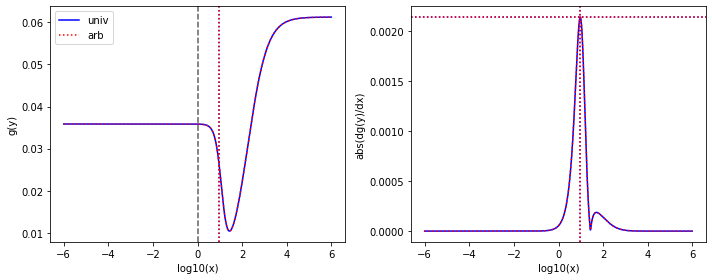

### 1
found K1
found pairwise
found triplewise
0.00011650051556142694 0.00011650051556142694
5.456261507507691e-06 5.456261507507691e-06
0.1523460512028537 0.1523460512028537
0.00569877350346854 0.00569877350346854
# maximal error is 0.0
fi 0.03586207068734571,0.03153130074667994,0.03153130074667994,0.03153130074667994,0.03153130074667994,0.9999999999999997,0.9999999999999997,0.9999999999999997,0.9999999999999997,0.9999999999999997,0.9999999999999997,0.00022262850793276594,0.00022262850793276594,0.00022262850793276594,0.00022262850793276594,0.06124645586915456
parset 5.067305376760999e-06,0.00011134006041763555,8.612273561086141e-08,7.027031419536454e-09,5.311341520498109e-07,0.0008151068462113969,0.008616868882595831,5.97495556814915,0.024204175210478227,9015730129.643444,5062.7910995516095,1.2275664053174424e-06,36504695.302285984,249116425.98444518,7431.216029043371
From univ parameters, position and steepness are: 9.521320025073814 0.0021377128416922493 0.14810402054992894
From arb

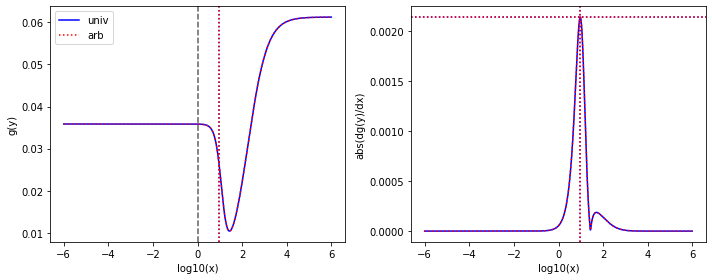

### 2
found K1
found pairwise
found triplewise
0.00011650051556142694 0.00011650051556142692
5.456261507507691e-06 5.456261507507691e-06
0.1523460512028537 0.1523460512028537
0.00569877350346854 0.00569877350346854
# maximal error is 1.3552527156068805e-20
fi 0.03586207068734571,0.03153130074667994,0.03153130074667994,0.03153130074667994,0.03153130074667994,0.9999999999999997,0.9999999999999997,0.9999999999999997,0.9999999999999997,0.9999999999999997,0.9999999999999997,0.00022262850793276594,0.00022262850793276594,0.00022262850793276594,0.00022262850793276594,0.06124645586915456
parset 8.566201519706688e-05,5.401854867261678e-07,1.6280320710490095e-08,3.0282034556923392e-05,1.603248299650317e-10,386.540012704575,8.006562615260057e-05,5.568406016462562e-07,8.04935432814038e-09,11066345.98250414,4.732778171880292e-05,1.9883264170220005e-06,5.1531724728549435e-05,51693512090.029465,436.67859831063663
From univ parameters, position and steepness are: 9.521320025073814 0.0021377128416922493

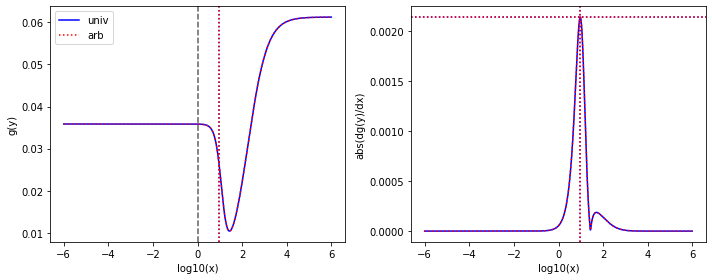

In [18]:
parameters=np.array([763.9389169677701,27.396431441112494,0.08899927768418334,0.0028062629908972656,0.004168250506738358,0.004168250506738357,116.38307736022449,0.02591019086133045,4.353514858284381,0.266637355643623])
for seed in range(3):
    print("###", seed)
    fiar,parset=find_hypercube_parameters(parameters,10,10,seed=seed)
    print("fi",",".join(list(map(str,fiar))))
    print("parset",",".join(list(map(str,parset))))
    
    makeplot(parameters,np.concatenate((fiar,parset)),instanceuniv=N4univ.GRFCalculations_100_100_15(),instancearb=N4arbfi.GRFCalculations_100_100_15())

Now do the same for random position and steepness for the universal model:

        pos       rho       ad        an        bd        bn         cd  \
0  0.007495  0.001149  288.194  0.001000  0.001000  0.001000  91.765100   
1  0.014986  0.002250  495.667  0.364992  0.411140  0.001000   0.008605   
2  0.024478  0.000139  754.889  0.001506  1.359140  0.001000   0.007611   
3  0.037734  0.001136  409.681  0.001000  0.001000  0.001000   0.117064   
4  0.044004  0.000385  409.681  0.001000  0.002398  0.002398   0.001000   

         cn        dd        dn        ed        en  
0  0.013886   700.059  0.001000  16.03850  0.001005  
1  0.004712   700.059  0.556322  18.07110  0.008478  
2  0.001000  1000.000  0.001000  22.29080  0.003201  
3  0.001000   173.213  0.001000   4.46918  0.003943  
4  0.001000   111.575  0.001000   3.94300  0.001062  


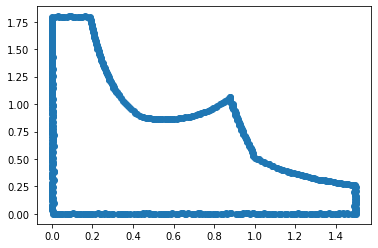

In [13]:
f="/Users/rosamartinezcorral/Dropbox (HMS)/data/2021_12_boundaries/2022_04_05_N4univ_allregion/tocheck_N4univ/mat_N4univ_0_checked.out"
data=pd.read_csv(f,sep=",|;",engine="python") #sep and engine are used to indicate that there are 2 separators
print(data.head())
pos=data["pos"].values
stp=data["rho"].values
parsets=data.values[:,2:].copy()
plt.scatter(pos,stp)
plt.show()


In [14]:
parsets

array([[2.88194e+02, 1.00000e-03, 1.00000e-03, ..., 1.00000e-03,
        1.60385e+01, 1.00456e-03],
       [4.95667e+02, 3.64992e-01, 4.11140e-01, ..., 5.56322e-01,
        1.80711e+01, 8.47754e-03],
       [7.54889e+02, 1.50645e-03, 1.35914e+00, ..., 1.00000e-03,
        2.22908e+01, 3.20137e-03],
       ...,
       [1.29007e+00, 1.00000e-03, 2.88960e-01, ..., 1.53867e+02,
        1.00000e-03, 1.00000e-03],
       [1.57641e+00, 2.24570e-03, 2.48534e+00, ..., 2.26413e+02,
        1.00000e-03, 1.00000e-03],
       [5.77041e+02, 1.90774e+00, 1.38361e-03, ..., 1.51706e+02,
        1.00000e-03, 1.00000e-03]])

[2.88194e+02 1.00000e-03 1.00000e-03 1.00000e-03 9.17651e+01 1.38855e-02
 7.00059e+02 1.00000e-03 1.60385e+01 1.00456e-03]
found K1
found pairwise
found triplewise
3.4698848692200393e-06 3.4698848692200393e-06
0.31841433201246383 0.31841433201246383
2.429124131661311 2.429124131661311
0.05565174847498559 0.05565174847498559
# maximal error is 0.0
min-max are 2.498058915578641e-10 2.58608672096328e+18
From univ parameters, position and steepness are: 0.007494796130557578 0.0011486323451344199 46.16451552785283
From arb parameters, position and steepness are: 0.00749479613055758 0.0011486323451344199 46.164515527852814


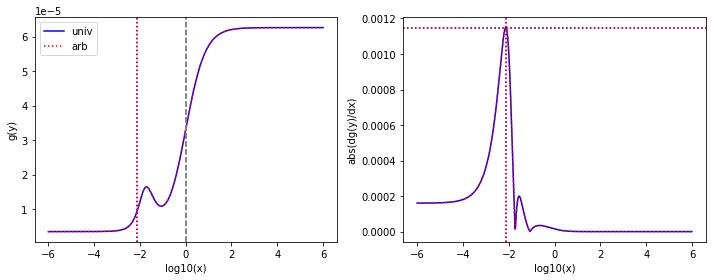

[4.95667e+02 3.64992e-01 4.11140e-01 1.00000e-03 8.60471e-03 4.71235e-03
 7.00059e+02 5.56322e-01 1.80711e+01 8.47754e-03]
found K1
found pairwise
found triplewise
0.0008294681711713711 0.0008294681711713711
1.7359860551539642e-05 1.7359860551539642e-05
1.4123574900084128 1.4123574900084126
0.0364581462957994 0.0364581462957994
# maximal error is 2.220446049250313e-16
min-max are 7.027031419536454e-09 28685015132.601288
From univ parameters, position and steepness are: 0.014985201512127554 0.002250578425157585 42.65114264510212
From arb parameters, position and steepness are: 0.014985201512127557 0.002250578425157586 42.65114264510211


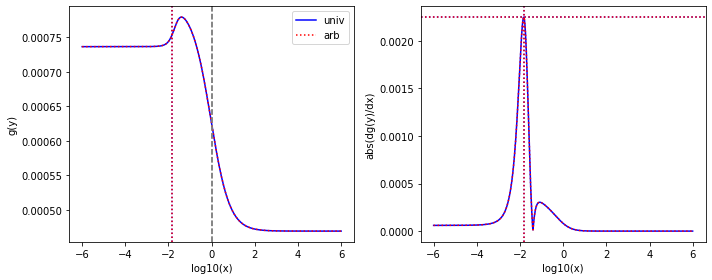

[7.54889e+02 1.50645e-03 1.35914e+00 1.00000e-03 7.61117e-03 1.00000e-03
 1.00000e+03 1.00000e-03 2.22908e+01 3.20137e-03]
found K1
found pairwise
found triplewise
0.001800450132403572 0.001800450132403572
1.0082502195687048e-05 1.0082502195687048e-05
1.324698068192807 1.324698068192807
0.029528579698472227 0.029528579698472227
# maximal error is 0.0
min-max are 7.027031419536454e-09 16660043500.494686
From univ parameters, position and steepness are: 0.02447806043882958 0.00013897213512525022 45.47846110314524
From arb parameters, position and steepness are: 0.024478060438829583 0.00013897213512525022 45.478461103145236


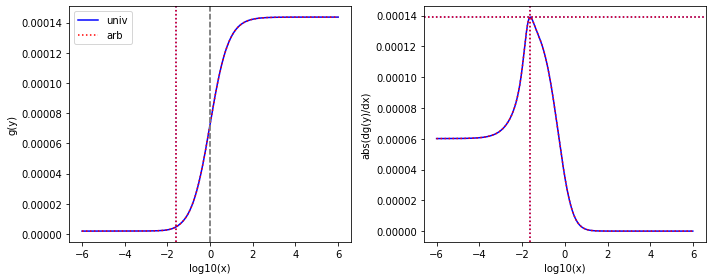

[4.09681e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.17064e-01 1.00000e-03
 1.73213e+02 1.00000e-03 4.46918e+00 3.94334e-03]
found K1
found pairwise
found triplewise
2.4409235478335585e-06 2.4409235478335585e-06
0.00028574427420358767 0.00028574427420358767
0.42279969049089416 0.42279969049089416
0.010908926701506783 0.010908926701506783
# maximal error is 0.0
min-max are 2.498058915578641e-10 2320643131457095.5
From univ parameters, position and steepness are: 0.03773367660402428 0.0011364284313795789 38.452389606785076
From arb parameters, position and steepness are: 0.03773367660402428 0.0011364284313795789 38.452389606785076


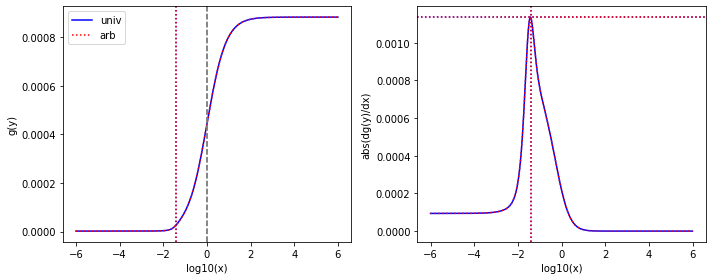

[4.09681e+02 1.00000e-03 2.39795e-03 2.39795e-03 1.00000e-03 1.00000e-03
 1.11575e+02 1.00000e-03 3.94300e+00 1.06239e-03]
found K1
found pairwise
found triplewise
5.8532126215274805e-06 5.8532126215274805e-06
2.4409235478335585e-06 2.4409235478335585e-06
0.2723460448495293 0.2723460448495293
0.009624561549107721 0.009624561549107721
# maximal error is 0.0
min-max are 2.498058915578641e-10 452402276925379.1
From univ parameters, position and steepness are: 0.04400419628488577 0.00038464900117204655 26.842902105895764
From arb parameters, position and steepness are: 0.04400419628488577 0.00038464900117204655 26.842902105895764


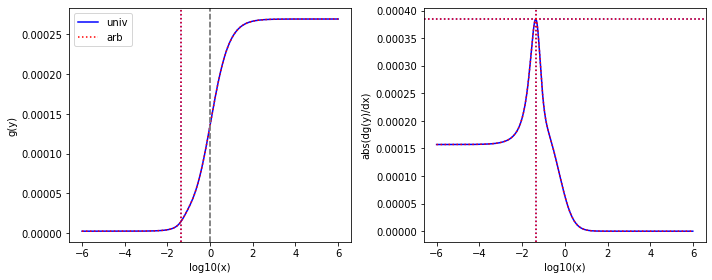

[8.13422e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.23365e-03 1.23365e-03
 1.00000e+03 1.00000e-03 4.61804e+01 5.35148e-02]
found K1
found pairwise
found triplewise
1.2293741747825851e-06 1.2293741747825851e-06
1.5166174507205362e-06 1.5166174507205364e-06
1.229374174782585 1.229374174782585
0.05677299114112969 0.0567729911411297
# maximal error is 6.938893903907228e-18
min-max are 2.498058915578641e-10 3258937972240438.5
From univ parameters, position and steepness are: 0.050708998147632876 0.0014331510820205645 21.662313471550476
From arb parameters, position and steepness are: 0.050708998147632904 0.0014331510820205645 21.66231347155047


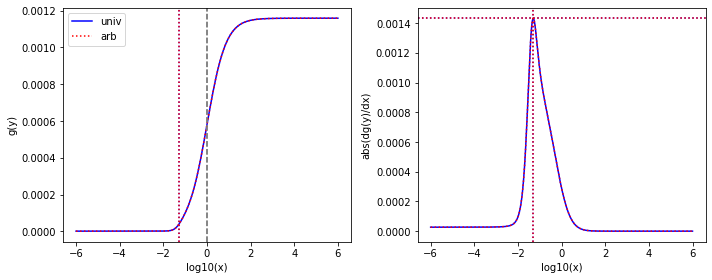

[4.66377e+02 1.00000e-03 4.45743e-03 1.00000e-03 5.34058e-02 1.00000e-03
 1.31088e+02 1.00000e-03 6.24360e+00 1.00000e-03]
found K1
found pairwise
found triplewise
9.55756823342489e-06 9.55756823342489e-06
0.00011451207928349812 0.00011451207928349812
0.2810773258544053 0.28107732585440526
0.01338745264024598 0.01338745264024598
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 929628525068093.9
From univ parameters, position and steepness are: 0.06612510623444544 0.00022736963261664255 19.439201073131297
From arb parameters, position and steepness are: 0.06612510623444545 0.00022736963261664253 19.439201073131294


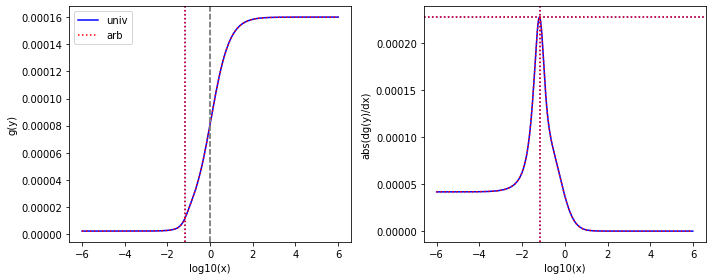

[5.01912e+01 1.00000e-03 1.09023e+01 3.80976e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 1.00000e+03 1.00000e-03]
found K1
found pairwise
found triplewise
0.2172153684311194 0.2172153684311194
1.992381134541513e-05 1.992381134541513e-05
1.992381134541513e-05 1.992381134541513e-05
19.92381134541513 19.92381134541513
# maximal error is 0.0
min-max are 3.529814346881038e-10 32921571748.60447
From univ parameters, position and steepness are: 0.07705065978200104 4.613621401009401e-05 0.6414492006010314
From arb parameters, position and steepness are: 0.07705065978200103 4.613621401009401e-05 0.6414492006010314


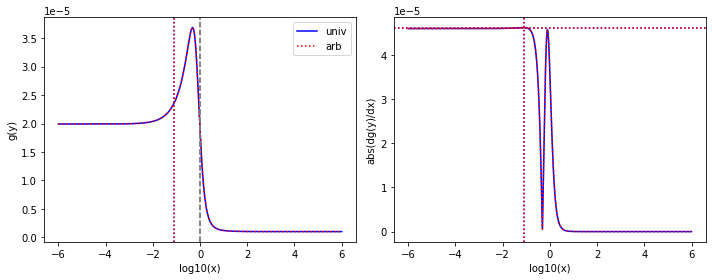

[6.18227e+00 1.00000e-03 2.76957e-03 1.00000e-03 1.00000e-03 1.00000e-03
 5.34720e+02 1.00000e-03 7.20142e+01 1.83379e-01]
found K1
found pairwise
found triplewise
0.0004479859339692378 0.0004479859339692378
0.00016175288364953327 0.00016175288364953327
86.49250194507843 86.49250194507844
11.648504513714219 11.648504513714219
# maximal error is 1.4210854715202004e-14
min-max are 7.027031419536454e-09 267277355732.58377
From univ parameters, position and steepness are: 0.08709350086843139 0.002247602251460894 8.25384972863185
From arb parameters, position and steepness are: 0.08709350086843139 0.002247602251460894 8.25384972863185


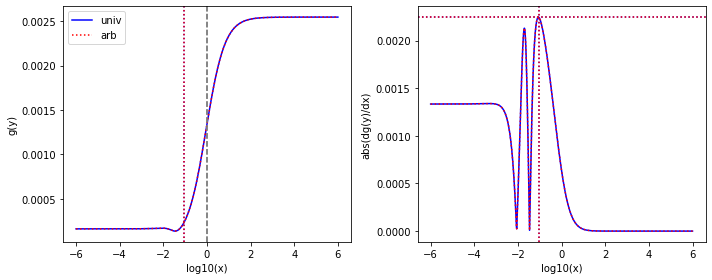

[1.00000e+03 7.86732e-02 4.13592e+00 2.03907e+00 8.45163e-03 8.45163e-03
 1.00000e-03 1.00000e-03 4.03129e+01 1.60588e-03]
found K1
found pairwise
found triplewise
0.0041359199999999995 0.0041359199999999995
8.45163e-06 8.45163e-06
1e-06 1e-06
0.0403129 0.040312900000000006
# maximal error is 6.938893903907228e-18
min-max are 3.529814346881038e-10 13965219944.242895
From univ parameters, position and steepness are: 0.0915946421108066 0.0012834655682076954 0.6295352719310656
From arb parameters, position and steepness are: 0.09159464211080663 0.0012834655682076952 0.6295352719310656


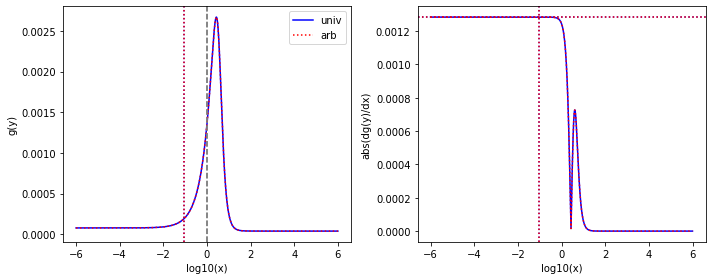

[2.88194e+02 9.96500e-01 3.51112e-03 1.31008e-03 7.78296e+01 6.50004e-01
 7.00059e+02 1.30258e+00 1.14571e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1.2183182162015864e-05 1.2183182162015864e-05
0.2700597514174479 0.2700597514174479
2.429124131661311 2.4291241316613106
0.039754817935140914 0.03975481793514092
# maximal error is 4.440892098500626e-16
min-max are 2.498058915578641e-10 2.1933617302937426e+18
From univ parameters, position and steepness are: 0.10362749267333529 0.008846060568978699 6.7497028305688325
From arb parameters, position and steepness are: 0.10362749267333524 0.008846060568978702 6.749702830568837


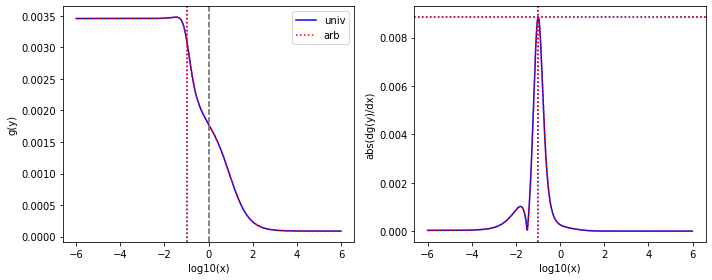

[3.59559e+01 4.30708e-03 4.62345e-02 3.52014e-03 1.00000e-03 1.00000e-03
 3.30667e+01 6.23453e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.0012858668535622804 0.0012858668535622804
2.7811847290708896e-05 2.78118472907089e-05
0.9196460108076838 0.9196460108076838
0.6199483255877339 0.6199483255877338
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 45955683095.53683
From univ parameters, position and steepness are: 0.11787557477086054 0.00026154562584368825 2.3096126960800945
From arb parameters, position and steepness are: 0.11787557477086053 0.0002615456258436883 2.3096126960800945


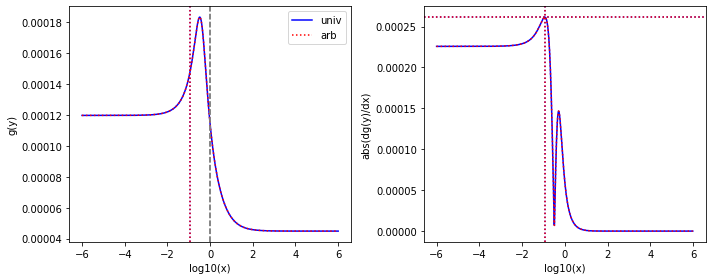

[1.49203e+02 2.60157e-02 1.00000e-03 1.00000e-03 4.69400e-02 1.00000e-03
 1.55784e+01 1.00000e-03 4.78313e+00 1.00000e-03]
found K1
found pairwise
found triplewise
6.702278104327661e-06 6.702278104327661e-06
0.0003146049342171404 0.0003146049342171404
0.10441076922045803 0.10441076922045803
0.03205786746915276 0.03205786746915276
# maximal error is 0.0
min-max are 2.498058915578641e-10 2554859030402107.5
From univ parameters, position and steepness are: 0.12183110867696262 0.0002531193296539867 12.787027154780567
From arb parameters, position and steepness are: 0.12183110867696263 0.00025311932965398667 12.787027154780567


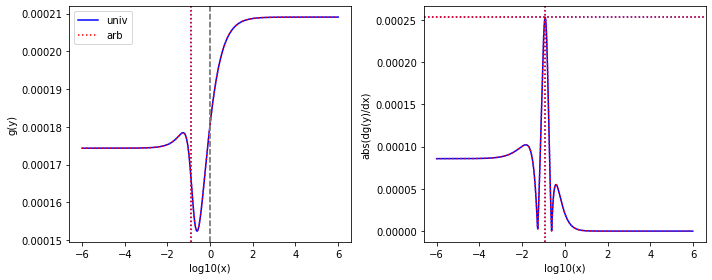

[6.53577e+00 1.00000e-03 2.64112e+00 2.39092e-03 4.11166e-03 1.00000e-03
 3.76429e-03 3.01609e-03 8.76973e+01 2.88285e-03]
found K1
found pairwise
found triplewise
0.40410234754282964 0.40410234754282964
0.0006291010852585081 0.0006291010852585081
0.0005759520301356994 0.0005759520301356994
13.418051736826724 13.418051736826726
# maximal error is 1.7763568394002505e-15
min-max are 3.529814346881038e-10 1039514687987.1451
From univ parameters, position and steepness are: 0.138076000926031 0.00025591614803294654 0.8125039845239866
From arb parameters, position and steepness are: 0.13807600092603098 0.00025591614803294654 0.8125039845239866


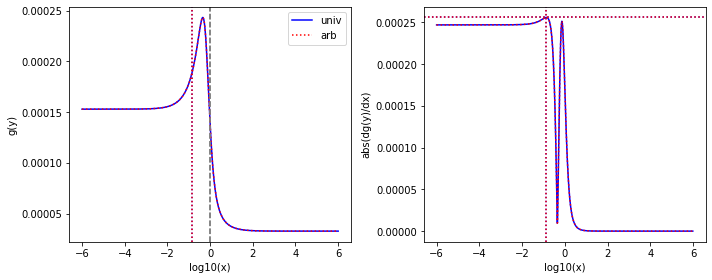

[1.16109e+00 1.16109e+00 2.33898e-02 1.00000e-03 2.69381e-03 1.00000e-03
 2.88184e+02 2.88184e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.020144691625972145 0.02014469162597214
0.0023200699342858866 0.0023200699342858866
248.20125916164986 248.2012591616499
0.0008612596784056361 0.0008612596784056362
# maximal error is 2.842170943040401e-14
min-max are 3.529814346881038e-10 3833640221949.3696
From univ parameters, position and steepness are: 0.14133074119878156 0.0008328285695822873 0.043169327812540806
From arb parameters, position and steepness are: 0.14133074119878156 0.0008328285695822871 0.043169327812540806


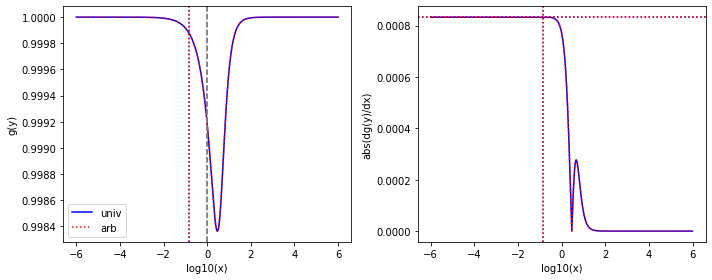

[1.20705e+00 1.00000e-03 2.67290e-03 1.00000e-03 4.39972e-03 1.00000e-03
 1.93959e+01 1.89625e-03 2.75931e+02 2.98830e-01]
found K1
found pairwise
found triplewise
0.002214407025392486 0.002214407025392486
0.003645018847603662 0.003645018847603662
16.068845532496585 16.068845532496585
228.59947806636012 228.59947806636006
# maximal error is 5.684341886080802e-14
min-max are 3.529814346881038e-10 6022961120391.269
From univ parameters, position and steepness are: 0.1534903303091922 0.0001557783841462178 0.183602072994819
From arb parameters, position and steepness are: 0.15349033030919212 0.00015577838414621784 0.18360207299481907


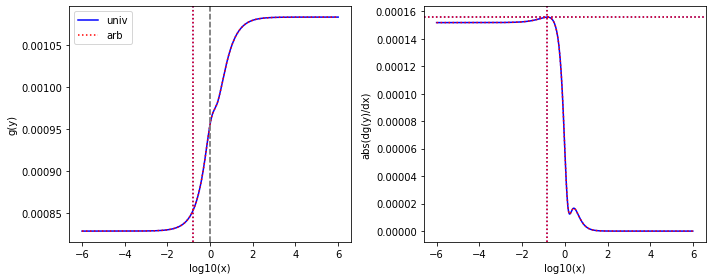

[1.07085e+02 1.00000e-03 1.00000e-03 1.00000e-03 3.98749e-02 5.15403e-03
 1.00000e+03 1.00000e-03 1.96288e+02 1.00000e-03]
found K1
found pairwise
found triplewise
9.338376056403791e-06 9.338376056403791e-06
0.00037236681141149556 0.0003723668114114956
9.338376056403792 9.338376056403792
1.8330111593593876 1.8330111593593879
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 3023873909109630.0
From univ parameters, position and steepness are: 0.16387781138389657 1.3556466859845916e-05 0.8164758100078888
From arb parameters, position and steepness are: 0.1638778113838966 1.3556466859845916e-05 0.8164758100078888


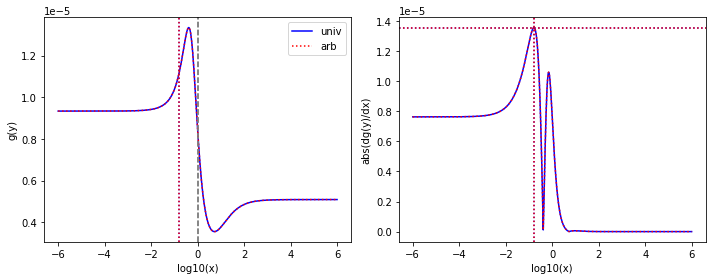

[4.62825e+02 1.00000e-03 2.42212e-03 1.00000e-03 1.00000e-03 1.00000e-03
 5.08409e+02 1.00000e-03 1.00000e+03 1.00000e-03]
found K1
found pairwise
found triplewise
5.233338734943012e-06 5.233338734943012e-06
2.1606438718738184e-06 2.1606438718738184e-06
1.0984907902554961 1.0984907902554961
2.1606438718738183 2.1606438718738183
# maximal error is 0.0
min-max are 2.498058915578641e-10 2061709317270785.0
From univ parameters, position and steepness are: 0.17454923756721213 3.395110456985166e-06 1.2183321908421918
From arb parameters, position and steepness are: 0.17454923756721213 3.395110456985166e-06 1.2183321908421918


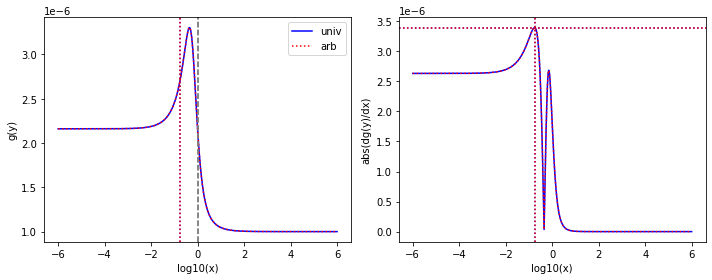

[3.20347e+02 3.20347e+02 1.77277e-01 1.00000e-03 4.85154e-03 1.00000e-03
 8.26273e+02 8.26273e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0005533905421308768 0.0005533905421308768
1.514464003096642e-05 1.5144640030966418e-05
2.579306189850381 2.579306189850381
3.1216149987357462e-06 3.1216149987357467e-06
# maximal error is 1.6940658945086007e-21
min-max are 7.027031419536454e-09 25024626113.54884
From univ parameters, position and steepness are: 0.1868956546028073 0.00010928123868209461 0.19838719041747538
From arb parameters, position and steepness are: 0.18689565460280727 0.00010928123868209461 0.19838719041747538


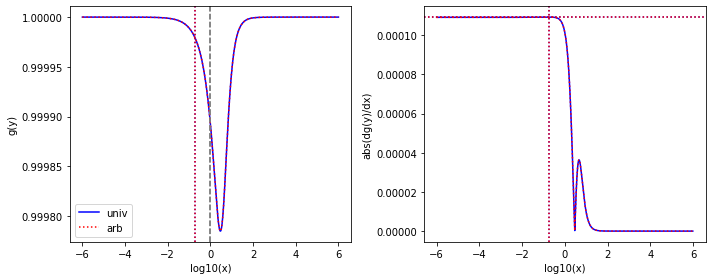

[7.48263e+02 1.00000e-03 3.25285e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.85009e+02 1.00000e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.0043472014518959245 0.0043472014518959245
1.336428501743371e-06 1.336428501743371e-06
0.2472513006790393 0.2472513006790393
0.029790060446661135 0.02979006044666114
# maximal error is 3.469446951953614e-18
min-max are 7.027031419536454e-09 2208193520.064535
From univ parameters, position and steepness are: 0.1927485987281412 4.825283173677185e-05 6.508095296185574
From arb parameters, position and steepness are: 0.19274859872814126 4.825283173677184e-05 6.508095296185572


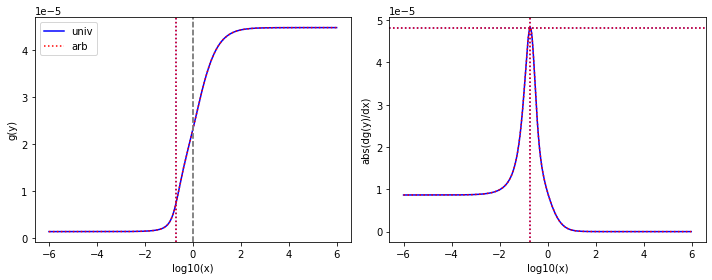

[3.01478e+00 1.00000e-03 2.54069e+00 1.17907e-03 4.61392e-02 1.00000e-03
 1.00000e-03 1.00000e-03 5.86094e+00 1.00000e-03]
found K1
found pairwise
found triplewise
0.8427447442267761 0.8427447442267761
0.015304333981252362 0.015304333981252362
0.0003316991621279165 0.0003316991621279165
1.944068887281991 1.944068887281991
# maximal error is 0.0
min-max are 3.529814346881038e-10 25288595902245.594
From univ parameters, position and steepness are: 0.20013907890026425 0.00046657754689404966 1.8725328573164717
From arb parameters, position and steepness are: 0.20013907890026425 0.00046657754689404966 1.8725328573164715


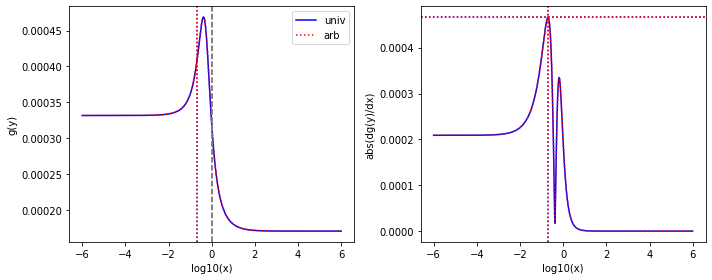

[6.16441e+00 1.00000e-03 1.11786e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 1.83174e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.18134095558212385 0.18134095558212385
0.0001622215264721198 0.0001622215264721198
0.0001622215264721198 0.0001622215264721198
2.971476589000407 2.9714765890004067
# maximal error is 4.440892098500626e-16
min-max are 3.529814346881038e-10 268051675641.12668
From univ parameters, position and steepness are: 0.21462133595803007 0.00025564745616765754 1.2866241369086426
From arb parameters, position and steepness are: 0.21462133595803007 0.00025564745616765754 1.2866241369086426


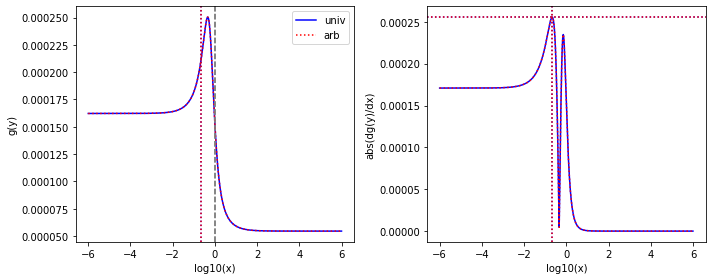

[2.55143e+01 6.37426e-02 4.00604e-01 2.29237e-03 1.00000e-03 1.00000e-03
 7.21789e-01 7.21789e-01 2.75931e+02 1.38000e-03]
found K1
found pairwise
found triplewise
0.015701155822421153 0.01570115582242115
3.9193707058394705e-05 3.9193707058394705e-05
0.028289586623971658 0.028289586623971658
10.814758782329909 10.814758782329907
# maximal error is 1.7763568394002505e-15
min-max are 3.529814346881038e-10 64762851542.00234
From univ parameters, position and steepness are: 0.22541899208325394 0.005672579075163574 1.4546037774292782
From arb parameters, position and steepness are: 0.22541899208325394 0.0056725790751635755 1.4546037774292784


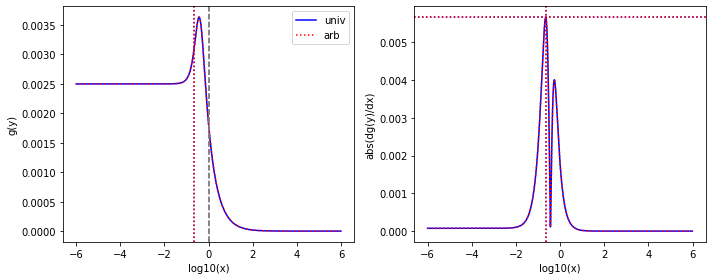

[7.54889e+02 1.49248e-02 5.82624e-03 1.00000e-03 7.50788e-02 1.00000e-03
 1.00000e-03 1.00000e-03 6.98766e+01 1.00000e-03]
found K1
found pairwise
found triplewise
7.71800887282766e-06 7.71800887282766e-06
9.945674132223413e-05 9.945674132223413e-05
1.3246980681928071e-06 1.3246980681928071e-06
0.0925653970318815 0.09256539703188148
# maximal error is 2.7755575615628914e-17
min-max are 2.498058915578641e-10 807431861098844.6
From univ parameters, position and steepness are: 0.23949280375733695 1.6720757436828935e-05 3.7636595987779753
From arb parameters, position and steepness are: 0.23949280375733695 1.6720757436828938e-05 3.7636595987779757


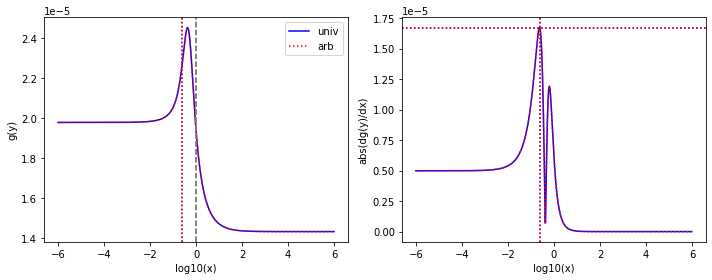

[5.91048e+00 1.00000e-03 2.86511e+00 1.00000e-03 7.09905e-02 6.88141e-03
 1.66617e-03 1.00000e-03 9.42112e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.48475081550060234 0.48475081550060234
0.012010953425102529 0.012010953425102529
0.0002819009623583872 0.0002819009623583872
15.939686793627592 15.939686793627592
# maximal error is 0.0
min-max are 3.529814346881038e-10 19846675358538.434
From univ parameters, position and steepness are: 0.2449147485557567 0.00032550365060821383 0.8359478246964335
From arb parameters, position and steepness are: 0.2449147485557567 0.0003255036506082137 0.8359478246964334


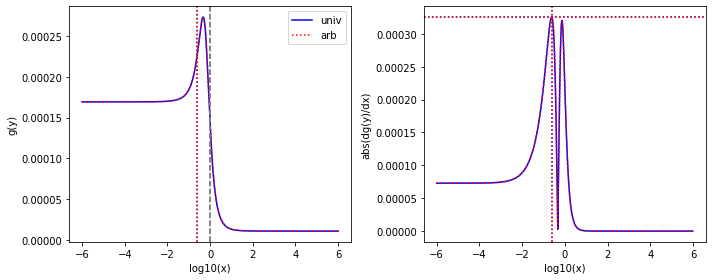

[9.45017e+00 1.00000e-03 8.27102e+00 1.00000e-03 4.71523e-02 2.85971e-02
 3.59408e-03 3.59408e-03 1.00000e+03 3.55146e-03]
found K1
found pairwise
found triplewise
0.8752244668614427 0.8752244668614427
0.004989571616171984 0.004989571616171984
0.00038031908420695077 0.0003803190842069507
105.81820221223533 105.81820221223533
# maximal error is 5.421010862427522e-20
min-max are 3.529814346881038e-10 8244674784368.462
From univ parameters, position and steepness are: 0.25586993885702913 0.0003177241046411842 0.5577886595053472
From arb parameters, position and steepness are: 0.25586993885702913 0.00031772410464118414 0.5577886595053472


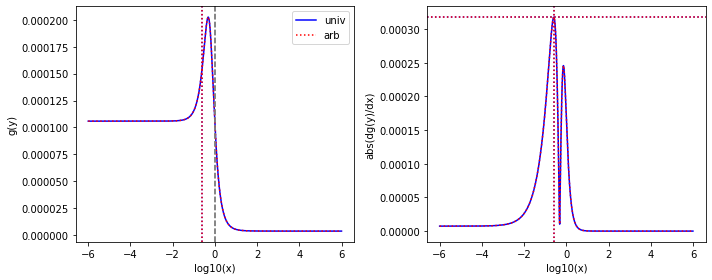

[6.54741e+00 1.18448e-02 2.86511e+00 1.00000e-03 7.09905e-02 6.61945e-02
 1.00000e-03 1.00000e-03 2.26106e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.43759440755963047 0.43759440755963047
0.010842531627009764 0.010842531627009763
0.00015273214904824961 0.00015273214904824961
3.4533655292703527 3.4533655292703527
# maximal error is 1.734723475976807e-18
min-max are 3.529814346881038e-10 17915996968700.32
From univ parameters, position and steepness are: 0.260203958387118 0.005131185114474963 1.334611395395418
From arb parameters, position and steepness are: 0.260203958387118 0.005131185114474963 1.334611395395418


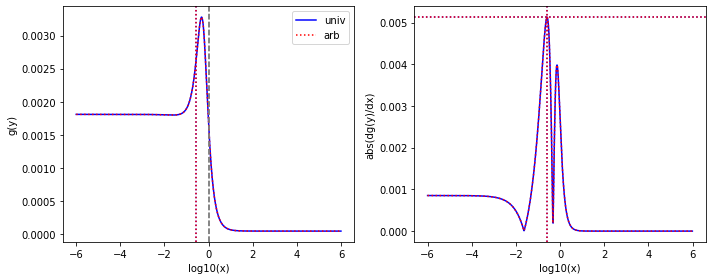

[7.54889e+02 1.44959e-02 1.53563e-03 1.44053e-03 1.00000e-03 1.00000e-03
 8.20140e+01 1.00000e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
2.0342460944589204e-06 2.0342460944589204e-06
1.3246980681928071e-06 1.3246980681928071e-06
0.10864378736476488 0.10864378736476488
0.029528579698472227 0.02952857969847223
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 331006942099609.0
From univ parameters, position and steepness are: 0.2720470310468805 1.902196268502208e-05 5.0633608502950045
From arb parameters, position and steepness are: 0.27204703104688055 1.9021962685022078e-05 5.063360850295004


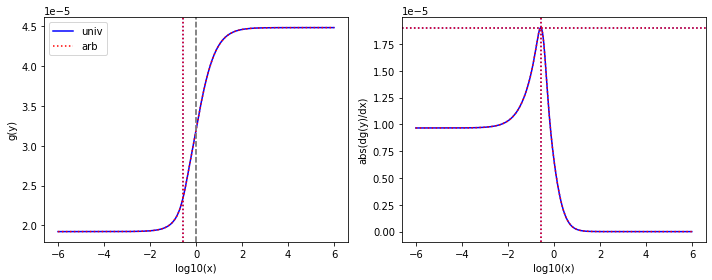

[7.54889e+02 1.49248e-02 1.00000e-03 1.00000e-03 1.03663e-01 2.53099e-03
 8.20140e+01 1.00000e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
0.00013732217584307098 0.00013732217584307098
0.10864378736476488 0.10864378736476486
0.029528579698472227 0.029528579698472224
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 1115241601874234.9
From univ parameters, position and steepness are: 0.2826008997995223 2.3460771382759835e-05 3.9274577926712926
From arb parameters, position and steepness are: 0.2826008997995223 2.346077138275983e-05 3.9274577926712926


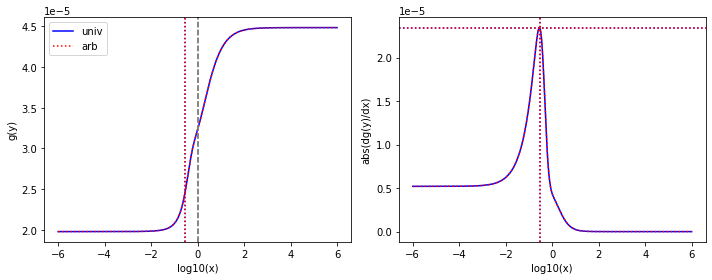

[7.54889e+02 1.49248e-02 1.00000e-03 1.00000e-03 1.03663e-01 1.00000e-03
 8.20140e+01 1.00000e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
0.00013732217584307098 0.00013732217584307098
0.10864378736476488 0.10864378736476486
0.029528579698472227 0.029528579698472224
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 1115241601874234.9
From univ parameters, position and steepness are: 0.2973899879424862 1.870241840037719e-05 5.3308420373098215
From arb parameters, position and steepness are: 0.2973899879424862 1.8702418400377185e-05 5.3308420373098215


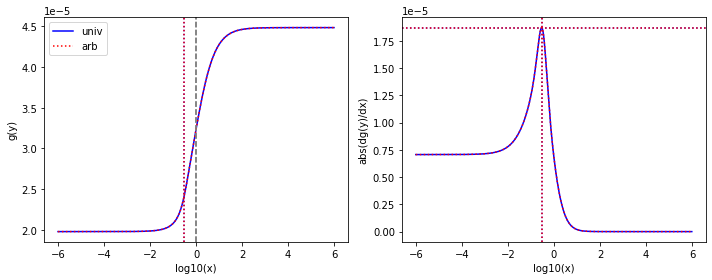

[1.54698e+00 1.54698e+00 9.07904e-03 1.75713e-03 1.64978e-03 1.00000e-03
 1.14484e+01 1.14484e+01 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.005868880011377005 0.005868880011377005
0.0010664520549716222 0.0010664520549716222
7.400483522734618 7.400483522734618
0.0006464207682064409 0.0006464207682064409
# maximal error is 0.0
min-max are 3.529814346881038e-10 1762185404885.5198
From univ parameters, position and steepness are: 0.3038536473355139 0.0006741696831140552 0.14176470922203097
From arb parameters, position and steepness are: 0.3038536473355139 0.0006741696831140551 0.141764709222031


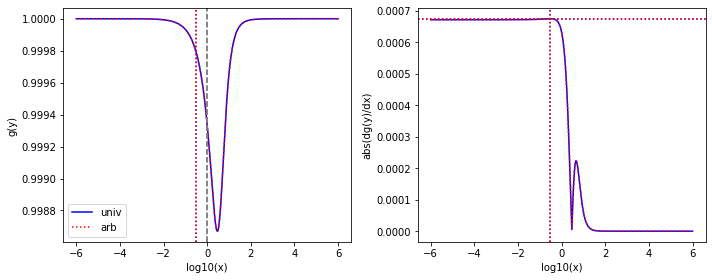

[1.00000e+03 9.18988e-02 2.19210e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.97855e+01 1.00000e-03 2.15183e+00 1.00000e-03]
found K1
found pairwise
found triplewise
2.1921e-06 2.1921e-06
1e-06 1e-06
0.019785499999999998 0.019785499999999998
0.00215183 0.00215183
# maximal error is 0.0
min-max are 2.498058915578641e-10 80135242564015.5
From univ parameters, position and steepness are: 0.3247555679244176 0.0003377104619656666 11.315683538954683
From arb parameters, position and steepness are: 0.3247555679244177 0.0003377104619656665 11.315683538954682


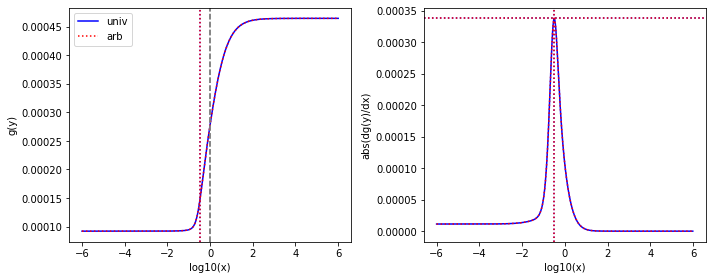

[7.54889e+02 1.49248e-02 5.82624e-03 1.00000e-03 5.39152e-02 3.04343e-03
 8.20140e+01 1.00000e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
7.71800887282766e-06 7.71800887282766e-06
7.142136128622885e-05 7.142136128622885e-05
0.10864378736476488 0.10864378736476486
0.029528579698472227 0.029528579698472227
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 579735049333742.4
From univ parameters, position and steepness are: 0.33921598893760146 2.1996457931588998e-05 3.1811895990340013
From arb parameters, position and steepness are: 0.3392159889376015 2.199645793158899e-05 3.1811895990340004


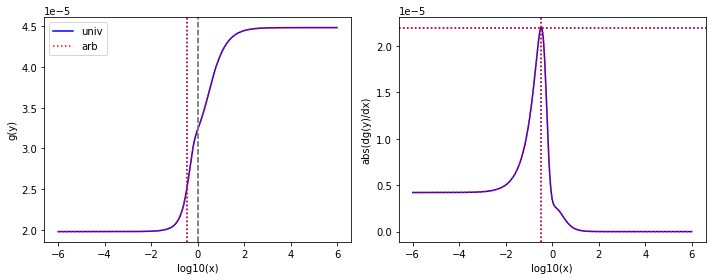

[2.89549e+02 3.26782e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 8.20140e+01 1.00000e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
3.453646878421269e-06 3.453646878421269e-06
3.453646878421269e-06 3.453646878421269e-06
0.28324739508684194 0.28324739508684194
0.07698455183751284 0.07698455183751284
# maximal error is 0.0
min-max are 2.498058915578641e-10 330061844009322.3
From univ parameters, position and steepness are: 0.3416291104138664 2.6998225867403202e-05 2.7781783066305064
From arb parameters, position and steepness are: 0.34162911041386645 2.69982258674032e-05 2.778178306630506


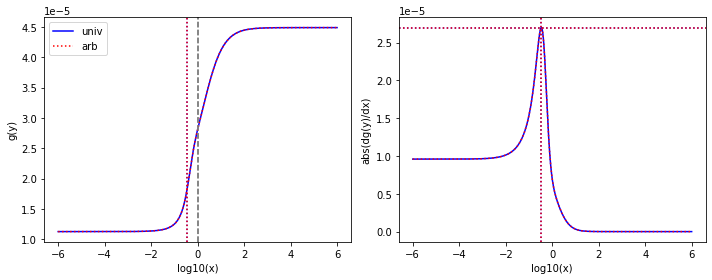

[5.09482e-01 5.09482e-01 6.11692e-03 1.00000e-03 2.27095e-03 1.00000e-03
 3.41768e+01 3.41768e+01 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.012006155271432553 0.012006155271432555
0.0044573704272182334 0.0044573704272182334
67.08146705869883 67.08146705869883
0.0019627778802784007 0.0019627778802784003
# maximal error is 1.734723475976807e-18
min-max are 3.529814346881038e-10 7365275728611.223
From univ parameters, position and steepness are: 0.3520802483288886 0.0006937970125408891 0.06855862528995482
From arb parameters, position and steepness are: 0.35208024832888857 0.000693797012540889 0.06855862528995481


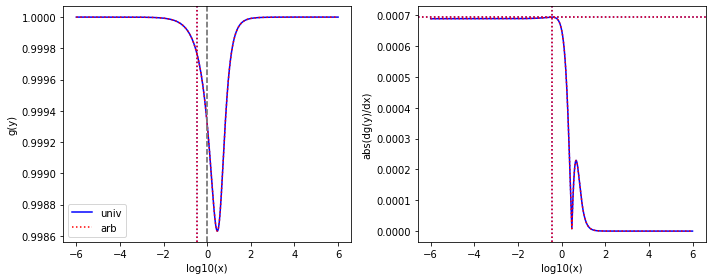

[3.86542e+02 1.00000e-03 6.07471e-03 6.07471e-03 4.38524e-02 4.79008e-03
 1.00000e+03 1.00000e-03 5.30020e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1.5715523798190105e-05 1.5715523798190105e-05
0.00011344795649631865 0.00011344795649631865
2.5870409942515953 2.5870409942515953
0.13711834677732304 0.13711834677732304
# maximal error is 0.0
min-max are 2.498058915578641e-10 920720589583313.2
From univ parameters, position and steepness are: 0.3621394710860417 9.914246929880703e-06 0.5286432943953632
From arb parameters, position and steepness are: 0.3621394710860415 9.914246929880706e-06 0.5286432943953635


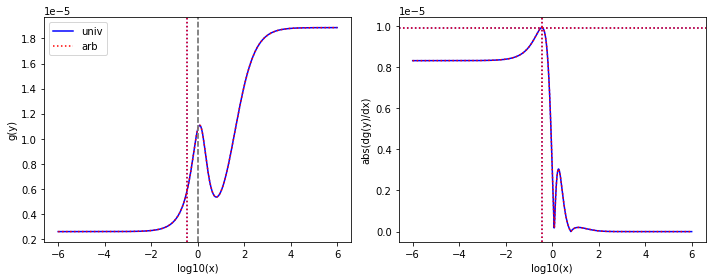

[4.26081e+02 4.26081e+02 2.05973e-02 7.71394e-03 1.51881e-03 1.00000e-03
 9.91660e+01 9.91660e+01 2.03987e-02 2.03987e-02]
found K1
found pairwise
found triplewise
4.834127783214928e-05 4.834127783214928e-05
3.564603913340421e-06 3.564603913340421e-06
0.23273978421943245 0.23273978421943245
4.787516927532558e-05 4.7875169275325566e-05
# maximal error is 1.3552527156068805e-20
min-max are 2.498058915578641e-10 281636514121812.75
From univ parameters, position and steepness are: 0.3722266042655558 1.385957548382934e-05 0.45424595605988843
From arb parameters, position and steepness are: 0.37222660426555587 1.3859575483829336e-05 0.45424595605988843


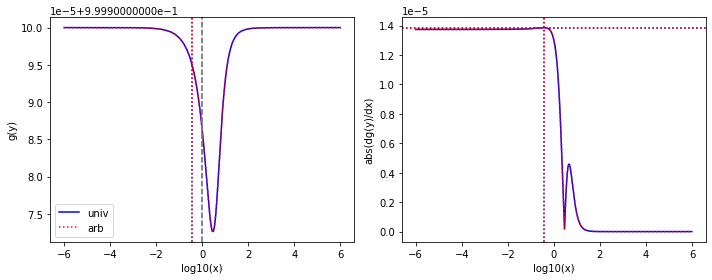

[7.54889e+02 1.15008e-02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 8.20140e+01 1.00000e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
1.3246980681928071e-06 1.3246980681928071e-06
0.10864378736476488 0.10864378736476489
0.029528579698472227 0.02952857969847223
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 330061162530546.7
From univ parameters, position and steepness are: 0.38684771713576666 2.3074760144072822e-05 4.015866355045882
From arb parameters, position and steepness are: 0.38684771713576666 2.3074760144072815e-05 4.0158663550458815


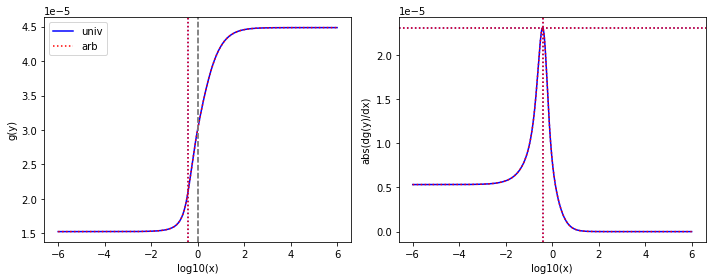

[2.88194e+02 5.14839e-02 6.19033e-01 1.97171e-03 1.00000e+03 5.49251e-03
 5.86173e-01 5.86173e-01 1.14571e+01 5.81608e-03]
found K1
found pairwise
found triplewise
0.0021479732402478885 0.0021479732402478885
3.469884869220039 3.469884869220039
0.0020339528234453183 0.0020339528234453183
0.039754817935140914 0.039754817935140914
# maximal error is 0.0
min-max are 3.529814346881038e-10 5733573093547061.0
From univ parameters, position and steepness are: 0.4030147046975871 0.0017707054679337471 2.959140769234276
From arb parameters, position and steepness are: 0.40301470469758716 0.0017707054679337473 2.959140769234276


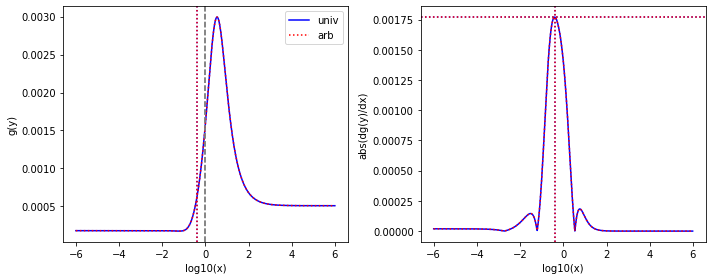

[2.40109e+02 2.40109e+02 6.91685e-03 1.12843e-03 1.33157e-03 1.00000e-03
 7.58282e+01 7.58282e+01 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.880712509735162e-05 2.880712509735162e-05
5.545689665943384e-06 5.545689665943384e-06
0.31580740413728764 0.31580740413728764
4.164775164612738e-06 4.164775164612738e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 234424033796508.75
From univ parameters, position and steepness are: 0.4172856098950578 1.0120379661605504e-05 0.414330981843357
From arb parameters, position and steepness are: 0.41728560989505786 1.0120379661605504e-05 0.414330981843357


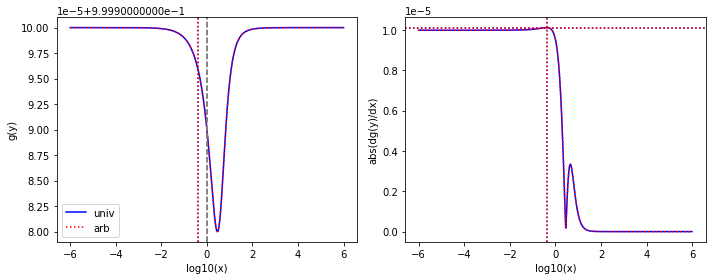

[6.18880e+01 1.00000e-03 4.51584e-01 9.82442e-02 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 7.54121e+00 1.00000e-03]
found K1
found pairwise
found triplewise
0.007296794208893485 0.007296794208893485
1.6158221302998967e-05 1.6158221302998967e-05
1.6158221302998967e-05 1.6158221302998967e-05
0.12185254007238884 0.12185254007238885
# maximal error is 1.3877787807814457e-17
min-max are 3.529814346881038e-10 26699446802.6598
From univ parameters, position and steepness are: 0.42229102885738645 0.0008021148480684186 0.504466241141644
From arb parameters, position and steepness are: 0.42229102885738645 0.0008021148480684186 0.504466241141644


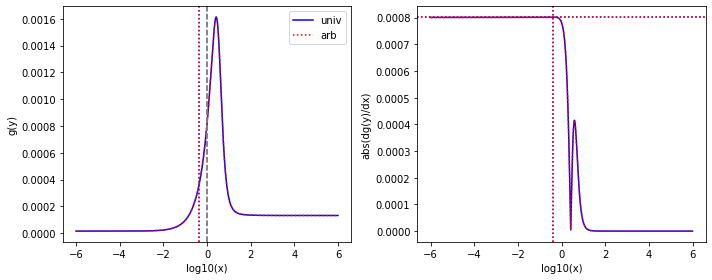

[7.54889e+02 1.00000e-03 1.00000e-03 1.00000e-03 3.52417e-02 3.52417e-02
 9.54732e+02 1.00000e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
4.668461190983045e-05 4.668461190983045e-05
1.264731636041855 1.264731636041855
0.029528579698472227 0.029528579698472227
# maximal error is 0.0
min-max are 2.498058915578641e-10 379104467037836.75
From univ parameters, position and steepness are: 0.437184791129773 3.6193120288703955e-05 1.0990337039027869
From arb parameters, position and steepness are: 0.43718479112977454 3.619312028870384e-05 1.099033703902783


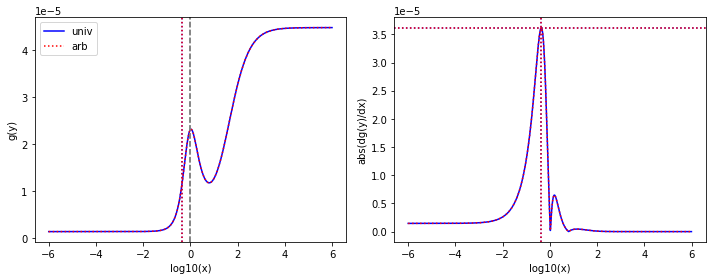

[7.54889e+02 2.15462e-03 1.20862e-02 3.78254e-03 3.20433e+00 1.27966e-03
 8.20140e+01 1.00000e-03 2.22908e+01 1.95861e-01]
found K1
found pairwise
found triplewise
1.6010565791791904e-05 1.6010565791791904e-05
0.004244769760852258 0.004244769760852258
0.10864378736476488 0.10864378736476489
0.029528579698472227 0.02952857969847223
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 3.4474339108472916e+16
From univ parameters, position and steepness are: 0.44854544069840196 0.0077019276445058 4.168254947489265
From arb parameters, position and steepness are: 0.448545440698402 0.0077019276445058 4.168254947489264


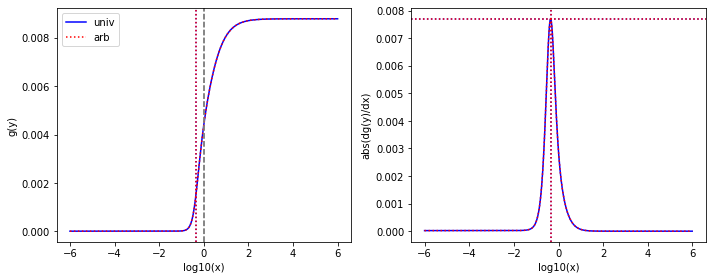

[7.54889e+02 8.87766e-03 2.35301e-03 1.00000e-03 1.37859e+00 1.00000e-03
 8.20140e+01 1.00000e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
3.1170278014383573e-06 3.1170278014383573e-06
0.001826215509829922 0.001826215509829922
0.10864378736476488 0.10864378736476488
0.029528579698472227 0.029528579698472234
# maximal error is 6.938893903907228e-18
min-max are 2.498058915578641e-10 1.4831961745792116e+16
From univ parameters, position and steepness are: 0.4519943071440583 2.5434603383143617e-05 3.4318078261342224
From arb parameters, position and steepness are: 0.45199430714405836 2.5434603383143614e-05 3.431807826134222


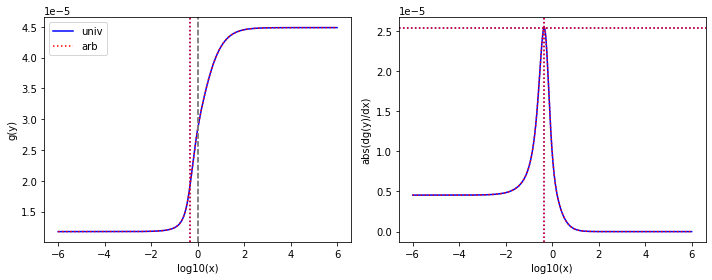

[1.00000e+03 1.06856e-02 1.01866e-02 1.00000e-03 1.00000e-03 1.00000e-03
 1.94519e+01 1.36141e-03 3.10739e+00 2.27996e-02]
found K1
found pairwise
found triplewise
1.01866e-05 1.01866e-05
1e-06 1.0000000000000002e-06
0.019451899999999998 0.019451899999999998
0.0031073900000000002 0.0031073900000000007
# maximal error is 4.336808689942018e-19
min-max are 2.498058915578641e-10 82317058364593.02
From univ parameters, position and steepness are: 0.4643203700372293 0.0064045361288637935 7.05925339149662
From arb parameters, position and steepness are: 0.46432037003722937 0.006404536128863794 7.059253391496619


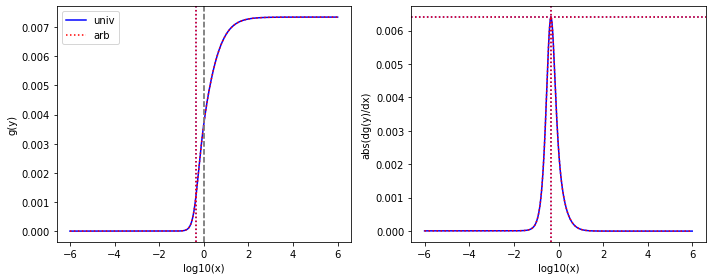

[1.33411e-01 1.33411e-01 2.40713e-02 1.00000e-03 2.00612e-02 1.00000e-03
 2.13193e+01 2.13193e+01 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.18042964972903283 0.18042964972903283
0.15037140865445878 0.15037140865445878
159.80166552982885 159.80166552982882
0.007495633793315394 0.007495633793315395
# maximal error is 2.842170943040401e-14
min-max are 3.529814346881038e-10 248470913210208.88
From univ parameters, position and steepness are: 0.47755719441794015 0.00940244660010145 0.0532149185227143
From arb parameters, position and steepness are: 0.47755719441794015 0.00940244660010145 0.0532149185227143


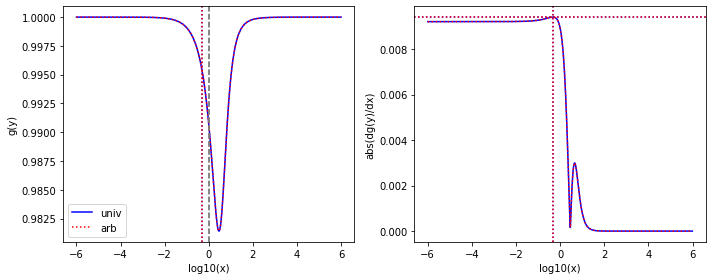

[1.00000e+03 1.12798e+00 1.60590e-03 1.00000e-03 1.00000e-03 1.00000e-03
 8.20140e+01 9.09718e-02 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1.6059e-06 1.6059e-06
1e-06 1e-06
0.08201399999999999 0.08201399999999999
0.0222908 0.0222908
# maximal error is 0.0
min-max are 2.498058915578641e-10 331131061079172.44
From univ parameters, position and steepness are: 0.48096980452157634 0.000946336207768835 4.186292380633018
From arb parameters, position and steepness are: 0.4809698045215763 0.0009463362077688351 4.186292380633019


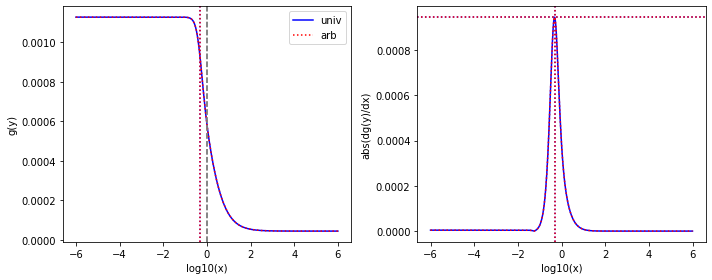

[2.88194e+02 5.22380e-01 3.11296e-02 2.30785e-03 7.53809e+01 1.84629e-02
 7.00059e+02 7.39480e-01 1.14571e+01 5.96283e-03]
found K1
found pairwise
found triplewise
0.00010801612802487213 0.00010801612802487213
0.26156304433818883 0.26156304433818883
2.429124131661311 2.429124131661311
0.039754817935140914 0.03975481793514092
# maximal error is 6.938893903907228e-18
min-max are 2.439715342954195e-10 2.689351557753425e+16
From univ parameters, position and steepness are: 0.49561237184332313 0.001030477385373503 1.0807266386485628
From arb parameters, position and steepness are: 0.495612371843323 0.0010304773853735032 1.080726638648563


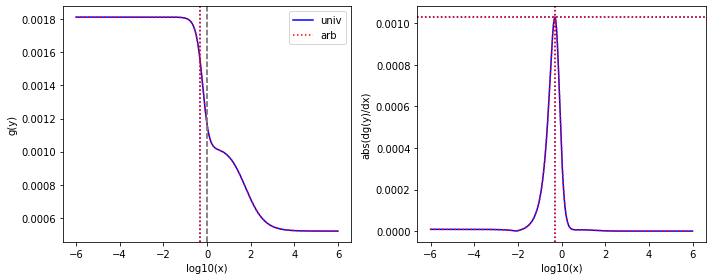

[1.00000e-03 1.00000e-03 4.47281e-01 4.47281e-01 1.30493e-03 1.00000e-03
 2.98461e+02 2.98461e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
447.28099999999995 447.28099999999995
1.30493 1.30493
298461.0 298461.0
1.0 1.0
# maximal error is 0.0
min-max are 3.529814346881038e-10 2156241873083252.8
From univ parameters, position and steepness are: 0.5016353755742475 7.265309901146791e-06 0.012077351500504726
From arb parameters, position and steepness are: 0.5016353755742475 7.265309901146791e-06 0.012077351500504726


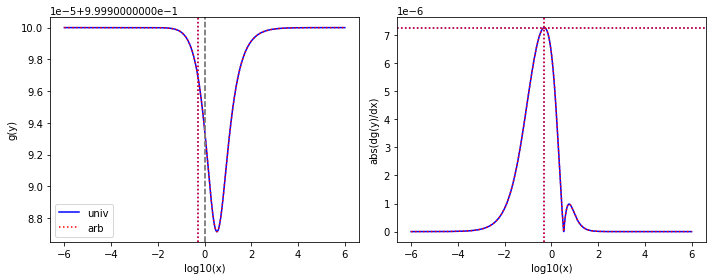

[7.48263e+02 1.34453e+00 2.33259e-03 1.00000e-03 4.47561e-03 1.00000e-03
 2.67319e+01 1.39015e-01 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
3.1173397588815692e-06 3.1173397588815692e-06
5.981332766687648e-06 5.981332766687648e-06
0.03572527306575362 0.03572527306575362
0.029790060446661135 0.029790060446661132
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 48444681718336.125
From univ parameters, position and steepness are: 0.5103457074030586 0.0018746000362289913 5.582809560901139
From arb parameters, position and steepness are: 0.5103457074030586 0.0018746000362289913 5.582809560901139


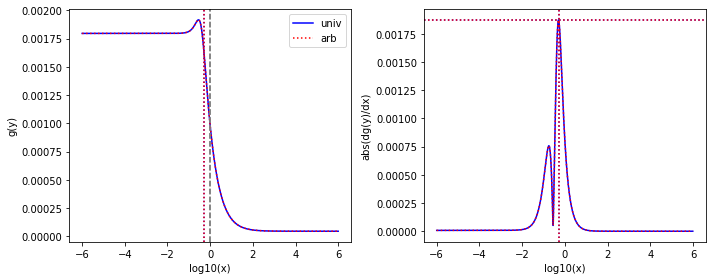

[1.00000e-03 1.00000e-03 1.53137e-03 1.00000e-03 6.91502e-03 1.00000e-03
 2.77368e+02 2.77368e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.53137 1.53137
6.91502 6.915020000000001
277368.0 277367.99999999994
1.0 1.0000000000000002
# maximal error is 5.820766091346741e-11
min-max are 3.529814346881038e-10 1.1426250180143696e+16
From univ parameters, position and steepness are: 0.5264987780779828 0.0024546079412145366 0.0044843305210950455
From arb parameters, position and steepness are: 0.526498778077983 0.002454607941214536 0.0044843305210950455


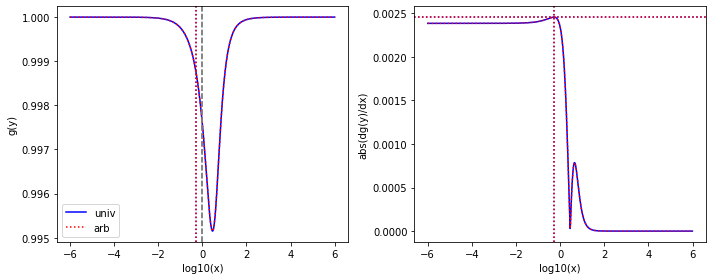

[8.23550e+02 2.17511e-03 1.00000e-03 1.00000e-03 1.03651e-03 1.00000e-03
 8.97553e+01 1.00000e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1.2142553579017669e-06 1.2142553579017669e-06
1.2585878210187604e-06 1.2585878210187604e-06
0.10898585392508045 0.10898585392508044
0.027066723331916703 0.027066723331916707
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 348426649681024.8
From univ parameters, position and steepness are: 0.5373981031233562 3.245658376884712e-05 2.9162836630124063
From arb parameters, position and steepness are: 0.5373981031233563 3.245658376884712e-05 2.9162836630124063


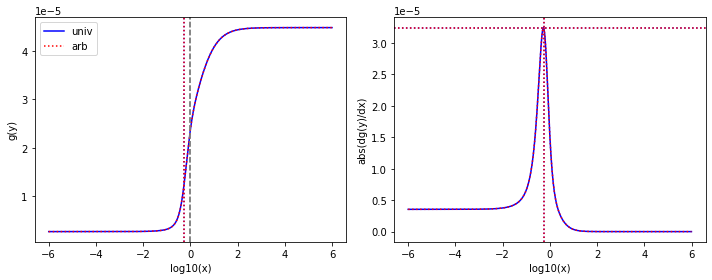

[5.04005e-02 5.04005e-02 1.61103e-03 1.00000e-03 4.09510e-03 3.19158e-03
 3.88595e+01 3.88595e+01 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.03196456384361266 0.03196456384361266
0.08125117806370968 0.08125117806370968
771.0141764466622 771.0141764466622
0.019841073005228124 0.019841073005228124
# maximal error is 0.0
min-max are 3.529814346881038e-10 134257932342944.33
From univ parameters, position and steepness are: 0.5454927869218368 0.00040004538468835205 0.03192484349900517
From arb parameters, position and steepness are: 0.545492786921837 0.000400045384688352 0.03192484349900518


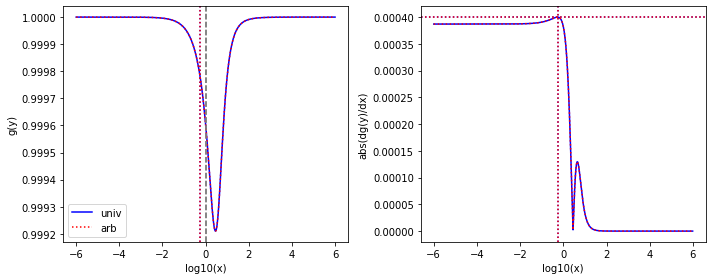

[1.00000e+03 5.96330e-03 1.00000e-03 1.00000e-03 1.03663e-01 1.00000e-03
 8.20140e+01 1.00000e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
0.000103663 0.000103663
0.08201399999999999 0.08201399999999999
0.0222908 0.022290800000000003
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 841883626388934.5
From univ parameters, position and steepness are: 0.5599534452942537 2.9877616913342593e-05 3.0639219524639967
From arb parameters, position and steepness are: 0.5599534452942538 2.9877616913342593e-05 3.0639219524639967


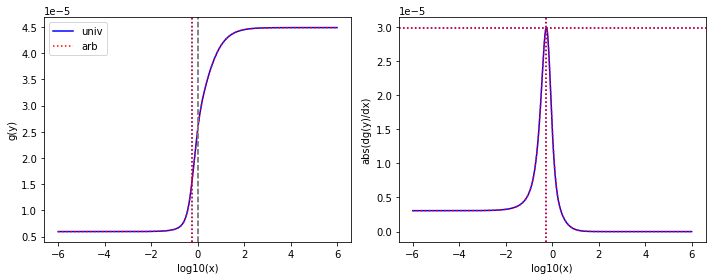

[7.54889e+02 3.05924e-03 1.12375e-01 1.00000e-03 6.76538e-02 1.00000e-03
 8.20140e+01 1.00000e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.0001488629454131667 0.0001488629454131667
8.962085816590253e-05 8.962085816590253e-05
0.10864378736476488 0.10864378736476489
0.029528579698472227 0.029528579698472224
# maximal error is 1.3877787807814457e-17
min-max are 3.529814346881038e-10 148087741158.9531
From univ parameters, position and steepness are: 0.5607894033452562 3.0960069345097334e-05 2.7507499406934652
From arb parameters, position and steepness are: 0.5607894033452562 3.096006934509733e-05 2.7507499406934652


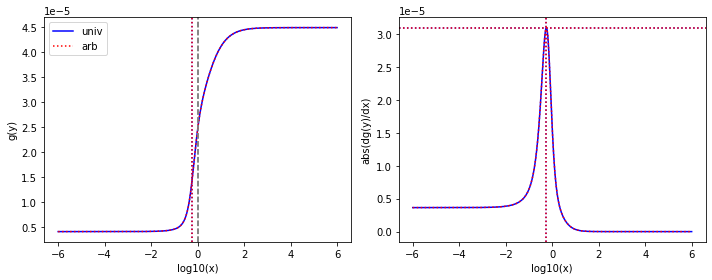

[8.56424e+00 8.56424e+00 1.00000e-03 1.00000e-03 3.42131e+00 3.42131e+00
 1.00000e-03 1.00000e-03 1.31187e-03 1.30462e-03]
found K1
found pairwise
found triplewise
0.000116764593238863 0.000116764593238863
0.3994878704940544 0.39948787049405443
0.000116764593238863 0.000116764593238863
0.0001531799669322672 0.0001531799669322672
# maximal error is 5.551115123125783e-17
min-max are 3.529814346881038e-10 660106312313312.6
From univ parameters, position and steepness are: 0.5716987369983383 0.0035923534899312804 51.47504955212184
From arb parameters, position and steepness are: 0.5716987369983383 0.003592353489931285 51.47504955212184


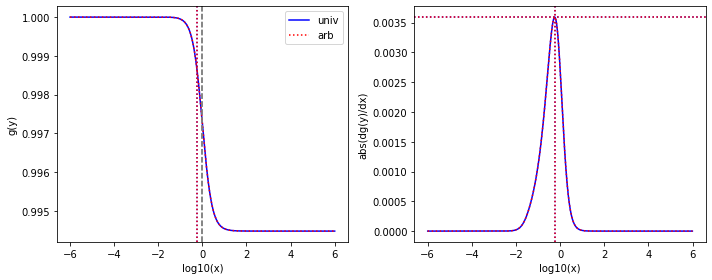

[7.54889e+02 1.00000e-03 1.09370e-02 1.00000e-03 4.79089e-02 1.00000e-03
 8.20140e+01 1.00000e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1.4488222771824732e-05 1.4488222771824732e-05
6.346482727924237e-05 6.346482727924237e-05
0.10864378736476488 0.10864378736476489
0.029528579698472227 0.02952857969847223
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 514822173536628.56
From univ parameters, position and steepness are: 0.5866991925176588 3.311119011430671e-05 2.627441233372503
From arb parameters, position and steepness are: 0.5866991925176588 3.3111190114306705e-05 2.627441233372503


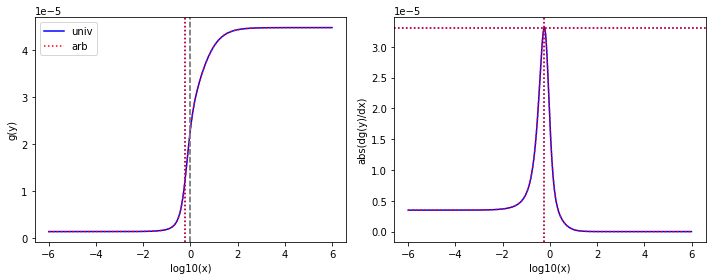

[1.61858e-01 1.00000e-03 1.35924e-03 1.35924e-03 2.08389e-01 2.08389e-01
 4.58052e+02 5.46603e-02 8.22592e-01 1.00000e-03]
found K1
found pairwise
found triplewise
0.008397731344758987 0.008397731344758989
1.2874803840403315 1.2874803840403315
2829.962065514216 2829.9620655142166
5.082183148191625 5.082183148191625
# maximal error is 4.547473508864641e-13
min-max are 3.529814346881038e-10 2127408593198569.5
From univ parameters, position and steepness are: 0.5905746078157557 0.006906999523622634 0.14279400152832336
From arb parameters, position and steepness are: 0.5905746078157557 0.006906999523622633 0.14279400152832333


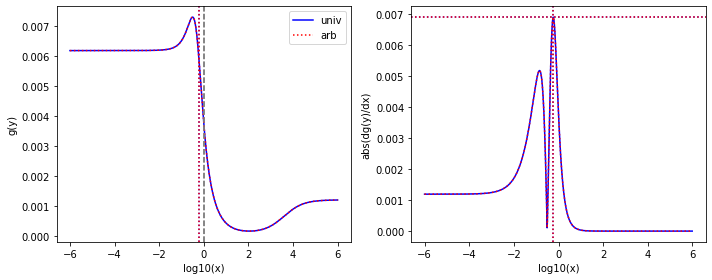

[7.54889e+02 2.80431e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 8.20140e+01 1.28034e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
1.3246980681928071e-06 1.3246980681928071e-06
0.10864378736476488 0.10864378736476489
0.029528579698472227 0.02952857969847223
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 330061162530546.7
From univ parameters, position and steepness are: 0.6095411598475893 3.1117585445375e-05 2.4993503668105497
From arb parameters, position and steepness are: 0.6095411598475893 3.111758544537499e-05 2.4993503668105497


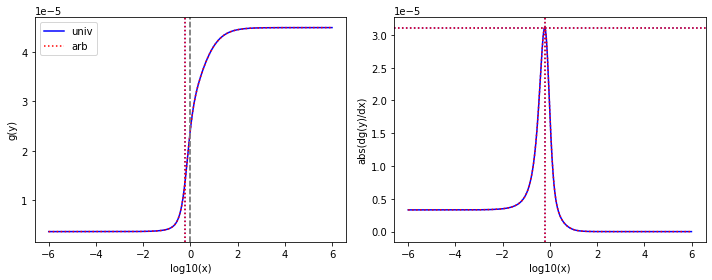

[2.88194e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.53193e+02 1.00000e-03
 1.00000e-03 1.00000e-03 1.14571e+01 1.97531e-02]
found K1
found pairwise
found triplewise
3.4698848692200393e-06 3.4698848692200393e-06
0.5315620727704254 0.5315620727704254
3.4698848692200393e-06 3.4698848692200393e-06
0.039754817935140914 0.039754817935140914
# maximal error is 0.0
min-max are 2.360183595459028e-10 4.3172229118475254e+18
From univ parameters, position and steepness are: 0.6148457020845528 0.0012747319230348533 3.8249239538605178
From arb parameters, position and steepness are: 0.6148457020845528 0.001274731923034853 3.8249239538605173


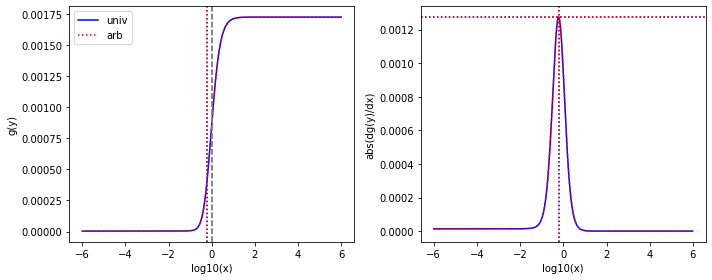

[2.88194e+02 1.00000e-03 1.36681e-02 2.15824e-03 1.60353e+02 1.91846e-03
 1.00000e-03 1.00000e-03 1.14571e+01 5.33830e-03]
found K1
found pairwise
found triplewise
4.7426733380986415e-05 4.7426733380986415e-05
0.556406448434041 0.556406448434041
3.4698848692200393e-06 3.4698848692200393e-06
0.039754817935140914 0.03975481793514091
# maximal error is 6.938893903907228e-18
min-max are 2.360183595459028e-10 4.519001236711892e+18
From univ parameters, position and steepness are: 0.6203650088786152 0.0003271994633575286 3.703698878374935
From arb parameters, position and steepness are: 0.6203650088786152 0.00032719946335752853 3.703698878374935


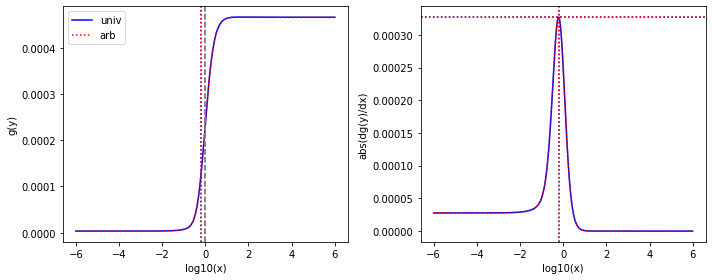

[7.43850e+01 1.65235e-01 4.07409e+00 1.00000e-03 1.49163e-02 1.00000e-03
 2.59473e+02 2.45308e+00 8.56864e-02 1.00000e-03]
found K1
found pairwise
found triplewise
0.054770316596087915 0.054770316596087915
0.00020052833232506553 0.0002005283323250655
3.488243597499496 3.4882435974994954
0.0011519311689184646 0.0011519311689184646
# maximal error is 4.440892098500626e-16
min-max are 3.529814346881038e-10 331349167466.09247
From univ parameters, position and steepness are: 0.6353595810363865 0.007515486398812954 0.8306480065621986
From arb parameters, position and steepness are: 0.6353595810363865 0.007515486398812954 0.8306480065621986


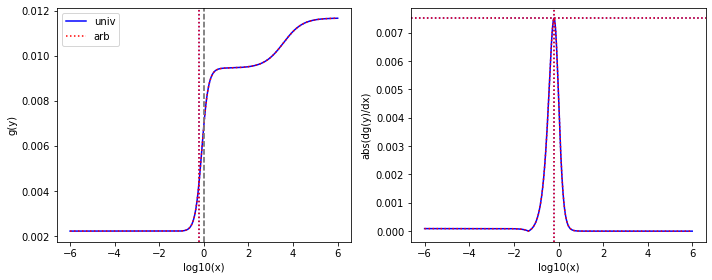

[4.51482e+01 1.65193e-03 1.00000e-03 1.00000e-03 2.04029e-02 4.36092e-03
 2.10843e+01 7.85519e-03 2.07229e+01 1.35897e-01]
found K1
found pairwise
found triplewise
2.2149277269082708e-05 2.2149277269082708e-05
0.00045190948919336763 0.00045190948919336763
0.4670020067245205 0.4670020067245205
0.45899725791947404 0.458997257919474
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 3669348879760309.5
From univ parameters, position and steepness are: 0.6457711848217842 0.0056068093119196515 1.5041002700845538
From arb parameters, position and steepness are: 0.6457711848217842 0.005606809311919652 1.5041002700845538


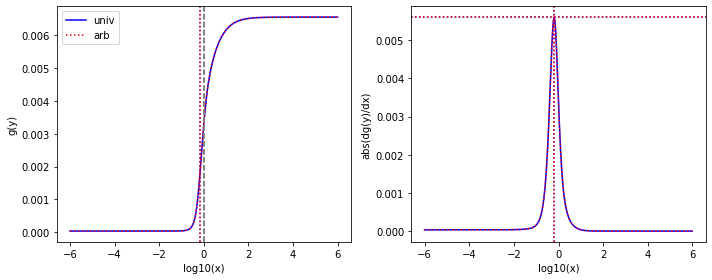

[6.27655e+02 6.27655e+02 4.27930e-03 1.00000e-03 1.78752e-03 1.00000e-03
 5.38605e+02 5.38605e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
6.817917486517274e-06 6.817917486517274e-06
2.847933976467964e-06 2.847933976467964e-06
0.8581226947925215 0.8581226947925215
1.593231950673539e-06 1.593231950673539e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 1221710263715433.0
From univ parameters, position and steepness are: 0.6540780604217937 1.7930627999115954e-06 0.3214811305408332
From arb parameters, position and steepness are: 0.6540780604217937 1.7930627999115952e-06 0.32148113054083316


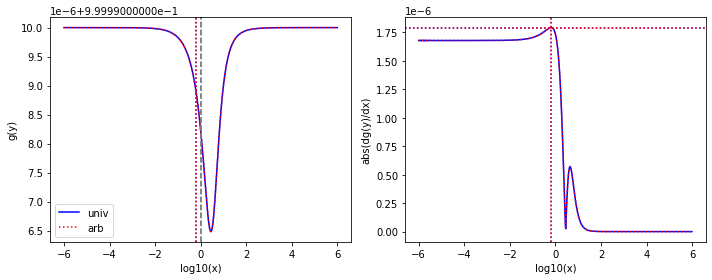

[1.00000e+03 5.46413e+00 1.05367e+00 1.00000e-03 2.71889e-01 4.77701e-03
 1.00000e-03 1.00000e-03 2.69422e-01 1.29467e-03]
found K1
found pairwise
found triplewise
0.00105367 0.00105367
0.000271889 0.000271889
1e-06 1e-06
0.000269422 0.00026942200000000006
# maximal error is 5.421010862427522e-20
min-max are 3.529814346881038e-10 449264221719.81793
From univ parameters, position and steepness are: 0.6606585795136704 0.0007868452995843094 13.7315785781367
From arb parameters, position and steepness are: 0.6606585795136705 0.0007868452995843102 13.731578578136691


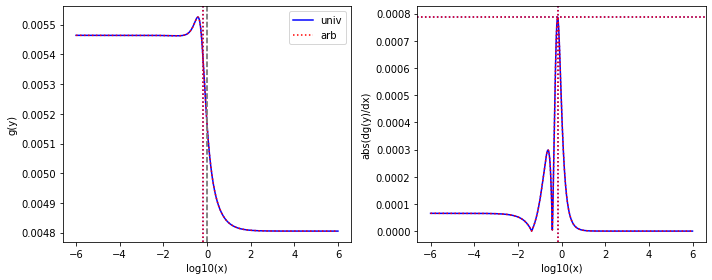

[3.10467e+02 5.14780e-03 1.00000e+03 3.93251e-02 2.24095e-02 2.48040e-03
 4.43150e+02 2.88696e+00 4.67602e+00 1.00000e-03]
found K1
found pairwise
found triplewise
3.2209542399031137 3.2209542399031137
7.217997403910882e-05 7.217997403910882e-05
1.4273658714130648 1.4273658714130648
0.01506124644487176 0.015061246444871763
# maximal error is 3.469446951953614e-18
min-max are 3.529814346881038e-10 119267738676.51035
From univ parameters, position and steepness are: 0.6726525759812039 0.004055554913763018 1.4888232538797834
From arb parameters, position and steepness are: 0.6726525759812039 0.004055554913763018 1.4888232538797834


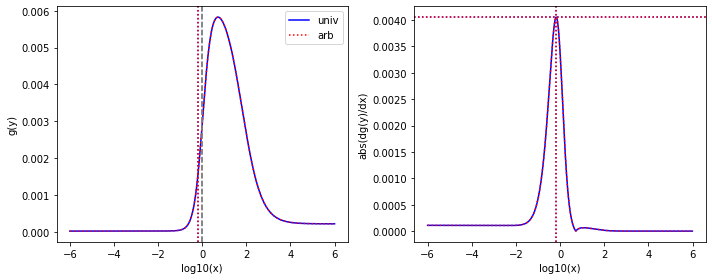

[6.16441e+00 1.00000e-03 5.27828e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.28057e-02 1.00000e-03 1.93684e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.8562506387472604 0.8562506387472604
0.0001622215264721198 0.0001622215264721198
0.0020773602015440244 0.0020773602015440244
3.1419714133226053 3.1419714133226053
# maximal error is 0.0
min-max are 3.529814346881038e-10 268051463877.8711
From univ parameters, position and steepness are: 0.6885746646632184 0.00015796888912375962 1.4161378666709685
From arb parameters, position and steepness are: 0.6885746646632184 0.0001579688891237596 1.4161378666709683


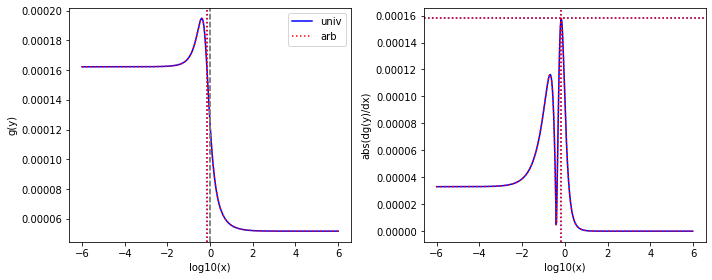

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 1.99988e-01 1.00000e-03
 8.28991e+02 1.00000e-03 3.46044e+02 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
0.000199988 0.000199988
0.828991 0.828991
0.34604399999999996 0.34604399999999996
# maximal error is 0.0
min-max are 2.498058915578641e-10 1624212789221951.0
From univ parameters, position and steepness are: 0.6975575924762459 1.0818875293048018e-06 0.6405979338382287
From arb parameters, position and steepness are: 0.6975575924762459 1.0818875293048018e-06 0.6405979338382286


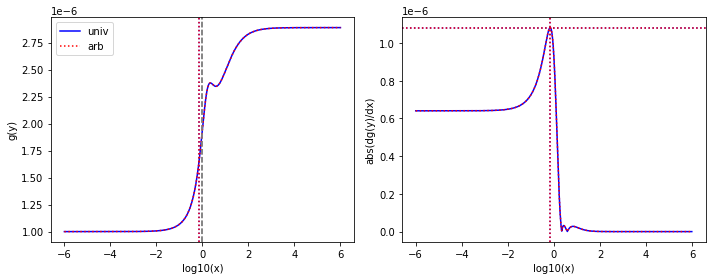

[1.00000e+03 3.54239e+00 3.68266e+01 1.00000e-03 3.77988e-03 3.77988e-03
 1.22604e-01 1.22604e-01 2.43135e+01 5.95392e-03]
found K1
found pairwise
found triplewise
0.0368266 0.0368266
3.77988e-06 3.77988e-06
0.000122604 0.000122604
0.024313500000000002 0.024313499999999995
# maximal error is 6.938893903907228e-18
min-max are 3.529814346881038e-10 6245697049.077159
From univ parameters, position and steepness are: 0.7046892970576151 0.0030878220484628293 3.7409189603261184
From arb parameters, position and steepness are: 0.704689297057615 0.0030878220484628297 3.740918960326119


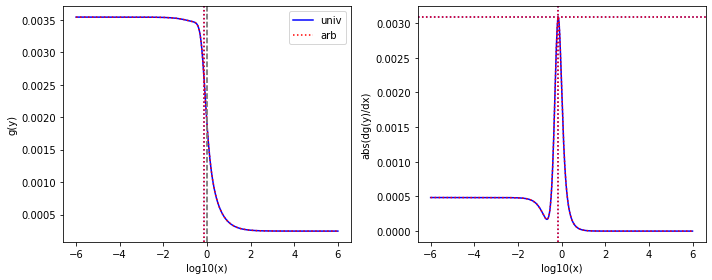

[4.70177e-01 1.97285e-03 1.25903e-02 1.00000e-03 9.21233e-02 6.29719e-03
 4.43150e+02 4.87946e+00 8.22652e-02 1.00000e-03]
found K1
found pairwise
found triplewise
0.026777787939435575 0.026777787939435572
0.1959332336545599 0.1959332336545599
942.5173923862715 942.5173923862714
0.17496644880544984 0.17496644880544981
# maximal error is 1.1368683772161603e-13
min-max are 3.529814346881038e-10 323756423805212.75
From univ parameters, position and steepness are: 0.7182451621185496 0.006274329342125528 0.11069362995320375
From arb parameters, position and steepness are: 0.7182451621185496 0.006274329342125529 0.11069362995320375


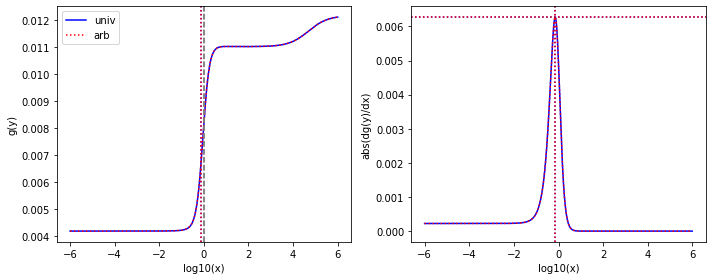

[2.62977e+02 9.52152e-02 1.14797e-01 6.24490e-03 1.41501e+01 5.64401e-03
 8.36771e+00 1.00000e-03 1.20616e+01 1.52426e-02]
found K1
found pairwise
found triplewise
0.0004365286698076258 0.0004365286698076258
0.053807367184202426 0.053807367184202426
0.03181917049780019 0.031819170497800184
0.04586560801895223 0.04586560801895223
# maximal error is 6.938893903907228e-18
min-max are 3.529814346881038e-10 88910290694304.45
From univ parameters, position and steepness are: 0.7249525418180447 0.000768834195596652 2.5816790931929754
From arb parameters, position and steepness are: 0.7249525418180447 0.0007688341955966521 2.581679093192976


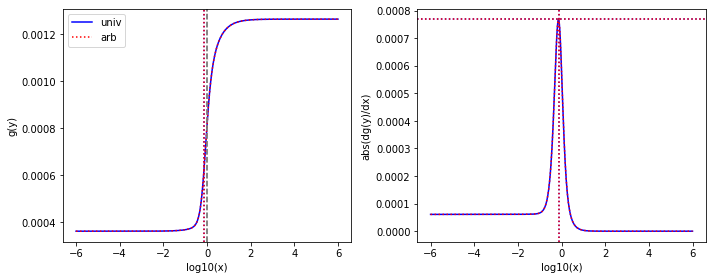

[1.00000e-03 1.00000e-03 2.17045e-03 1.00000e-03 3.92405e-02 1.51301e-03
 5.34720e+02 5.34720e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.1704499999999998 2.1704499999999998
39.2405 39.2405
534720.0 534720.0
1.0 0.9999999999999999
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 6.484027091912015e+16
From univ parameters, position and steepness are: 0.7318590284268396 0.005166985650607357 0.003957086243070074
From arb parameters, position and steepness are: 0.7318590284268396 0.005166985650607356 0.003957086243070074


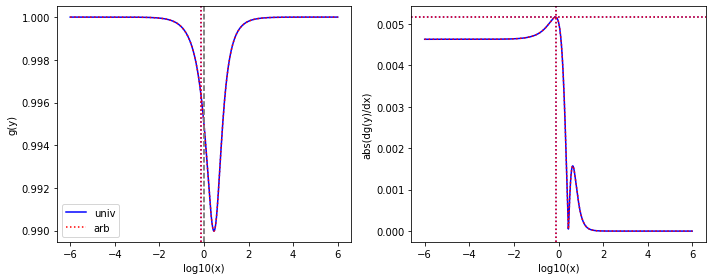

[2.88194e+02 1.00000e-03 1.63295e-01 1.00000e-03 9.79339e+01 1.36581e-03
 1.00000e-03 1.00000e-03 1.14571e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.0005666148497192863 0.0005666148497192863
0.33981935779370837 0.33981935779370837
3.4698848692200393e-06 3.4698848692200393e-06
0.039754817935140914 0.039754817935140914
# maximal error is 0.0
min-max are 3.529814346881038e-10 561511173900621.06
From univ parameters, position and steepness are: 0.7402471139385479 6.185014031896566e-05 2.3808328962375755
From arb parameters, position and steepness are: 0.740247113938548 6.185014031896566e-05 2.380832896237575


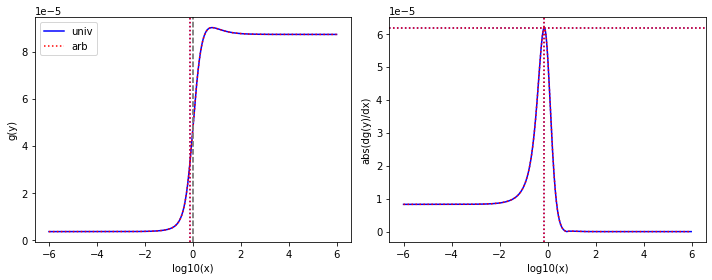

[7.16666e+00 1.00000e-03 4.88651e+00 1.63122e-03 8.97991e-02 6.94546e-03
 1.00000e-03 1.00000e-03 2.59717e+02 6.74898e-03]
found K1
found pairwise
found triplewise
0.6818392389202222 0.6818392389202222
0.012530118632668496 0.012530118632668494
0.0001395350135209428 0.0001395350135209428
36.2396151066187 36.2396151066187
# maximal error is 1.734723475976807e-18
min-max are 7.027031419536454e-09 20704534210595.562
From univ parameters, position and steepness are: 0.7562455728839814 0.00021688814224957463 0.6455179354990919
From arb parameters, position and steepness are: 0.7562455728839814 0.00021688814224957463 0.6455179354990918


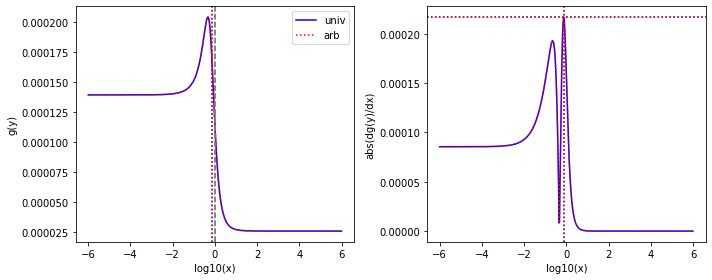

[9.45017e+00 1.00000e-03 7.65055e+00 1.06733e-03 2.89511e-03 2.89511e-03
 1.76971e-03 1.00000e-03 1.96031e+02 1.00000e-03]
found K1
found pairwise
found triplewise
0.8095674469348171 0.8095674469348171
0.00030635533540666464 0.00030635533540666464
0.000187267530637015 0.000187267530637015
20.743647997866706 20.743647997866706
# maximal error is 0.0
min-max are 3.529814346881038e-10 506215498352.7182
From univ parameters, position and steepness are: 0.7677461310088411 0.00013224286733063285 0.6816857720467567
From arb parameters, position and steepness are: 0.7677461310088411 0.00013224286733063288 0.6816857720467567


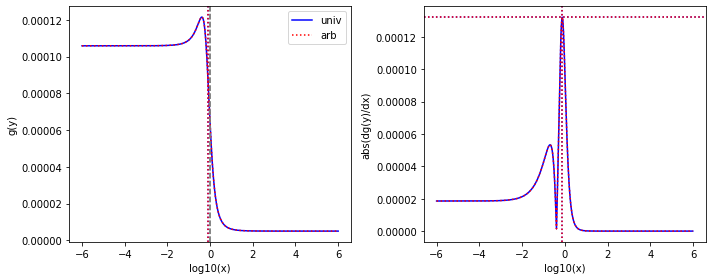

[9.45017e+00 1.00000e-03 7.65055e+00 1.00000e-03 9.00092e-03 9.00092e-03
 1.00000e-03 1.00000e-03 1.00000e+03 4.50195e-03]
found K1
found pairwise
found triplewise
0.8095674469348171 0.8095674469348171
0.0009524611726561534 0.0009524611726561534
0.00010581820221223534 0.00010581820221223534
105.81820221223533 105.81820221223535
# maximal error is 1.4210854715202004e-14
min-max are 3.529814346881038e-10 1573828743091.7754
From univ parameters, position and steepness are: 0.7713318275962049 0.00014191933483359792 0.45402366300767033
From arb parameters, position and steepness are: 0.7713318275962049 0.00014191933483359792 0.45402366300767033


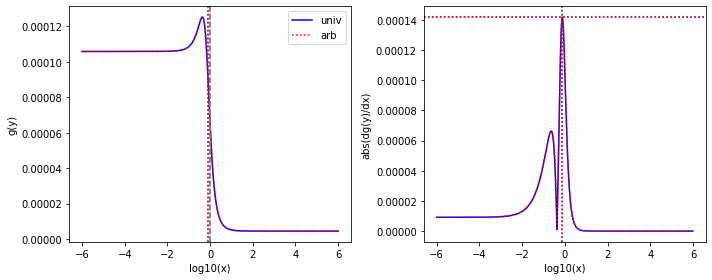

[8.56180e+00 1.76716e-02 8.55409e-03 1.00000e-03 2.70939e-01 1.00000e-03
 1.00000e-03 1.00000e-03 1.84843e+00 1.00000e-03]
found K1
found pairwise
found triplewise
0.0009990994884253313 0.0009990994884253313
0.0316450979934126 0.0316450979934126
0.00011679786960685838 0.00011679786960685836
0.21589268611740522 0.2158926861174052
# maximal error is 2.7755575615628914e-17
min-max are 3.529814346881038e-10 52289770096009.336
From univ parameters, position and steepness are: 0.7818524132694618 0.001713825003747417 1.821750093942096
From arb parameters, position and steepness are: 0.7818524132694618 0.0017138250037474173 1.821750093942096


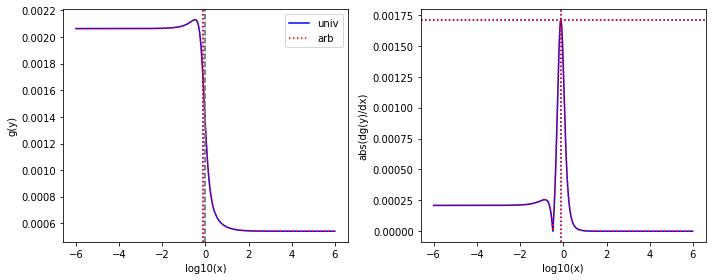

[2.08884e+01 1.00000e-03 1.09023e+01 3.45372e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.87444e+02 1.75507e-03]
found K1
found pairwise
found triplewise
0.5219308324237376 0.5219308324237376
4.787346086823308e-05 4.787346086823308e-05
4.787346086823308e-05 4.787346086823309e-05
23.33563125945501 23.335631259455013
# maximal error is 3.552713678800501e-15
min-max are 3.529814346881038e-10 79104956145.46346
From univ parameters, position and steepness are: 0.7960579849153545 9.07876076744986e-05 0.6197452434019031
From arb parameters, position and steepness are: 0.7960579849153545 9.078760767449858e-05 0.6197452434019031


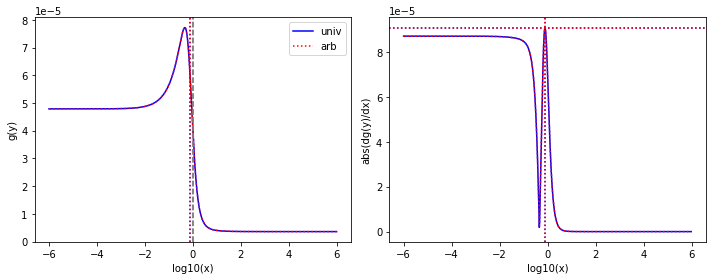

[6.53577e+00 1.00000e-03 1.09023e+01 3.45372e-03 2.24733e-03 1.31126e-03
 4.45825e-03 1.00000e-03 4.87444e+02 1.00000e-03]
found K1
found pairwise
found triplewise
1.6680972555643787 1.6680972555643787
0.0003438508393043207 0.0003438508393043207
0.0006821307971363741 0.0006821307971363741
74.58095985629849 74.5809598562985
# maximal error is 1.4210854715202004e-14
min-max are 3.529814346881038e-10 568172100855.7041
From univ parameters, position and steepness are: 0.8029858277125687 0.00020669554035679535 0.4504158419401388
From arb parameters, position and steepness are: 0.8029858277125687 0.00020669554035679537 0.4504158419401388


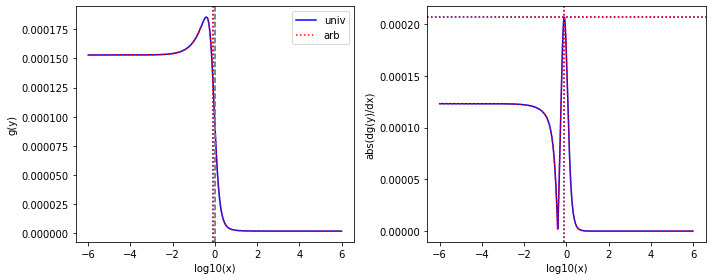

[6.53577e+00 1.00000e-03 1.09023e+01 3.80976e-03 1.00000e-03 1.00000e-03
 8.05889e-03 1.00000e-03 1.00000e+03 1.00000e-03]
found K1
found pairwise
found triplewise
1.6680972555643787 1.6680972555643787
0.00015300416018311538 0.00015300416018311538
0.0012330436964581068 0.0012330436964581065
153.00416018311537 153.00416018311537
# maximal error is 2.168404344971009e-19
min-max are 3.529814346881038e-10 252820604866.0663
From univ parameters, position and steepness are: 0.8126677008071431 0.0002084563208406895 0.36297247506617203
From arb parameters, position and steepness are: 0.8126677008071431 0.00020845632084068953 0.36297247506617203


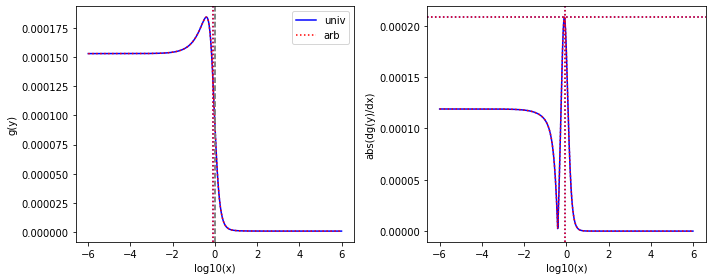

[9.45017e+00 1.00000e-03 1.00000e-03 1.00000e-03 1.46295e-03 1.00000e-03
 1.61406e-02 1.00000e-03 1.00000e+03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00010581820221223534 0.00010581820221223534
0.00015480673892638968 0.0001548067389263897
0.0017079692746268058 0.001707969274626806
105.81820221223533 105.81820221223533
# maximal error is 2.168404344971009e-19
min-max are 2.439715342954195e-10 14838810420733.842
From univ parameters, position and steepness are: 0.8332025757955692 0.00013880658336980241 0.35867169916483255
From arb parameters, position and steepness are: 0.8332025757955692 0.00013880658336980241 0.35867169916483255


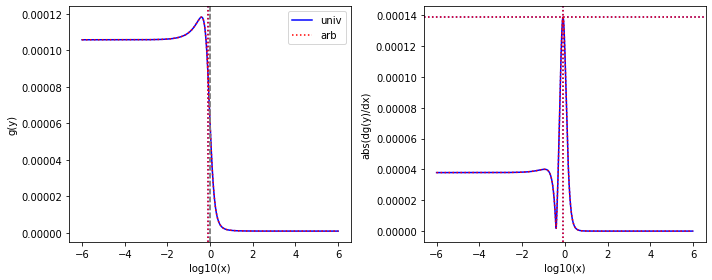

[6.53577e+00 2.31497e-03 1.09023e+01 3.52719e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.87444e+02 1.00000e-03]
found K1
found pairwise
found triplewise
1.6680972555643787 1.6680972555643787
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311538
74.58095985629849 74.5809598562985
# maximal error is 1.4210854715202004e-14
min-max are 3.529814346881038e-10 252820604866.0663
From univ parameters, position and steepness are: 0.8448146973198033 0.0003389276155934525 0.38970618244972616
From arb parameters, position and steepness are: 0.8448146973198033 0.00033892761559345245 0.38970618244972616


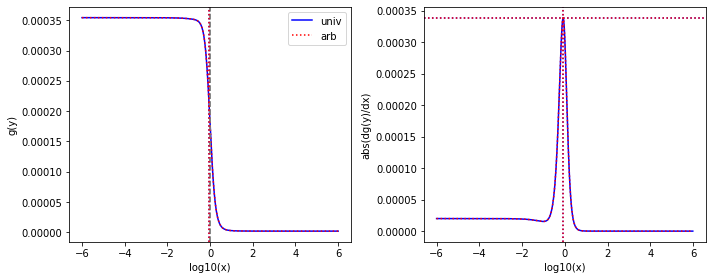

[6.53577e+00 1.00000e-03 4.13592e+00 1.00000e-03 6.11774e-03 1.00000e-03
 1.00000e-03 1.00000e-03 3.25070e+01 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.0009360396709186522 0.0009360396709186521
0.00015300416018311538 0.0001530041601831154
4.973706235072531 4.97370623507253
# maximal error is 8.881784197001252e-16
min-max are 3.529814346881038e-10 1546694215108.812
From univ parameters, position and steepness are: 0.8595811174649877 0.005024994205082734 0.7272149590153901
From arb parameters, position and steepness are: 0.8595811174649877 0.005024994205082734 0.7272149590153901


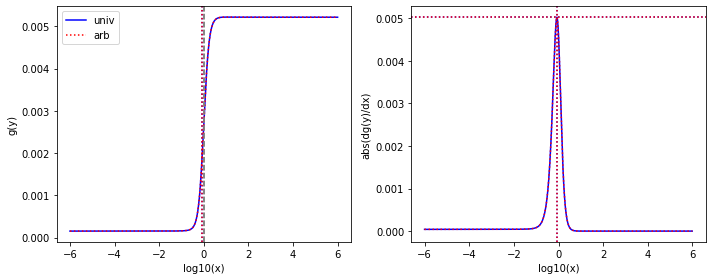

[6.53577e+00 1.00000e-03 1.09023e+01 1.03427e-03 2.28116e-03 1.00000e-03
 1.05556e-03 1.00000e-03 4.87444e+02 1.00000e-03]
found K1
found pairwise
found triplewise
1.6680972555643787 1.6680972555643787
0.0003490269700433155 0.00034902697004331553
0.00016150507132288926 0.00016150507132288926
74.58095985629849 74.58095985629848
# maximal error is 1.4210854715202004e-14
min-max are 3.529814346881038e-10 576725042827.2189
From univ parameters, position and steepness are: 0.8617035291787979 0.00013019179737951838 0.37958699688629904
From arb parameters, position and steepness are: 0.8617035291787979 0.00013019179737951838 0.3795869968862991


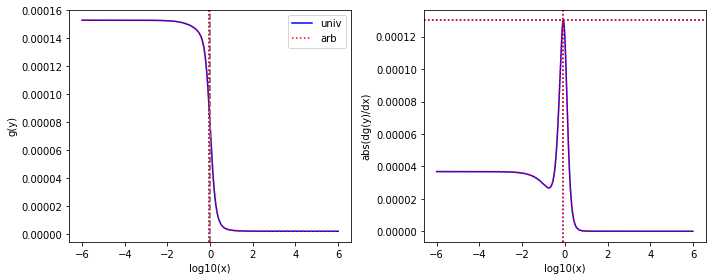

[1.00000e+03 6.53577e+00 4.13592e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.00000e-03]
found K1
found pairwise
found triplewise
0.0041359199999999995 0.0041359199999999995
1e-06 1e-06
1e-06 1.0000000000000002e-06
0.00478857 0.00478857
# maximal error is 2.117582368135751e-22
min-max are 3.529814346881038e-10 1652285399.7079525
From univ parameters, position and steepness are: 0.8796481582872998 0.006629660114391372 3.8074858428394176
From arb parameters, position and steepness are: 0.8796481582872998 0.006629660114391372 3.8074858428394176


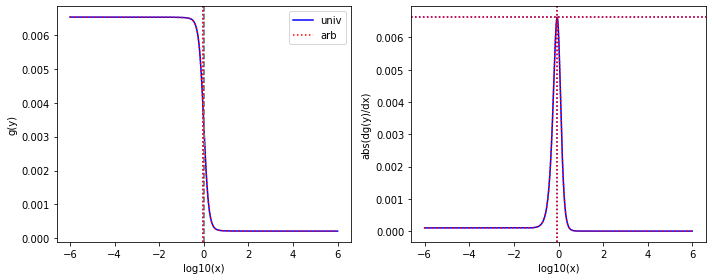

[2.33644e+02 6.53577e+00 2.80688e-01 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.69560e-01]
found K1
found pairwise
found triplewise
0.0012013490609645444 0.0012013490609645446
4.280015750457961e-06 4.280015750457961e-06
4.280015750457961e-06 4.280015750457961e-06
0.020495155022170482 0.020495155022170485
# maximal error is 3.469446951953614e-18
min-max are 3.529814346881038e-10 7072123220.647072
From univ parameters, position and steepness are: 0.8810092270772922 0.007989065147333569 2.640245999909406
From arb parameters, position and steepness are: 0.8810092270772922 0.00798906514733357 2.640245999909406


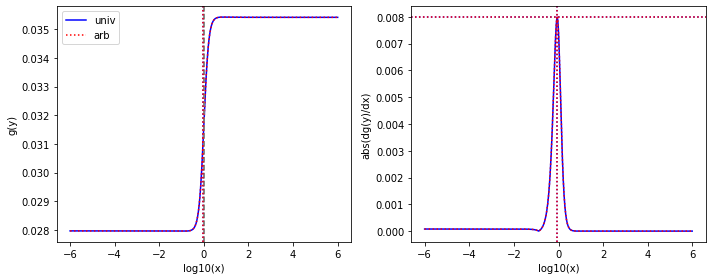

[6.53577e+00 6.53577e+00 1.00000e-03 1.00000e-03 2.24733e-03 2.24733e-03
 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00015300416018311538 0.00015300416018311538
0.0003438508393043207 0.00034385083930432074
0.00015300416018311538 0.0001530041601831154
0.00015300416018311538 0.00015300416018311538
# maximal error is 5.421010862427522e-20
min-max are 3.529814346881038e-10 568172624198.7731
From univ parameters, position and steepness are: -1.0 -1.0 -1.0
From arb parameters, position and steepness are: -1.0 -1.0 -1.0


<ipython-input-10-40b5af6185cb>:43: RuntimeWarning: invalid value encountered in log10
  ax.axvline(x=np.log10(pos),linestyle=":",color=color)
<ipython-input-10-40b5af6185cb>:43: RuntimeWarning: invalid value encountered in log10
  ax.axvline(x=np.log10(pos),linestyle=":",color=color)
<ipython-input-10-40b5af6185cb>:58: RuntimeWarning: invalid value encountered in log10
  ax.axvline(x=np.log10(pos),linestyle=":",color=color)
<ipython-input-10-40b5af6185cb>:58: RuntimeWarning: invalid value encountered in log10
  ax.axvline(x=np.log10(pos),linestyle=":",color=color)


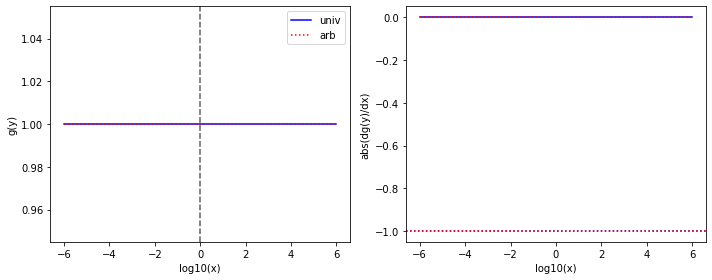

[6.53577e+00 1.53281e-02 4.13592e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 1.00000e+03 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.0001530041601831154
153.00416018311537 153.00416018311537
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9055798881803674 0.00196373297009515 0.27316733481223693
From arb parameters, position and steepness are: 0.9055798881803674 0.00196373297009515 0.27316733481223693


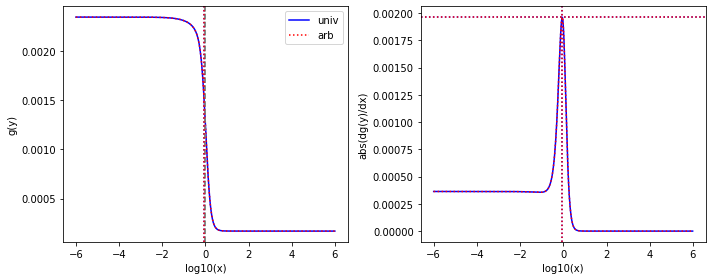

[6.53577e+00 2.47312e-03 4.13592e+00 1.00000e-03 1.00000e-03 1.00000e-03
 2.74250e-03 1.00000e-03 7.98933e-01 1.00000e-03]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.0004196139093021939 0.000419613909302194
0.12224007270757692 0.12224007270757693
# maximal error is 1.3877787807814457e-17
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9195492640110118 0.0010662088603961269 1.5961393950167047
From arb parameters, position and steepness are: 0.9195492640110118 0.0010662088603961269 1.5961393950167047


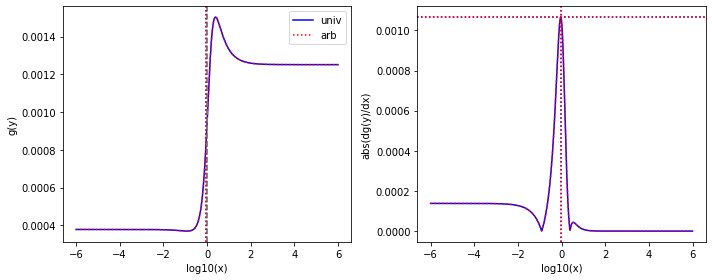

[6.53577e+00 7.19258e-03 1.09023e+01 3.52719e-03 3.11091e-01 1.00000e-03
 1.00000e-03 1.00000e-03 4.87444e+02 1.00000e-03]
found K1
found pairwise
found triplewise
1.6680972555643787 1.6680972555643787
0.047598217195525545 0.047598217195525545
0.00015300416018311538 0.0001530041601831154
74.58095985629849 74.5809598562985
# maximal error is 1.4210854715202004e-14
min-max are 7.027031419536454e-09 78650406442553.58
From univ parameters, position and steepness are: 0.9273539829924421 0.0008016760560903476 0.32283435187412585
From arb parameters, position and steepness are: 0.9273539829924421 0.0008016760560903476 0.32283435187412585


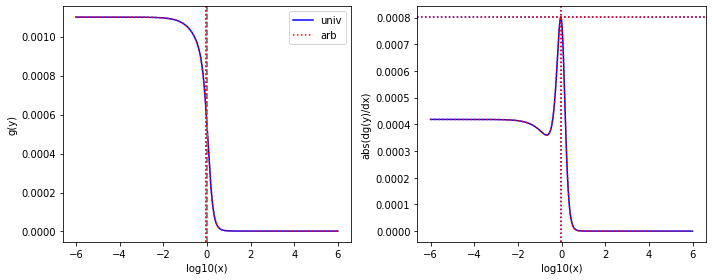

[1.00000e+03 1.00000e-03 2.82176e+01 8.01587e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 2.43135e+01 3.17162e-03]
found K1
found pairwise
found triplewise
0.028217600000000002 0.0282176
1e-06 1e-06
1e-06 1e-06
0.024313500000000002 0.024313500000000005
# maximal error is 3.469446951953614e-18
min-max are 3.529814346881038e-10 1652277843.7118177
From univ parameters, position and steepness are: 0.9390320265701464 0.00012586945295430793 2.231013065229718
From arb parameters, position and steepness are: 0.9390320265701464 0.00012586945295430793 2.231013065229718


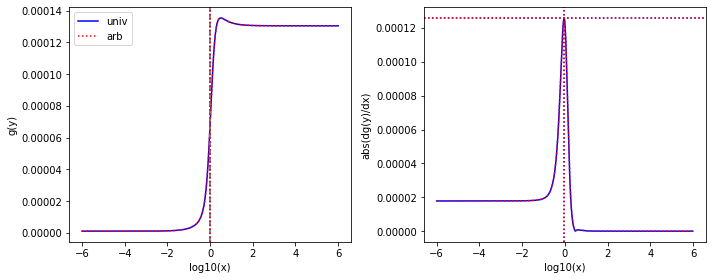

[1.46492e+02 6.53577e+00 4.13592e+00 4.32188e-03 1.00000e-03 1.00000e-03
 4.42096e-03 4.42096e-03 4.78857e+00 1.69560e-01]
found K1
found pairwise
found triplewise
0.028233077574202004 0.028233077574202
6.82631133440734e-06 6.82631133440734e-06
3.0178849356961474e-05 3.0178849356961474e-05
0.03268826966660296 0.03268826966660295
# maximal error is 6.938893903907228e-18
min-max are 3.529814346881038e-10 11279566109.561312
From univ parameters, position and steepness are: 0.9408283801137081 0.007426953742076557 2.0444521494814785
From arb parameters, position and steepness are: 0.940828380113708 0.007426953742076563 2.044452149481479


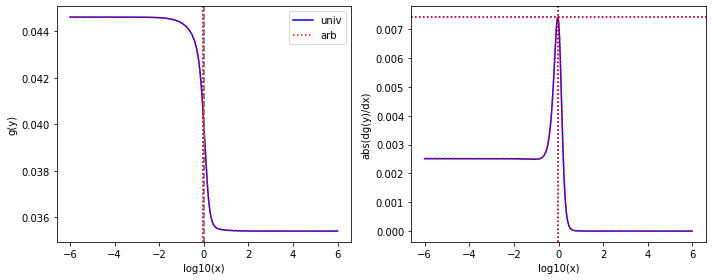

[1.48614e+02 6.53577e+00 4.13592e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.65815e-03 1.00000e-03 4.78857e+00 1.69560e-01]
found K1
found pairwise
found triplewise
0.027829948726230364 0.02782994872623036
6.728841158975601e-06 6.728841158975601e-06
1.1157427967755393e-05 1.1157427967755393e-05
0.03222152690863579 0.03222152690863579
# maximal error is 3.469446951953614e-18
min-max are 3.529814346881038e-10 11118508334.60541
From univ parameters, position and steepness are: 0.9567789610423777 0.006871546446236586 1.9918059617688175
From arb parameters, position and steepness are: 0.9567789610423777 0.006871546446236588 1.9918059617688175


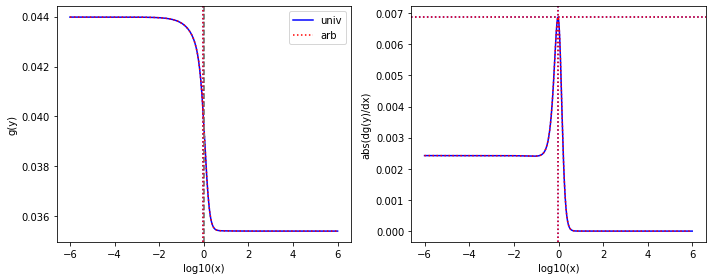

[6.53577e+00 8.73940e-02 4.13592e+00 3.22661e-03 3.83820e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.63078e+01 1.70974e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.0005872605676148334 0.0005872605676148334
0.00015300416018311538 0.00015300416018311538
7.08528604892767 7.085286048927669
# maximal error is 8.881784197001252e-16
min-max are 3.529814346881038e-10 970378124604.9208
From univ parameters, position and steepness are: 0.9685684944073039 0.006565453380289557 0.5133361462121334
From arb parameters, position and steepness are: 0.9685684944073039 0.006565453380289557 0.5133361462121334


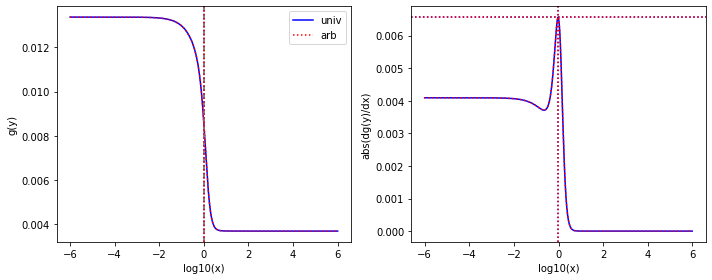

[3.81331e+01 1.72199e-01 4.13592e+00 1.00000e-03 4.96068e-03 1.00000e-03
 2.53529e-02 1.00000e-03 4.78857e+00 1.63434e-02]
found K1
found pairwise
found triplewise
0.10846010421392438 0.10846010421392437
0.000130088558234185 0.000130088558234185
0.0006648528443792926 0.0006648528443792926
0.12557515649134218 0.12557515649134218
# maximal error is 1.3877787807814457e-17
min-max are 3.529814346881038e-10 214955780617.44974
From univ parameters, position and steepness are: 0.97774158989662 0.0006214536580648163 1.2014911908782548
From arb parameters, position and steepness are: 0.97774158989662 0.0006214536580648164 1.2014911908782548


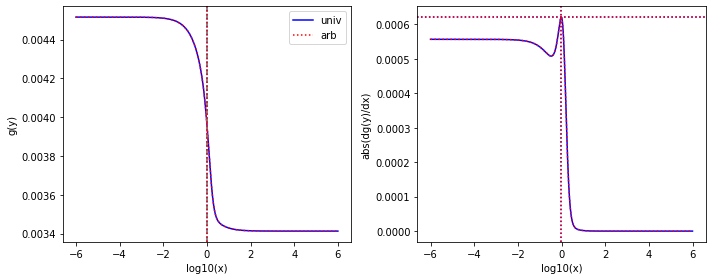

[1.00000e+03 2.94715e-02 4.01950e+00 2.44297e-01 3.70137e-03 1.00000e-03
 1.00000e-03 1.00000e-03 1.74587e-01 1.00000e-03]
found K1
found pairwise
found triplewise
0.0040195 0.0040195
3.70137e-06 3.70137e-06
1e-06 1e-06
0.000174587 0.000174587
# maximal error is 0.0
min-max are 3.529814346881038e-10 6115978881.908177
From univ parameters, position and steepness are: 0.9891432861113895 0.004793363724682229 6.815680054456138
From arb parameters, position and steepness are: 0.9891432861113895 0.004793363724682229 6.815680054456138


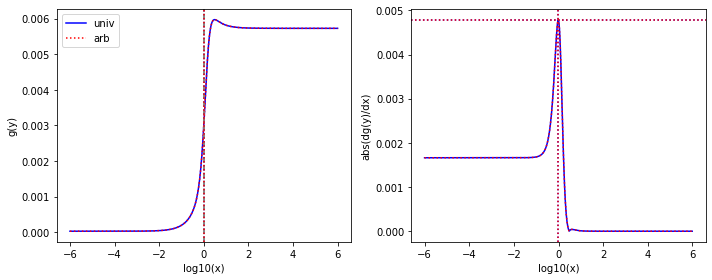

[1.00000e+03 3.36238e-02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 3.49516e-02 3.49516e-02 5.91700e-01 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1e-06 1e-06
3.49516e-05 3.4951600000000006e-05
0.0005917 0.0005916999999999999
# maximal error is 1.0842021724855044e-19
min-max are 2.498058915578641e-10 8078707168317.111
From univ parameters, position and steepness are: 0.9905580048319128 0.007117567789626034 4.741100006614298
From arb parameters, position and steepness are: 0.9905580048319128 0.007117567789626036 4.741100006614298


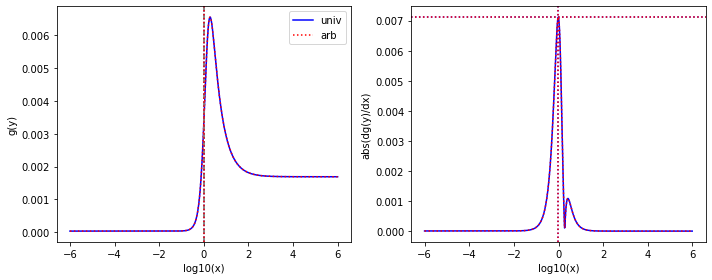

[1.61795e+02 6.53577e+00 4.13592e+00 3.22661e-03 1.72413e-02 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.70974e-01]
found K1
found pairwise
found triplewise
0.025562718254581413 0.02556271825458141
0.00010656262554467074 0.00010656262554467074
6.18066071263018e-06 6.180660712630181e-06
0.029596526468679503 0.02959652646867951
# maximal error is 6.938893903907228e-18
min-max are 3.529814346881038e-10 176081993877.3936
From univ parameters, position and steepness are: 1.0073666424880896 0.00324348817327243 1.7771318875160576
From arb parameters, position and steepness are: 1.0073666424880896 0.0032434881732724317 1.7771318875160578


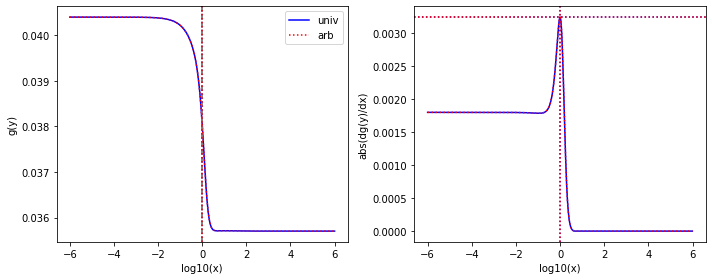

[1.63511e+02 6.53577e+00 4.13592e+00 3.22661e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.70974e-01]
found K1
found pairwise
found triplewise
0.025294445022047446 0.025294445022047442
6.115796490755974e-06 6.115796490755973e-06
6.115796490755974e-06 6.115796490755974e-06
0.029285919601739333 0.02928591960173933
# maximal error is 3.469446951953614e-18
min-max are 3.529814346881038e-10 10105525545.001423
From univ parameters, position and steepness are: 1.0170835864508228 0.0028604514736299703 1.7300985818791084
From arb parameters, position and steepness are: 1.0170835864508228 0.002860451473629969 1.7300985818791081


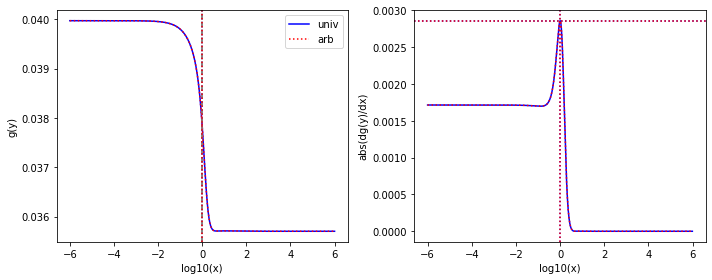

[6.53577e+00 1.00000e-03 4.13592e+00 1.00000e-03 2.58007e-03 1.00000e-03
 1.57968e-03 1.00000e-03 4.78857e+00 1.00000e-03]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.0003947614435636505 0.0003947614435636505
0.0002416976117580637 0.0002416976117580637
0.7326711313280607 0.7326711313280606
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 652296159407.7052
From univ parameters, position and steepness are: 1.0267325803343075 0.00015392278823749377 0.6685101181400607
From arb parameters, position and steepness are: 1.0267325803343075 0.0001539227882374938 0.6685101181400608


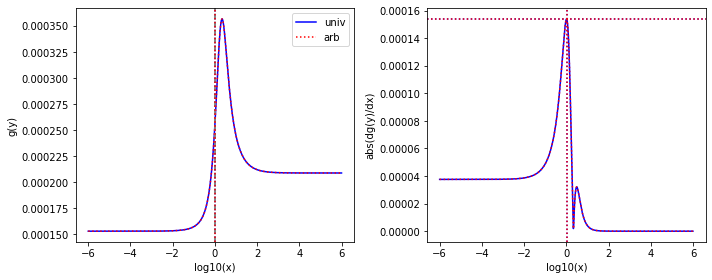

[6.53577e+00 1.00000e-03 4.13592e+00 1.17040e-03 1.00000e-03 1.00000e-03
 1.98539e-03 1.00000e-03 4.78857e+00 1.00000e-03]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.0003037729295859554 0.0003037729295859554
0.7326711313280607 0.7326711313280607
# maximal error is 0.0
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 1.0385462174657103 0.00015034365107545673 0.6370371417674668
From arb parameters, position and steepness are: 1.0385462174657103 0.00015034365107545675 0.6370371417674668


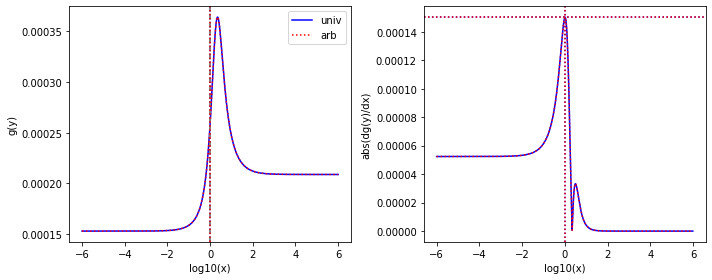

[1.00000e+03 4.06455e-01 2.80494e+01 2.76098e-02 1.91699e-01 1.89035e-01
 9.53038e+00 9.53038e+00 1.00000e+03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0280494 0.028049399999999995
0.000191699 0.000191699
0.00953038 0.009530380000000001
1.0 0.9999999999999999
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 316759751658.37134
From univ parameters, position and steepness are: 1.0438986837375164 0.005348969837632834 0.6714443492191714
From arb parameters, position and steepness are: 1.0438986837375164 0.005348969837632836 0.6714443492191714


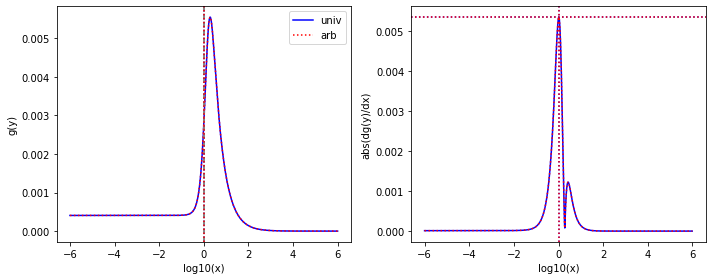

[1.19535e+01 1.00000e-03 4.13592e+00 1.75386e-03 1.00000e-03 1.00000e-03
 3.27751e-03 1.00000e-03 4.78857e+00 1.00000e-03]
found K1
found pairwise
found triplewise
0.3460007529175555 0.3460007529175555
8.365750616974108e-05 8.365750616974109e-05
0.0002741883130463881 0.0002741883130463881
0.400599824319237 0.40059982431923696
# maximal error is 5.551115123125783e-17
min-max are 3.529814346881038e-10 138233900936.3037
From univ parameters, position and steepness are: 1.0585413616402026 0.00017365159559429235 0.7258421069673462
From arb parameters, position and steepness are: 1.0585413616402026 0.00017365159559429235 0.7258421069673462


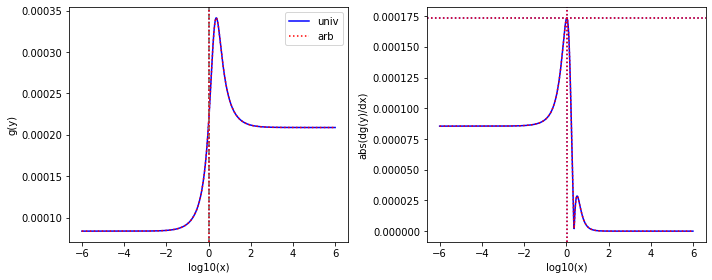

[8.36443e+00 1.00000e-03 1.00000e-03 1.00000e-03 9.70268e-02 9.03968e-03
 1.00000e-03 1.00000e-03 9.84695e+01 1.63373e-02]
found K1
found pairwise
found triplewise
0.00011955387276837752 0.00011955387276837752
0.011599929702322811 0.011599929702322811
0.00011955387276837752 0.0001195538727683775
11.77241007456575 11.77241007456575
# maximal error is 1.3552527156068805e-20
min-max are 3.529814346881038e-10 19167507570854.496
From univ parameters, position and steepness are: 1.0630982514372849 0.00017310004531643057 0.272771908664871
From arb parameters, position and steepness are: 1.0630982514372849 0.00017310004531643057 0.272771908664871


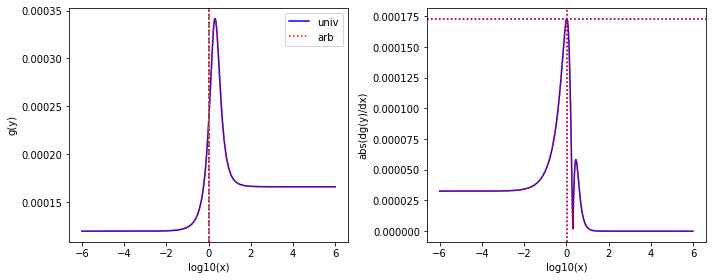

[4.95667e+02 4.95667e+02 6.33186e-02 3.60897e-03 8.60471e-03 5.57008e-03
 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.000127744231510268 0.00012774423151026802
1.7359860551539642e-05 1.7359860551539642e-05
2.0174835121159974e-06 2.0174835121159974e-06
2.0174835121159974e-06 2.0174835121159974e-06
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 28685015352.777927
From univ parameters, position and steepness are: 1.07186580654992 0.002338242497275612 10.468878761181497
From arb parameters, position and steepness are: 1.07186580654992 0.0023382424972756117 10.468878761181497


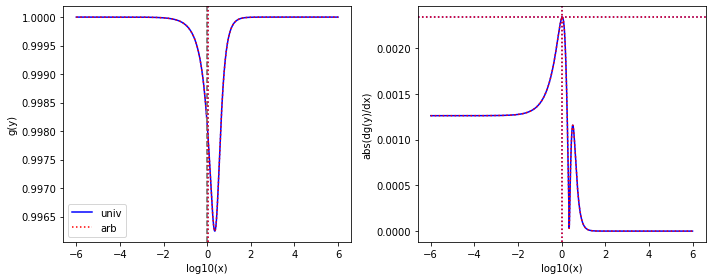

[1.00000e+03 1.00000e-03 1.75314e+01 2.47300e-02 4.21002e-03 1.49269e-03
 1.00000e-03 1.00000e-03 2.43135e+01 1.39151e-03]
found K1
found pairwise
found triplewise
0.017531400000000003 0.0175314
4.21002e-06 4.21002e-06
1e-06 9.999999999999997e-07
0.024313500000000002 0.024313500000000002
# maximal error is 3.469446951953614e-18
min-max are 3.529814346881038e-10 6956458423.216973
From univ parameters, position and steepness are: 1.0866893210910442 4.4655569285606196e-05 1.3066730215104359
From arb parameters, position and steepness are: 1.0866893210910442 4.465556928560619e-05 1.3066730215104356


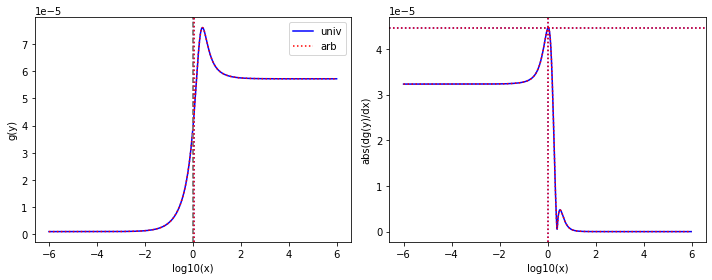

[1.00000e+03 1.00000e-03 2.58472e-02 2.58472e-02 9.60589e-03 1.00000e-03
 1.00000e-03 1.00000e-03 1.91106e+01 1.00000e-03]
found K1
found pairwise
found triplewise
2.5847200000000002e-05 2.5847200000000002e-05
9.60589e-06 9.60589e-06
1e-06 9.999999999999997e-07
0.019110600000000002 0.019110600000000002
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 76902940426063.55
From univ parameters, position and steepness are: 1.0918053157937655 4.41137809503906e-05 1.2949836390823126
From arb parameters, position and steepness are: 1.0918053157937655 4.41137809503906e-05 1.2949836390823126


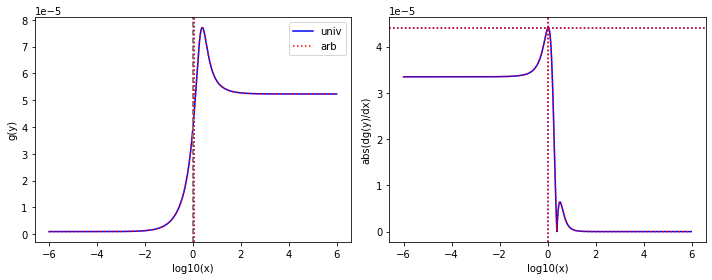

[6.53577e+00 1.00000e-03 2.86511e+00 1.00000e-03 7.09905e-02 2.93205e-02
 3.89268e-03 1.00000e-03 2.26106e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.4383737493822457 0.4383737493822457
0.010861841833479451 0.010861841833479451
0.0005955962342616096 0.0005955962342616096
3.459515864236349 3.4595158642363484
# maximal error is 4.440892098500626e-16
min-max are 3.529814346881038e-10 17947904793764.176
From univ parameters, position and steepness are: 1.1006619561374866 0.0007799119913770673 0.3435321008536012
From arb parameters, position and steepness are: 1.1006619561374866 0.0007799119913770675 0.3435321008536012


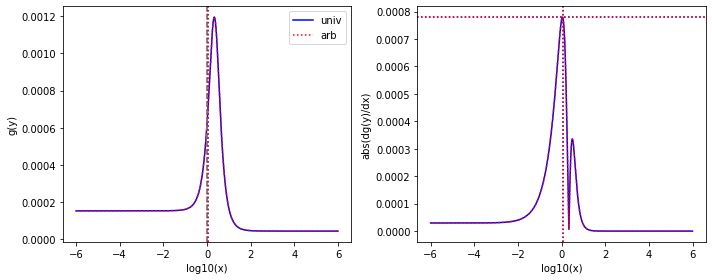

[1.00000e+03 7.94053e-01 1.47528e-03 1.00000e-03 1.90882e-02 1.00000e-03
 7.65918e+00 7.65918e+00 1.00000e+03 1.00000e-03]
found K1
found pairwise
found triplewise
1.47528e-06 1.47528e-06
1.9088199999999998e-05 1.9088199999999998e-05
0.00765918 0.00765918
1.0 1.0
# maximal error is 0.0
min-max are 2.498058915578641e-10 154966362550148.72
From univ parameters, position and steepness are: 1.1180805170300994 0.0037200818630522474 0.6200960060843967
From arb parameters, position and steepness are: 1.1180805170300994 0.003720081863052247 0.6200960060843967


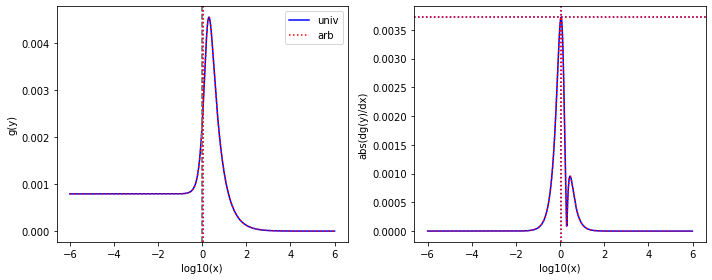

[1.25755e+02 3.08099e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 3.36793e+01 1.00000e-03 1.00000e+03 2.41168e-02]
found K1
found pairwise
found triplewise
7.951970100592422e-06 7.951970100592422e-06
7.951970100592422e-06 7.951970100592422e-06
0.26781678660888236 0.2678167866088824
7.951970100592422 7.951970100592422
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 135541003189849.28
From univ parameters, position and steepness are: 1.1236959661310721 1.9672992101419438e-06 0.18706665227158314
From arb parameters, position and steepness are: 1.1236959661310713 1.9672992101419455e-06 0.1870666522715833


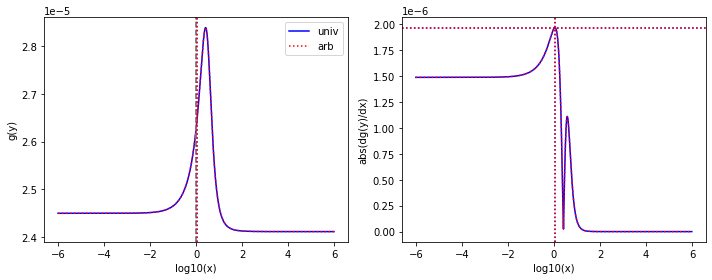

[1.20705e+00 1.00000e-03 1.00000e-03 1.00000e-03 2.07909e+00 1.00000e-03
 3.08248e+02 1.00000e-03 2.75931e+02 2.98830e-01]
found K1
found pairwise
found triplewise
0.0008284660950250611 0.0008284660950250611
1.7224555735056541 1.7224555735056541
255.37301685928503 255.373016859285
228.59947806636012 228.59947806636015
# maximal error is 2.842170943040401e-14
min-max are 3.529814346881038e-10 2846153490140701.5
From univ parameters, position and steepness are: 1.1308321555336487 0.0004123787238275084 0.10811697509518131
From arb parameters, position and steepness are: 1.130832155533649 0.0004123787238275083 0.1081169750951813


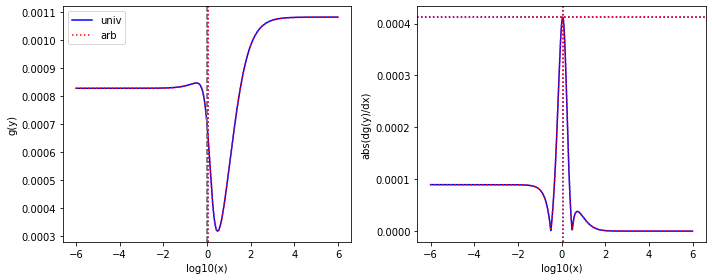

[4.27651e+01 1.00000e-03 7.67591e+00 6.20812e-03 6.32686e-03 6.32686e-03
 5.85452e-03 1.00000e-03 1.00000e+03 1.48689e-02]
found K1
found pairwise
found triplewise
0.17949005146720107 0.17949005146720107
0.00014794446873735829 0.00014794446873735829
0.0001368994811189498 0.0001368994811189498
23.383553411543527 23.383553411543524
# maximal error is 3.552713678800501e-15
min-max are 3.529814346881038e-10 244460532086.07446
From univ parameters, position and steepness are: 1.1484159696007539 2.0374478064801083e-05 0.12246743055829759
From arb parameters, position and steepness are: 1.148415969600754 2.0374478064801083e-05 0.12246743055829759


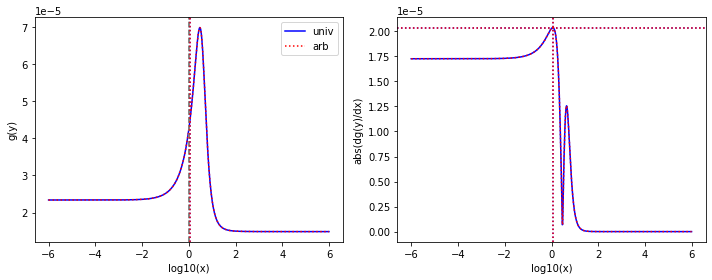

[9.60921e+00 1.00000e-03 1.00000e-03 1.00000e-03 2.25385e-01 2.41524e-03
 1.00000e-03 1.00000e-03 4.58027e+01 4.41652e-03]
found K1
found pairwise
found triplewise
0.00010406682755398208 0.00010406682755398208
0.02345510192825425 0.02345510192825425
0.00010406682755398208 0.00010406682755398208
4.766541682406775 4.766541682406775
# maximal error is 0.0
min-max are 2.439715342954195e-10 2410678957649637.0
From univ parameters, position and steepness are: 1.1516196957227955 6.673557515152172e-05 0.2776451316894556
From arb parameters, position and steepness are: 1.1516196957227953 6.673557515152174e-05 0.2776451316894556


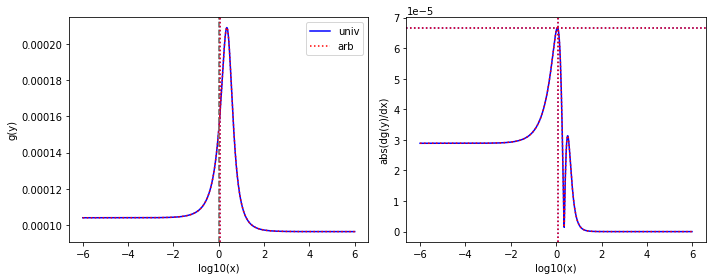

[3.03183e+00 1.00000e-03 1.00000e-03 1.00000e-03 2.80387e-03 2.80387e-03
 7.65918e+00 5.34553e-01 1.00000e+03 5.49644e-02]
found K1
found pairwise
found triplewise
0.0003298337967498178 0.0003298337967498178
0.0009248110876929116 0.0009248110876929116
2.5262564193902692 2.526256419390269
329.8337967498178 329.8337967498178
# maximal error is 4.440892098500626e-16
min-max are 3.529814346881038e-10 1528140511892.0754
From univ parameters, position and steepness are: 1.1604980612555564 0.0010292607535528876 0.1362979695082747
From arb parameters, position and steepness are: 1.1604980612555564 0.0010292607535528876 0.13629796950827466


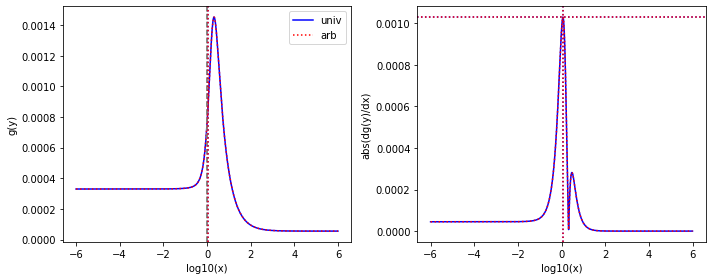

[1.17831e+02 7.06667e-03 1.76823e+00 1.49489e-02 1.52152e-03 1.00000e-03
 6.12180e+00 9.17114e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.015006492349212006 0.015006492349212008
1.291273094516723e-05 1.291273094516723e-05
0.05195406981184918 0.05195406981184918
0.18917602328758987 0.18917602328758987
# maximal error is 1.734723475976807e-18
min-max are 3.529814346881038e-10 21336656598.816853
From univ parameters, position and steepness are: 1.1778534087643664 0.00012087569987399524 0.6295738165210891
From arb parameters, position and steepness are: 1.1778534087643664 0.00012087569987399524 0.6295738165210891


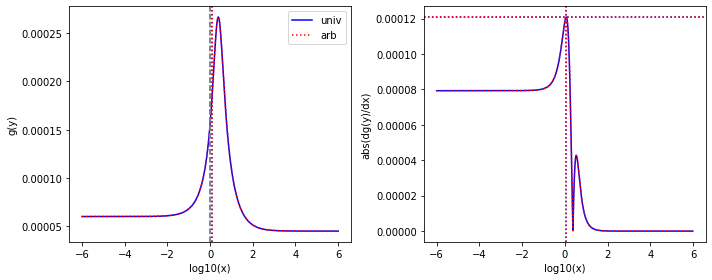

[1.04300e+02 1.00000e-03 1.42250e+00 1.00000e-03 3.13727e-02 9.36786e-03
 6.41658e-02 1.00000e-03 5.15270e+02 3.14451e-03]
found K1
found pairwise
found triplewise
0.013638542665388304 0.013638542665388305
0.00030079290508149573 0.00030079290508149573
0.0006152042186001917 0.0006152042186001917
4.940268456375839 4.940268456375839
# maximal error is 1.734723475976807e-18
min-max are 3.529814346881038e-10 497024491878.9215
From univ parameters, position and steepness are: 1.1823347618598345 1.630598129393323e-05 0.28622290796443384
From arb parameters, position and steepness are: 1.1823347618598345 1.6305981293933227e-05 0.28622290796443384


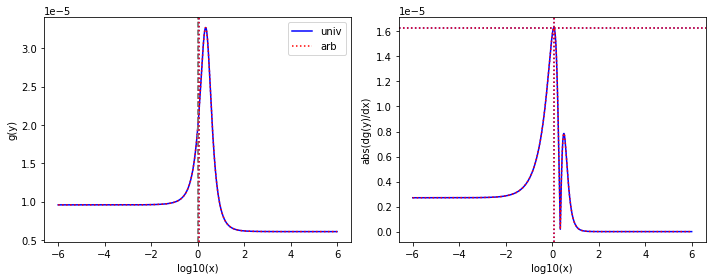

[1.56853e+01 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.40342e+01 5.01898e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
6.375396071480941e-05 6.375396071480942e-05
6.375396071480941e-05 6.375396071480941e-05
0.8947358354637782 0.8947358354637782
1.4211267875016735 1.4211267875016735
# maximal error is 1.3552527156068805e-20
min-max are 2.439715342954195e-10 6405946237048.835
From univ parameters, position and steepness are: 1.1914531196775455 7.224941999516433e-05 0.3896106336035223
From arb parameters, position and steepness are: 1.1914531196775455 7.224941999516433e-05 0.3896106336035224


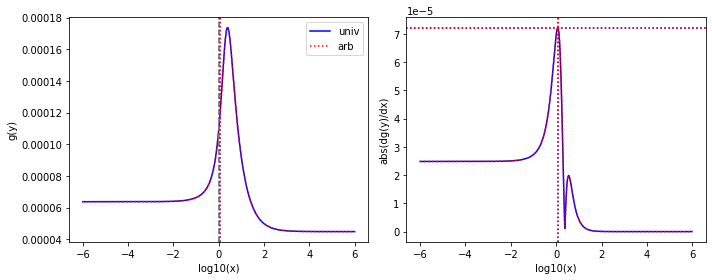

[1.16249e+01 1.00000e-03 2.86511e+00 1.00000e-03 7.09905e-02 6.88141e-03
 1.00000e-03 1.00000e-03 2.26106e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.24646319538232586 0.24646319538232586
0.006106762208707171 0.006106762208707171
8.602224535264819e-05 8.602224535264819e-05
1.9450145807705874 1.9450145807705874
# maximal error is 0.0
min-max are 3.529814346881038e-10 10090699896959.87
From univ parameters, position and steepness are: 1.2001763582320046 0.00014871980267203315 0.3557898351205847
From arb parameters, position and steepness are: 1.2001763582320044 0.00014871980267203318 0.35578983512058476


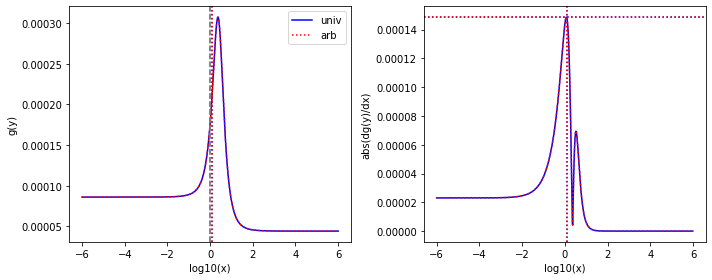

[4.22422e-01 1.00000e-03 4.98803e-02 1.00000e-03 1.00000e-03 1.00000e-03
 2.22069e+00 2.22069e+00 1.00000e+03 1.00000e-03]
found K1
found pairwise
found triplewise
0.11808168135182354 0.11808168135182352
0.0023673009454999974 0.0023673009454999974
5.257041536662389 5.257041536662389
2367.3009454999974 2367.300945499998
# maximal error is 4.547473508864641e-13
min-max are 3.529814346881038e-10 3911683833960.256
From univ parameters, position and steepness are: 1.2150186621312582 0.006351871752828748 0.08000919303789183
From arb parameters, position and steepness are: 1.2150186621312582 0.006351871752828751 0.08000919303789185


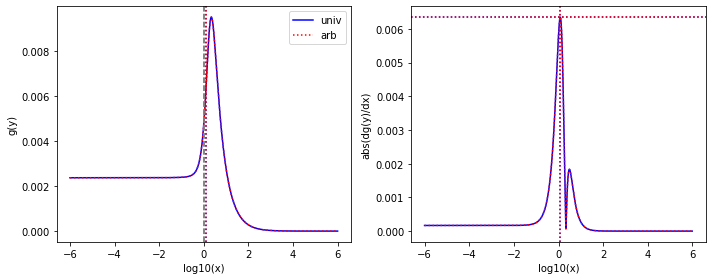

[3.15526e+01 2.09385e-03 1.14816e-03 1.00000e-03 2.26559e-03 1.00000e-03
 2.64062e+01 6.82745e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
3.638876035572346e-05 3.638876035572346e-05
7.180359146314408e-05 7.180359146314408e-05
0.8368945823798989 0.836894582379899
0.7064647604317869 0.7064647604317869
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 581603860427083.1
From univ parameters, position and steepness are: 1.223967835172724 5.5745104765647494e-05 0.4507240493669445
From arb parameters, position and steepness are: 1.223967835172724 5.574510476564751e-05 0.45072404936694455


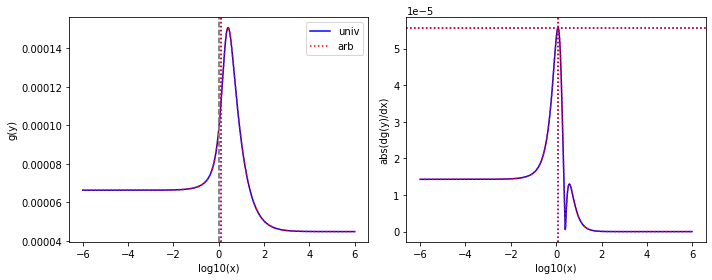

[3.81651e+02 6.70745e+00 1.00000e-03 1.00000e-03 7.47715e+01 2.77531e-03
 1.00000e-03 1.00000e-03 1.85000e+01 3.54419e-01]
found K1
found pairwise
found triplewise
2.6201948900959254e-06 2.6201948900959254e-06
0.19591590222480748 0.19591590222480748
2.6201948900959254e-06 2.6201948900959254e-06
0.048473605466774615 0.04847360546677463
# maximal error is 1.3877787807814457e-17
min-max are 2.360183595459028e-10 1.5911831082257162e+18
From univ parameters, position and steepness are: 1.2307820112759151 0.002990858129117747 0.7386484531637718
From arb parameters, position and steepness are: 1.2307820112759145 0.0029908581291177494 0.7386484531637721


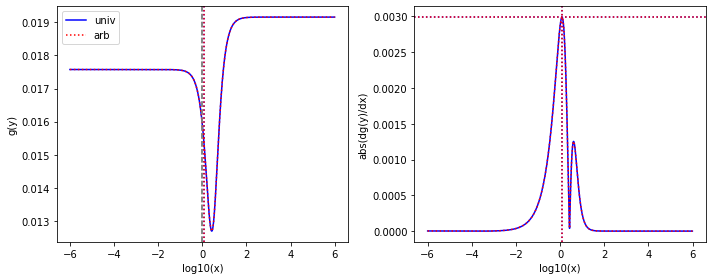

[1.00000e+03 1.88596e+00 1.67127e-01 8.07690e-02 1.00000e-03 1.00000e-03
 1.96730e+01 2.89633e-01 4.87743e+00 1.00000e-03]
found K1
found pairwise
found triplewise
0.000167127 0.00016712700000000001
1e-06 1e-06
0.019673 0.019673
0.00487743 0.00487743
# maximal error is 2.710505431213761e-20
min-max are 7.027031419536454e-09 1652286644.9775753
From univ parameters, position and steepness are: 1.243722420348182 0.0031940700716723324 1.7592103306480285
From arb parameters, position and steepness are: 1.243722420348182 0.0031940700716723324 1.7592103306480285


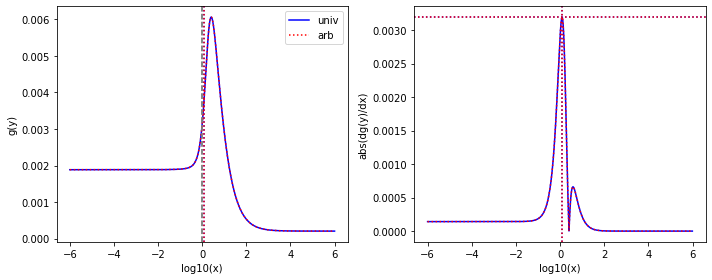

[3.37068e+00 1.00000e-03 4.13592e+00 1.15921e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.11493e+00 1.00000e-03]
found K1
found pairwise
found triplewise
1.2270283740966212 1.2270283740966212
0.00029667604162958216 0.00029667604162958216
0.00029667604162958216 0.00029667604162958216
1.2208011439828166 1.2208011439828166
# maximal error is 0.0
min-max are 3.529814346881038e-10 490221482712.5788
From univ parameters, position and steepness are: 1.250618634309981 0.00010381866861083831 0.4696947001640738
From arb parameters, position and steepness are: 1.2506186343099812 0.00010381866861083829 0.46969470016407366


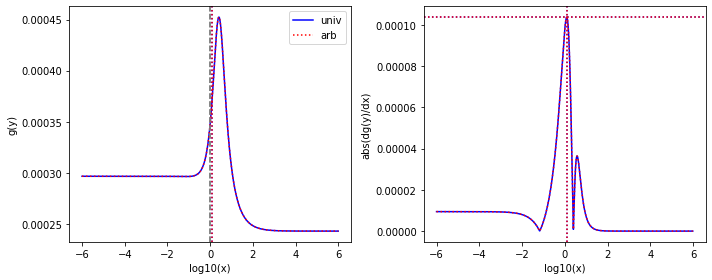

[5.18147e+02 1.00000e-03 5.69135e-03 1.00000e-03 1.38891e-03 1.00000e-03
 4.58621e+01 1.00000e-03 6.49647e+02 1.00000e-03]
found K1
found pairwise
found triplewise
1.098404506829143e-05 1.098404506829143e-05
2.6805327445686257e-06 2.6805327445686257e-06
0.08851175438630349 0.08851175438630349
1.2537889826632211 1.253788982663221
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 135121191457285.17
From univ parameters, position and steepness are: 1.2692724393662689 1.260150217311587e-06 0.3434868538812231
From arb parameters, position and steepness are: 1.2692724393662689 1.2601502173115867e-06 0.343486853881223


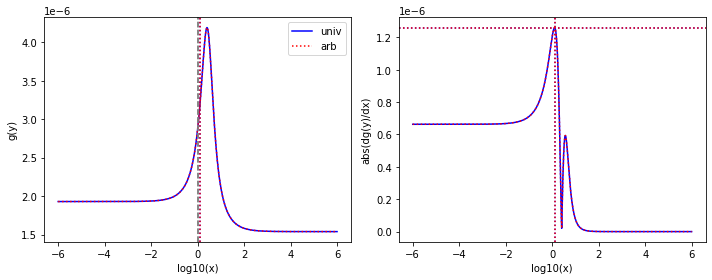

[1.12677e+00 1.00000e-03 2.31626e+00 1.00000e-03 3.92159e-02 1.27959e-02
 8.11894e-02 1.00000e-03 9.87812e+00 4.69340e-03]
found K1
found pairwise
found triplewise
2.0556635338179046 2.0556635338179046
0.03480381976800944 0.03480381976800944
0.07205498903946679 0.0720549890394668
8.766758078401093 8.766758078401095
# maximal error is 1.7763568394002505e-15
min-max are 3.529814346881038e-10 57509182446202.92
From univ parameters, position and steepness are: 1.2792552650639757 0.0006114754239474153 0.23651886378020753
From arb parameters, position and steepness are: 1.279255265063976 0.000611475423947415 0.2365188637802075


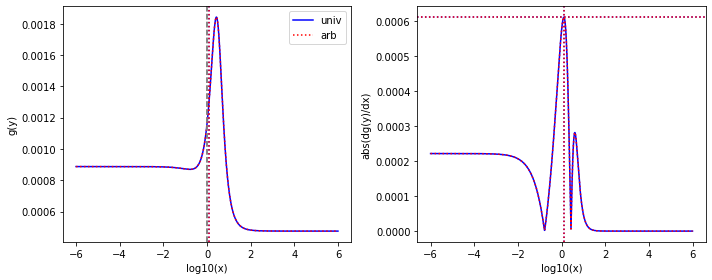

[9.27151e+00 1.00000e-03 2.86511e+00 1.00000e-03 7.09905e-02 6.88141e-03
 1.00000e-03 1.00000e-03 2.26106e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.30902301782557534 0.30902301782557534
0.0076568433836559525 0.0076568433836559525
0.00010785729616858528 0.00010785729616858528
2.4387181807494143 2.4387181807494143
# maximal error is 0.0
min-max are 3.529814346881038e-10 12652025123734.594
From univ parameters, position and steepness are: 1.284156647352047 0.00014544378815591015 0.308369347006848
From arb parameters, position and steepness are: 1.284156647352047 0.00014544378815591015 0.308369347006848


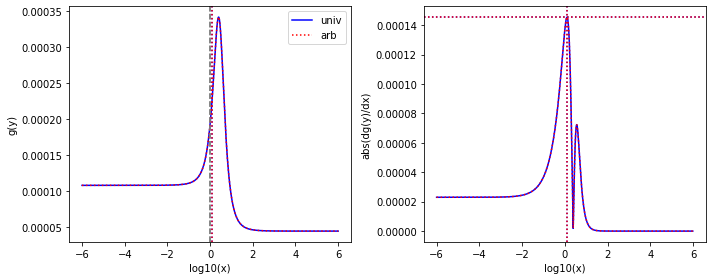

[6.16441e+00 1.00000e-03 5.27828e+00 1.92813e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 1.93684e+01 2.53471e-03]
found K1
found pairwise
found triplewise
0.8562506387472604 0.8562506387472604
0.0001622215264721198 0.0001622215264721198
0.0001622215264721198 0.00016222152647211977
3.1419714133226053 3.141971413322605
# maximal error is 4.440892098500626e-16
min-max are 3.529814346881038e-10 268051463877.8711
From univ parameters, position and steepness are: 1.2954218775332123 3.5528021440472244e-05 0.18828550475407635
From arb parameters, position and steepness are: 1.2954218775332123 3.552802144047224e-05 0.18828550475407632


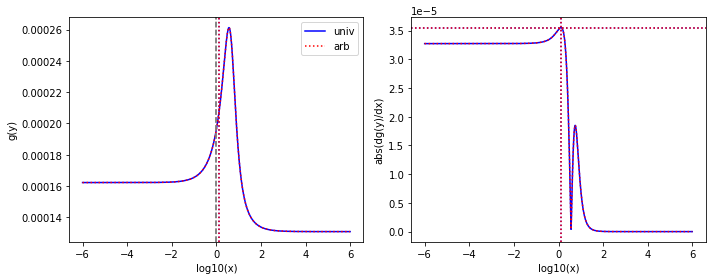

[3.81640e+02 1.58203e-02 1.00000e-03 1.00000e-03 6.93145e-03 2.35776e-03
 5.53100e+01 1.13039e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
2.6202704119065087e-06 2.6202704119065087e-06
1.816227334660937e-05 1.816227334660937e-05
0.144927156482549 0.14492715648254903
0.05840792369772561 0.05840792369772561
# maximal error is 2.7755575615628914e-17
min-max are 2.498058915578641e-10 147396858783008.5
From univ parameters, position and steepness are: 1.3028128946438005 2.4555234769095373e-06 0.39930297996404557
From arb parameters, position and steepness are: 1.302812894643801 2.4555234769095364e-06 0.39930297996404546


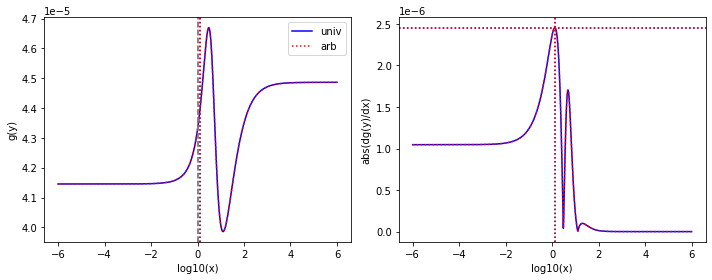

[1.12677e+00 1.00000e-03 6.88338e-02 1.00000e-03 2.87036e-02 9.36786e-03
 7.46136e-02 1.00000e-03 9.87812e+00 4.69340e-03]
found K1
found pairwise
found triplewise
0.06108948587555579 0.06108948587555579
0.025474231653309903 0.025474231653309906
0.06621901541574589 0.06621901541574589
8.766758078401093 8.766758078401095
# maximal error is 1.7763568394002505e-15
min-max are 3.529814346881038e-10 42093145536113.91
From univ parameters, position and steepness are: 1.3115923527025415 0.0009283154598671941 0.21451595841585738
From arb parameters, position and steepness are: 1.3115923527025417 0.0009283154598671939 0.21451595841585738


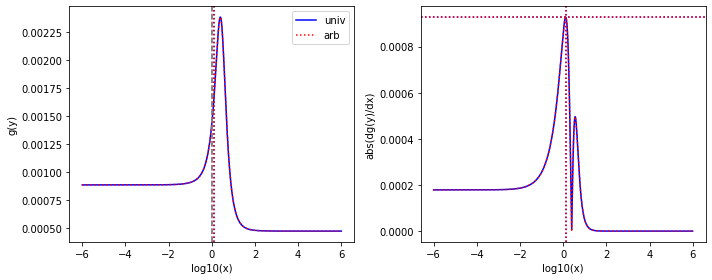

[1.51365e+02 2.93217e+00 2.93419e+00 7.49291e-03 1.00000e-03 1.00000e-03
 1.00000e+03 3.32825e+01 1.70545e-01 1.76265e-03]
found K1
found pairwise
found triplewise
0.019384864400621014 0.01938486440062101
6.606547088164371e-06 6.606547088164371e-06
6.606547088164371 6.606547088164371
0.0011267135731509925 0.0011267135731509925
# maximal error is 3.469446951953614e-18
min-max are 7.027031419536454e-09 10916434540.825615
From univ parameters, position and steepness are: 1.3208988680518585 0.007026196759061767 0.32221117407112393
From arb parameters, position and steepness are: 1.3208988680518585 0.007026196759061766 0.3222111740711239


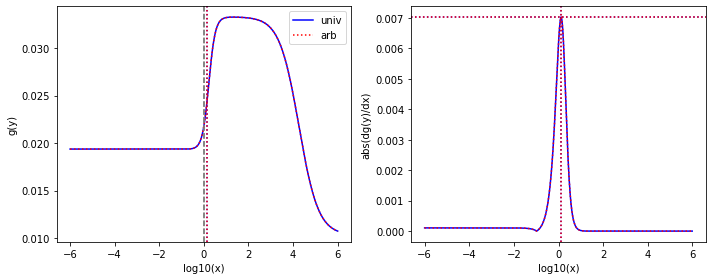

[6.54741e+00 1.00000e-03 2.86511e+00 4.10271e-03 7.09905e-02 6.88141e-03
 1.00000e-03 1.00000e-03 2.26106e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.43759440755963047 0.43759440755963047
0.010842531627009764 0.010842531627009763
0.00015273214904824961 0.00015273214904824961
3.4533655292703527 3.4533655292703527
# maximal error is 1.734723475976807e-18
min-max are 3.529814346881038e-10 17915996968700.32
From univ parameters, position and steepness are: 1.3304249008515603 0.00018358307915153967 0.21144249419999664
From arb parameters, position and steepness are: 1.3304249008515603 0.00018358307915153967 0.21144249419999667


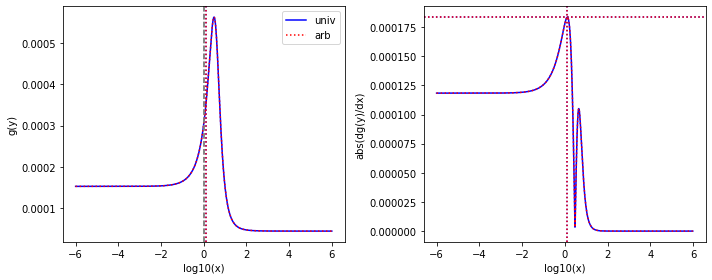

[6.53577e+00 1.00000e-03 7.32126e-03 4.17116e-03 1.08446e-03 1.00000e-03
 4.80350e-03 4.80350e-03 1.64247e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.0011201832377822352 0.0011201832377822352
0.00016592689155218128 0.00016592689155218128
0.0007349554834395946 0.0007349554834395947
2.5130474297596153 2.513047429759615
# maximal error is 4.440892098500626e-16
min-max are 3.529814346881038e-10 274174408393.8185
From univ parameters, position and steepness are: 1.3406903087826578 0.00020805761199298186 0.24993311340464464
From arb parameters, position and steepness are: 1.3406903087826578 0.00020805761199298194 0.24993311340464466


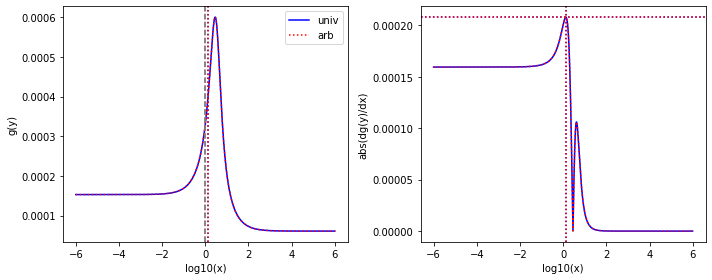

[6.53577e+00 1.00000e-03 2.86511e+00 1.00000e-03 7.09905e-02 6.88141e-03
 1.00000e-03 1.00000e-03 2.26106e+01 1.49470e-03]
found K1
found pairwise
found triplewise
0.4383737493822457 0.4383737493822457
0.010861841833479451 0.010861841833479451
0.00015300416018311538 0.00015300416018311538
3.459515864236349 3.459515864236349
# maximal error is 0.0
min-max are 3.529814346881038e-10 17947904793764.176
From univ parameters, position and steepness are: 1.353328453089376 0.00015085456502338029 0.26445913841904295
From arb parameters, position and steepness are: 1.353328453089376 0.00015085456502338029 0.26445913841904295


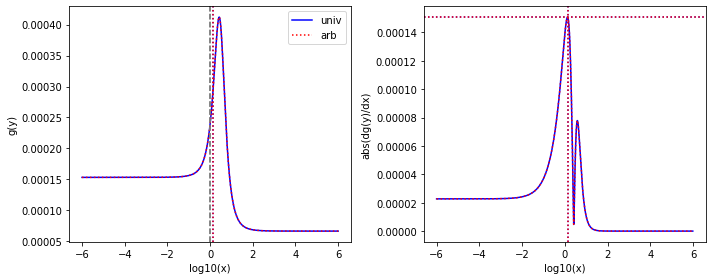

[2.22568e+00 1.76522e-02 3.62173e-01 1.00000e-03 1.08233e+02 1.90275e+00
 1.00000e+03 2.05529e+01 1.39418e+02 1.40179e-01]
found K1
found pairwise
found triplewise
0.16272465044390927 0.16272465044390927
48.62918299126559 48.62918299126559
449.3008878185543 449.3008878185543
62.64063117788721 62.64063117788721
# maximal error is 0.0
min-max are 3.529814346881038e-10 8.035395572842173e+16
From univ parameters, position and steepness are: 1.3648687753444446 0.004363643027704362 0.0566280141913772
From arb parameters, position and steepness are: 1.3648687753444446 0.004363643027704363 0.0566280141913772


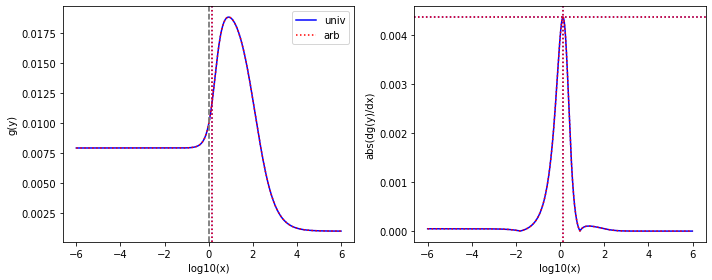

[1.79183e+01 2.63924e-03 1.44608e-01 8.16035e-03 1.00000e-03 1.00000e-03
 3.02332e+01 9.78743e-03 2.22908e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.008070408465088764 0.008070408465088766
5.580886579642042e-05 5.580886579642043e-05
1.687280601396338 1.687280601396338
1.2440242656948484 1.2440242656948486
# maximal error is 2.220446049250313e-16
min-max are 3.529814346881038e-10 92217432597.36034
From univ parameters, position and steepness are: 1.3741990550335654 6.227819705616536e-05 0.13046570574577215
From arb parameters, position and steepness are: 1.3741990550335654 6.227819705616536e-05 0.13046570574577215


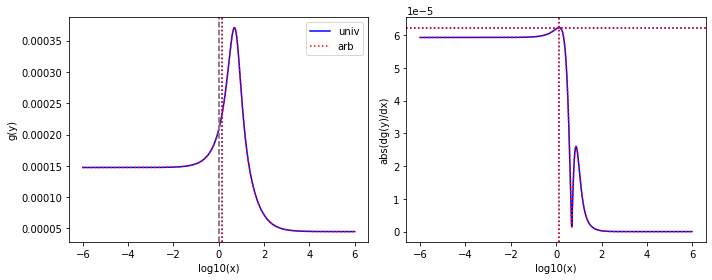

[6.54741e+00 1.00000e-03 2.86511e+00 1.00000e-03 7.09905e-02 8.28435e-03
 1.00000e-03 1.00000e-03 2.26106e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.43759440755963047 0.43759440755963047
0.010842531627009764 0.010842531627009763
0.00015273214904824961 0.00015273214904824961
3.4533655292703527 3.4533655292703527
# maximal error is 1.734723475976807e-18
min-max are 3.529814346881038e-10 17915996968700.32
From univ parameters, position and steepness are: 1.3808133391656354 0.00017238100036153856 0.25895686369345006
From arb parameters, position and steepness are: 1.3808133391656354 0.00017238100036153856 0.25895686369345006


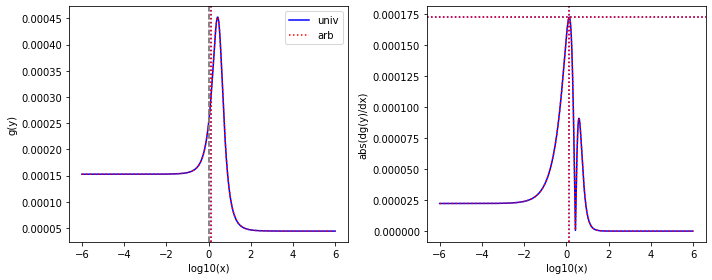

[6.53577e+00 1.00000e-03 2.86511e+00 3.08119e-03 1.37741e-01 6.88141e-03
 1.00000e-03 1.00000e-03 2.26106e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.4383737493822457 0.4383737493822457
0.021074946027782496 0.021074946027782496
0.00015300416018311538 0.00015300416018311535
3.459515864236349 3.459515864236349
# maximal error is 2.710505431213761e-20
min-max are 7.027031419536454e-09 34823847834544.34
From univ parameters, position and steepness are: 1.3963876857997886 0.00016336189520463302 0.21540113032465952
From arb parameters, position and steepness are: 1.3963876857997886 0.00016336189520463305 0.21540113032465952


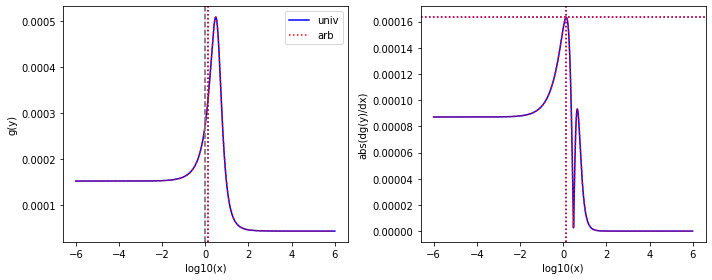

[6.54741e+00 1.00000e-03 1.00000e-03 1.00000e-03 1.89268e-01 6.88141e-03
 1.00000e-03 1.00000e-03 2.26106e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.00015273214904824961 0.00015273214904824961
0.028907308386064107 0.028907308386064107
0.00015273214904824961 0.00015273214904824961
3.4533655292703527 3.4533655292703527
# maximal error is 0.0
min-max are 3.529814346881038e-10 47765897570130.945
From univ parameters, position and steepness are: 1.4036027822333645 0.00018444666131556405 0.25237104465924265
From arb parameters, position and steepness are: 1.4036027822333645 0.00018444666131556408 0.2523710446592427


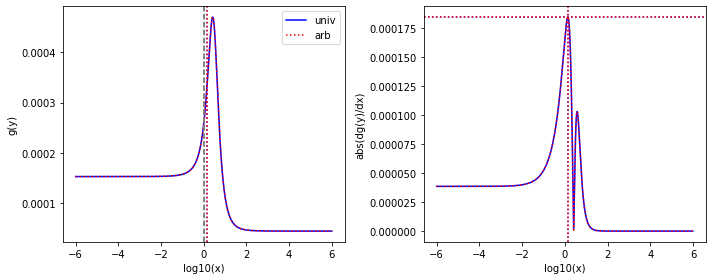

[6.54741e+00 1.00000e-03 2.86511e+00 1.00000e-03 7.09905e-02 1.00935e-02
 1.00000e-03 1.00000e-03 3.03742e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.43759440755963047 0.43759440755963047
0.010842531627009764 0.010842531627009763
0.00015273214904824961 0.00015273214904824961
4.639116841621343 4.639116841621343
# maximal error is 1.734723475976807e-18
min-max are 3.529814346881038e-10 17915996968700.32
From univ parameters, position and steepness are: 1.41770472052284 0.00017326933216821048 0.23327866747590348
From arb parameters, position and steepness are: 1.41770472052284 0.00017326933216821046 0.23327866747590345


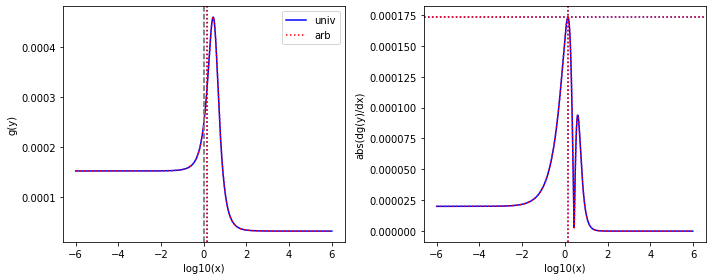

[8.56180e+00 5.44733e+00 1.42062e+00 1.00000e-03 2.71858e-01 1.34178e-02
 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.16592538952089514 0.16592538952089514
0.0317524352355813 0.0317524352355813
0.00011679786960685838 0.00011679786960685839
0.00011679786960685838 0.00011679786960685838
# maximal error is 1.3552527156068805e-20
min-max are 7.027031419536454e-09 52467132102899.91
From univ parameters, position and steepness are: 1.421804297118078 0.00811874096374413 0.07690088703766525
From arb parameters, position and steepness are: 1.4218042971180824 0.008118740963744101 0.07690088703766497


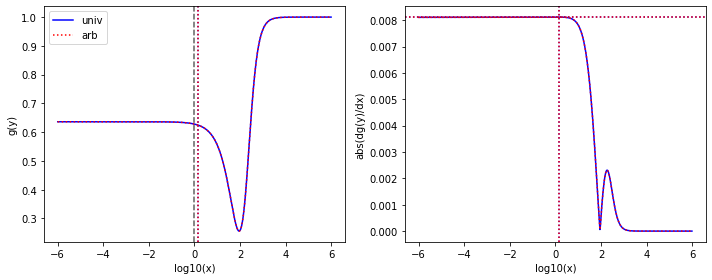

[1.03381e+02 8.20185e-01 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 6.59265e+02 1.46593e+01 4.58116e+01 1.00000e-03]
found K1
found pairwise
found triplewise
9.672957313239377e-06 9.672957313239377e-06
9.672957313239377e-06 9.672957313239377e-06
6.377042203112757 6.377042203112758
0.443133651251197 0.4431336512511971
# maximal error is 8.881784197001252e-16
min-max are 2.498058915578641e-10 2653186062831370.0
From univ parameters, position and steepness are: 1.4353296175101702 0.006161783123759818 0.29024492386954137
From arb parameters, position and steepness are: 1.4353296175101702 0.00616178312375982 0.2902449238695414


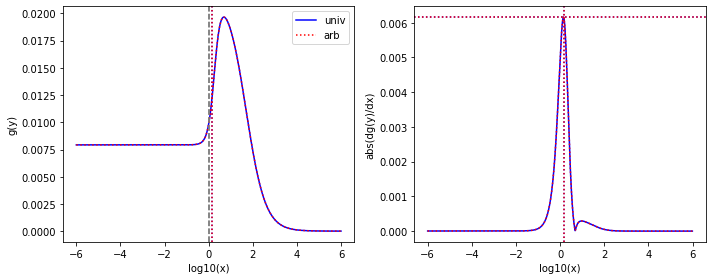

[6.54741e+00 1.00000e-03 2.86511e+00 1.00000e-03 3.77753e-02 6.88141e-03
 1.00000e-03 1.00000e-03 2.09469e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.43759440755963047 0.43759440755963047
0.005769502749942343 0.005769502749942343
0.00015273214904824961 0.00015273214904824961
3.1992650528987796 3.1992650528987796
# maximal error is 0.0
min-max are 3.529814346881038e-10 9533418592443.48
From univ parameters, position and steepness are: 1.4419099210009205 0.00014367885976944485 0.25082823174957086
From arb parameters, position and steepness are: 1.4419099210009205 0.00014367885976944485 0.25082823174957086


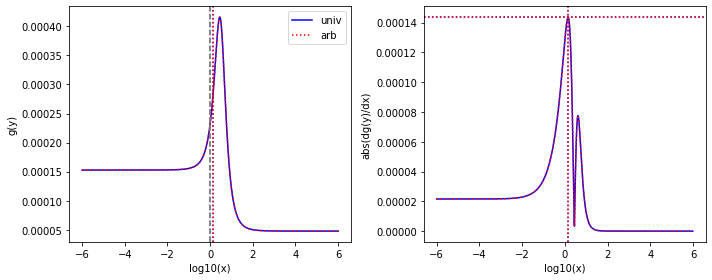

[1.00000e+03 6.85501e+00 1.00000e-03 1.00000e-03 5.67775e-03 1.87936e-03
 1.73213e+02 3.18879e+00 4.11698e+00 2.05653e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
5.67775e-06 5.677750000000001e-06
0.173213 0.173213
0.00411698 0.00411698
# maximal error is 8.470329472543003e-22
min-max are 2.498058915578641e-10 122238288835046.38
From univ parameters, position and steepness are: 1.4551931207267965 0.004863148435422884 0.9490663415751927
From arb parameters, position and steepness are: 1.4551931207267967 0.004863148435422881 0.9490663415751924


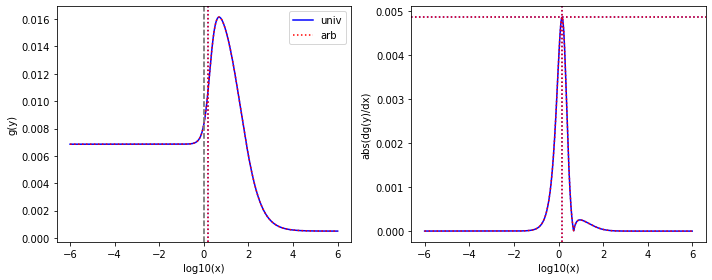

[6.54741e+00 1.00000e-03 2.86511e+00 1.00000e-03 7.09905e-02 6.88141e-03
 1.42331e-03 1.00000e-03 2.26106e+01 1.10788e-03]
found K1
found pairwise
found triplewise
0.43759440755963047 0.43759440755963047
0.010842531627009764 0.010842531627009763
0.00021738519506186413 0.00021738519506186413
3.4533655292703527 3.453365529270353
# maximal error is 4.440892098500626e-16
min-max are 3.529814346881038e-10 17915996968700.32
From univ parameters, position and steepness are: 1.4602367054417225 0.00013602464723876695 0.24209226125897876
From arb parameters, position and steepness are: 1.4602367054417225 0.00013602464723876692 0.24209226125897876


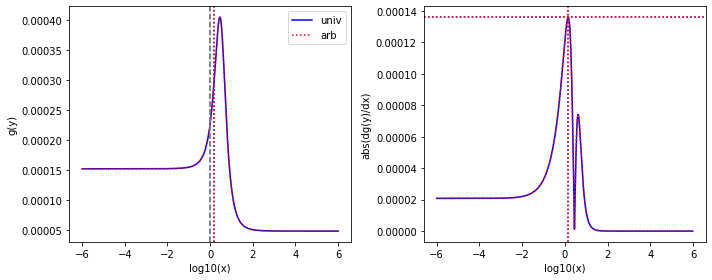

[3.58797e+00 1.00000e-03 3.60293e+00 1.00000e-03 2.90969e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78531e+00 1.00000e-03]
found K1
found pairwise
found triplewise
1.004169488596616 1.004169488596616
0.0008109571707678716 0.0008109571707678716
0.0002787091307898338 0.0002787091307898338
1.3337095906598997 1.3337095906598995
# maximal error is 2.220446049250313e-16
min-max are 3.529814346881038e-10 1340010106359.6758
From univ parameters, position and steepness are: 1.4796321130214471 7.878023197677969e-05 0.36756266570283286
From arb parameters, position and steepness are: 1.4796321130214474 7.878023197677967e-05 0.3675626657028328


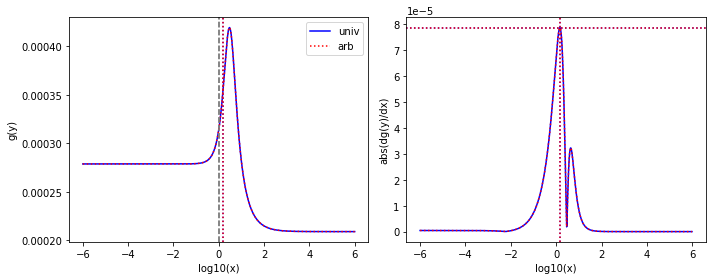

[1.12677e+00 1.00000e-03 2.31626e+00 1.00000e-03 3.13727e-02 9.36786e-03
 1.00000e-03 1.00000e-03 9.87812e+00 4.69340e-03]
found K1
found pairwise
found triplewise
2.0556635338179046 2.0556635338179046
0.02784303806455621 0.02784303806455621
0.0008874925672497493 0.0008874925672497493
8.766758078401093 8.766758078401093
# maximal error is 0.0
min-max are 7.027031419536454e-09 46007316479506.23
From univ parameters, position and steepness are: 1.4864517519263152 0.0003758187948234506 0.20708806529627574
From arb parameters, position and steepness are: 1.4864517519263154 0.0003758187948234504 0.2070880652962757


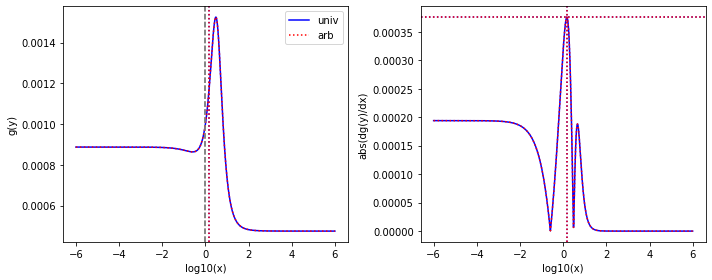

[6.54741e+00 1.00000e-03 2.86511e+00 1.00000e-03 7.09905e-02 6.88141e-03
 1.00000e-03 1.00000e-03 2.26106e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.43759440755963047 0.43759440755963047
0.010842531627009764 0.010842531627009763
0.00015273214904824961 0.00015273214904824961
3.4533655292703527 3.4533655292703527
# maximal error is 1.734723475976807e-18
min-max are 3.529814346881038e-10 17915996968700.32
From univ parameters, position and steepness are: 1.4957580031926245 0.00013179819863130528 0.2354941070715079
From arb parameters, position and steepness are: 1.4957580031926248 0.00013179819863130528 0.2354941070715079


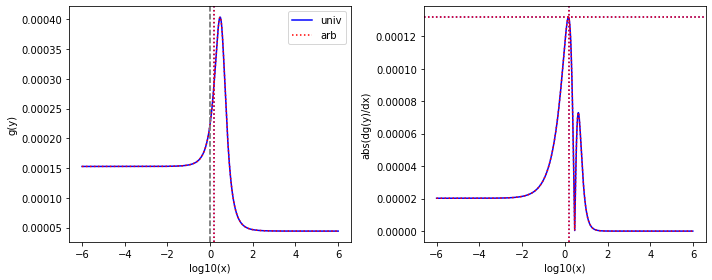

[4.13403e+01 1.00000e-03 3.66493e-02 2.93442e-03 1.00000e-03 1.00000e-03
 1.00000e+03 1.00000e-03 1.13949e+01 1.81266e-01]
found K1
found pairwise
found triplewise
0.0008865271901752044 0.0008865271901752044
2.4189471290726e-05 2.4189471290726e-05
24.189471290726 24.189471290726004
0.2756366064106937 0.27563660641069376
# maximal error is 3.552713678800501e-15
min-max are 7.027031419536454e-09 39970136624.52278
From univ parameters, position and steepness are: 0.006672608013162513 0.016617101671225414 88.01468654927842
From arb parameters, position and steepness are: 0.006672608013162513 0.01661710167122541 88.01468654927842


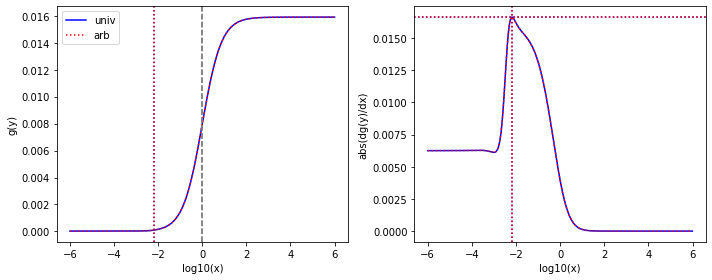

[8.56180e+00 5.44733e+00 1.42062e+00 1.00000e-03 2.71858e-01 1.00000e-03
 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.16592538952089514 0.16592538952089514
0.0317524352355813 0.0317524352355813
0.00011679786960685838 0.00011679786960685839
0.00011679786960685838 0.00011679786960685838
# maximal error is 1.3552527156068805e-20
min-max are 7.027031419536454e-09 52467132102899.91
From univ parameters, position and steepness are: 1.4954534292760178 0.017107033911069935 0.1612942072066816
From arb parameters, position and steepness are: 1.4954534292760202 0.017107033911069908 0.16129420720668136


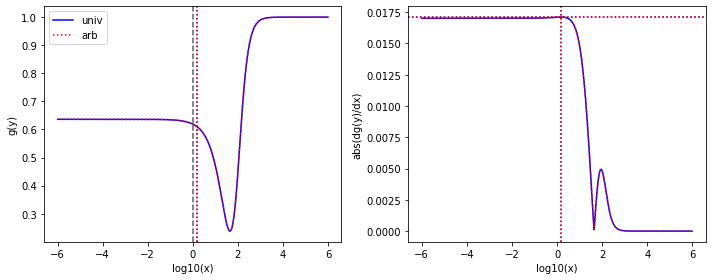

[4.13403e+01 1.00000e-03 1.25230e-01 4.37585e-03 3.91471e-02 2.16728e-02
 1.00000e+03 1.00000e-03 2.17521e+01 4.45717e-01]
found K1
found pairwise
found triplewise
0.003029247489737617 0.003029247489737617
0.0009469476515651797 0.0009469476515651798
24.189471290726 24.189471290726
0.526171798463001 0.5261717984630009
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 1564718556653.927
From univ parameters, position and steepness are: 0.008137808481306097 0.024070756367834827 46.07468929356309
From arb parameters, position and steepness are: 0.008137808481306096 0.024070756367834827 46.07468929356309


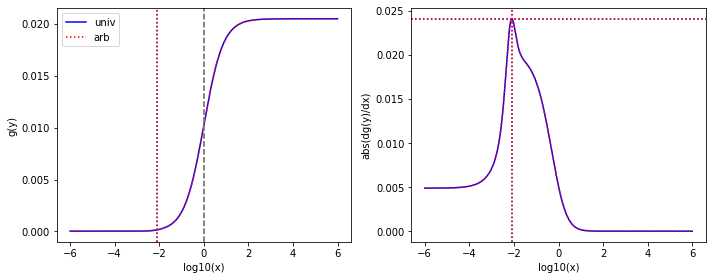

[3.09213e+00 6.37426e-02 1.00000e-03 1.00000e-03 4.34660e-03 1.14461e-03
 1.93959e+01 1.75576e+01 7.85137e+02 3.47559e-03]
found K1
found pairwise
found triplewise
0.0003234016681058041 0.0003234016681058041
0.001405697690588688 0.001405697690588688
6.272666414413366 6.272666414413366
253.9146154915867 253.91461549158666
# maximal error is 2.842170943040401e-14
min-max are 3.529814346881038e-10 2322748572788.081
From univ parameters, position and steepness are: 1.4948744249782844 0.024571455592603653 0.11008102794822086
From arb parameters, position and steepness are: 1.4948744249782844 0.024571455592603653 0.11008102794822086


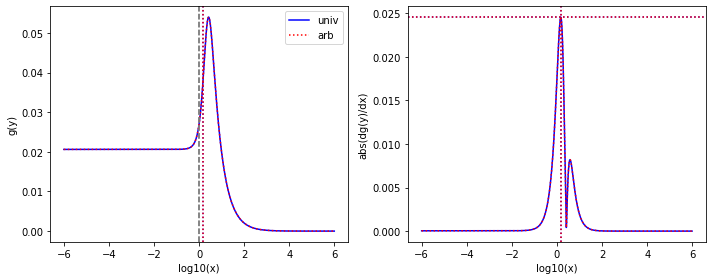

[7.13105e+02 5.95383e-03 1.00000e-03 1.00000e-03 2.68668e+00 1.00000e-03
 4.67876e+02 1.00000e-03 2.74112e-02 1.00000e-03]
found K1
found pairwise
found triplewise
1.4023180317064106e-06 1.4023180317064106e-06
0.0037675798094249794 0.0037675798094249794
0.6561109514026685 0.6561109514026686
3.843922003071076e-05 3.843922003071076e-05
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 3.059934326952232e+16
From univ parameters, position and steepness are: 0.0014960826098465363 0.0363274257377154 17074.166203597335
From arb parameters, position and steepness are: 0.001496082609846536 0.0363274257377154 17074.16620359734


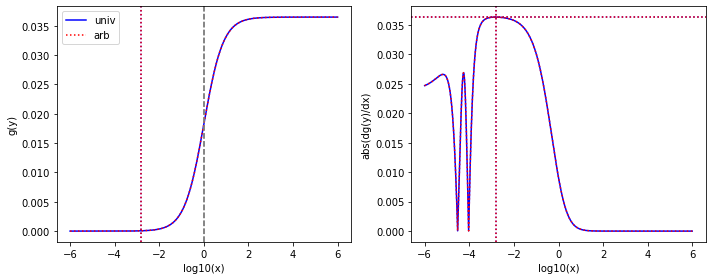

[1.00000e+03 3.45248e+01 2.89885e+01 4.82396e-03 1.10562e-03 1.00000e-03
 9.53038e+00 9.53038e+00 2.43135e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.028988499999999997 0.028988499999999993
1.1056200000000002e-06 1.1056200000000002e-06
0.00953038 0.00953038
0.024313500000000002 0.0243135
# maximal error is 3.469446951953614e-18
min-max are 3.529814346881038e-10 1826802121.511566
From univ parameters, position and steepness are: 1.4977704567903851 0.039286897834735546 1.114703216547488
From arb parameters, position and steepness are: 1.4977704567903851 0.03928689783473555 1.114703216547488


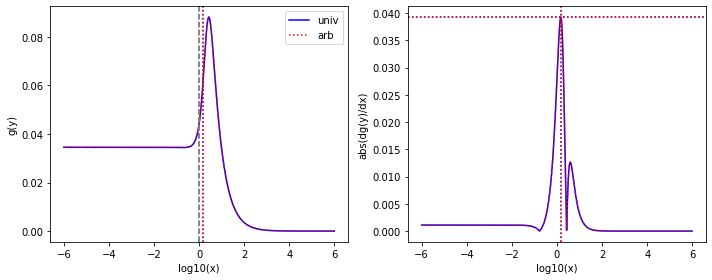

[1.00000e+03 2.30088e-01 1.00000e-03 1.00000e-03 1.94547e-01 7.72724e-03
 4.43150e+02 1.71419e-01 7.20938e-01 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
0.000194547 0.000194547
0.44315 0.44315
0.000720938 0.0007209380000000001
# maximal error is 1.0842021724855044e-19
min-max are 2.498058915578641e-10 1580022257428808.5
From univ parameters, position and steepness are: 0.0022686349610057293 0.04818051592243625 448.1089776296263
From arb parameters, position and steepness are: 0.0022686349610057293 0.04818051592243626 448.1089776296263


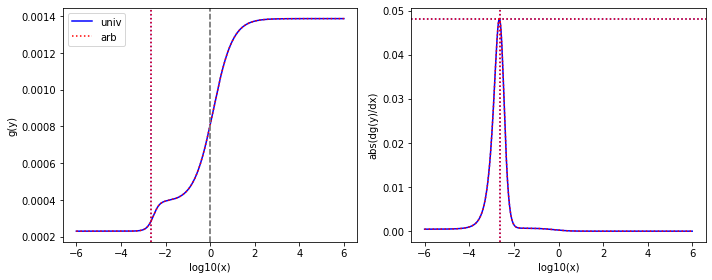

[1.00000e+03 3.45248e+01 1.59685e+01 9.00815e-03 1.00000e-03 1.00000e-03
 9.53038e+00 9.53038e+00 2.43135e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.0159685 0.015968499999999997
1e-06 1e-06
0.00953038 0.00953038
0.024313500000000002 0.0243135
# maximal error is 3.469446951953614e-18
min-max are 3.529814346881038e-10 1652281687.0546515
From univ parameters, position and steepness are: 1.494233603664308 0.04004783727423419 1.1115018333738247
From arb parameters, position and steepness are: 1.494233603664308 0.04004783727423419 1.1115018333738247


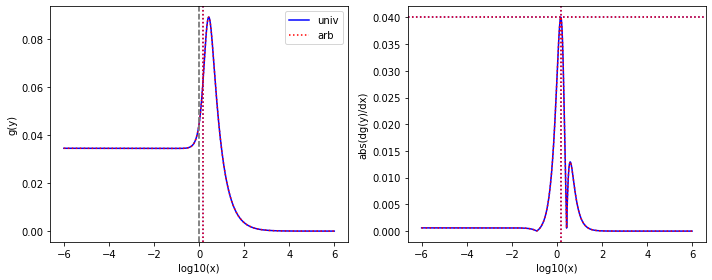

[7.61609e-02 7.61609e-02 1.00000e-03 1.00000e-03 1.81025e-03 1.81025e-03
 7.02031e+00 7.02031e+00 2.04428e-02 1.95751e-02]
found K1
found pairwise
found triplewise
0.013130096939505703 0.013130096939505705
0.0237687579847402 0.023768757984740197
92.17735084538128 92.17735084538128
0.2684159457149272 0.2684159457149272
# maximal error is 3.469446951953614e-18
min-max are 3.529814346881038e-10 39275052644170.19
From univ parameters, position and steepness are: 0.0008125415027056468 0.056463327808754196 343.41260892420075
From arb parameters, position and steepness are: 0.0008125415027056468 0.05646332780875441 343.41260892420075


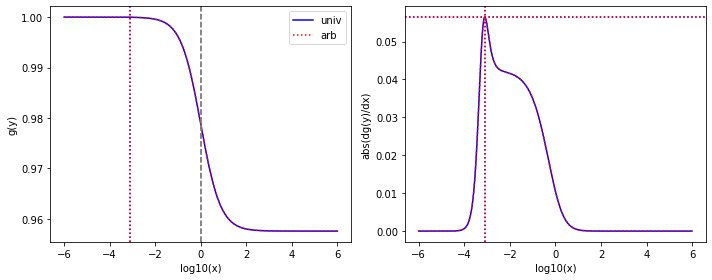

[1.20705e+00 6.37426e-02 2.34980e-01 1.00000e-03 1.19594e-01 1.00000e-03
 1.93959e+01 1.75576e+01 2.75931e+02 3.03051e-01]
found K1
found pairwise
found triplewise
0.19467296300898887 0.19467296300898887
0.09907957416842716 0.09907957416842716
16.068845532496585 16.068845532496585
228.59947806636012 228.59947806636012
# maximal error is 0.0
min-max are 3.529814346881038e-10 163717241767997.03
From univ parameters, position and steepness are: 1.4989876550870207 0.05804053469758289 0.11066703825845807
From arb parameters, position and steepness are: 1.4989876550870207 0.058040534697582906 0.11066703825845807


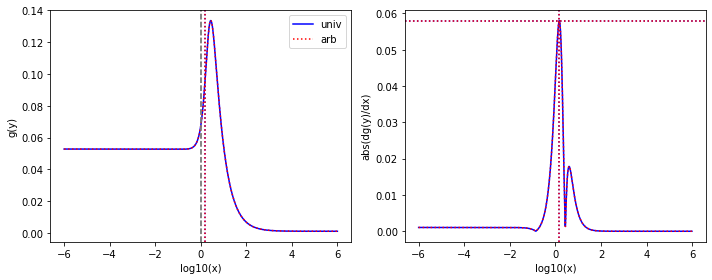

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.79366e+02 1.00000e-03 2.56942e-02 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1e-06 1e-06
0.47936599999999996 0.47936599999999996
2.56942e-05 2.5694199999999995e-05
# maximal error is 3.3881317890172014e-21
min-max are 2.498058915578641e-10 1929181934408629.2
From univ parameters, position and steepness are: 5.510259990962416e-05 0.06485669512313581 18655.542576272193
From arb parameters, position and steepness are: 5.510259990962415e-05 0.06485669512313583 18655.5425762722


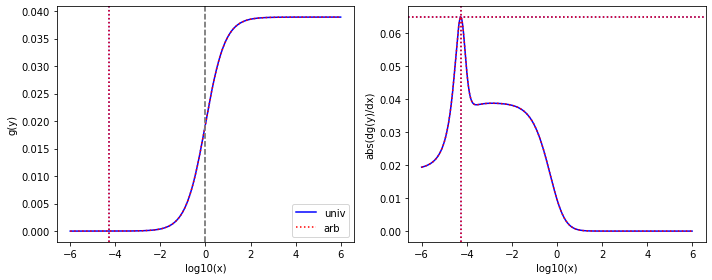

[1.20705e+00 6.37426e-02 5.92361e-03 2.29237e-03 1.00000e-03 1.00000e-03
 1.93959e+01 1.75576e+01 2.75931e+02 3.03051e-01]
found K1
found pairwise
found triplewise
0.004907510045151402 0.004907510045151402
0.0008284660950250611 0.0008284660950250611
16.068845532496585 16.068845532496585
228.59947806636012 228.5994780663601
# maximal error is 2.842170943040401e-14
min-max are 3.529814346881038e-10 1368941840042.314
From univ parameters, position and steepness are: 1.491859415847416 0.06004285107544922 0.11026562884343313
From arb parameters, position and steepness are: 1.491859415847416 0.06004285107544922 0.11026562884343313


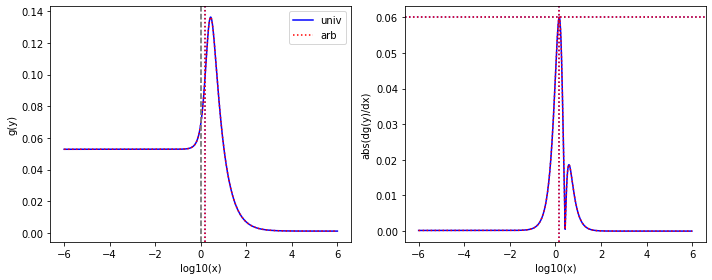

[1.00000e+03 1.88032e-03 1.00000e-03 1.00000e-03 2.79648e-03 1.00000e-03
 1.00000e+03 1.00000e-03 1.77186e-02 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
2.79648e-06 2.79648e-06
1.0 1.0
1.77186e-05 1.77186e-05
# maximal error is 0.0
min-max are 2.498058915578641e-10 1434200095716504.0
From univ parameters, position and steepness are: 5.59104763440252e-06 0.07544378276154717 56439.628217631995
From arb parameters, position and steepness are: 5.591047634402517e-06 0.07544378276154719 56439.62821763202


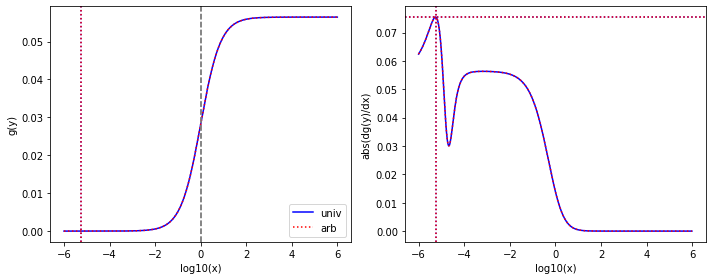

[4.13403e+01 6.70745e+00 5.15122e-03 1.00000e-03 7.47715e+01 2.77531e-03
 1.00000e+03 3.70198e+02 1.85000e+01 3.54419e-01]
found K1
found pairwise
found triplewise
0.00012460528830221358 0.00012460528830221358
1.8086830526145192 1.8086830526145194
24.189471290726 24.189471290726
0.447505218878431 0.44750521887843103
# maximal error is 2.220446049250313e-16
min-max are 3.529814346881038e-10 2988634169697974.0
From univ parameters, position and steepness are: 1.4912391283247004 0.07555696792110841 0.19084977109519025
From arb parameters, position and steepness are: 1.4912391283247004 0.0755569679211084 0.19084977109519025


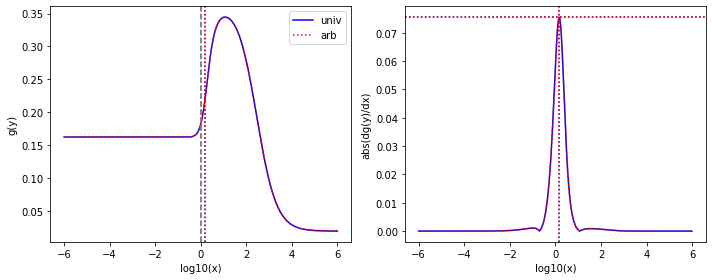

[1.08958e+01 7.96553e+00 1.72146e+00 7.63347e-02 2.71858e-01 1.17819e-02
 7.80426e-03 3.38092e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.15799298812386425 0.15799298812386425
0.024950714954386093 0.024950714954386093
0.0007162631472677546 0.0007162631472677547
9.177848345233944e-05 9.177848345233943e-05
# maximal error is 1.0842021724855044e-19
min-max are 3.529814346881038e-10 41228096268586.34
From univ parameters, position and steepness are: 0.0031276231646496194 0.08092979256339904 0.7459160568430554
From arb parameters, position and steepness are: 0.0031276231646490847 0.08092979256339898 0.745916056843055


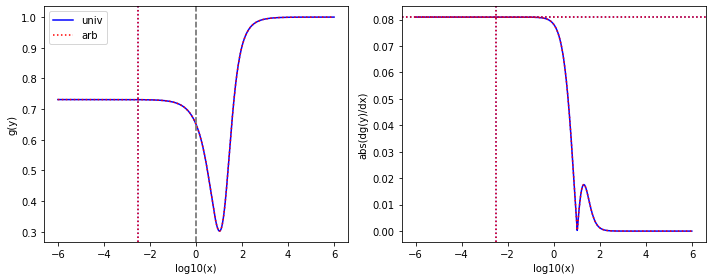

[4.13403e+01 7.31391e+00 1.25230e-01 4.37585e-03 1.00000e-03 1.00000e-03
 1.00000e+03 3.70198e+02 1.57752e+01 6.76552e-01]
found K1
found pairwise
found triplewise
0.003029247489737617 0.003029247489737617
2.4189471290726e-05 2.4189471290726e-05
24.189471290726 24.189471290726
0.38159374750546077 0.3815937475054608
# maximal error is 5.551115123125783e-17
min-max are 7.027031419536454e-09 39970135952.21145
From univ parameters, position and steepness are: 1.4955874867320187 0.08508016473312192 0.18278243096164049
From arb parameters, position and steepness are: 1.4955874867320191 0.0850801647331219 0.18278243096164046


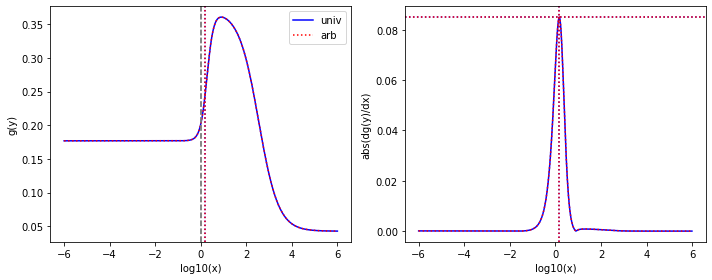

[1.00000e+03 1.00000e-03 5.29058e-02 1.00000e-03 1.00000e-03 1.00000e-03
 4.65198e+02 1.00000e-03 1.71450e+00 1.21766e-01]
found K1
found pairwise
found triplewise
5.2905800000000004e-05 5.2905800000000004e-05
1e-06 1e-06
0.465198 0.46519800000000006
0.0017144999999999999 0.0017144999999999997
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 2589035182943384.0
From univ parameters, position and steepness are: 0.005929318095492281 0.09398248498592161 271.32277034410606
From arb parameters, position and steepness are: 0.005929318095492278 0.09398248498592161 271.3227703441061


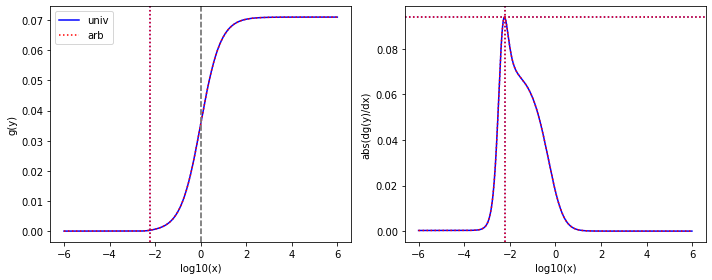

[4.13403e+01 6.70745e+00 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e+03 3.70198e+02 2.19940e+01 4.45717e-01]
found K1
found pairwise
found triplewise
2.4189471290726e-05 2.4189471290726e-05
2.4189471290726e-05 2.4189471290726e-05
24.189471290726 24.189471290726
0.5320232315682276 0.5320232315682276
# maximal error is 0.0
min-max are 2.498058915578641e-10 4024461775392352.5
From univ parameters, position and steepness are: 1.499648911411383 0.0908663925020671 0.1819002569683414
From arb parameters, position and steepness are: 1.499648911411383 0.0908663925020671 0.18190025696834136


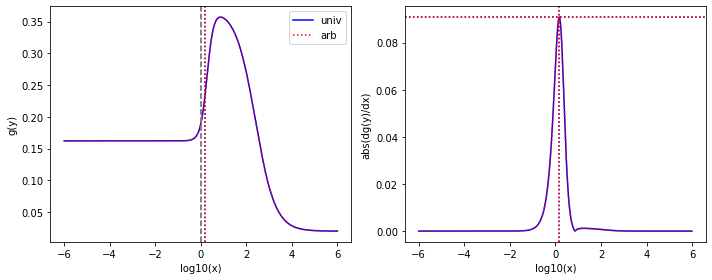

[1.51365e+02 7.40555e+00 2.93419e+00 3.35568e-03 1.18580e-03 1.18580e-03
 6.91090e+02 3.32825e+01 1.27462e+01 7.12086e-03]
found K1
found pairwise
found triplewise
0.019384864400621014 0.01938486440062101
7.83404353714531e-06 7.83404353714531e-06
4.565718627159515 4.565718627159515
0.0842083704951607 0.0842083704951607
# maximal error is 3.469446951953614e-18
min-max are 3.529814346881038e-10 12944726797.681013
From univ parameters, position and steepness are: 0.008953661276910658 0.1011743174106557 52.50268585491167
From arb parameters, position and steepness are: 0.008953661276910654 0.10117431741065538 52.50268585491168


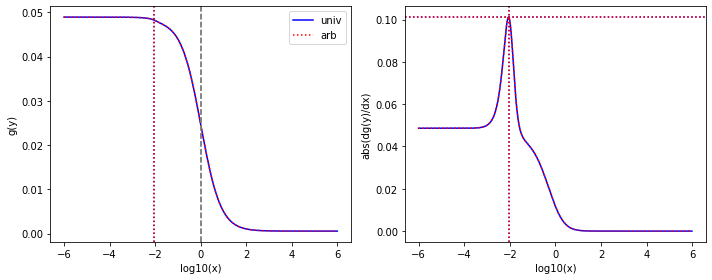

[2.22568e+00 6.06189e-01 4.10002e-03 1.00000e-03 1.08233e+02 2.81211e+00
 1.00000e+03 7.08990e+02 1.39418e+02 3.86915e-01]
found K1
found pairwise
found triplewise
0.0018421426260738292 0.0018421426260738292
48.62918299126559 48.62918299126559
449.3008878185543 449.3008878185543
62.64063117788721 62.64063117788722
# maximal error is 1.4210854715202004e-14
min-max are 3.529814346881038e-10 8.035395572847222e+16
From univ parameters, position and steepness are: 1.498886987832869 0.10946574965724101 0.0796923220229304
From arb parameters, position and steepness are: 1.498886987832869 0.10946574965724103 0.0796923220229304


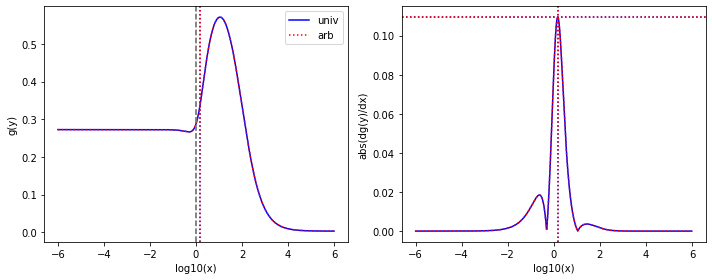

[1.00000e+03 5.74608e-02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.65198e+02 1.00000e-03 1.29218e-01 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1e-06 1e-06
0.465198 0.465198
0.000129218 0.000129218
# maximal error is 0.0
min-max are 2.498058915578641e-10 1872163602591933.5
From univ parameters, position and steepness are: 0.0002834092301475911 0.11975510704411689 3609.931811702591
From arb parameters, position and steepness are: 0.00028340923014759107 0.11975510704411692 3609.9318117025914


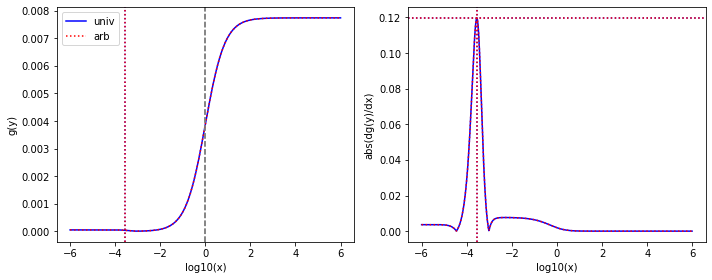

[2.22568e+00 6.06189e-01 4.10002e-03 1.00000e-03 1.08233e+02 2.30067e+00
 1.00000e+03 7.08990e+02 1.39418e+02 3.86915e-01]
found K1
found pairwise
found triplewise
0.0018421426260738292 0.0018421426260738292
48.62918299126559 48.62918299126559
449.3008878185543 449.3008878185543
62.64063117788721 62.64063117788722
# maximal error is 1.4210854715202004e-14
min-max are 3.529814346881038e-10 8.035395572847222e+16
From univ parameters, position and steepness are: 1.4923845528452908 0.1100102624700045 0.08040356171541765
From arb parameters, position and steepness are: 1.4923845528452906 0.11001026247000452 0.08040356171541767


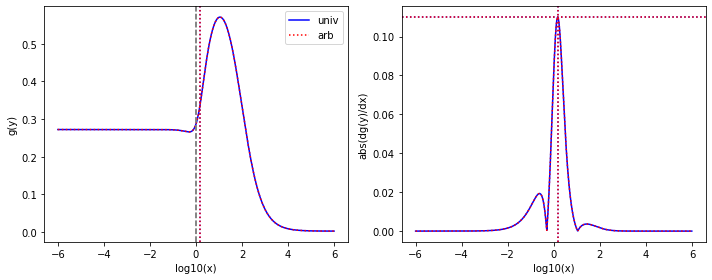

[1.00000e+03 5.52114e-02 3.26908e+00 7.30339e-02 1.00000e-03 1.00000e-03
 4.65198e+02 1.00000e-03 1.74376e+00 1.74587e-01]
found K1
found pairwise
found triplewise
0.00326908 0.00326908
1e-06 1e-06
0.465198 0.465198
0.00174376 0.00174376
# maximal error is 0.0
min-max are 7.027031419536454e-09 3143127512.887993
From univ parameters, position and steepness are: 0.006391074392760985 0.12036968884189107 267.0616179389576
From arb parameters, position and steepness are: 0.0063910743927609835 0.12036968884189109 267.0616179389577


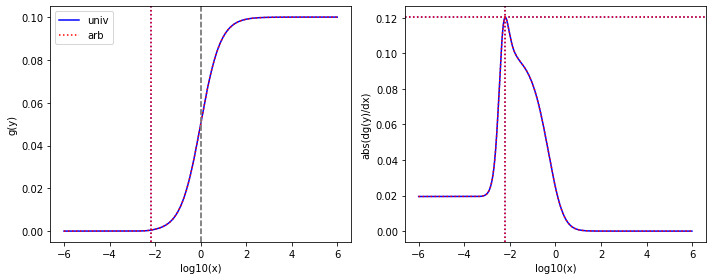

[8.56180e+00 5.44733e+00 1.05817e+00 2.35052e-01 1.42203e+00 1.96134e-02
 2.58024e-02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.12359200168188933 0.12359200168188932
0.1660900745170408 0.1660900745170408
0.0030136653507440024 0.0030136653507440024
0.00011679786960685838 0.0001167978696068584
# maximal error is 1.3877787807814457e-17
min-max are 3.529814346881038e-10 274444143768661.0
From univ parameters, position and steepness are: 1.4979870499557182 0.12374546086241969 0.7663664458190212
From arb parameters, position and steepness are: 1.4979870499557184 0.12374546086241965 0.766366445819021


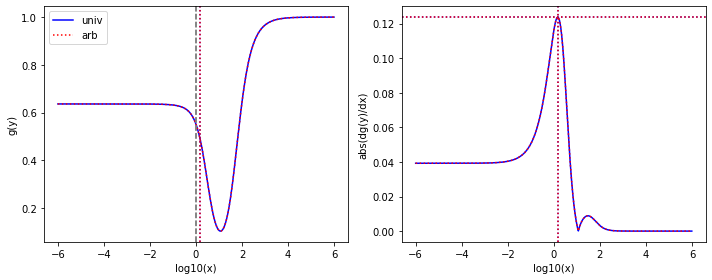

[9.46840e+02 2.83213e-02 1.00000e-03 1.00000e-03 9.38988e-02 9.38988e-02
 1.00000e+03 3.46843e-01 1.11485e+00 1.31912e-03]
found K1
found pairwise
found triplewise
1.0561446495712054e-06 1.0561446495712054e-06
9.917071522115669e-05 9.917071522115669e-05
1.0561446495712052 1.056144649571205
0.0011774428625744582 0.0011774428625744584
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 805395918575867.2
From univ parameters, position and steepness are: 0.0017784760396540957 0.13232777936276222 403.6379209055949
From arb parameters, position and steepness are: 0.0017784760396540964 0.13232777936276216 403.6379209055948


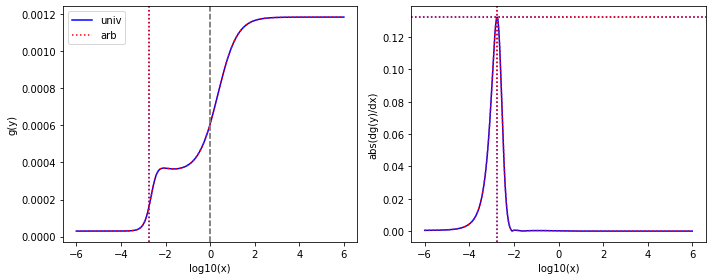

[8.56180e+00 6.53993e+00 3.00358e-01 1.01380e-03 2.71858e-01 2.93013e-03
 1.55239e-03 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.03508117451937677 0.03508117451937677
0.0317524352355813 0.0317524352355813
0.0001813158447989909 0.0001813158447989909
0.00011679786960685838 0.00011679786960685838
# maximal error is 0.0
min-max are 3.529814346881038e-10 52467132143954.28
From univ parameters, position and steepness are: 1.49309274003495 0.13970016366855548 1.629347745549635
From arb parameters, position and steepness are: 1.4930927400349499 0.1397001636685555 1.6293477455496355


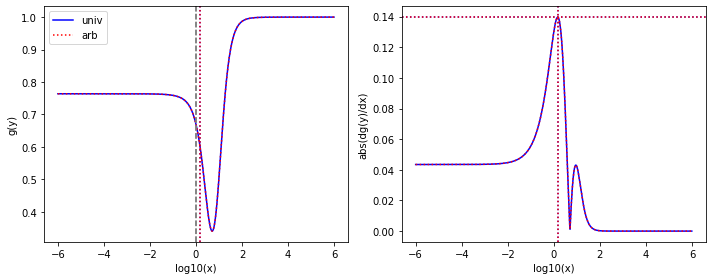

[1.00000e+03 4.12336e-01 1.80799e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.65198e+02 1.00000e-03 1.31479e+00 1.77251e-01]
found K1
found pairwise
found triplewise
1.80799e-06 1.80799e-06
1e-06 1e-06
0.465198 0.465198
0.00131479 0.0013147899999999997
# maximal error is 2.168404344971009e-19
min-max are 2.498058915578641e-10 1880267859997384.2
From univ parameters, position and steepness are: 0.007278517065709763 0.14180464808756207 355.8760354010002
From arb parameters, position and steepness are: 0.007278517065709762 0.14180464808756207 355.8760354010002


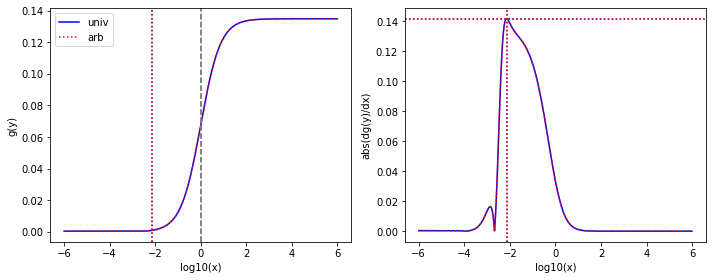

[8.56180e+00 6.53993e+00 2.86588e-01 1.92380e-03 2.70939e-01 1.00000e-03
 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.03347286785489033 0.03347286785489033
0.0316450979934126 0.0316450979934126
0.00011679786960685838 0.00011679786960685838
0.00011679786960685838 0.00011679786960685838
# maximal error is 0.0
min-max are 3.529814346881038e-10 52289770085820.19
From univ parameters, position and steepness are: 1.4967278439907703 0.14044379804009868 1.640528490646185
From arb parameters, position and steepness are: 1.49672784399077 0.14044379804009874 1.6405284906461854


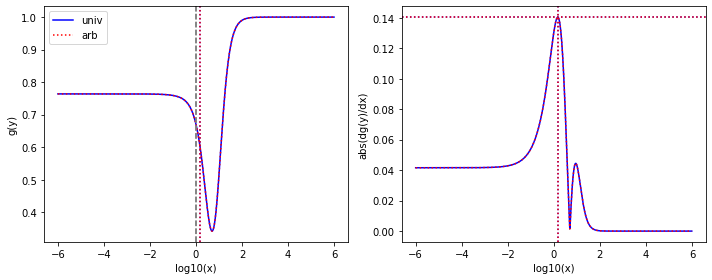

[1.08958e+01 5.44733e+00 1.72146e+00 7.63347e-02 2.71858e-01 1.17819e-02
 7.80426e-03 3.38092e-03 2.86275e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.15799298812386425 0.15799298812386425
0.024950714954386093 0.024950714954386093
0.0007162631472677546 0.0007162631472677547
0.00026273885350318473 0.00026273885350318473
# maximal error is 1.0842021724855044e-19
min-max are 3.529814346881038e-10 41228096268586.34
From univ parameters, position and steepness are: 0.00179807789071971 0.15272545914159352 2.121704917020431
From arb parameters, position and steepness are: 0.0017980778907195336 0.15272545914159352 2.121704917020431


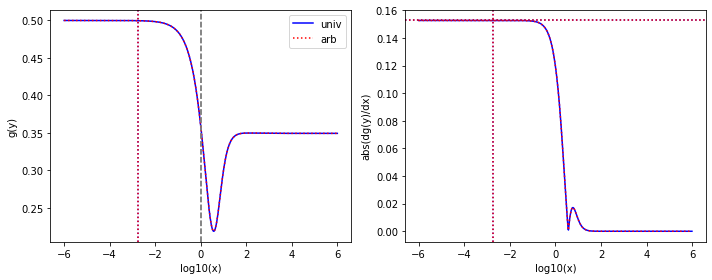

[8.56180e+00 6.53993e+00 2.05723e-03 1.00000e-03 2.70939e-01 1.51714e-03
 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00024028008129131726 0.0002402800812913173
0.0316450979934126 0.0316450979934126
0.00011679786960685838 0.00011679786960685835
0.00011679786960685838 0.00011679786960685838
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 52289770096247.414
From univ parameters, position and steepness are: 1.4986633244080272 0.15928823775314602 1.9397369842073988
From arb parameters, position and steepness are: 1.4986633244080272 0.15928823775314604 1.939736984207399


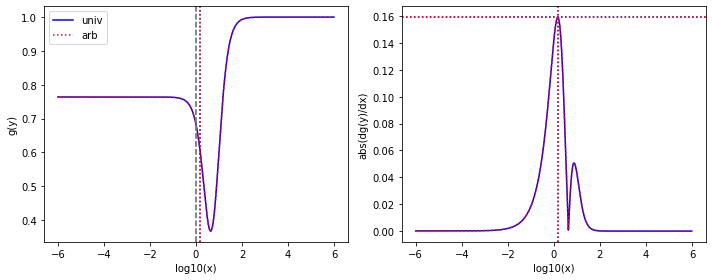

[1.71636e+02 1.00000e-03 1.00000e-03 1.00000e-03 9.70142e-03 1.00000e-03
 4.67160e+02 1.00000e-03 1.88328e-02 1.00000e-03]
found K1
found pairwise
found triplewise
5.826283530261717e-06 5.826283530261717e-06
5.652322356615163e-05 5.652322356615163e-05
2.721806613997064 2.721806613997064
0.00010972523246871286 0.00010972523246871286
# maximal error is 0.0
min-max are 2.498058915578641e-10 458817377130837.06
From univ parameters, position and steepness are: 5.795286727175391e-06 0.16717033260222858 24809.102144592147
From arb parameters, position and steepness are: 5.795286727175391e-06 0.16717033260222858 24809.102144592147


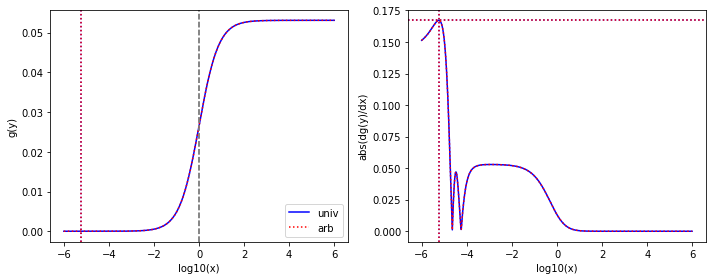

[8.56180e+00 6.53993e+00 1.79804e-03 1.59713e-03 2.70939e-01 1.00000e-03
 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00021000724146791563 0.00021000724146791563
0.0316450979934126 0.0316450979934126
0.00011679786960685838 0.00011679786960685839
0.00011679786960685838 0.00011679786960685834
# maximal error is 4.0657581468206416e-20
min-max are 3.529814346881038e-10 52289770096256.92
From univ parameters, position and steepness are: 1.4951942879778217 0.16010328386432154 1.9453875970011074
From arb parameters, position and steepness are: 1.4951942879778213 0.1601032838643216 1.9453875970011079


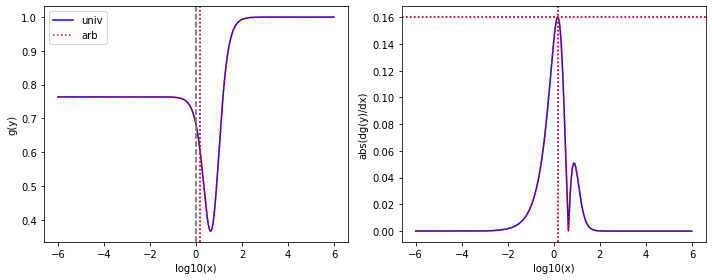

[1.00000e+03 1.00000e-03 3.89253e+00 1.00000e-03 1.00000e-03 1.00000e-03
 4.43150e+02 1.00000e-03 9.73300e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00389253 0.00389253
1e-06 1e-06
0.44315 0.44315
9.733e-06 9.733000000000002e-06
# maximal error is 1.6940658945086007e-21
min-max are 7.027031419536454e-09 2740684072.9887233
From univ parameters, position and steepness are: 2.3786576237672744e-05 0.17078616880223202 45529.55510620459
From arb parameters, position and steepness are: 2.3786576237672744e-05 0.17078616880223202 45529.55510620459


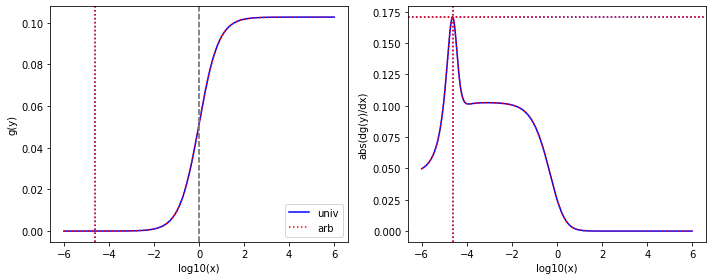

[1.03381e+02 2.62312e+01 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e+03 6.59265e+02 4.58116e+01 3.61811e-02]
found K1
found pairwise
found triplewise
9.672957313239377e-06 9.672957313239377e-06
9.672957313239377e-06 9.672957313239377e-06
9.672957313239376 9.672957313239378
0.443133651251197 0.443133651251197
# maximal error is 1.7763568394002505e-15
min-max are 2.498058915578641e-10 4024460669861276.5
From univ parameters, position and steepness are: 1.4947612182710261 0.17272620336885783 0.2451880153849312
From arb parameters, position and steepness are: 1.4947612182710261 0.17272620336885783 0.24518801538493123


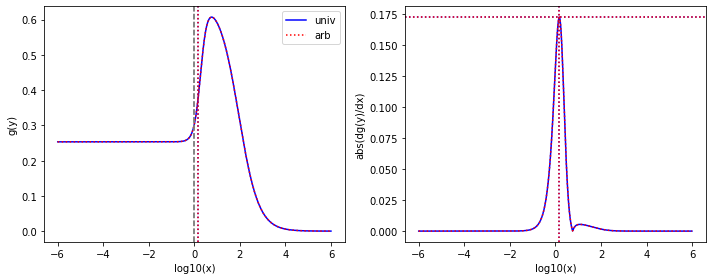

[1.00000e+03 1.00000e-03 1.56022e-02 1.00000e-03 6.99488e-01 1.00000e-03
 4.41163e+02 1.00000e-03 9.12803e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.56022e-05 1.56022e-05
0.000699488 0.000699488
0.441163 0.44116299999999997
9.12803e-06 9.128030000000002e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 5680405895006905.0
From univ parameters, position and steepness are: 2.2413591292150504e-05 0.1823804884345268 48329.46559563473
From arb parameters, position and steepness are: 2.2413591292150504e-05 0.18238048843452678 48329.46559563473


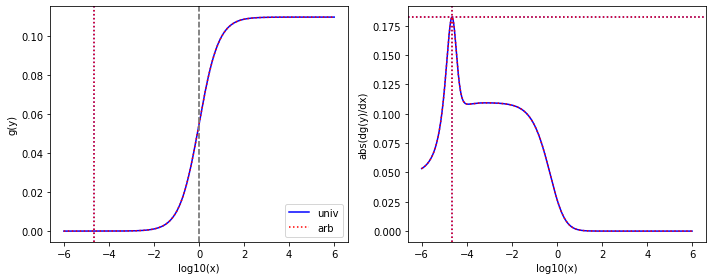

[8.56180e+00 5.44733e+00 1.08102e+00 1.08102e+00 2.71858e-01 1.22817e-03
 7.69959e-02 2.36639e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.12626083300240604 0.12626083300240604
0.0317524352355813 0.0317524352355813
0.008992957088462707 0.008992957088462709
0.00011679786960685838 0.00011679786960685839
# maximal error is 1.734723475976807e-18
min-max are 3.529814346881038e-10 52467132115345.27
From univ parameters, position and steepness are: 1.4950650987791991 0.18902030750707383 2.2174586575908624
From arb parameters, position and steepness are: 1.4950650987791994 0.1890203075070738 2.217458657590862


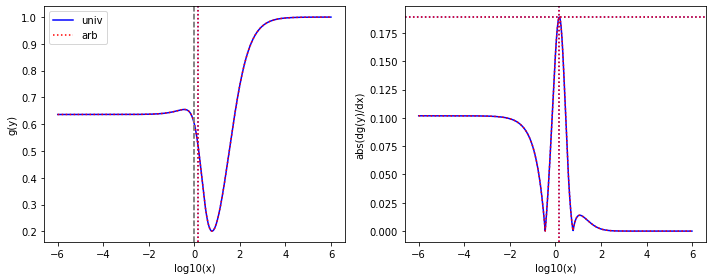

[3.89329e+02 1.00000e-03 1.21141e-03 1.21141e-03 1.35537e-01 1.00000e-03
 2.98461e+02 1.00000e-03 8.68044e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.111532919458864e-06 3.111532919458864e-06
0.0003481297308959774 0.0003481297308959774
0.7666035666492863 0.7666035666492864
2.229589884133984e-05 2.2295898841339838e-05
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 2827294346688027.0
From univ parameters, position and steepness are: 1.888205285966011e-05 0.1997985985061583 34382.6985013919
From arb parameters, position and steepness are: 1.8882052859660107e-05 0.19979859850615833 34382.698501391904


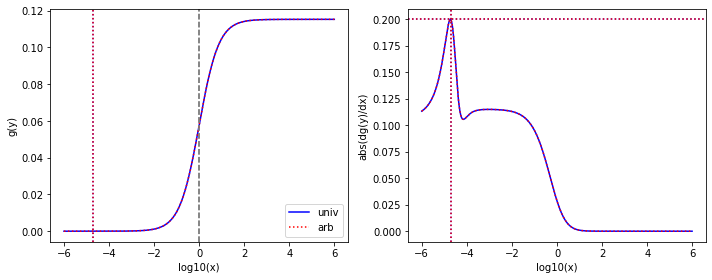

[2.88194e+02 1.13383e+02 2.72687e-01 1.00000e-03 1.96559e+02 5.58660e-03
 7.00059e+02 7.00059e+02 1.12116e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.0009461924953330049 0.0009461924953330049
0.6820371000090216 0.6820371000090216
2.429124131661311 2.429124131661311
0.03890296119974739 0.038902961199747385
# maximal error is 6.938893903907228e-18
min-max are 3.529814346881038e-10 1126985393618293.2
From univ parameters, position and steepness are: 1.491121894863299 0.19509346526261967 0.41821765141467615
From arb parameters, position and steepness are: 1.491121894863299 0.19509346526261967 0.4182176514146762


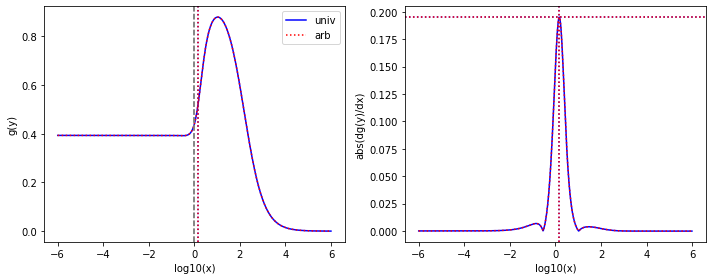

[6.99830e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e+03 1.42699e-02 5.51640e+00 8.32316e-01]
found K1
found pairwise
found triplewise
1.4289184516239657e-06 1.4289184516239657e-06
1.4289184516239657e-06 1.4289184516239657e-06
1.4289184516239657 1.4289184516239655
0.007882485746538444 0.007882485746538444
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 4024450014216657.0
From univ parameters, position and steepness are: 0.006078433145818159 0.20082321209229365 181.2467975056666
From arb parameters, position and steepness are: 0.00607843314581816 0.20082321209229367 181.2467975056666


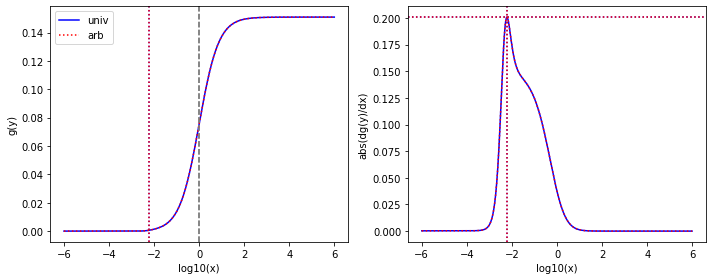

[2.88194e+02 1.13383e+02 1.00000e-03 1.00000e-03 1.57109e+02 3.08947e+00
 7.00059e+02 7.00059e+02 1.12116e+01 2.07019e-03]
found K1
found pairwise
found triplewise
3.4698848692200393e-06 3.4698848692200393e-06
0.5451501419182911 0.5451501419182911
2.429124131661311 2.429124131661311
0.03890296119974739 0.0389029611997474
# maximal error is 6.938893903907228e-18
min-max are 2.498058915578641e-10 4.4275820373182433e+18
From univ parameters, position and steepness are: 1.4983797523176037 0.2049193391141056 0.4074587654598849
From arb parameters, position and steepness are: 1.4983797523176037 0.2049193391141056 0.40745876545988496


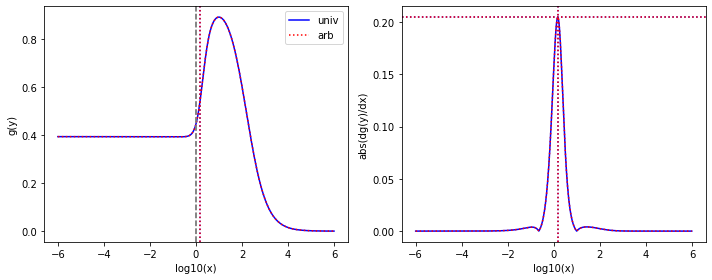

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 8.93778e-01 1.00000e-03
 4.41163e+02 1.00000e-03 7.74032e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
0.0008937779999999999 0.0008937779999999999
0.441163 0.4411630000000001
7.74032e-06 7.74032e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 7259013203256920.0
From univ parameters, position and steepness are: 1.9006149142377133e-05 0.2150238565203904 56994.33152493965
From arb parameters, position and steepness are: 1.9006149142377126e-05 0.2150238565203904 56994.331524939655


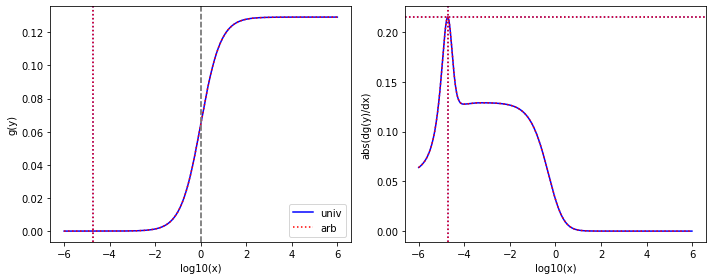

[2.88194e+02 1.13383e+02 8.23794e-03 1.00000e-03 1.17783e+02 1.60469e-01
 7.00059e+02 7.00059e+02 1.12116e+01 2.13946e-03]
found K1
found pairwise
found triplewise
2.8584703359542527e-05 2.8584703359542527e-05
0.40869344955134385 0.40869344955134385
2.429124131661311 2.429124131661311
0.03890296119974739 0.03890296119974739
# maximal error is 0.0
min-max are 2.498058915578641e-10 3.319311555534995e+18
From univ parameters, position and steepness are: 1.4953992422036977 0.21686386255057646 0.4038345946754243
From arb parameters, position and steepness are: 1.4953992422036977 0.21686386255057646 0.4038345946754243


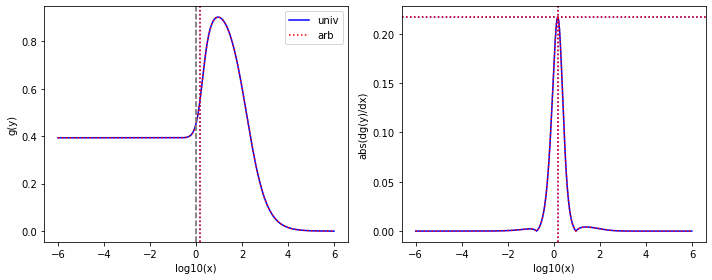

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 1.18902e-02 1.00000e-03
 3.29832e+02 1.00000e-03 9.21115e-03 1.34754e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1.18902e-05 1.18902e-05
0.329832 0.329832
9.211149999999999e-06 9.211149999999999e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 111095032862334.0
From univ parameters, position and steepness are: 3.881770024560829e-05 0.2249518895235604 35806.91205558583
From arb parameters, position and steepness are: 3.8817700245608275e-05 0.2249518895235604 35806.912055585846


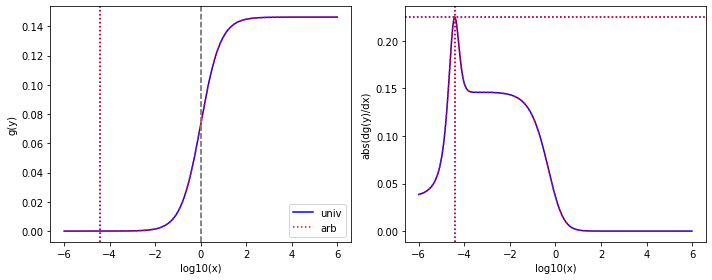

[2.88194e+02 1.13383e+02 3.47805e-03 1.00000e-03 1.03067e+02 1.00000e-03
 7.00059e+02 7.00059e+02 1.12116e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1.2068433069390757e-05 1.2068433069390757e-05
0.3576306238159017 0.3576306238159017
2.429124131661311 2.4291241316613106
0.03890296119974739 0.03890296119974739
# maximal error is 4.440892098500626e-16
min-max are 2.498058915578641e-10 2.9045919173519304e+18
From univ parameters, position and steepness are: 1.4946375985186346 0.2218274321186621 0.4020905506356205
From arb parameters, position and steepness are: 1.4946375985186344 0.2218274321186621 0.4020905506356205


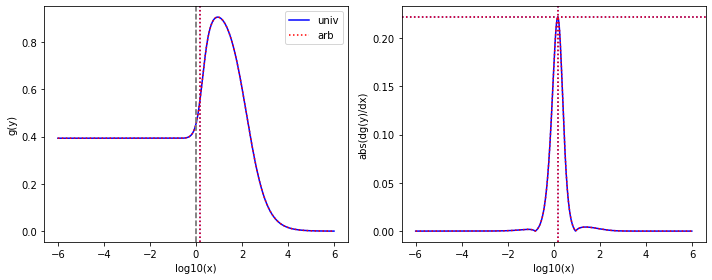

[7.60775e+02 1.00000e-03 1.20970e-03 1.20970e-03 1.00000e-03 1.00000e-03
 4.65198e+02 1.00000e-03 7.30223e-01 1.29218e-01]
found K1
found pairwise
found triplewise
1.5900890539252736e-06 1.5900890539252736e-06
1.3144490815287043e-06 1.3144490815287043e-06
0.6114790838289902 0.6114790838289901
0.000959840951661135 0.000959840951661135
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 1874262196649528.0
From univ parameters, position and steepness are: 0.0023164501957773495 0.23511344314841323 637.0568929923019
From arb parameters, position and steepness are: 0.002316450195777349 0.23511344314841323 637.056892992302


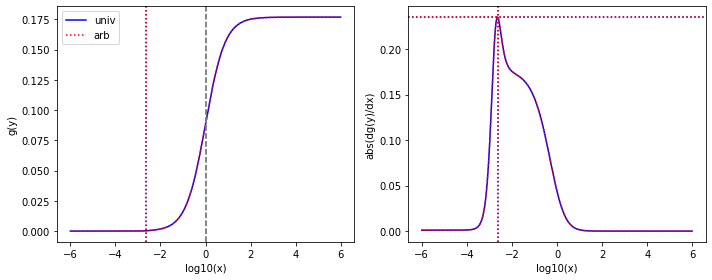

[2.88194e+02 1.13383e+02 5.94037e+00 1.14092e-03 9.17651e+01 3.68056e+01
 7.00059e+02 7.00059e+02 1.12116e+01 3.89414e-03]
found K1
found pairwise
found triplewise
0.020612399980568644 0.02061239998056864
0.31841433201246383 0.31841433201246383
2.429124131661311 2.429124131661311
0.03890296119974739 0.038902961199747385
# maximal error is 6.938893903907228e-18
min-max are 3.529814346881038e-10 526141908194270.25
From univ parameters, position and steepness are: 1.4933419435715858 0.23326163473170383 0.38690749652763845
From arb parameters, position and steepness are: 1.4933419435715858 0.23326163473170386 0.3869074965276385


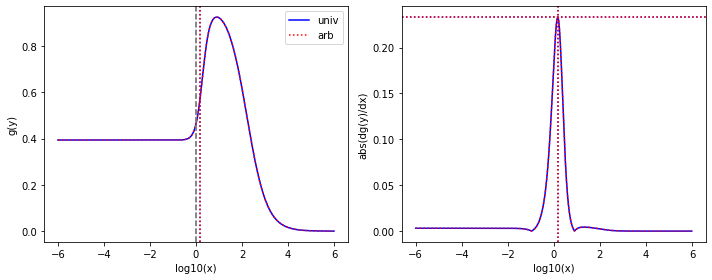

[4.13403e+01 6.70745e+00 4.75080e-03 4.43025e-03 1.00000e-03 1.00000e-03
 8.08469e+02 1.34190e+02 1.85000e+01 3.54419e-01]
found K1
found pairwise
found triplewise
0.00011491934020798108 0.00011491934020798108
2.4189471290726e-05 2.4189471290726004e-05
19.55643766494196 19.556437664941956
0.447505218878431 0.447505218878431
# maximal error is 3.552713678800501e-15
min-max are 7.027031419536454e-09 39970136866.62657
From univ parameters, position and steepness are: 0.00555094118363488 0.24798111647043464 45.05673228575366
From arb parameters, position and steepness are: 0.005550941183634882 0.24798111647043544 45.05673228575367


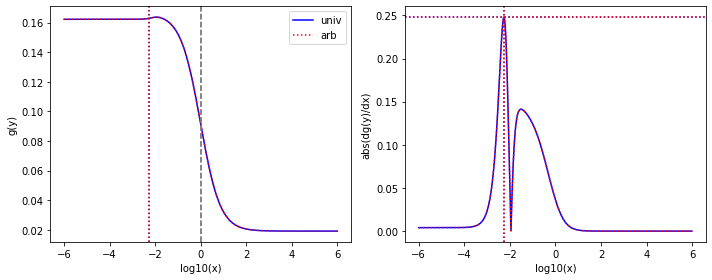

[2.88194e+02 1.13383e+02 3.28072e-03 1.00000e-03 4.10553e+01 1.31291e-01
 6.51594e+02 6.51594e+02 1.12116e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1.1383720688147566e-05 1.1383720688147566e-05
0.1424571642712895 0.1424571642712895
2.2609561614745624 2.2609561614745624
0.03890296119974739 0.0389029611997474
# maximal error is 6.938893903907228e-18
min-max are 2.498058915578641e-10 1.1570033408964232e+18
From univ parameters, position and steepness are: 1.4976483981926563 0.2432903009440887 0.403450855668846
From arb parameters, position and steepness are: 1.4976483981926563 0.24329030094408874 0.40345085566884603


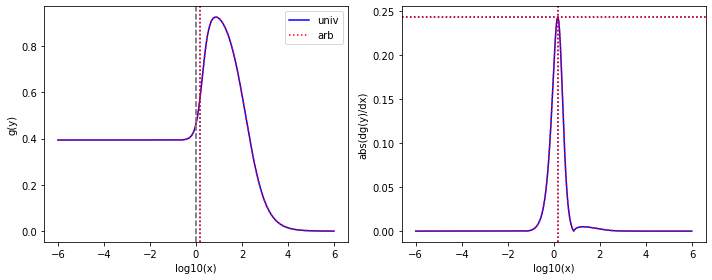

[6.33965e+02 1.00000e-03 3.93444e-01 1.88538e-03 1.00000e-03 1.00000e-03
 2.77368e+02 1.00000e-03 6.74612e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0006206083932078269 0.0006206083932078269
1.577374145260385e-06 1.577374145260385e-06
0.43751311192258246 0.43751311192258246
1.064115526882399e-05 1.064115526882399e-05
# maximal error is 0.0
min-max are 7.027031419536454e-09 2606328780.46066
From univ parameters, position and steepness are: 2.228423899081655e-05 0.25010227213921343 41114.06414465363
From arb parameters, position and steepness are: 2.2284238990816543e-05 0.2501022721392135 41114.06414465365


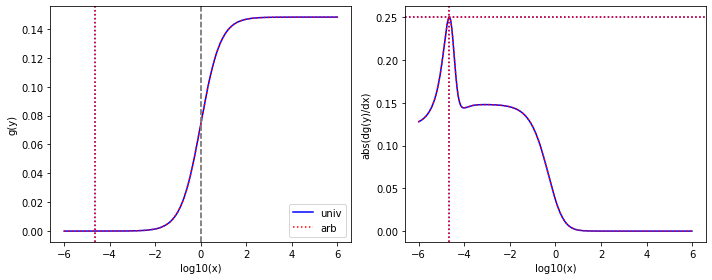

[1.00000e+03 3.79514e+02 1.00000e-03 1.00000e-03 1.71425e-02 1.00000e-03
 8.16945e+02 8.04843e+02 1.58835e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1.71425e-05 1.71425e-05
0.816945 0.816945
0.0158835 0.015883499999999995
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 190831612635892.72
From univ parameters, position and steepness are: 1.4957439530858059 0.2581566614826319 0.5587536019650888
From arb parameters, position and steepness are: 1.4957439530858059 0.2581566614826319 0.5587536019650888


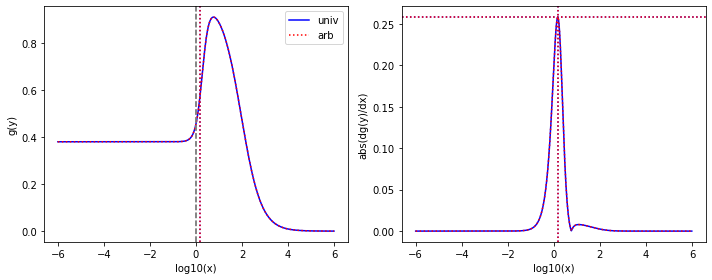

[6.93522e+02 1.52484e-03 7.79824e-03 1.00000e-03 6.64276e-01 1.89401e-03
 2.88184e+02 1.00000e-03 6.75445e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.1244401763750824e-05 1.1244401763750824e-05
0.0009578297444060894 0.0009578297444060894
0.41553692600955705 0.415536926009557
9.739344966706176e-06 9.739344966706176e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 7778785033335861.0
From univ parameters, position and steepness are: 2.285920772901011e-05 0.2664104875163253 42665.06756360657
From arb parameters, position and steepness are: 2.2859207729010113e-05 0.2664104875163253 42665.067563606564


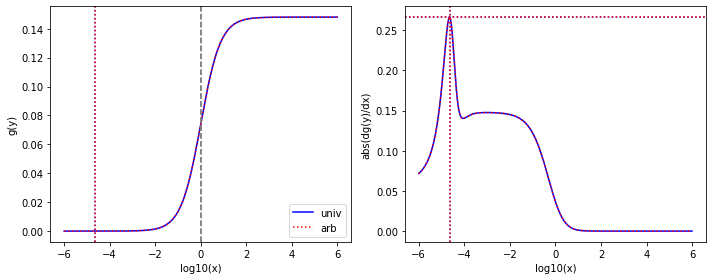

[2.88194e+02 1.13383e+02 6.04864e-01 1.00000e-03 1.57384e+01 3.41275e-01
 7.00059e+02 7.00059e+02 1.12116e+01 2.13946e-03]
found K1
found pairwise
found triplewise
0.0020988084415359096 0.0020988084415359096
0.054610436025732664 0.054610436025732664
2.429124131661311 2.429124131661311
0.03890296119974739 0.038902961199747385
# maximal error is 6.938893903907228e-18
min-max are 3.529814346881038e-10 90237266681656.31
From univ parameters, position and steepness are: 1.4727759484885774 0.26008857375856115 0.3985803567775583
From arb parameters, position and steepness are: 1.4727759484885774 0.26008857375856115 0.3985803567775583


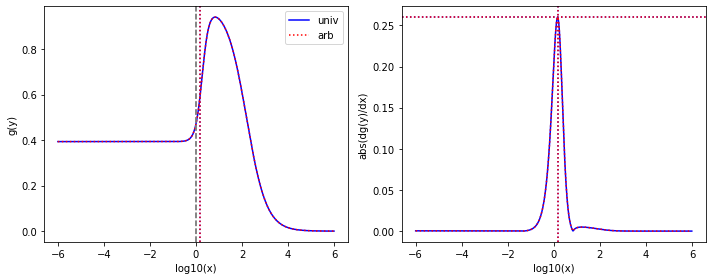

[3.19779e+02 1.18651e+02 1.79152e-03 1.00000e-03 5.67775e-03 1.00000e-03
 1.73213e+02 1.73213e+02 4.46918e+00 3.94334e-03]
found K1
found pairwise
found triplewise
5.6023691361846775e-06 5.6023691361846775e-06
1.7755230956379247e-05 1.7755230956379247e-05
0.5416647121918575 0.5416647121918576
0.013975839564199025 0.013975839564199025
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 143962441227217.44
From univ parameters, position and steepness are: 1.4829125659171571 0.2648241430502349 0.6415173063844294
From arb parameters, position and steepness are: 1.4829125659171571 0.26482414305023483 0.6415173063844293


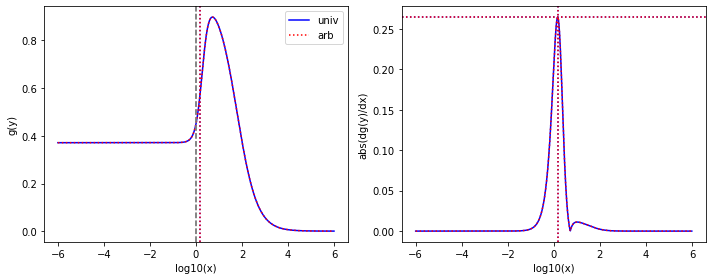

[2.84990e+02 1.13383e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 7.00059e+02 7.00059e+02 1.12116e+01 1.00456e-03]
found K1
found pairwise
found triplewise
3.508895048949086e-06 3.508895048949086e-06
3.508895048949086e-06 3.508895048949086e-06
2.456433559072248 2.4564335590722477
0.03934032773079757 0.03934032773079756
# maximal error is 4.440892098500626e-16
min-max are 2.498058915578641e-10 2817357641070569.5
From univ parameters, position and steepness are: 1.4953322678473275 0.2614845152588552 0.38975970272063376
From arb parameters, position and steepness are: 1.4953322678473273 0.26148451525885524 0.3897597027206338


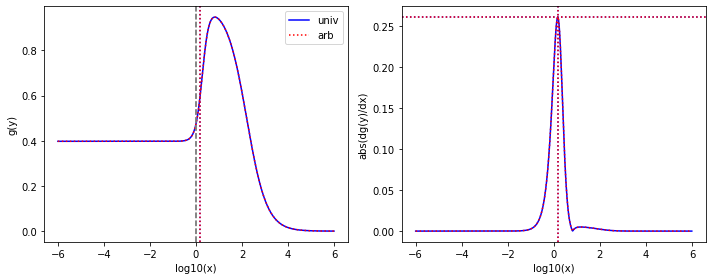

[8.36018e+02 4.56165e-03 4.88548e-03 4.88548e-03 1.00000e-03 1.00000e-03
 4.65198e+02 1.00000e-03 1.00909e-02 1.00000e-03]
found K1
found pairwise
found triplewise
5.843749775722532e-06 5.843749775722532e-06
1.1961464944534688e-06 1.1961464944534688e-06
0.5564449569267647 0.5564449569267647
1.2070194660880507e-05 1.2070194660880507e-05
# maximal error is 0.0
min-max are 2.498058915578641e-10 1911790283614822.0
From univ parameters, position and steepness are: 3.4311221983303013e-06 0.27893321510328356 46103.82097735142
From arb parameters, position and steepness are: 3.431122198330303e-06 0.2789332151032835 46103.82097735141


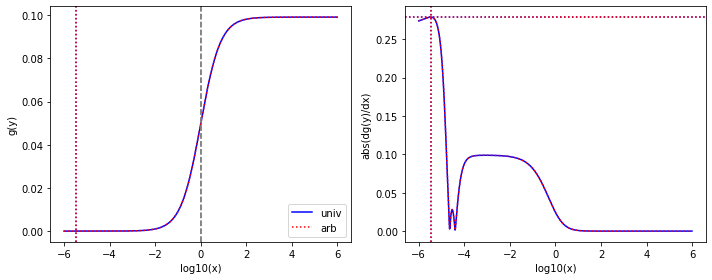

[4.95667e+02 1.73520e+02 1.00000e-03 1.00000e-03 1.65928e-02 1.65928e-02
 4.30523e+02 4.30523e+02 1.80711e+01 1.00000e-03]
found K1
found pairwise
found triplewise
2.0174835121159974e-06 2.0174835121159974e-06
3.3475700419838327e-05 3.3475700419838327e-05
0.8685730540867156 0.8685730540867156
0.0364581462957994 0.036458146295799396
# maximal error is 6.938893903907228e-18
min-max are 2.498058915578641e-10 271794915788489.75
From univ parameters, position and steepness are: 1.43529309805092 0.27679798009162443 0.5618840702711884
From arb parameters, position and steepness are: 1.43529309805092 0.2767979800916245 0.5618840702711884


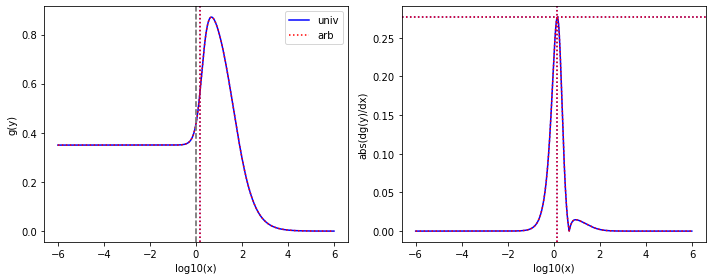

[1.00000e+03 3.79514e+02 3.46506e-01 1.00000e-03 3.98966e-02 1.00000e-03
 8.16945e+02 8.16945e+02 1.58835e+01 5.98485e-02]
found K1
found pairwise
found triplewise
0.000346506 0.000346506
3.98966e-05 3.98966e-05
0.816945 0.816945
0.0158835 0.0158835
# maximal error is 0.0
min-max are 7.027031419536454e-09 65924303557.4596
From univ parameters, position and steepness are: 1.4473199389077587 0.2734840770854227 0.5776278904459087
From arb parameters, position and steepness are: 1.4473199389077587 0.2734840770854227 0.5776278904459087


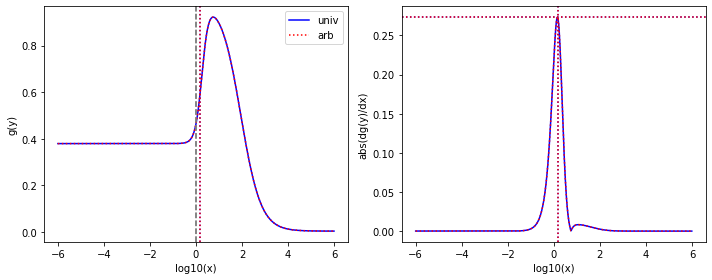

[1.00000e+03 3.79514e+02 5.10113e+00 1.00000e-03 1.00000e-03 1.00000e-03
 8.16945e+02 8.16945e+02 1.58835e+01 3.01309e-03]
found K1
found pairwise
found triplewise
0.005101130000000001 0.005101130000000001
1e-06 1e-06
0.816945 0.816945
0.0158835 0.015883499999999995
# maximal error is 3.469446951953614e-18
min-max are 7.027031419536454e-09 5701858189.906753
From univ parameters, position and steepness are: 1.4569174147411388 0.27141951623526184 0.5748862844977087
From arb parameters, position and steepness are: 1.4569174147411388 0.27141951623526184 0.5748862844977087


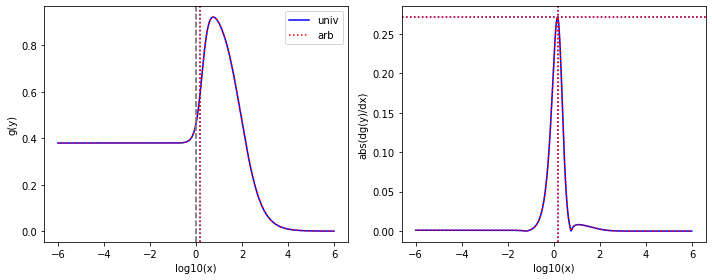

[1.00000e+03 3.79514e+02 3.46506e-01 1.00000e-03 2.91610e-01 1.00000e-03
 8.16945e+02 8.16945e+02 1.58835e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.000346506 0.000346506
0.00029161 0.00029161
0.816945 0.8169450000000001
0.0158835 0.015883500000000002
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 481850834824.08734
From univ parameters, position and steepness are: 1.4606340467088743 0.27086536723714716 0.5723492542121311
From arb parameters, position and steepness are: 1.4606340467088743 0.27086536723714716 0.572349254212131


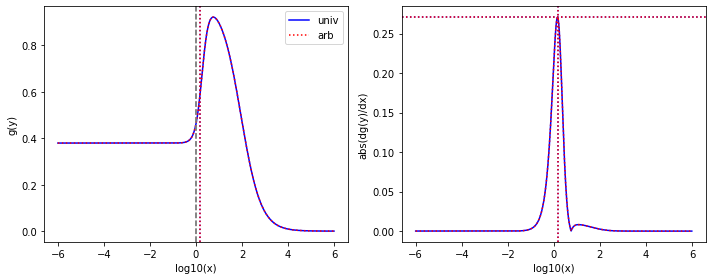

[1.49294e+02 1.00000e-03 1.00000e-03 1.00000e-03 2.39063e+00 1.43484e-03
 4.43150e+02 1.00000e-03 1.32536e-02 1.00000e-03]
found K1
found pairwise
found triplewise
6.69819282757512e-06 6.69819282757512e-06
0.01601290071938591 0.01601290071938591
2.9683041515399142 2.9683041515399142
8.877516845954962e-05 8.877516845954962e-05
# maximal error is 0.0
min-max are 2.498058915578641e-10 1.300527527908459e+17
From univ parameters, position and steepness are: 4.958508799983668e-06 0.28228924063786237 33440.140733765526
From arb parameters, position and steepness are: 4.958508799983668e-06 0.28228924063786237 33440.14073376553


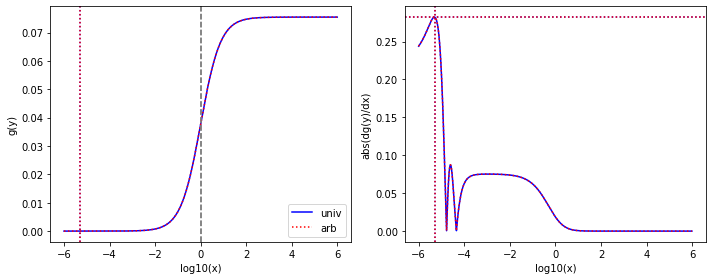

[1.00000e+03 3.40127e+02 6.62370e-01 1.00000e-03 2.48393e-03 1.00000e-03
 1.06478e+02 1.06478e+02 2.47700e+00 1.00000e-03]
found K1
found pairwise
found triplewise
0.00066237 0.00066237
2.48393e-06 2.48393e-06
0.10647799999999999 0.10647799999999999
0.002477 0.0024770000000000005
# maximal error is 4.336808689942018e-19
min-max are 7.027031419536454e-09 4104304767.289386
From univ parameters, position and steepness are: 1.4054935031026101 0.2846741400716777 1.1522282664638974
From arb parameters, position and steepness are: 1.4054935031026101 0.2846741400716777 1.1522282664638974


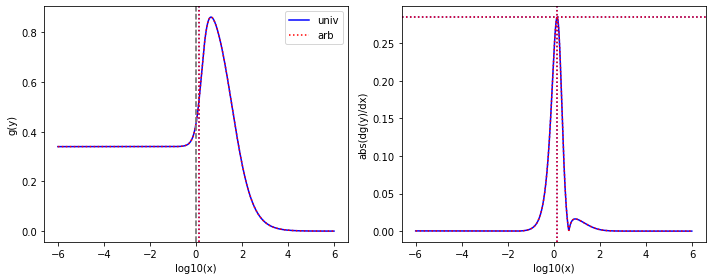

[4.95667e+02 1.73520e+02 1.00000e-03 1.00000e-03 8.47223e-03 1.00000e-03
 7.00059e+02 7.00059e+02 3.15338e+01 1.00000e-03]
found K1
found pairwise
found triplewise
2.0174835121159974e-06 2.0174835121159974e-06
1.709258433585452e-05 1.709258433585452e-05
1.4123574900084128 1.412357490008413
0.06361892157436344 0.06361892157436344
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 330983389745830.2
From univ parameters, position and steepness are: 1.4163910725897562 0.28255792533914476 0.4854608712045213
From arb parameters, position and steepness are: 1.4163910725897562 0.28255792533914476 0.4854608712045213


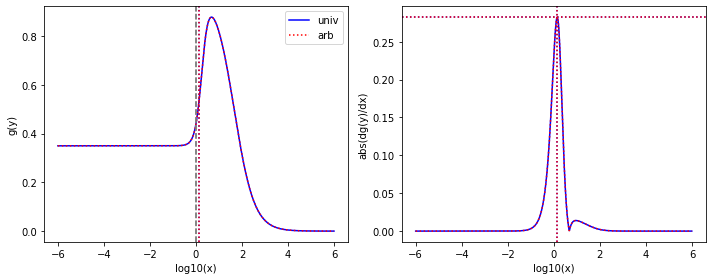

[6.98658e+01 2.62312e+01 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e+03 1.00000e+03 4.58116e+01 1.14857e-03]
found K1
found pairwise
found triplewise
1.431315464791071e-05 1.431315464791071e-05
1.431315464791071e-05 1.431315464791071e-05
14.31315464791071 14.31315464791071
0.6557085154682263 0.6557085154682263
# maximal error is 0.0
min-max are 2.498058915578641e-10 4024461267748832.0
From univ parameters, position and steepness are: 1.4243100956801542 0.2809125964416697 0.22628724095521174
From arb parameters, position and steepness are: 1.4243100956801542 0.28091259644166977 0.22628724095521174


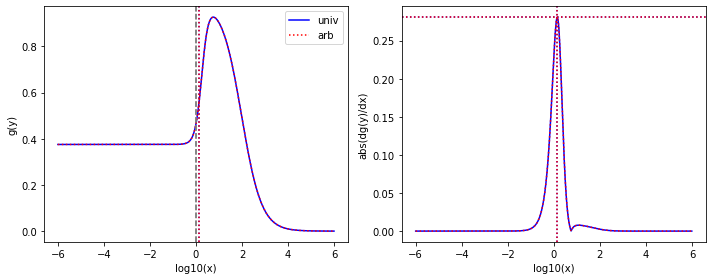

[1.08958e+01 9.08629e+00 1.72146e+00 2.12574e-02 2.71858e-01 2.36734e-03
 7.80426e-03 1.00000e-03 1.17653e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.15799298812386425 0.15799298812386425
0.024950714954386093 0.024950714954386093
0.0007162631472677546 0.0007162631472677547
0.00010798013913618092 0.00010798013913618092
# maximal error is 1.0842021724855044e-19
min-max are 3.529814346881038e-10 41228096268586.34
From univ parameters, position and steepness are: 0.004343567684750878 0.29723178253334687 2.289845640754621
From arb parameters, position and steepness are: 0.004343567684750682 0.2972317825333468 2.2898456407546206


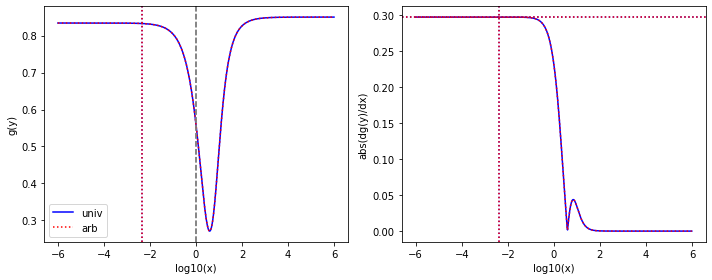

[4.09681e+02 1.42226e+02 1.00000e-03 1.00000e-03 1.45975e-01 1.00000e-03
 1.73213e+02 1.73213e+02 4.46918e+00 3.94334e-03]
found K1
found pairwise
found triplewise
2.4409235478335585e-06 2.4409235478335585e-06
0.00035631381489500366 0.00035631381489500366
0.42279969049089416 0.4227996904908942
0.010908926701506783 0.010908926701506783
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 2893792466423365.5
From univ parameters, position and steepness are: 1.3722375287516404 0.29618901899911243 0.7521039862611943
From arb parameters, position and steepness are: 1.3722375287516404 0.2961890189991124 0.7521039862611942


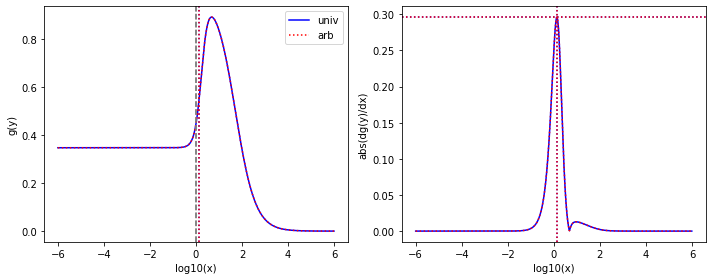

[4.95667e+02 1.73520e+02 1.00000e-03 1.00000e-03 3.28204e-03 3.28204e-03
 7.00059e+02 7.00059e+02 2.73549e+01 9.46776e-03]
found K1
found pairwise
found triplewise
2.0174835121159974e-06 2.0174835121159974e-06
6.621461586105188e-06 6.621461586105188e-06
1.4123574900084128 1.4123574900084126
0.0551880597255819 0.05518805972558189
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 855244928453492.2
From univ parameters, position and steepness are: 1.3893131682452737 0.29103631253724144 0.49671647401569785
From arb parameters, position and steepness are: 1.3893131682452737 0.29103631253724144 0.4967164740156979


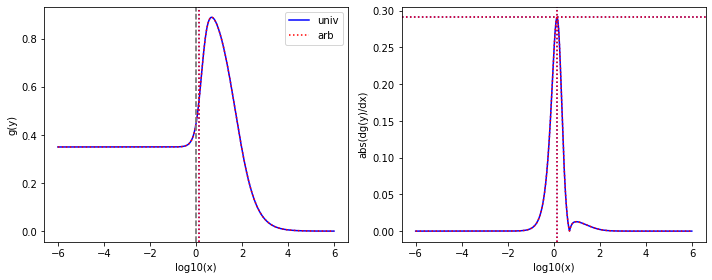

[4.95667e+02 1.73520e+02 1.37007e-03 1.18747e-03 4.17386e-03 1.57412e-03
 7.00059e+02 7.00059e+02 2.73549e+01 1.00000e-03]
found K1
found pairwise
found triplewise
2.7640936354447645e-06 2.7640936354447645e-06
8.420693731880476e-06 8.420693731880476e-06
1.4123574900084128 1.4123574900084126
0.0551880597255819 0.055188059725581905
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 672590840189324.1
From univ parameters, position and steepness are: 1.390270159858472 0.2908274949621676 0.49637207808550016
From arb parameters, position and steepness are: 1.390270159858472 0.29082749496216753 0.49637207808550016


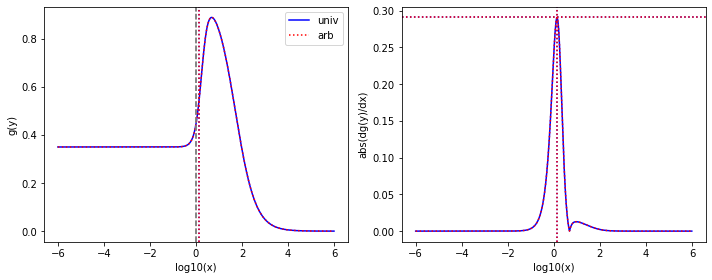

[8.56180e+00 5.44733e+00 1.42062e+00 1.45951e-03 2.71858e-01 2.09373e-02
 1.21754e-03 1.02263e-03 1.13106e-02 1.00000e-03]
found K1
found pairwise
found triplewise
0.16592538952089514 0.16592538952089514
0.0317524352355813 0.0317524352355813
0.00014220607816113436 0.00014220607816113436
0.0013210539839753324 0.001321053983975332
# maximal error is 4.336808689942018e-19
min-max are 3.529814346881038e-10 52467132102899.91
From univ parameters, position and steepness are: 0.009206797572956157 0.3056271326713854 2.8995657728734368
From arb parameters, position and steepness are: 0.009206797572956144 0.3056271326713854 2.8995657728734368


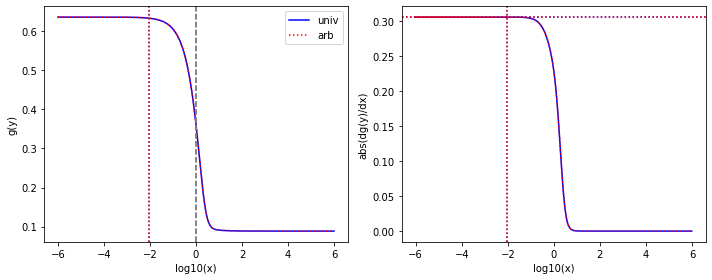

[4.95667e+02 1.73520e+02 1.12583e+00 1.39212e-03 1.00000e-03 1.00000e-03
 7.00059e+02 7.00059e+02 2.06279e+01 3.25565e-03]
found K1
found pairwise
found triplewise
0.0022713434624455535 0.0022713434624455535
2.0174835121159974e-06 2.0174835121159974e-06
1.4123574900084128 1.4123574900084128
0.04161644813957758 0.04161644813957758
# maximal error is 0.0
min-max are 7.027031419536454e-09 5579592482.1672325
From univ parameters, position and steepness are: 1.3471448268281436 0.3050585920922292 0.5156580475100289
From arb parameters, position and steepness are: 1.3471448268281436 0.3050585920922292 0.5156580475100289


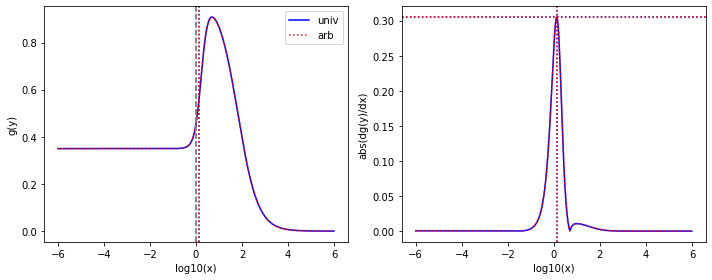

[4.95667e+02 1.73520e+02 1.00000e-03 1.00000e-03 8.47223e-03 1.00000e-03
 7.00059e+02 6.91166e+02 1.80711e+01 1.00000e-03]
found K1
found pairwise
found triplewise
2.0174835121159974e-06 2.0174835121159974e-06
1.709258433585452e-05 1.709258433585452e-05
1.4123574900084128 1.412357490008413
0.0364581462957994 0.03645814629579941
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 330983389745830.2
From univ parameters, position and steepness are: 1.350647448409757 0.3002261556174576 0.515083902407505
From arb parameters, position and steepness are: 1.350647448409757 0.30022615561745764 0.5150839024075051


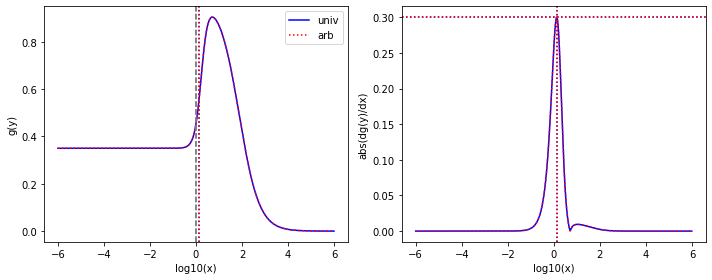

[9.40898e+02 3.40127e+02 3.21638e-02 1.19078e-02 1.00000e-03 1.00000e-03
 1.00000e+03 1.00000e+03 1.99117e+01 2.03374e-03]
found K1
found pairwise
found triplewise
3.4184151735894855e-05 3.4184151735894855e-05
1.0628144602284202e-06 1.0628144602284202e-06
1.06281446022842 1.06281446022842
0.02116244268773023 0.02116244268773023
# maximal error is 0.0
min-max are 2.498058915578641e-10 4826869070217054.0
From univ parameters, position and steepness are: 1.3609312407799736 0.3004868052868947 0.5633379734788045
From arb parameters, position and steepness are: 1.3609312407799736 0.3004868052868947 0.5633379734788045


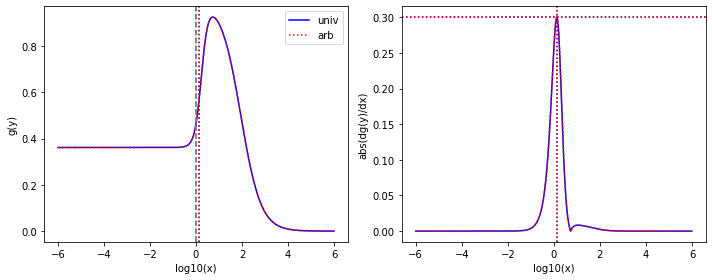

[1.00000e-03 1.00000e-03 1.58880e+00 1.58880e+00 2.71858e-01 1.56826e-02
 2.98678e-03 2.36639e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1588.8 1588.8
271.858 271.858
2.98678 2.9867800000000004
1.0 1.0
# maximal error is 4.440892098500626e-16
min-max are 7.027031419536454e-09 4.4921309239626234e+17
From univ parameters, position and steepness are: 0.006488101180625508 0.3133831992440194 1.9559047198094273
From arb parameters, position and steepness are: 0.006488101180625508 0.3133831992440194 1.9559047198094273


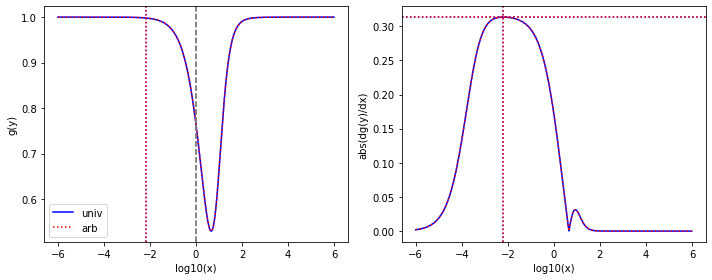

[1.00000e+03 3.79514e+02 2.38313e-03 1.00000e-03 8.69207e-02 1.85359e-02
 8.16945e+02 8.16945e+02 2.39703e+00 1.09221e-03]
found K1
found pairwise
found triplewise
2.3831299999999997e-06 2.3831299999999997e-06
8.692070000000001e-05 8.692070000000001e-05
0.816945 0.8169450000000001
0.00239703 0.0023970300000000005
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 705846967963886.2
From univ parameters, position and steepness are: 1.3168429727211648 0.31198528954906046 0.6431960864694799
From arb parameters, position and steepness are: 1.3168429727211648 0.3119852895490604 0.6431960864694799


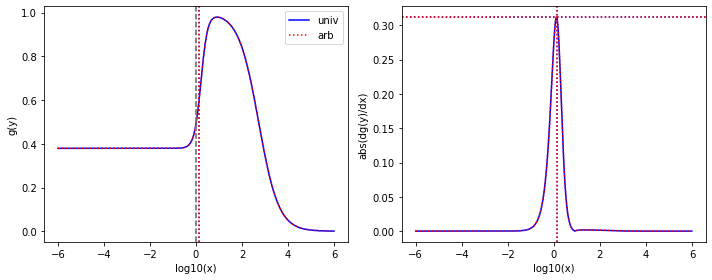

[4.95667e+02 1.73520e+02 1.00000e-03 1.00000e-03 1.13223e-02 1.00000e-03
 7.00059e+02 7.00059e+02 1.80711e+01 4.07298e-02]
found K1
found pairwise
found triplewise
2.0174835121159974e-06 2.0174835121159974e-06
2.2842553569230957e-05 2.2842553569230957e-05
1.4123574900084128 1.412357490008413
0.0364581462957994 0.0364581462957994
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 247628599577880.38
From univ parameters, position and steepness are: 1.3263413586862334 0.3119811073229347 0.524589794127609
From arb parameters, position and steepness are: 1.3263413586862334 0.3119811073229347 0.524589794127609


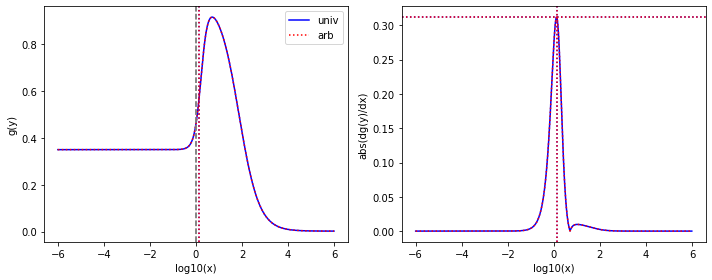

[4.95667e+02 1.73520e+02 1.00000e-03 1.00000e-03 8.47223e-03 8.47223e-03
 7.00059e+02 7.00059e+02 1.80711e+01 1.00000e-03]
found K1
found pairwise
found triplewise
2.0174835121159974e-06 2.0174835121159974e-06
1.709258433585452e-05 1.709258433585452e-05
1.4123574900084128 1.412357490008413
0.0364581462957994 0.03645814629579941
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 330983389745830.2
From univ parameters, position and steepness are: 1.3320437408257568 0.3106106987469434 0.522325033587152
From arb parameters, position and steepness are: 1.3320437408257568 0.3106106987469434 0.522325033587152


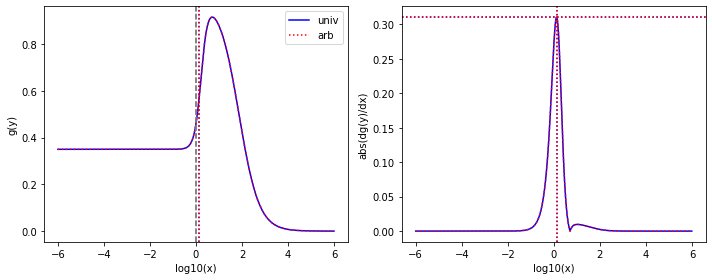

[1.08958e+01 1.08958e+01 1.72146e+00 7.63347e-02 2.71858e-01 1.17819e-02
 7.80426e-03 7.80426e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.15799298812386425 0.15799298812386425
0.024950714954386093 0.024950714954386093
0.0007162631472677546 0.0007162631472677547
9.177848345233944e-05 9.177848345233943e-05
# maximal error is 1.0842021724855044e-19
min-max are 3.529814346881038e-10 41228096268586.34
From univ parameters, position and steepness are: 0.000595832558376641 0.32471632996597005 2.1506226626727245
From arb parameters, position and steepness are: 0.0005958325583764684 0.32471632996597005 2.1506226626727245


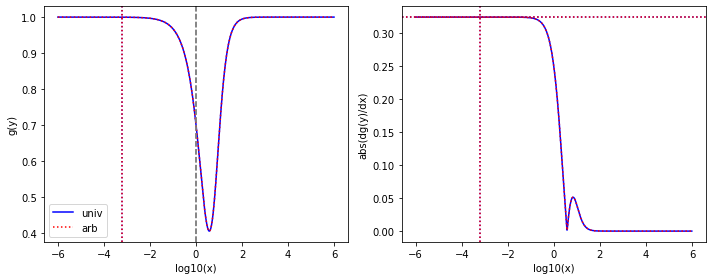

[1.00000e+03 3.40127e+02 6.62370e-01 1.00000e-03 2.48393e-03 1.00000e-03
 9.17226e+02 9.17226e+02 1.99117e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.00066237 0.00066237
2.48393e-06 2.48393e-06
0.917226 0.9172260000000001
0.0199117 0.0199117
# maximal error is 1.1102230246251565e-16
min-max are 7.027031419536454e-09 4104304767.289386
From univ parameters, position and steepness are: 1.2910627998597464 0.32602319918525025 0.622864356105471
From arb parameters, position and steepness are: 1.2910627998597464 0.32602319918525025 0.622864356105471


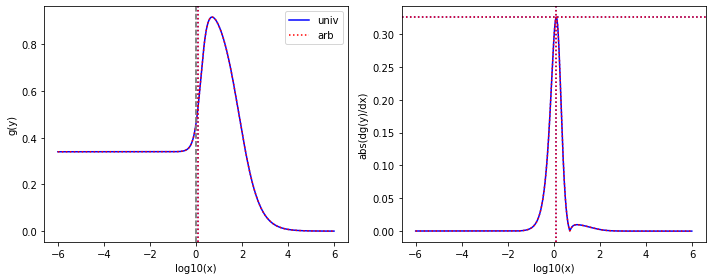

[3.16016e+02 1.05363e+02 3.89751e-01 2.39721e-03 1.00000e-03 1.00000e-03
 1.73213e+02 1.73213e+02 4.46918e+00 8.49991e-03]
found K1
found pairwise
found triplewise
0.001233326793580072 0.0012333267935800722
3.1643967394055995e-06 3.1643967394055995e-06
0.5481146524226621 0.5481146524226621
0.014142258619816717 0.014142258619816718
# maximal error is 1.734723475976807e-18
min-max are 7.027031419536454e-09 5228695147.26011
From univ parameters, position and steepness are: 1.300922744050691 0.3213663993663686 0.7296147573793684
From arb parameters, position and steepness are: 1.300922744050691 0.32136639936636857 0.7296147573793684


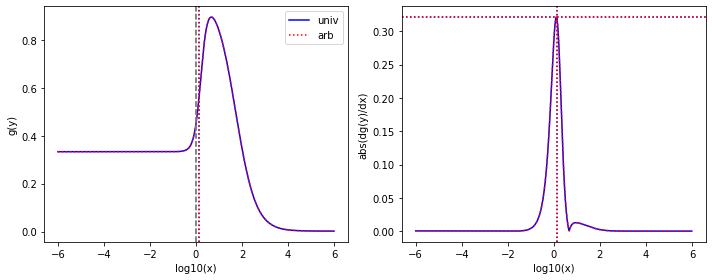

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.20788e+02 1.00000e-03 1.14230e-02 2.77431e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1e-06 1e-06
0.420788 0.42078800000000005
1.1423e-05 1.1423e-05
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 1693438015636860.5
From univ parameters, position and steepness are: 3.954831421603471e-05 0.33792989835753284 36836.49041982033
From arb parameters, position and steepness are: 3.95483142160347e-05 0.33792989835753284 36836.49041982034


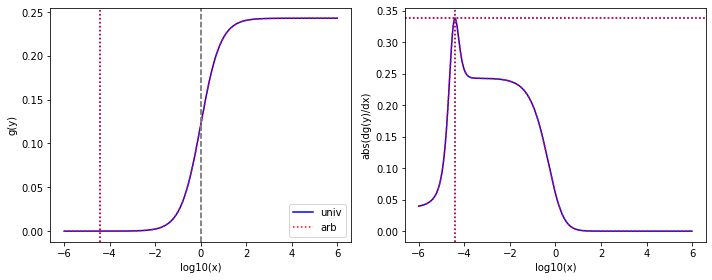

[4.95667e+02 1.73520e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 7.00059e+02 7.00059e+02 8.70679e+00 2.61787e-03]
found K1
found pairwise
found triplewise
2.0174835121159974e-06 2.0174835121159974e-06
2.0174835121159974e-06 2.0174835121159974e-06
1.4123574900084128 1.4123574900084126
0.017565805268456445 0.017565805268456445
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 2817355006092762.5
From univ parameters, position and steepness are: 1.268757423049014 0.33392175778967215 0.5530576398097836
From arb parameters, position and steepness are: 1.268757423049014 0.3339217577896721 0.5530576398097837


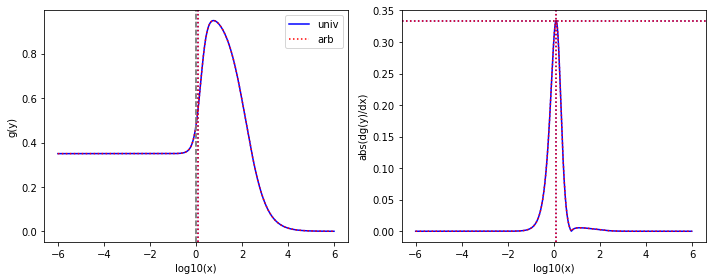

[1.00000e+03 3.40127e+02 6.62370e-01 1.00000e-03 4.36090e-02 1.00000e-03
 1.00000e+03 1.00000e+03 1.99117e+01 2.97689e-03]
found K1
found pairwise
found triplewise
0.00066237 0.00066237
4.3609e-05 4.3609e-05
1.0 1.0
0.0199117 0.0199117
# maximal error is 0.0
min-max are 7.027031419536454e-09 72058604034.61984
From univ parameters, position and steepness are: 1.2797881309383774 0.3304382304188397 0.611545412341249
From arb parameters, position and steepness are: 1.2797881309383776 0.3304382304188397 0.6115454123412489


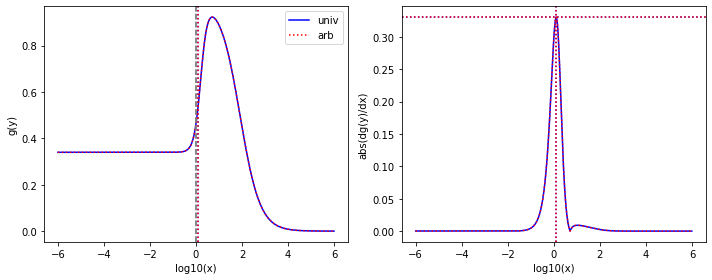

[1.00000e+03 3.39123e+02 3.82302e-03 1.00000e-03 2.96272e-01 2.65650e-01
 8.16945e+02 8.16945e+02 1.58835e+01 4.62443e-03]
found K1
found pairwise
found triplewise
3.82302e-06 3.82302e-06
0.000296272 0.000296272
0.816945 0.816945
0.0158835 0.015883500000000002
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 2406087300876884.0
From univ parameters, position and steepness are: 1.2803029216539334 0.33027432916444255 0.6532997210515296
From arb parameters, position and steepness are: 1.2803029216539334 0.33027432916444255 0.6532997210515296


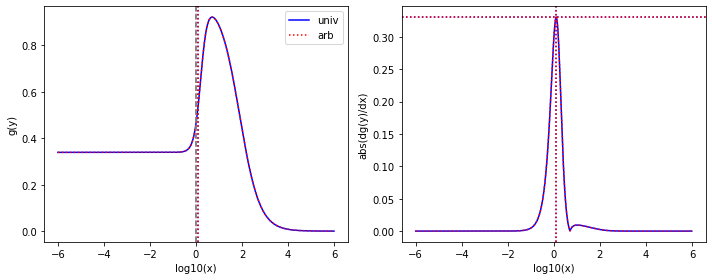

[1.00000e+03 1.00000e-03 2.88517e+00 1.40978e-03 2.28959e-03 1.00000e-03
 4.13313e+02 1.00000e-03 4.78495e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00288517 0.00288517
2.2895900000000002e-06 2.2895900000000002e-06
0.413313 0.41331299999999993
4.78495e-06 4.784949999999999e-06
# maximal error is 5.551115123125783e-17
min-max are 7.027031419536454e-09 3783180275.5430713
From univ parameters, position and steepness are: 1.2241677210644531e-05 0.3463591390789788 86376.53169903839
From arb parameters, position and steepness are: 1.2241677210644531e-05 0.34635913907897875 86376.53169903839


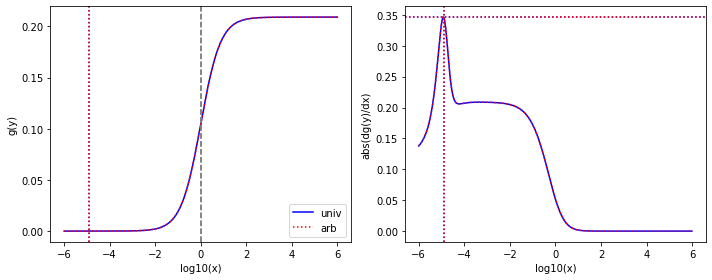

[3.34181e+02 1.05363e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.73213e+02 1.73213e+02 4.46918e+00 4.83747e-03]
found K1
found pairwise
found triplewise
2.9923903513365514e-06 2.9923903513365514e-06
2.9923903513365514e-06 2.9923903513365514e-06
0.5183209099260581 0.5183209099260581
0.013373531110386288 0.013373531110386286
# maximal error is 1.734723475976807e-18
min-max are 2.498058915578641e-10 697088191414569.5
From univ parameters, position and steepness are: 1.2448821042832794 0.345358262585403 0.776477821935858
From arb parameters, position and steepness are: 1.2448821042832794 0.345358262585403 0.776477821935858


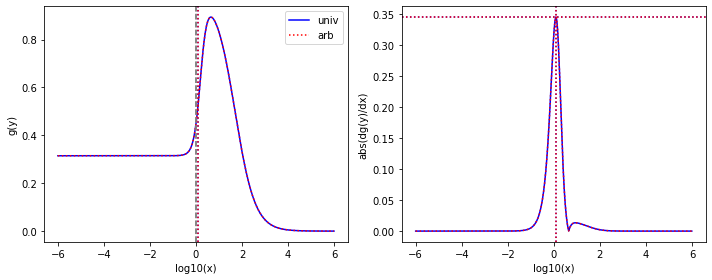

[1.00000e+03 3.30871e+02 1.00000e-03 1.00000e-03 1.14132e-01 4.29412e-03
 8.16945e+02 8.16945e+02 1.58835e+01 1.09221e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
0.000114132 0.000114132
0.816945 0.8169449999999999
0.0158835 0.015883500000000002
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 926910400390479.8
From univ parameters, position and steepness are: 1.2536137434360857 0.341734694171267 0.6673931909756379
From arb parameters, position and steepness are: 1.2536137434360857 0.341734694171267 0.6673931909756379


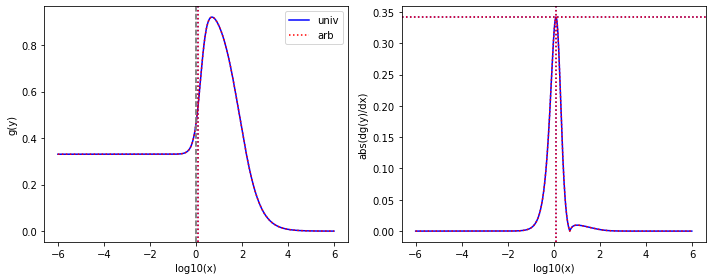

[1.00000e+03 4.42845e-03 2.04619e+00 1.40884e-02 1.00000e-03 1.00000e-03
 1.00000e+03 1.00000e-03 6.35893e-01 1.74587e-01]
found K1
found pairwise
found triplewise
0.0020461900000000002 0.0020461900000000002
1e-06 1e-06
1.0 1.0
0.000635893 0.000635893
# maximal error is 0.0
min-max are 7.027031419536454e-09 8347669040.414189
From univ parameters, position and steepness are: 0.0008062840390956048 0.35532074779374406 1572.6308862199187
From arb parameters, position and steepness are: 0.0008062840390956047 0.35532074779374406 1572.6308862199187


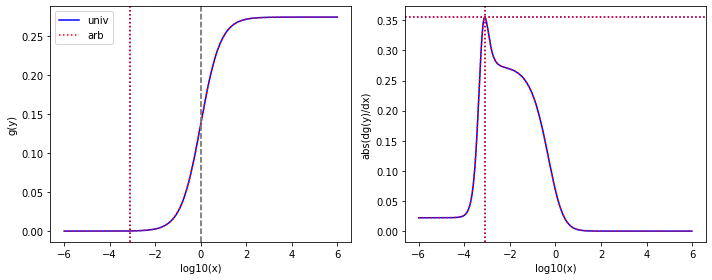

[1.00000e+03 3.39123e+02 1.00000e-03 1.00000e-03 3.80975e-02 3.80975e-02
 8.16945e+02 8.16945e+02 7.67387e+00 4.62443e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
3.80975e-05 3.80975e-05
0.816945 0.816945
0.00767387 0.00767387
# maximal error is 0.0
min-max are 2.498058915578641e-10 309375941720072.44
From univ parameters, position and steepness are: 1.228143698950632 0.351646727302787 0.6862985583343262
From arb parameters, position and steepness are: 1.228143698950632 0.351646727302787 0.6862985583343262


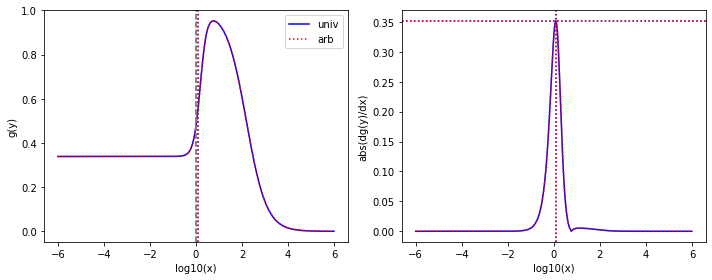

[1.00000e+03 3.31587e+02 1.41307e-02 1.41307e-02 2.48282e-02 2.38061e-03
 1.00000e+03 1.00000e+03 1.57444e+01 1.47764e-03]
found K1
found pairwise
found triplewise
1.41307e-05 1.41307e-05
2.48282e-05 2.48282e-05
1.0 0.9999999999999999
0.015744400000000002 0.015744400000000002
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 201039914066502.0
From univ parameters, position and steepness are: 1.2341382346705536 0.3501393791054442 0.6359539873731092
From arb parameters, position and steepness are: 1.2341382346705536 0.35013937910544424 0.6359539873731093


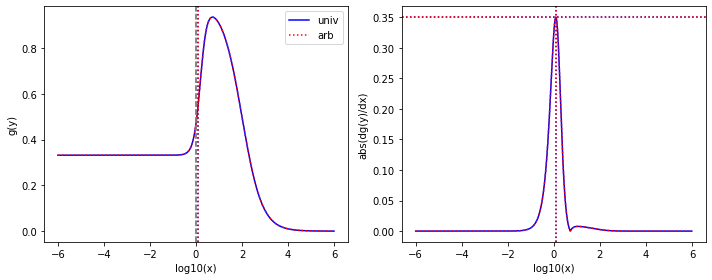

[1.00000e+03 9.72141e-02 2.04619e+00 1.40884e-02 1.00000e-03 1.00000e-03
 4.65198e+02 1.00000e-03 1.74587e-01 5.88708e-02]
found K1
found pairwise
found triplewise
0.0020461900000000002 0.0020461900000000002
1e-06 1e-06
0.465198 0.46519800000000006
0.000174587 0.000174587
# maximal error is 5.551115123125783e-17
min-max are 7.027031419536454e-09 3544071422.825747
From univ parameters, position and steepness are: 0.0008739839327446483 0.3639700193809216 2666.065480164864
From arb parameters, position and steepness are: 0.0008739839327446483 0.3639700193809216 2666.065480164864


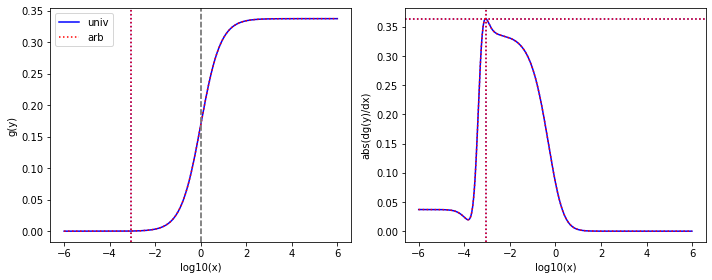

[1.00000e+03 3.40127e+02 2.84403e-01 8.12229e-03 1.00000e-03 1.00000e-03
 1.00000e+03 1.00000e+03 5.64429e+00 2.16611e-03]
found K1
found pairwise
found triplewise
0.000284403 0.000284403
1e-06 1e-06
1.0 1.0
0.00564429 0.005644290000000001
# maximal error is 8.673617379884035e-19
min-max are 7.027031419536454e-09 8925297284.13763
From univ parameters, position and steepness are: 1.2066908306236543 0.36045403451333663 0.6551111385442115
From arb parameters, position and steepness are: 1.2066908306236543 0.36045403451333663 0.6551111385442115


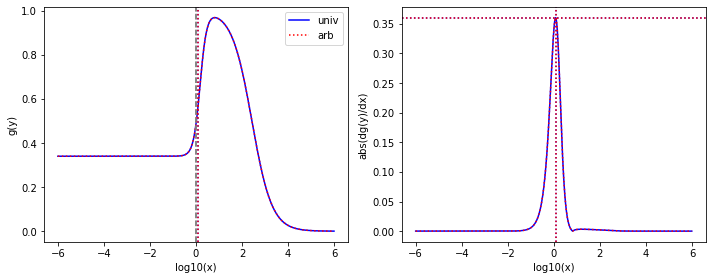

[4.09681e+02 1.23424e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.73213e+02 1.73213e+02 4.46918e+00 1.00000e-03]
found K1
found pairwise
found triplewise
2.4409235478335585e-06 2.4409235478335585e-06
2.4409235478335585e-06 2.4409235478335585e-06
0.42279969049089416 0.4227996904908941
0.010908926701506783 0.010908926701506784
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 697087957858712.0
From univ parameters, position and steepness are: 1.2130558467723478 0.36074485383194216 0.8518903404837632
From arb parameters, position and steepness are: 1.2130558467723476 0.3607448538319422 0.8518903404837632


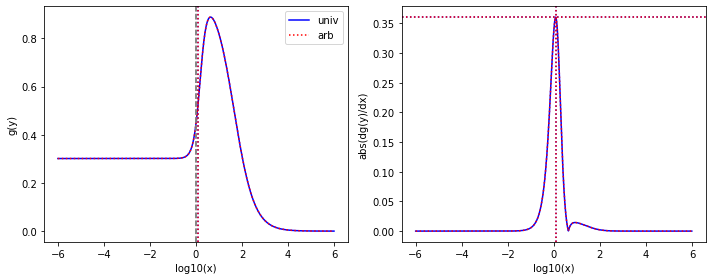

[1.00000e+03 2.34453e-02 1.00000e-03 1.00000e-03 2.85971e-03 1.00000e-03
 4.65198e+02 1.00000e-03 6.14599e-01 1.74587e-01]
found K1
found pairwise
found triplewise
1e-06 1e-06
2.85971e-06 2.85971e-06
0.465198 0.46519799999999994
0.000614599 0.000614599
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 652407688398640.8
From univ parameters, position and steepness are: 0.0021779987711214185 0.37093284381041003 757.0265355642391
From arb parameters, position and steepness are: 0.0021779987711214185 0.3709328438104101 757.0265355642391


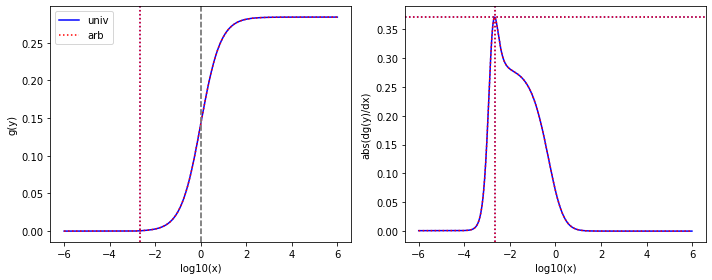

[4.09681e+02 1.05363e+02 1.00000e-03 1.00000e-03 5.67775e-03 1.87936e-03
 1.73213e+02 1.73213e+02 9.35961e+00 3.94334e-03]
found K1
found pairwise
found triplewise
2.4409235478335585e-06 2.4409235478335585e-06
1.3858953673711985e-05 1.3858953673711985e-05
0.42279969049089416 0.4227996904908942
0.022846092447538453 0.022846092447538456
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 122238344715828.94
From univ parameters, position and steepness are: 1.1807003263794356 0.3729367179799132 0.8571114579582259
From arb parameters, position and steepness are: 1.1807003263794356 0.37293671797991323 0.8571114579582259


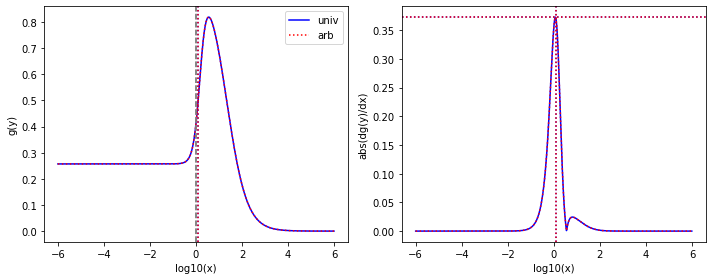

[6.18227e+00 1.84942e+00 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 5.34720e+02 5.34720e+02 7.20142e+01 1.29116e-01]
found K1
found pairwise
found triplewise
0.00016175288364953327 0.00016175288364953327
0.00016175288364953327 0.00016175288364953327
86.49250194507843 86.49250194507843
11.648504513714219 11.648504513714219
# maximal error is 0.0
min-max are 7.027031419536454e-09 267277355822.39377
From univ parameters, position and steepness are: 1.19334107359602 0.37048612242570433 0.14734947798926593
From arb parameters, position and steepness are: 1.19334107359602 0.37048612242570433 0.14734947798926593


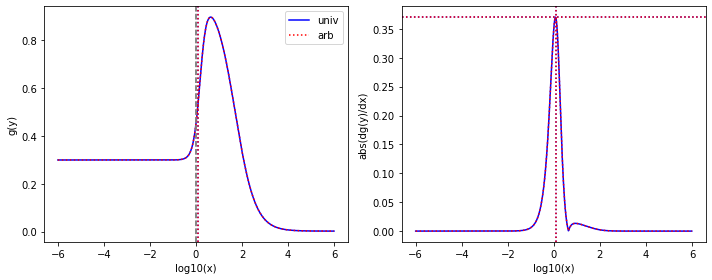

[1.00000e-03 1.00000e-03 1.08102e+00 1.08102e+00 2.71858e-01 1.00000e-03
 3.00223e-03 2.36639e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1081.02 1081.02
271.858 271.858
3.00223 3.00223
1.0 1.0
# maximal error is 0.0
min-max are 7.027031419536454e-09 4.492130925555861e+17
From univ parameters, position and steepness are: 0.009151096826557 0.3852044476860471 1.5534261863490912
From arb parameters, position and steepness are: 0.009151096826557 0.3852044476860471 1.553426186349091


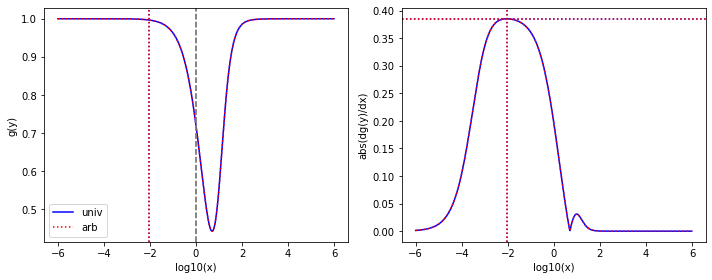

[4.09681e+02 1.05363e+02 1.00000e-03 1.00000e-03 2.87278e-03 1.00000e-03
 1.73213e+02 1.73213e+02 8.08795e+00 5.27329e-03]
found K1
found pairwise
found triplewise
2.4409235478335585e-06 2.4409235478335585e-06
7.01223634974529e-06 7.01223634974529e-06
0.42279969049089416 0.4227996904908942
0.019742067608700425 0.019742067608700425
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 241812120056386.94
From univ parameters, position and steepness are: 1.163455951797851 0.3842515958388159 0.8746731163183421
From arb parameters, position and steepness are: 1.163455951797851 0.38425159583881596 0.8746731163183421


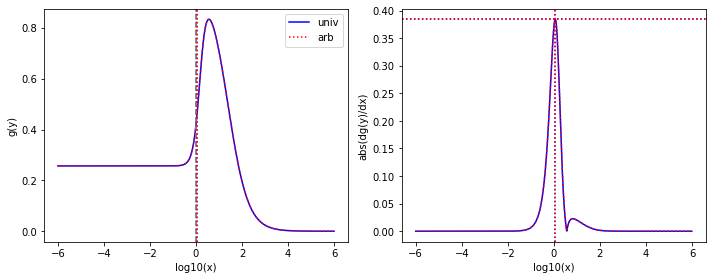

[4.09681e+02 1.16890e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.73213e+02 1.73213e+02 4.46918e+00 1.00000e-03]
found K1
found pairwise
found triplewise
2.4409235478335585e-06 2.4409235478335585e-06
2.4409235478335585e-06 2.4409235478335585e-06
0.42279969049089416 0.4227996904908941
0.010908926701506783 0.010908926701506784
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 697087957858712.0
From univ parameters, position and steepness are: 1.1723338950761213 0.3824522159771543 0.8818543610600553
From arb parameters, position and steepness are: 1.1723338950761213 0.3824522159771543 0.8818543610600553


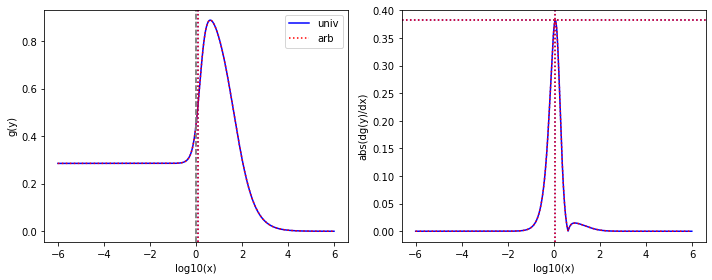

[6.18227e+00 1.41570e+00 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 6.64507e+02 1.58309e+02 4.21958e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.00016175288364953327 0.00016175288364953327
0.00016175288364953327 0.00016175288364953327
107.4859234553004 107.4859234553004
6.825292327898976 6.825292327898976
# maximal error is 0.0
min-max are 7.027031419536454e-09 267277355822.39377
From univ parameters, position and steepness are: 0.008574103064608587 0.3925806079058099 16.511846516109717
From arb parameters, position and steepness are: 0.008574103064608587 0.39258060790580945 16.511846516109713


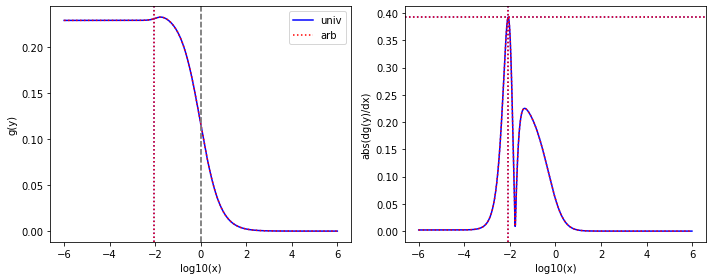

[3.75323e+02 1.05363e+02 1.53073e-01 1.00000e-03 1.80980e-02 1.00000e-03
 1.73213e+02 1.73213e+02 4.46918e+00 1.00000e-03]
found K1
found pairwise
found triplewise
0.0004078433775707857 0.0004078433775707857
4.8219800012256115e-05 4.8219800012256115e-05
0.46150382470565354 0.46150382470565354
0.01190755695760718 0.01190755695760718
# maximal error is 0.0
min-max are 3.529814346881038e-10 79677404128.55228
From univ parameters, position and steepness are: 1.1589743591607962 0.3901139318092824 0.867123135563968
From arb parameters, position and steepness are: 1.1589743591607962 0.39011393180928244 0.867123135563968


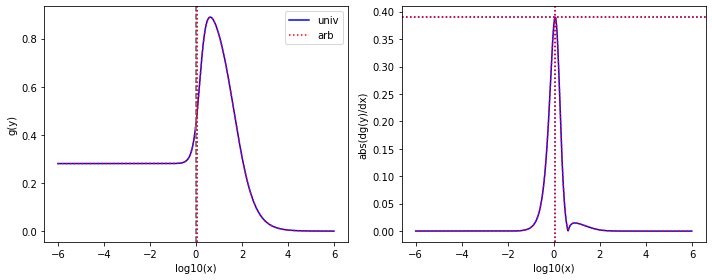

[1.00000e+03 1.00000e+03 1.00000e-03 1.00000e-03 4.25603e-03 3.16916e-03
 3.41307e+02 3.41307e+02 5.10965e-02 3.54969e-02]
found K1
found pairwise
found triplewise
1e-06 1e-06
4.25603e-06 4.25603e-06
0.341307 0.3413070000000001
5.10965e-05 5.10965e-05
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 321424646278746.7
From univ parameters, position and steepness are: 0.000266884920365088 0.40696340912610013 6679.655153965626
From arb parameters, position and steepness are: 0.00026688492036508796 0.40696340912610013 6679.655153965627


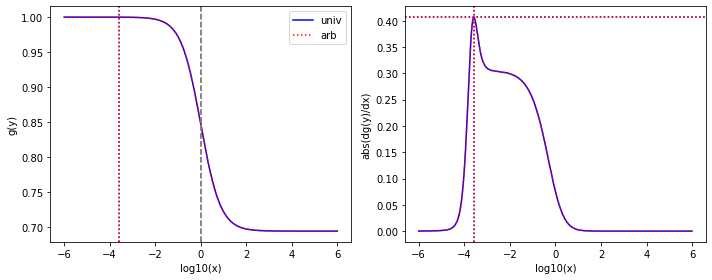

[4.09681e+02 1.05363e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.38855e+02 1.38855e+02 4.46918e+00 1.00000e-03]
found K1
found pairwise
found triplewise
2.4409235478335585e-06 2.4409235478335585e-06
2.4409235478335585e-06 2.4409235478335585e-06
0.33893443923442873 0.33893443923442873
0.010908926701506783 0.010908926701506783
# maximal error is 0.0
min-max are 2.498058915578641e-10 558815726135183.7
From univ parameters, position and steepness are: 1.135227377954568 0.40390148916626306 0.9740657605802702
From arb parameters, position and steepness are: 1.135227377954568 0.4039014891662631 0.9740657605802703


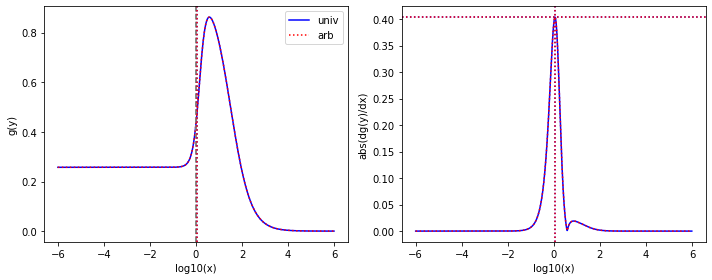

[4.09681e+02 1.05363e+02 1.46450e-03 1.00000e-03 1.45088e-03 1.00000e-03
 1.20614e+02 1.20614e+02 3.94300e+00 1.00000e-03]
found K1
found pairwise
found triplewise
3.5747325358022463e-06 3.5747325358022463e-06
3.5414871570807534e-06 3.5414871570807534e-06
0.2944095527983968 0.2944095527983968
0.009624561549107721 0.009624561549107721
# maximal error is 0.0
min-max are 2.498058915578641e-10 334576409722141.4
From univ parameters, position and steepness are: 1.140674425804569 0.4000655991175664 1.0142164888266423
From arb parameters, position and steepness are: 1.140674425804569 0.40006559911756645 1.0142164888266423


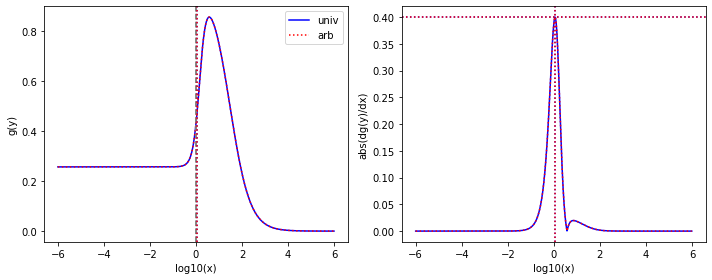

[1.34728e+02 1.00000e-03 1.00000e-03 1.00000e-03 3.09863e-01 2.24790e-03
 4.41163e+02 1.73660e-01 3.71752e-01 1.00000e-03]
found K1
found pairwise
found triplewise
7.422362092512321e-06 7.422362092512321e-06
0.002299915385072145 0.002299915385072145
3.274471527819013 3.274471527819013
0.0027592779526156405 0.002759277952615641
# maximal error is 4.336808689942018e-19
min-max are 2.498058915578641e-10 1.867905600734988e+16
From univ parameters, position and steepness are: 0.0006261769058445969 0.4136336747640901 844.994898895676
From arb parameters, position and steepness are: 0.0006261769058445969 0.4136336747640902 844.994898895676


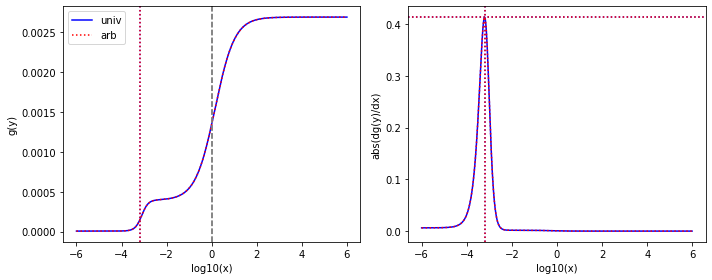

[4.09681e+02 1.05363e+02 3.69082e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.73213e+02 1.73213e+02 5.27043e+00 1.00000e-03]
found K1
found pairwise
found triplewise
9.009009448815055e-06 9.009009448815055e-06
2.4409235478335585e-06 2.440923547833558e-06
0.42279969049089416 0.42279969049089416
0.012864716694208422 0.012864716694208422
# maximal error is 4.235164736271502e-22
min-max are 2.498058915578641e-10 707239683597480.6
From univ parameters, position and steepness are: 1.1244345101620887 0.41148104750948405 0.9166298859174391
From arb parameters, position and steepness are: 1.1244345101620887 0.4114810475094841 0.9166298859174391


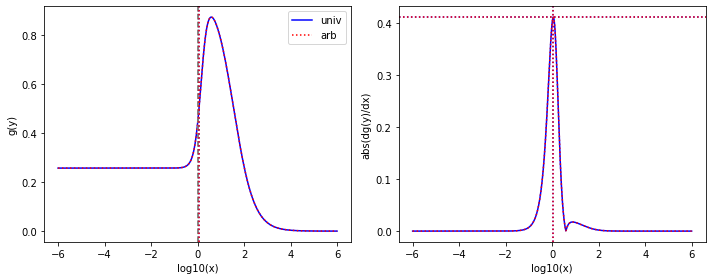

[1.00000e+03 4.93693e-03 1.06635e-03 1.06635e-03 1.00000e-03 1.00000e-03
 4.41163e+02 1.00000e-03 2.34961e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.06635e-06 1.06635e-06
1e-06 1e-06
0.441163 0.441163
2.3496099999999998e-06 2.3496099999999998e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 1776064694001182.2
From univ parameters, position and steepness are: 0.00029892167133710543 0.4252216194913323 187762.45235706007
From arb parameters, position and steepness are: 0.00029892167133710543 0.42522161949133225 187762.45235706007


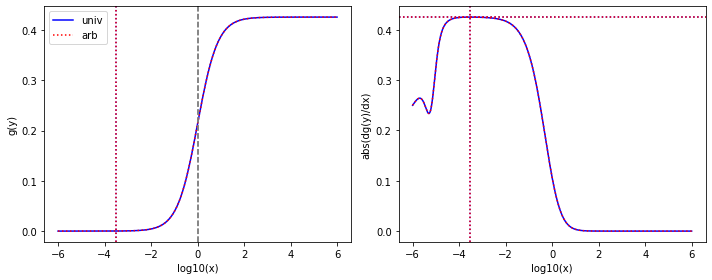

[4.09681e+02 1.05363e+02 1.00000e-03 1.00000e-03 5.67775e-03 1.87936e-03
 1.73213e+02 1.73213e+02 4.46918e+00 7.48378e-03]
found K1
found pairwise
found triplewise
2.4409235478335585e-06 2.4409235478335585e-06
1.3858953673711985e-05 1.3858953673711985e-05
0.42279969049089416 0.4227996904908942
0.010908926701506783 0.010908926701506784
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 122238344715828.94
From univ parameters, position and steepness are: 1.1099849867359655 0.42107233849211073 0.9320644432512226
From arb parameters, position and steepness are: 1.1099849867359655 0.42107233849211073 0.9320644432512226


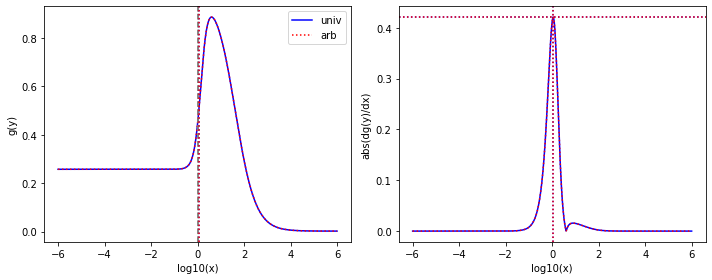

[4.09681e+02 1.05363e+02 1.00000e-03 1.00000e-03 5.67775e-03 1.46342e-03
 1.73213e+02 1.73213e+02 4.46918e+00 5.76038e-03]
found K1
found pairwise
found triplewise
2.4409235478335585e-06 2.4409235478335585e-06
1.3858953673711985e-05 1.3858953673711985e-05
0.42279969049089416 0.4227996904908942
0.010908926701506783 0.010908926701506784
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 122238344715828.94
From univ parameters, position and steepness are: 1.1105352087169968 0.4208516323698986 0.9315969647927699
From arb parameters, position and steepness are: 1.1105352087169968 0.4208516323698986 0.9315969647927698


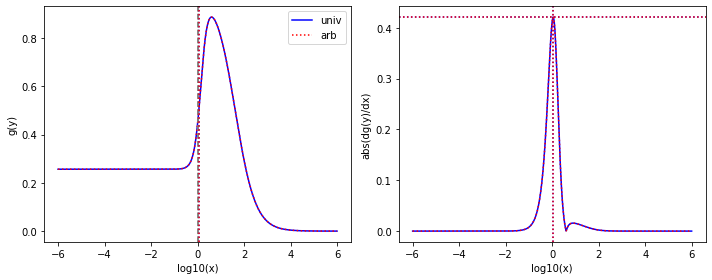

[3.87032e+02 1.00000e-03 7.61988e-02 1.00000e-03 1.00000e-03 1.00000e-03
 4.41163e+02 1.00000e-03 4.12858e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00019687984456065647 0.00019687984456065647
2.5837656834576988e-06 2.5837656834576988e-06
1.1398618202112487 1.1398618202112487
1.0667283325409784e-05 1.0667283325409784e-05
# maximal error is 0.0
min-max are 7.027031419536454e-09 4269271536.1666527
From univ parameters, position and steepness are: 4.164534398936714e-06 0.43825088875075546 106856.14782948064
From arb parameters, position and steepness are: 4.164534398936715e-06 0.43825088875075546 106856.14782948064


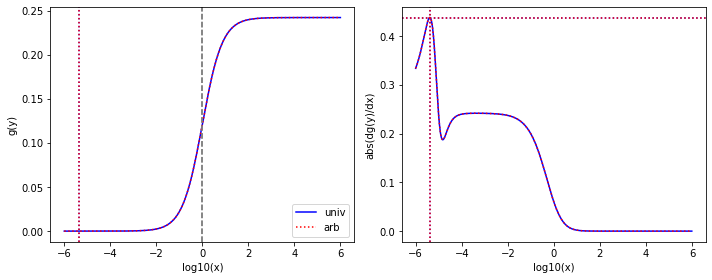

[4.09681e+02 1.05363e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.20614e+02 1.20614e+02 2.00589e+00 1.00000e-03]
found K1
found pairwise
found triplewise
2.4409235478335585e-06 2.4409235478335585e-06
2.4409235478335585e-06 2.4409235478335585e-06
0.2944095527983968 0.29440955279839676
0.004896224135363857 0.004896224135363857
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 485405638852196.3
From univ parameters, position and steepness are: 1.0914510653944896 0.4348536778862887 1.0756280972840098
From arb parameters, position and steepness are: 1.0914510653944896 0.4348536778862887 1.0756280972840098


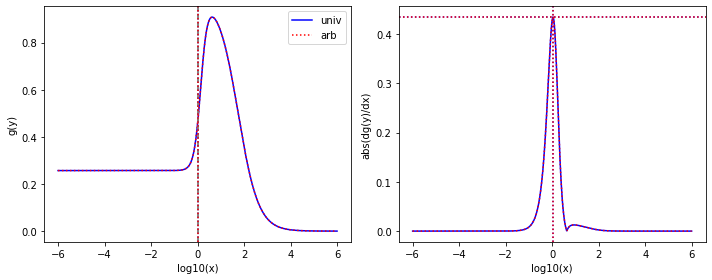

[1.00000e+03 1.49419e-03 1.00000e-03 1.00000e-03 1.36813e-03 1.00000e-03
 4.73440e+02 1.00000e-03 3.38306e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1.3681299999999999e-06 1.3681299999999999e-06
0.47343999999999997 0.4734399999999999
3.3830599999999996e-06 3.38306e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 1390660553199910.0
From univ parameters, position and steepness are: 7.434041513921423e-06 0.4473973065006107 139943.72557617215
From arb parameters, position and steepness are: 7.434041513921425e-06 0.4473973065006107 139943.72557617215


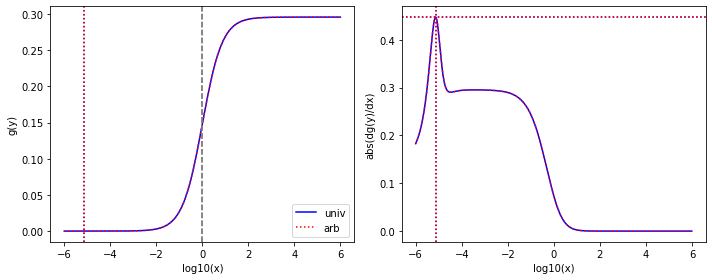

[4.09681e+02 1.05363e+02 3.89751e-01 2.39721e-03 1.00000e-03 1.00000e-03
 1.73213e+02 1.73213e+02 2.86436e+00 4.83747e-03]
found K1
found pairwise
found triplewise
0.0009513523936916773 0.0009513523936916773
2.4409235478335585e-06 2.4409235478335585e-06
0.42279969049089416 0.42279969049089416
0.006991683773472531 0.006991683773472531
# maximal error is 0.0
min-max are 7.027031419536454e-09 4033241616.51873
From univ parameters, position and steepness are: 1.0828004277985572 0.4403731170807275 0.9631275308250241
From arb parameters, position and steepness are: 1.0828004277985572 0.4403731170807275 0.9631275308250241


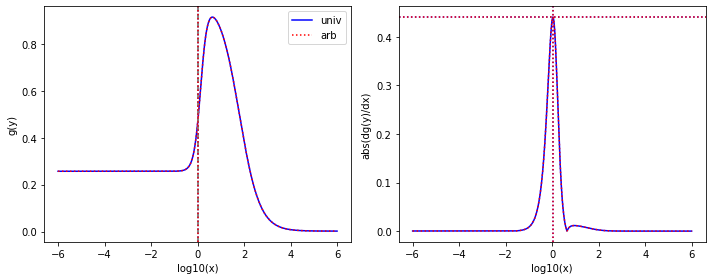

[4.77915e+02 1.71234e+02 1.00000e-03 1.00000e-03 2.19386e-02 8.15882e-03
 6.61420e+02 2.41275e+02 5.29557e+00 1.28812e-02]
found K1
found pairwise
found triplewise
2.092422292667106e-06 2.092422292667106e-06
4.590481570990657e-05 4.590481570990657e-05
1.383969952815877 1.383969952815877
0.011080568720379146 0.011080568720379144
# maximal error is 1.734723475976807e-18
min-max are 2.498058915578641e-10 372738059079706.0
From univ parameters, position and steepness are: 0.004570943347219404 0.4572398002242172 127.9175812274974
From arb parameters, position and steepness are: 0.004570943347219414 0.45723980022422434 127.91758122749741


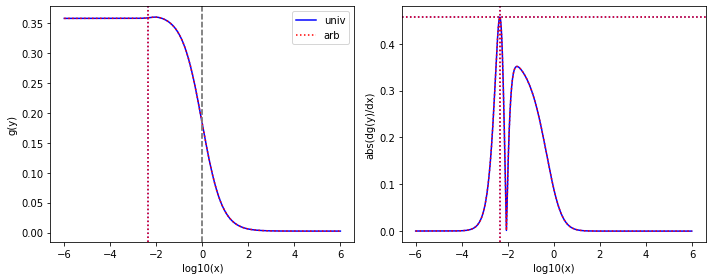

[4.50628e+02 1.05363e+02 1.00000e-03 1.00000e-03 2.87278e-03 1.00000e-03
 1.73213e+02 1.73213e+02 4.46918e+00 1.02920e-02]
found K1
found pairwise
found triplewise
2.2191253095679808e-06 2.2191253095679808e-06
6.375058806820704e-06 6.375058806820704e-06
0.3843813522461986 0.38438135224619857
0.009917670451015027 0.009917670451015027
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 241812104852826.03
From univ parameters, position and steepness are: 1.0697422466322657 0.450891313801839 0.9982254880458862
From arb parameters, position and steepness are: 1.0697422466322657 0.450891313801839 0.9982254880458862


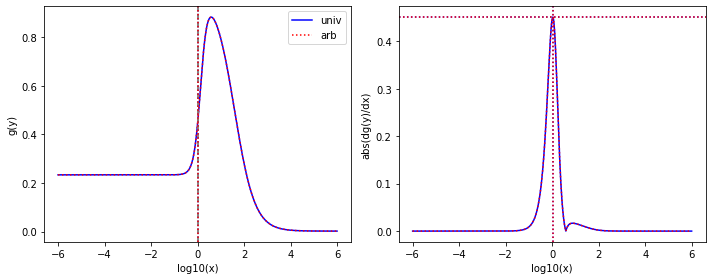

[2.59370e+02 6.24680e+01 2.97582e-03 2.97582e-03 5.67722e-02 2.18142e-03
 7.00059e+02 7.00059e+02 2.73549e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1.147326213517369e-05 1.147326213517369e-05
0.0002188849905540348 0.0002188849905540348
2.699074680957705 2.699074680957705
0.10546670779195744 0.10546670779195744
# maximal error is 0.0
min-max are 2.498058915578641e-10 1777238387141996.0
From univ parameters, position and steepness are: 1.0704509618397666 0.45136302769243397 0.5231773183343009
From arb parameters, position and steepness are: 1.0704509618397666 0.45136302769243397 0.5231773183343009


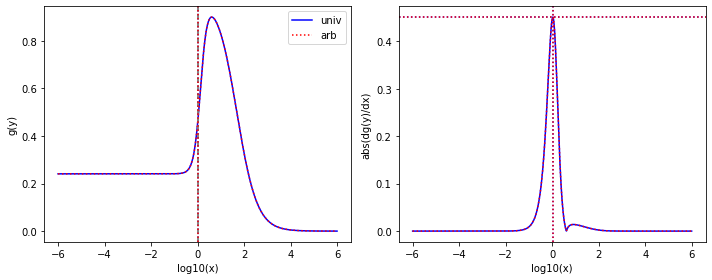

[1.00000e+03 4.70531e-02 2.96920e-03 1.00000e-03 7.81164e-01 8.92593e-02
 4.65198e+02 1.00000e-03 1.45089e-01 5.27729e-02]
found K1
found pairwise
found triplewise
2.9692e-06 2.9692e-06
0.000781164 0.000781164
0.465198 0.46519800000000006
0.000145089 0.00014508900000000002
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 6344303721942993.0
From univ parameters, position and steepness are: 0.00035254314495736027 0.46932812120969297 3207.0864513490924
From arb parameters, position and steepness are: 0.00035254314495736016 0.46932812120969297 3207.086451349093


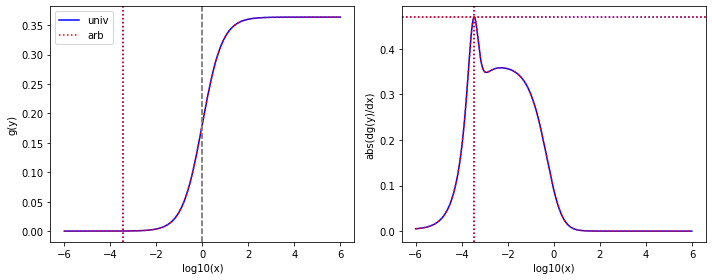

[4.95667e+02 1.16324e+02 1.04763e-01 1.00000e-03 8.25662e-03 1.73985e-03
 7.00059e+02 7.00059e+02 1.80711e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.00021135762517980822 0.00021135762517980825
1.6657594715807186e-05 1.6657594715807186e-05
1.4123574900084128 1.4123574900084126
0.0364581462957994 0.0364581462957994
# maximal error is 2.220446049250313e-16
min-max are 7.027031419536454e-09 27524604346.89999
From univ parameters, position and steepness are: 1.0503082881731862 0.467751220364845 0.6638442965598016
From arb parameters, position and steepness are: 1.0503082881731862 0.46775122036484507 0.6638442965598016


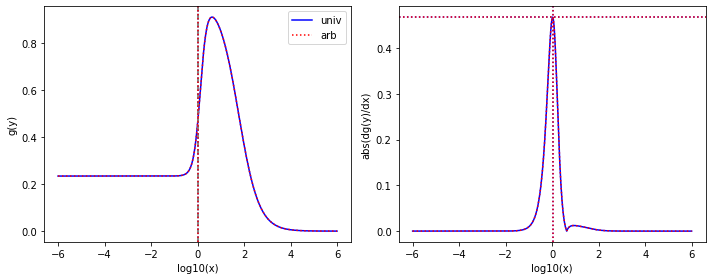

[4.13403e+01 6.70745e+00 1.00000e-03 1.00000e-03 4.45066e-01 1.43463e-02
 1.00000e+03 1.59205e+02 2.19940e+01 4.45717e-01]
found K1
found pairwise
found triplewise
2.4189471290726e-05 2.4189471290726e-05
0.010765911229478257 0.010765911229478257
24.189471290726 24.189471290725997
0.5320232315682276 0.5320232315682276
# maximal error is 3.552713678800501e-15
min-max are 2.498058915578641e-10 8.743717527772806e+16
From univ parameters, position and steepness are: 0.006927373490625205 0.4735224751271187 43.5165865708448
From arb parameters, position and steepness are: 0.0069273734906252025 0.4735224751271214 43.51658657084479


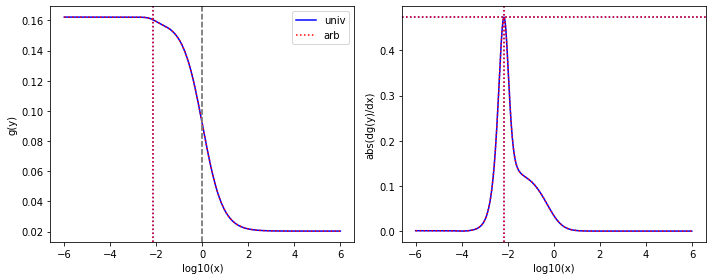

[4.88963e+02 1.05363e+02 3.45425e-03 1.00000e-03 1.19298e-03 1.00000e-03
 1.73213e+02 1.73213e+02 4.46918e+00 3.86052e-03]
found K1
found pairwise
found triplewise
7.064440458685012e-06 7.064440458685012e-06
2.439816509633653e-06 2.439816509633653e-06
0.3542456177665794 0.3542456177665795
0.00914011898650818 0.009140118986508178
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 590293579101061.9
From univ parameters, position and steepness are: 1.044330361946282 0.47296002235377355 1.050536330319557
From arb parameters, position and steepness are: 1.044330361946282 0.47296002235377355 1.050536330319557


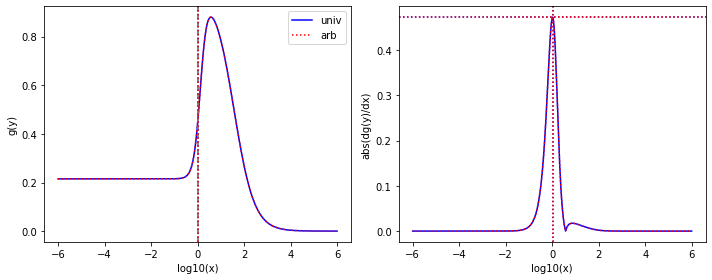

[1.00000e+03 1.00000e-03 1.40132e-02 5.78421e-03 3.51866e-01 1.00000e-03
 4.43150e+02 2.56677e-02 3.60644e-02 1.00000e-03]
found K1
found pairwise
found triplewise
1.40132e-05 1.40132e-05
0.000351866 0.000351866
0.44315 0.44315
3.6064400000000007e-05 3.6064400000000007e-05
# maximal error is 0.0
min-max are 2.498058915578641e-10 2857169642058809.0
From univ parameters, position and steepness are: 8.146950699863181e-05 0.4835307371723235 12237.290533560781
From arb parameters, position and steepness are: 8.14695069986318e-05 0.48353073717232353 12237.290533560783


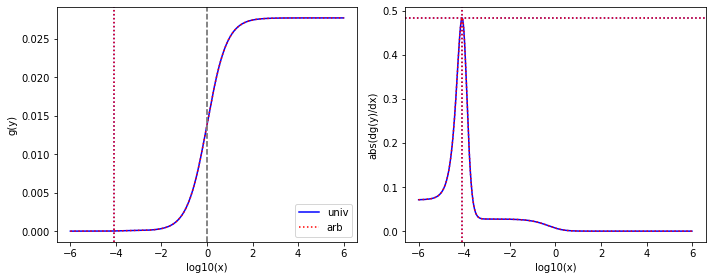

[7.96031e+02 1.73520e+02 1.00000e-03 1.00000e-03 4.94225e-02 1.00000e-03
 7.00059e+02 7.00059e+02 1.80711e+01 2.61787e-03]
found K1
found pairwise
found triplewise
1.2562324834083096e-06 1.2562324834083096e-06
6.208614991124718e-05 6.208614991124718e-05
0.8794368561023378 0.8794368561023378
0.022701502830919904 0.022701502830919908
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 504195113722407.94
From univ parameters, position and steepness are: 1.03291734512975 0.48353042460299345 0.7887876144850386
From arb parameters, position and steepness are: 1.03291734512975 0.48353042460299345 0.7887876144850386


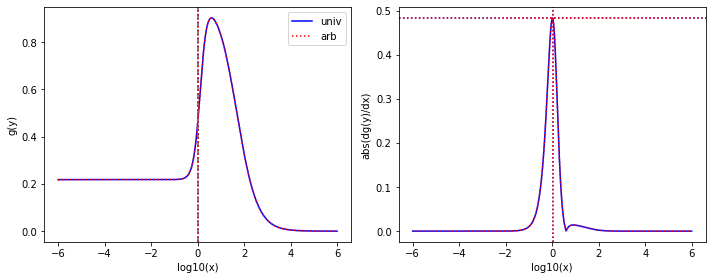

[9.64176e+02 2.24776e-02 2.76555e-03 1.00000e-03 5.74175e-03 1.00000e-03
 1.14906e+02 1.00000e-03 2.04603e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.8683041270473436e-06 2.8683041270473436e-06
5.9550849637410595e-06 5.9550849637410595e-06
0.11917533728281973 0.11917533728281973
2.1220503310598894e-06 2.1220503310598894e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 80316872301963.56
From univ parameters, position and steepness are: 8.778878910280387e-05 0.4938589666608123 56163.824580966975
From arb parameters, position and steepness are: 8.778878910280387e-05 0.4938589666608123 56163.824580966975


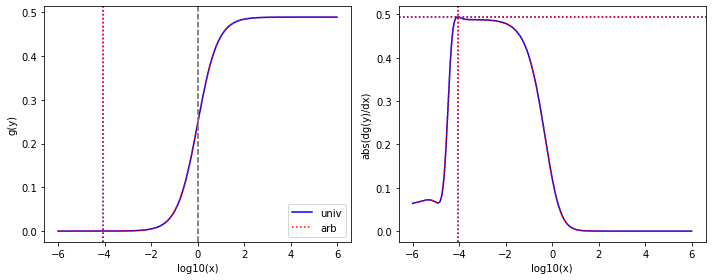

[8.32943e+02 1.73520e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 7.00059e+02 7.00059e+02 1.80711e+01 1.00000e-03]
found K1
found pairwise
found triplewise
1.2005623434016493e-06 1.2005623434016493e-06
1.2005623434016493e-06 1.2005623434016493e-06
0.8404644735594152 0.8404644735594151
0.021695482163845547 0.021695482163845543
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 2817350787400805.5
From univ parameters, position and steepness are: 1.020259817408258 0.4956161547070331 0.8106655817133364
From arb parameters, position and steepness are: 1.020259817408258 0.495616154707033 0.8106655817133365


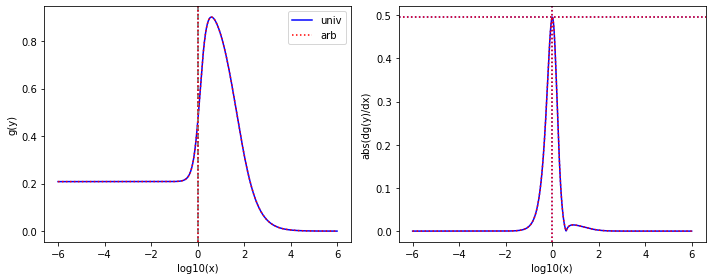

[4.13403e+01 4.13403e+01 1.00000e-03 1.00000e-03 1.04802e-03 1.00000e-03
 1.00000e+03 1.00000e+03 1.85000e+01 1.13773e+01]
found K1
found pairwise
found triplewise
2.4189471290726e-05 2.4189471290726e-05
2.5351049702106663e-05 2.5351049702106663e-05
24.189471290726 24.189471290726
0.447505218878431 0.447505218878431
# maximal error is 0.0
min-max are 2.498058915578641e-10 3839123660406926.0
From univ parameters, position and steepness are: 0.007975847161968678 0.5079308201685074 54.054069019832205
From arb parameters, position and steepness are: 0.007975847161968678 0.5079308201685074 54.054069019832205


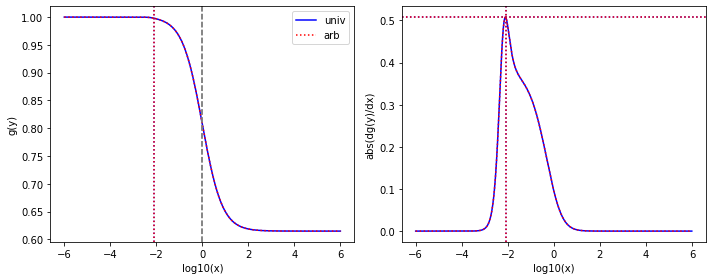

[4.09681e+02 7.86028e+01 1.79152e-03 1.00000e-03 9.38354e-03 1.00000e-03
 1.60486e+02 1.60486e+02 4.46918e+00 4.61757e-03]
found K1
found pairwise
found triplewise
4.372963354414777e-06 4.372963354414777e-06
2.290450374803811e-05 2.290450374803811e-05
0.39173405649761645 0.3917340564976164
0.010908926701506783 0.010908926701506783
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 185836614286394.78
From univ parameters, position and steepness are: 1.013359231499283 0.501975222043078 1.0465410650978293
From arb parameters, position and steepness are: 1.013359231499283 0.501975222043078 1.0465410650978293


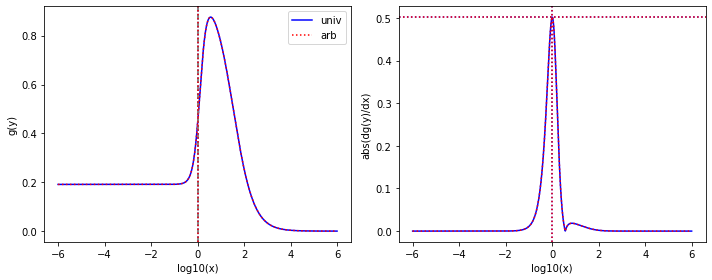

[1.00000e+03 1.11462e-03 1.24888e-02 1.00000e-03 8.43232e-03 1.00000e-03
 1.00000e+03 2.28969e-02 3.85956e-02 1.00000e-03]
found K1
found pairwise
found triplewise
1.24888e-05 1.24888e-05
8.43232e-06 8.43232e-06
1.0 1.0
3.85956e-05 3.85956e-05
# maximal error is 0.0
min-max are 2.498058915578641e-10 478494001988763.9
From univ parameters, position and steepness are: 3.0253258243283518e-05 0.5129711707130575 25866.122684287144
From arb parameters, position and steepness are: 3.0253258243283518e-05 0.5129711707130575 25866.122684287147


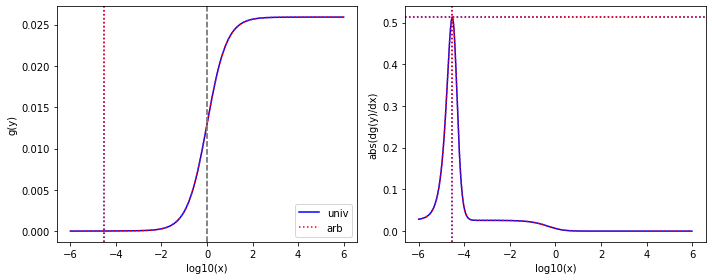

[8.71976e+00 1.84942e+00 1.00000e-03 1.00000e-03 1.88046e-03 1.00000e-03
 8.47388e+02 8.47388e+02 5.63754e+01 2.31115e-03]
found K1
found pairwise
found triplewise
0.00011468205546941659 0.00011468205546941659
0.0002156550180280191 0.00021565501802801914
97.18019762011798 97.18019762011797
6.4652467499105475 6.465246749910548
# maximal error is 1.4210854715202004e-14
min-max are 7.027031419536454e-09 356344238172.0377
From univ parameters, position and steepness are: 1.0007546681033972 0.51288652112592 0.17095354481068345
From arb parameters, position and steepness are: 1.0007546681033972 0.51288652112592 0.17095354481068345


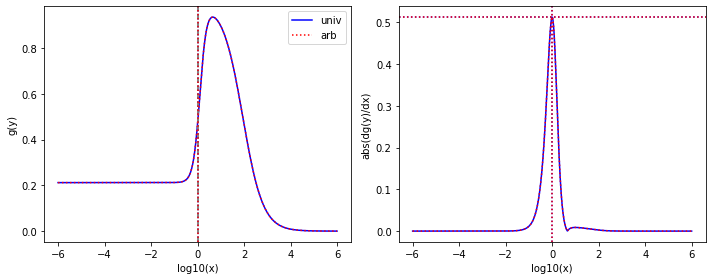

[1.00000e+03 1.00000e-03 1.01532e-02 1.00000e-03 1.00000e-03 1.00000e-03
 2.98461e+02 1.00000e-03 3.14597e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.01532e-05 1.01532e-05
1e-06 1e-06
0.29846100000000003 0.29846100000000003
3.14597e-06 3.1459699999999996e-06
# maximal error is 4.235164736271502e-22
min-max are 2.498058915578641e-10 1262798497352692.8
From univ parameters, position and steepness are: 1.4184854238958827e-05 0.5274677892563648 94869.49522374278
From arb parameters, position and steepness are: 1.4184854238958826e-05 0.5274677892563648 94869.4952237428


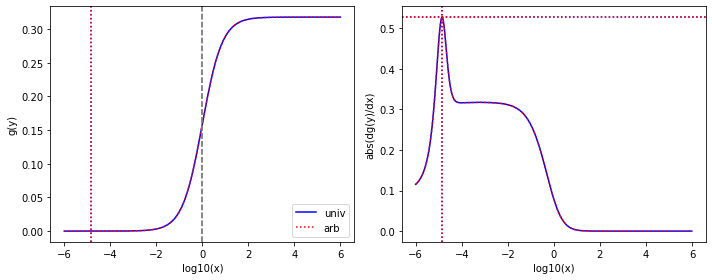

[6.53577e+00 6.53577e+00 4.13592e+00 3.22661e-03 1.05412e-03 1.00000e-03
 1.00000e-03 1.00000e-03 5.37995e+00 3.75782e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00016128474533222558 0.00016128474533222558
0.00015300416018311538 0.00015300416018311538
0.8231547315771516 0.8231547315771515
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 266503614287.01727
From univ parameters, position and steepness are: 0.9920590877288908 0.5288011410147385 0.8324047354649415
From arb parameters, position and steepness are: 0.9920590877288908 0.5288011410147385 0.8324047354649415


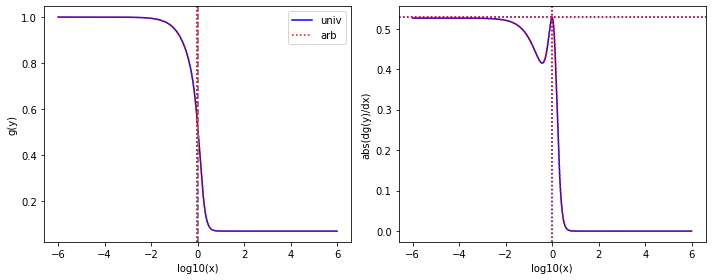

[5.52970e+02 4.50732e-03 3.29410e-03 1.00000e-03 8.15396e-01 2.75065e-03
 4.29264e+02 1.00000e-03 2.80700e-03 1.00000e-03]
found K1
found pairwise
found triplewise
5.9571043637087e-06 5.9571043637087e-06
0.0014745754742571929 0.0014745754742571926
0.7762880445593794 0.7762880445593794
5.0762247499864364e-06 5.0762247499864364e-06
# maximal error is 2.168404344971009e-19
min-max are 2.498058915578641e-10 1.1975901073779824e+16
From univ parameters, position and steepness are: 2.16841841494144e-06 0.5385540382925814 152931.2557242861
From arb parameters, position and steepness are: 2.168418414941439e-06 0.5385540382925814 152931.25572428614


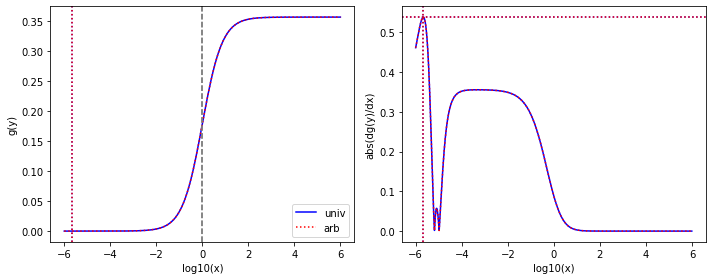

[6.53577e+00 6.35409e+00 4.13592e+00 1.00000e-03 1.00000e-03 1.00000e-03
 3.86809e-03 1.00000e-03 4.78857e+00 1.70624e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.0005918338619627067 0.0005918338619627067
0.7326711313280607 0.7326711313280606
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9901364984926985 0.5338540711294044 0.8653841893274645
From arb parameters, position and steepness are: 0.9901364984926985 0.5338540711294044 0.8653841893274645


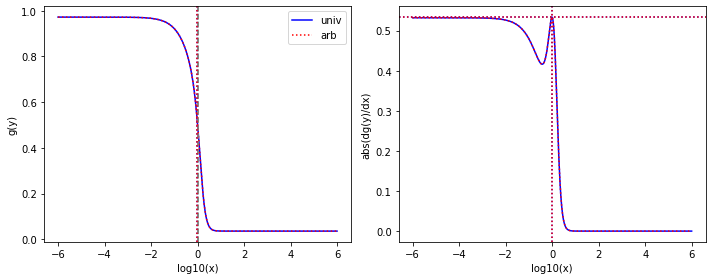

[3.73297e+02 2.88648e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.65198e+02 1.00000e-03 2.56593e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.6788321363418402e-06 2.6788321363418402e-06
2.6788321363418402e-06 2.6788321363418402e-06
1.2461873521619513 1.2461873521619513
6.873695743603619e-06 6.87369574360362e-06
# maximal error is 8.470329472543003e-22
min-max are 2.498058915578641e-10 1872168811487507.0
From univ parameters, position and steepness are: 6.833779302563172e-07 0.5465952581836478 181303.20319296405
From arb parameters, position and steepness are: 6.833779302563173e-07 0.5465952581836478 181303.20319296402


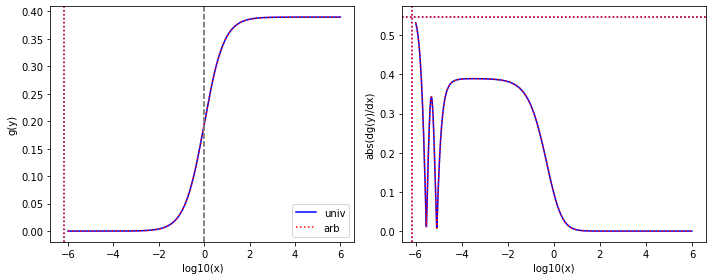

[6.53577e+00 6.53577e+00 4.13592e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.70974e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.0001530041601831154
0.7326711313280607 0.7326711313280607
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9900975711673231 0.5499676157980616 0.865926943754932
From arb parameters, position and steepness are: 0.9900975711673231 0.5499676157980616 0.865926943754932


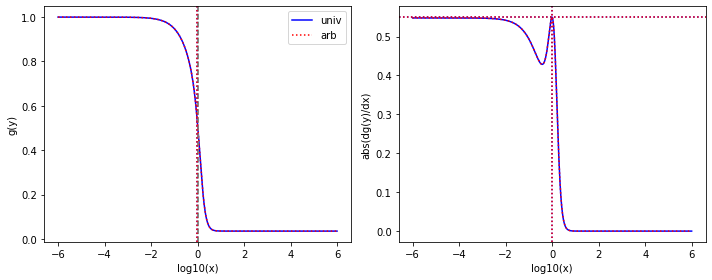

[4.13403e+01 1.53564e+01 1.88131e-01 1.00000e-03 6.94038e-01 3.19224e-03
 1.00000e+03 3.70198e+02 2.19940e+01 4.45717e-01]
found K1
found pairwise
found triplewise
0.0045507894233955725 0.0045507894233955725
0.016788412275672893 0.016788412275672893
24.189471290726 24.189471290726
0.5320232315682276 0.5320232315682277
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 27740859481880.58
From univ parameters, position and steepness are: 0.007376273333893534 0.5594826277448316 45.13860884631895
From arb parameters, position and steepness are: 0.0073762733338935405 0.55948262774483 45.13860884631896


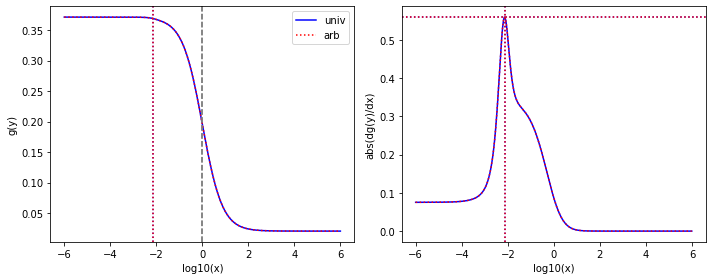

[6.53577e+00 6.53577e+00 4.13592e+00 1.76752e-03 1.00362e-03 1.00362e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.70974e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015355803524297825 0.00015355803524297825
0.00015300416018311538 0.0001530041601831154
0.7326711313280607 0.7326711313280607
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 253736142529.36154
From univ parameters, position and steepness are: 0.9900752949113051 0.5500244860160967 0.8660087995494636
From arb parameters, position and steepness are: 0.9900752949113051 0.5500244860160967 0.8660087995494636


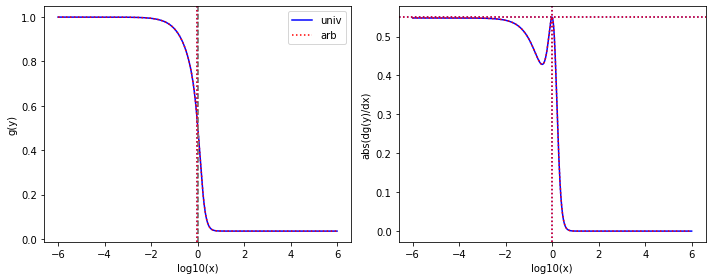

[1.00000e+03 2.11542e-03 1.20253e-02 2.62050e-03 2.20564e-03 1.00000e-03
 4.67876e+02 1.00000e-03 2.81785e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.20253e-05 1.20253e-05
2.20564e-06 2.20564e-06
0.46787599999999996 0.467876
2.81785e-06 2.81785e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 874463692529802.0
From univ parameters, position and steepness are: 3.424584332314859e-06 0.5658004626667464 166040.04550881445
From arb parameters, position and steepness are: 3.4245843323148575e-06 0.5658004626667464 166040.04550881448


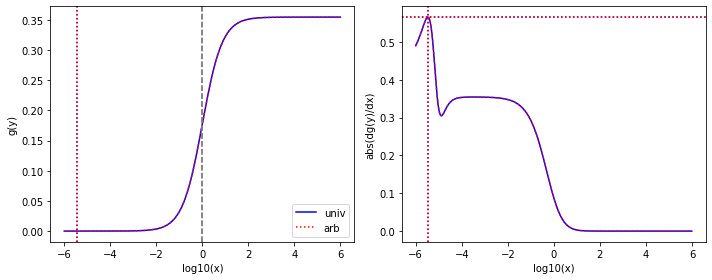

[6.53577e+00 6.53577e+00 4.13592e+00 3.32751e-03 1.05412e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 7.63348e-02]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00016128474533222558 0.00016128474533222558
0.00015300416018311538 0.00015300416018311538
0.7326711313280607 0.7326711313280606
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 266503614287.01727
From univ parameters, position and steepness are: 0.9875652191558805 0.5677529794594788 0.874995923534214
From arb parameters, position and steepness are: 0.9875652191558805 0.5677529794594788 0.874995923534214


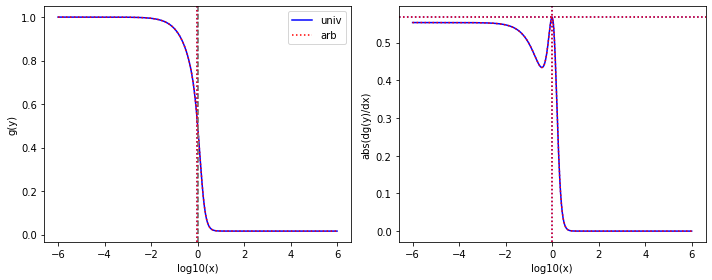

[7.30019e+02 1.00000e-03 1.57276e-03 1.00000e-03 8.44178e-03 1.00000e-03
 5.04204e+02 1.00000e-03 2.88605e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.1544096797480615e-06 2.1544096797480615e-06
1.1563781216653265e-05 1.1563781216653265e-05
0.6906724345530733 0.6906724345530733
3.953390254226259e-06 3.953390254226259e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 239331000293848.12
From univ parameters, position and steepness are: 4.469487941425607e-06 0.5792386962249396 174703.21530762888
From arb parameters, position and steepness are: 4.469487941425608e-06 0.5792386962249396 174703.21530762885


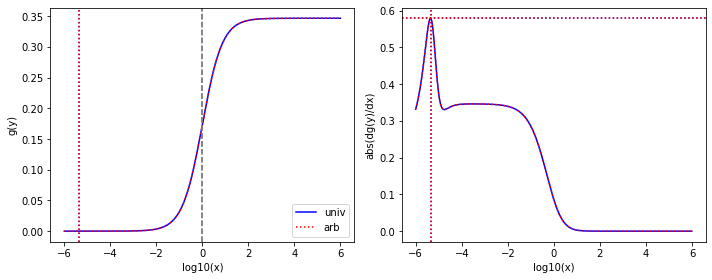

[6.53577e+00 6.53577e+00 4.13592e+00 1.76752e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 5.33485e-02]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.0001530041601831154
0.7326711313280607 0.7326711313280607
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9870106429438906 0.5719295333571895 0.8769237383542339
From arb parameters, position and steepness are: 0.9870106429438906 0.5719295333571895 0.8769237383542339


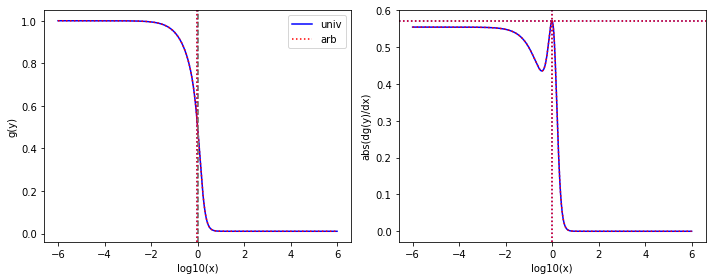

[1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 2.21921e+02 2.21921e+02 1.29218e-01 7.23100e-02]
found K1
found pairwise
found triplewise
1.0 1.0
1.0 1.0
221921.0 221921.0
129.218 129.218
# maximal error is 0.0
min-max are 3.529814346881038e-10 1652381363740746.5
From univ parameters, position and steepness are: 1.2202222801914126e-05 0.5851022670108956 1717.415534852803
From arb parameters, position and steepness are: 1.2202222801914126e-05 0.5851022670108955 1717.415534852803


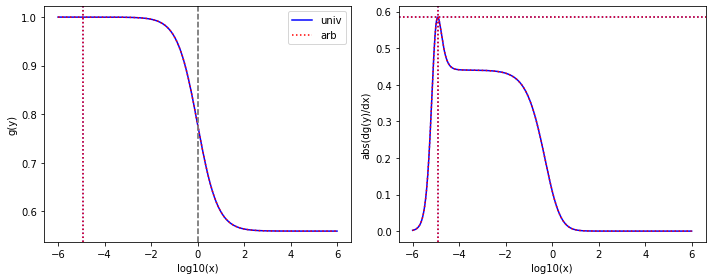

[6.53577e+00 6.53577e+00 4.13592e+00 3.22661e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.00000e-03]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.0001530041601831154
0.7326711313280607 0.7326711313280607
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.985590961901446 0.5818357700747484 0.8817476268999991
From arb parameters, position and steepness are: 0.985590961901446 0.5818357700747483 0.8817476268999991


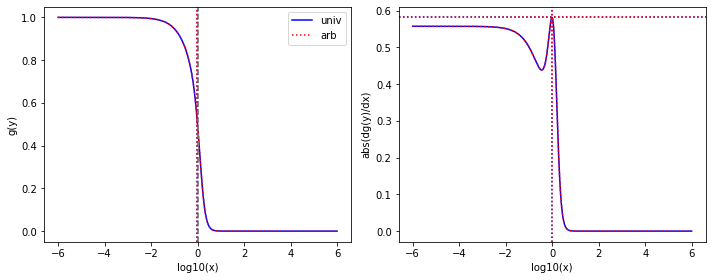

[9.42824e+02 1.15906e-03 1.13864e-01 4.41835e-03 1.00000e-03 1.00000e-03
 2.98461e+02 1.00000e-03 3.06489e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00012076909370147558 0.00012076909370147558
1.0606433438266316e-06 1.0606433438266316e-06
0.31656067304184027 0.3165606730418403
3.2507551780608044e-06 3.250755178060805e-06
# maximal error is 5.551115123125783e-17
min-max are 7.027031419536454e-09 2677709389.7372007
From univ parameters, position and steepness are: 7.499308256195056e-06 0.5989525085536552 97379.39020569649
From arb parameters, position and steepness are: 7.499308256195055e-06 0.5989525085536553 97379.3902056965


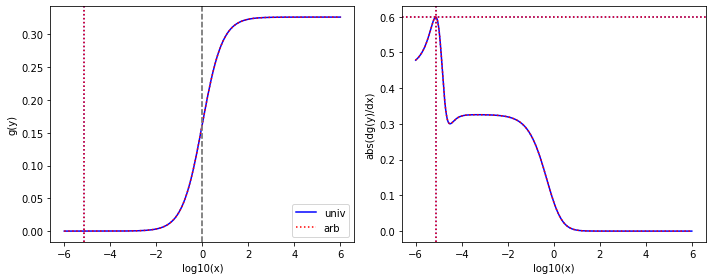

[6.53577e+00 6.53577e+00 3.99940e+00 3.22661e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.00000e-03]
found K1
found pairwise
found triplewise
0.6119248382363516 0.6119248382363516
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311538
0.7326711313280607 0.7326711313280607
# maximal error is 0.0
min-max are 3.529814346881038e-10 252820936256.34735
From univ parameters, position and steepness are: 0.9827808803365001 0.5925492175336655 0.8887175422887716
From arb parameters, position and steepness are: 0.9827808803365001 0.5925492175336656 0.8887175422887718


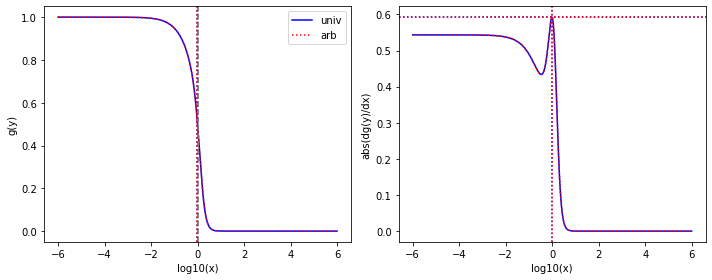

[1.00000e+03 1.00000e+03 8.02056e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.63029e+02 4.63029e+02 6.69014e-02 3.56769e-02]
found K1
found pairwise
found triplewise
8.02056e-06 8.02056e-06
1e-06 1e-06
0.463029 0.463029
6.69014e-05 6.69014e-05
# maximal error is 0.0
min-max are 2.498058915578641e-10 1935936653868769.0
From univ parameters, position and steepness are: 0.00023522776143077045 0.6059028793734608 6921.065929069379
From arb parameters, position and steepness are: 0.00023522776143077042 0.6059028793734609 6921.065929069379


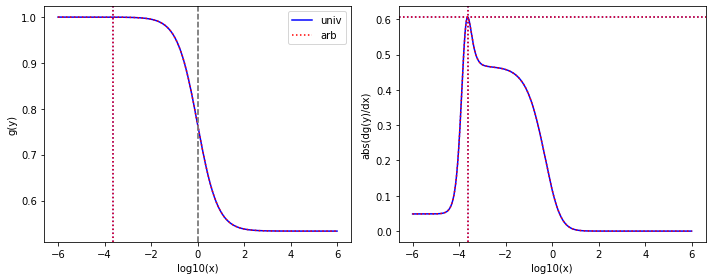

[6.53577e+00 6.53577e+00 4.13592e+00 2.85118e-03 1.00000e-03 1.00000e-03
 1.19168e-03 1.00000e-03 6.36767e+00 2.64608e-02]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00018233199760701494 0.00018233199760701494
0.9742800006732183 0.9742800006732183
# maximal error is 0.0
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9801332173711489 0.6008248389017551 0.8330957268624997
From arb parameters, position and steepness are: 0.9801332173711489 0.6008248389017551 0.8330957268624997


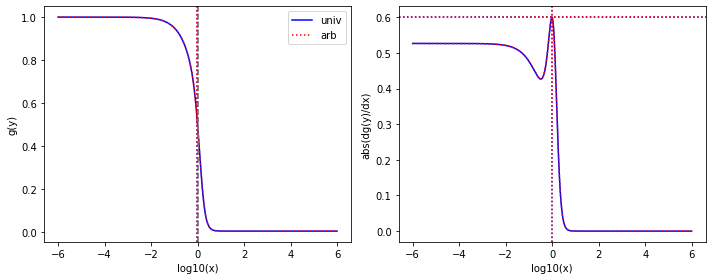

[1.91470e+02 2.62312e+01 1.00000e-03 1.00000e-03 1.47947e+02 1.84304e-02
 1.00000e+03 1.65495e+02 4.58116e+01 1.00000e-03]
found K1
found pairwise
found triplewise
5.222750300308142e-06 5.222750300308142e-06
0.7726902386796888 0.7726902386796888
5.222750300308142 5.222750300308142
0.2392625476575965 0.23926254765759652
# maximal error is 2.7755575615628914e-17
min-max are 2.498058915578641e-10 6.27560950821241e+18
From univ parameters, position and steepness are: 0.006533655363751036 0.6164757085108378 28.95210285541094
From arb parameters, position and steepness are: 0.006533655363751036 0.6164757085108374 28.95210285541093


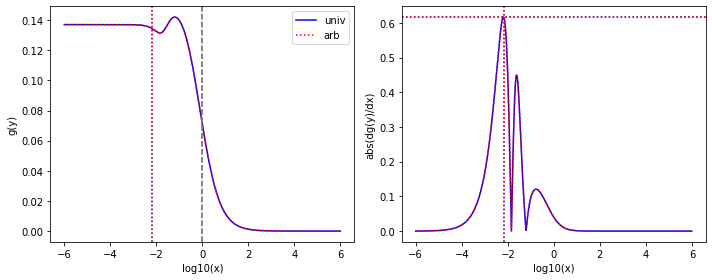

[6.53577e+00 6.53577e+00 4.13592e+00 3.22661e-03 1.05412e-03 1.00000e-03
 1.00000e-03 1.00000e-03 8.91249e+00 1.70974e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00016128474533222558 0.00016128474533222558
0.00015300416018311538 0.00015300416018311538
1.363648047590414 1.363648047590414
# maximal error is 0.0
min-max are 3.529814346881038e-10 266503614287.01727
From univ parameters, position and steepness are: 0.9749683987264672 0.6129289390573651 0.7748080923342565
From arb parameters, position and steepness are: 0.9749683987264672 0.6129289390573651 0.7748080923342565


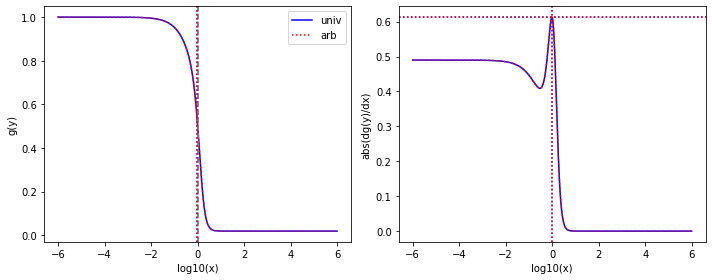

[4.13403e+01 6.70745e+00 2.13018e-03 1.00000e-03 1.52888e-03 1.00000e-03
 1.00000e+03 1.55815e+02 3.01864e+01 1.81266e-01]
found K1
found pairwise
found triplewise
5.1527927954078714e-05 5.1527927954078714e-05
3.6982798866965166e-05 3.6982798866965166e-05
24.189471290726 24.189471290726
0.7301930561703712 0.7301930561703712
# maximal error is 0.0
min-max are 2.498058915578641e-10 2637828427285860.5
From univ parameters, position and steepness are: 0.009780543565916618 0.6216123109887195 30.39894032910475
From arb parameters, position and steepness are: 0.009780543565916617 0.6216123109887207 30.39894032910475


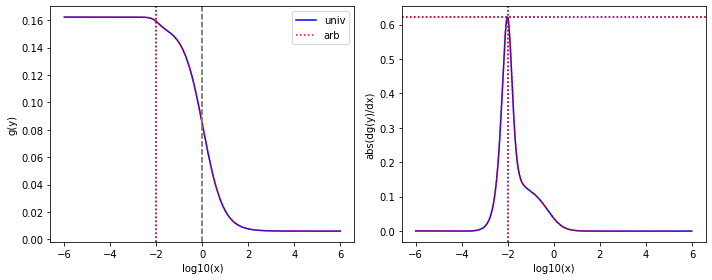

[6.53577e+00 6.53577e+00 4.13592e+00 3.22661e-03 1.00000e-03 1.00000e-03
 1.82781e-03 1.00000e-03 9.90965e+00 1.70974e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.0002796625340243001 0.0002796625340243001
1.516217675958609 1.516217675958609
# maximal error is 0.0
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9724733345024156 0.6226756884596585 0.7591525744330556
From arb parameters, position and steepness are: 0.9724733345024156 0.6226756884596585 0.7591525744330556


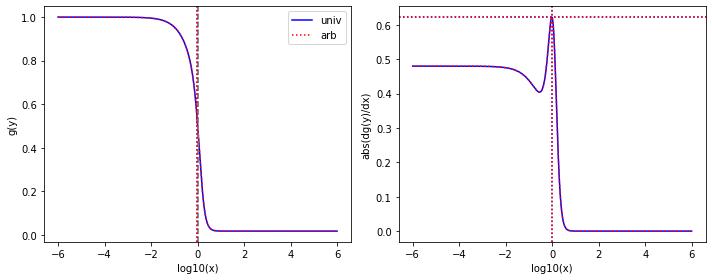

[6.57064e+02 3.61260e-01 1.12124e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.65198e+02 1.00000e-03 3.49177e-01 2.14904e-01]
found K1
found pairwise
found triplewise
1.7064395553553383e-06 1.7064395553553383e-06
1.5219217610461083e-06 1.5219217610461083e-06
0.7079949593951275 0.7079949593951275
0.000531420074756797 0.000531420074756797
# maximal error is 0.0
min-max are 2.498058915578641e-10 1873378053754542.5
From univ parameters, position and steepness are: 0.001995004942754931 0.6369300422526611 1334.444355615013
From arb parameters, position and steepness are: 0.0019950049427549313 0.636930042252661 1334.4443556150127


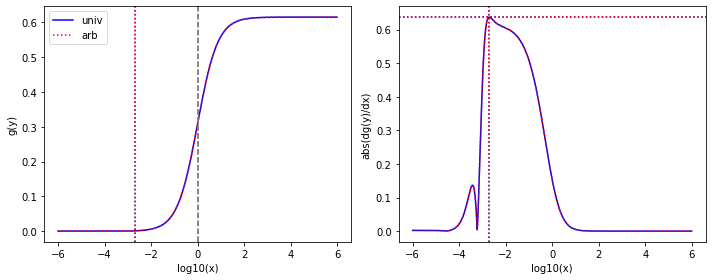

[6.53577e+00 6.53577e+00 4.13592e+00 1.00000e-03 1.34734e-03 1.00000e-03
 1.02068e-03 1.00000e-03 1.07894e+01 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00020614862518111867 0.00020614862518111867
0.0001561682862157022 0.00015616828621570222
1.650823085879705 1.6508230858797053
# maximal error is 2.220446049250313e-16
min-max are 3.529814346881038e-10 340635853272.7561
From univ parameters, position and steepness are: 0.9705726763596714 0.6302805923350008 0.74656493454184
From arb parameters, position and steepness are: 0.9705726763596714 0.6302805923350008 0.74656493454184


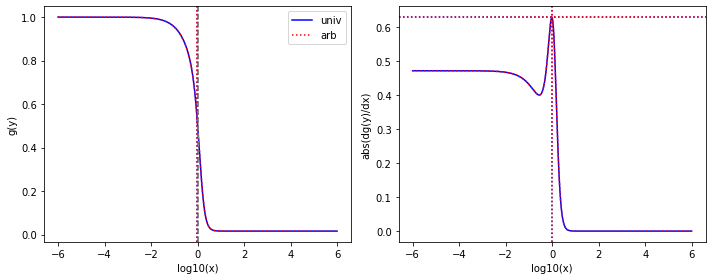

[1.00000e+03 1.02140e-03 2.65341e-03 1.00000e-03 7.42602e+00 1.00000e-03
 2.98461e+02 1.00000e-03 2.52081e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.65341e-06 2.65341e-06
0.00742602 0.007426019999999999
0.29846100000000003 0.29846100000000003
2.52081e-06 2.52081e-06
# maximal error is 8.673617379884035e-19
min-max are 2.498058915578641e-10 6.031228651475439e+16
From univ parameters, position and steepness are: 1.138601475286676e-05 0.6489926856757486 118397.48254645054
From arb parameters, position and steepness are: 1.1386014752866755e-05 0.6489926856757486 118397.48254645058


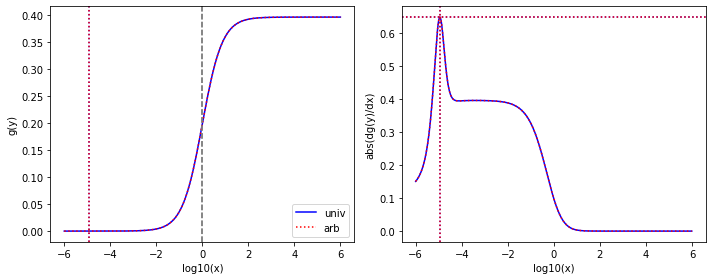

[6.53577e+00 6.53577e+00 1.09023e+01 3.18815e-03 1.18338e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.87444e+02 1.00000e-03]
found K1
found pairwise
found triplewise
1.6680972555643787 1.6680972555643787
0.00018106206307749506 0.00018106206307749506
0.00015300416018311538 0.00015300416018311538
74.58095985629849 74.58095985629849
# maximal error is 0.0
min-max are 3.529814346881038e-10 299182960725.8466
From univ parameters, position and steepness are: 0.9700082776082873 0.640002720652189 0.28876920144007845
From arb parameters, position and steepness are: 0.9700082776082873 0.640002720652189 0.28876920144007845


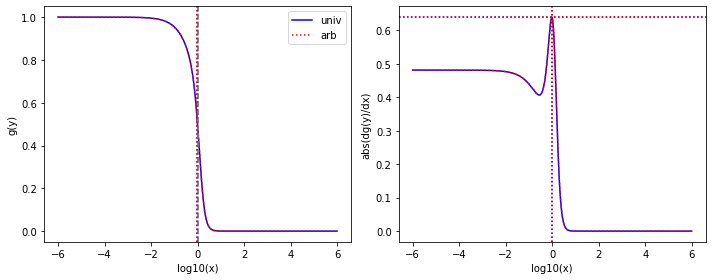

[6.75384e-02 1.37983e-03 1.00000e-03 1.00000e-03 1.17600e-02 1.17600e-02
 1.00000e+03 1.25503e+01 5.49857e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.014806391623135877 0.014806391623135878
0.17412316548807788 0.1741231654880779
14806.391623135876 14806.391623135874
814.1398078722623 814.1398078722623
# maximal error is 1.8189894035458565e-12
min-max are 3.529814346881038e-10 287717873619850.9
From univ parameters, position and steepness are: 0.008263871663934145 0.6528882800432039 4.074318551845353
From arb parameters, position and steepness are: 0.008263871663934151 0.6528882800432034 4.07431855184535


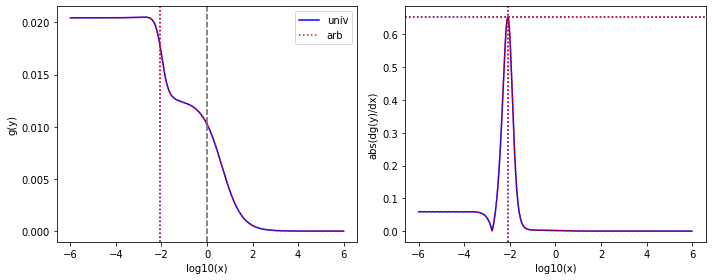

[6.53577e+00 6.53577e+00 4.13592e+00 1.66106e-03 1.00000e-03 1.00000e-03
 1.13458e-03 1.00000e-03 1.48982e+01 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00017359546006055903 0.00017359546006055903
2.279486579240089 2.279486579240089
# maximal error is 0.0
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9634416660678861 0.6579863581953302 0.7000019008140456
From arb parameters, position and steepness are: 0.9634416660678861 0.6579863581953302 0.7000019008140456


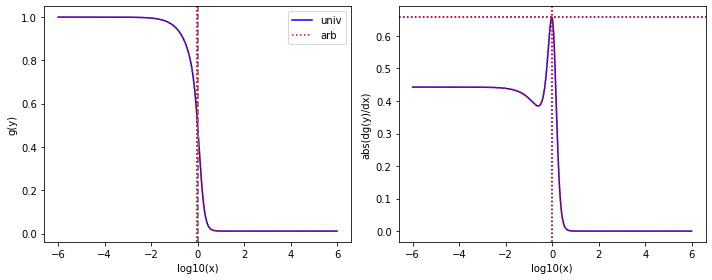

[1.62761e+00 4.83762e-03 1.58095e+00 1.00000e-03 1.26494e+01 9.23223e-02
 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.9713321987453998 0.9713321987453998
7.771763505999594 7.771763505999594
0.0006143977979982919 0.0006143977979982919
0.0006143977979982919 0.0006143977979982918
# maximal error is 1.0842021724855044e-19
min-max are 7.027031419536454e-09 1.2841917183488974e+16
From univ parameters, position and steepness are: 0.0021239268602682884 0.6693460218170172 111.54156115851035
From arb parameters, position and steepness are: 0.0021239268602682884 0.6693460218170172 111.54156115851035


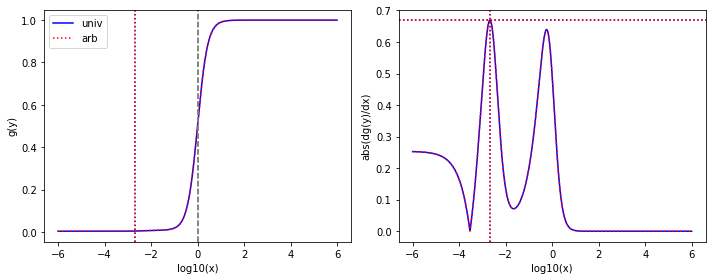

[6.53577e+00 6.53577e+00 4.13592e+00 2.32416e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 1.61912e+01 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.0001530041601831154
2.477320958356857 2.4773209583568567
# maximal error is 4.440892098500626e-16
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9616720706507044 0.6648510447950761 0.6882506765579399
From arb parameters, position and steepness are: 0.9616720706507044 0.6648510447950761 0.68825067655794


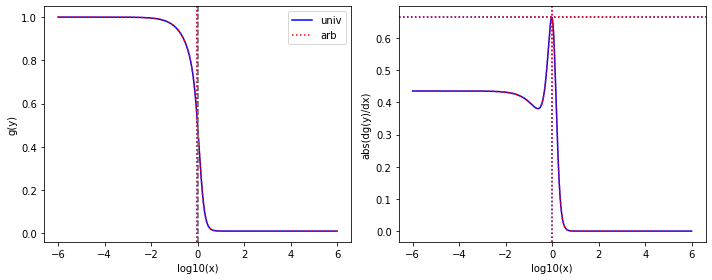

[1.00000e+03 9.72130e+00 2.05713e-02 1.00000e-03 8.10290e-01 1.00000e-03
 6.12686e+02 2.47762e-03 4.87743e+00 1.20694e+00]
found K1
found pairwise
found triplewise
2.05713e-05 2.05713e-05
0.00081029 0.00081029
0.6126860000000001 0.6126860000000001
0.00487743 0.00487743
# maximal error is 0.0
min-max are 2.498058915578641e-10 6580099727568532.0
From univ parameters, position and steepness are: 0.006421613014793463 0.6721997417677019 130.62041710111112
From arb parameters, position and steepness are: 0.006421613014793461 0.6721997417677021 130.62041710111114


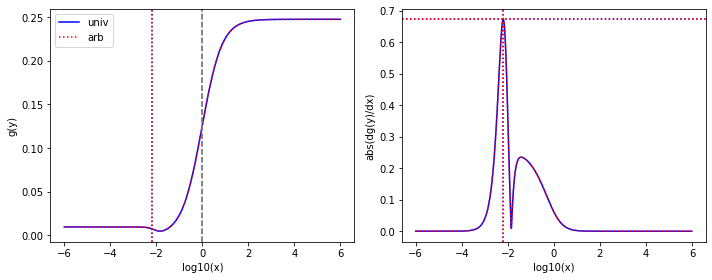

[6.53577e+00 6.53577e+00 4.13592e+00 3.22661e-03 1.00000e-03 1.00000e-03
 1.23612e-03 1.00000e-03 1.73255e+01 1.70974e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00018913150248555259 0.0001891315024855526
2.6508735772525656 2.6508735772525656
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9602552055950904 0.6702917748972259 0.6787658870676025
From arb parameters, position and steepness are: 0.9602552055950904 0.6702917748972259 0.6787658870676025


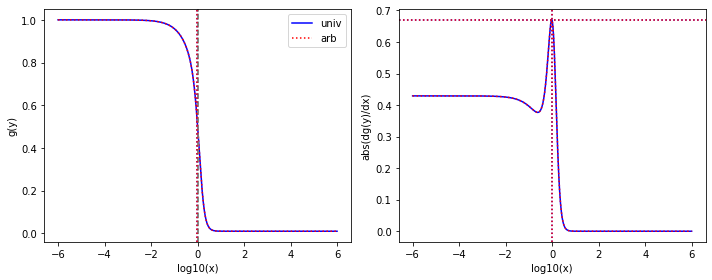

[7.01730e+01 8.43577e-01 1.00000e-03 1.00000e-03 2.41209e+01 5.81788e-03
 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.4250495204708363e-05 1.4250495204708363e-05
0.34373476978324996 0.34373476978324996
1.4250495204708363e-05 1.4250495204708361e-05
1.4250495204708363e-05 1.4250495204708364e-05
# maximal error is 1.6940658945086007e-21
min-max are 2.360183595459028e-10 2.791732940863156e+18
From univ parameters, position and steepness are: 0.006251959822064865 0.6859471030162195 155.18399705795903
From arb parameters, position and steepness are: 0.006251959822064865 0.6859471030162195 155.18399705795903


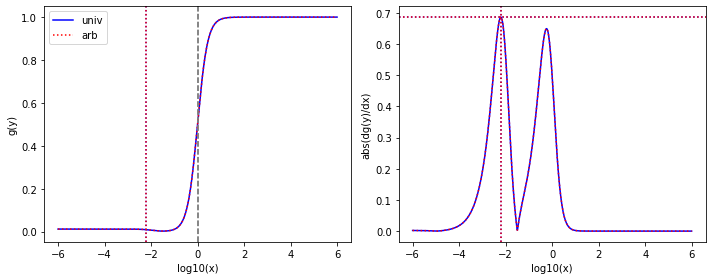

[6.53577e+00 6.53577e+00 4.13592e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 2.00555e+01 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.0001530041601831154
3.06857493455247 3.0685749345524704
# maximal error is 4.440892098500626e-16
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9573634320880169 0.6817696507226187 0.6583844675750301
From arb parameters, position and steepness are: 0.957363432088017 0.6817696507226187 0.6583844675750301


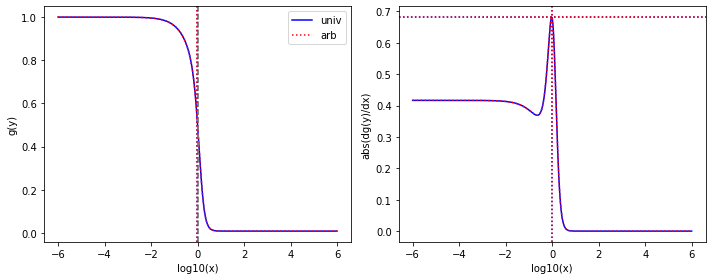

[9.63519e+01 1.80806e-03 1.00000e-03 1.00000e-03 3.41014e+00 1.00000e-03
 4.65198e+02 1.00000e-03 9.97852e-03 6.98748e-03]
found K1
found pairwise
found triplewise
1.0378622528460777e-05 1.0378622528460777e-05
0.03539255582920524 0.03539255582920524
4.828114442994897 4.828114442994897
0.00010356329247269644 0.00010356329247269646
# maximal error is 2.710505431213761e-20
min-max are 2.498058915578641e-10 2.8744962878401843e+17
From univ parameters, position and steepness are: 0.00039673262093097277 0.6994475897326803 46622.15940550934
From arb parameters, position and steepness are: 0.00039673262093097277 0.6994475897326802 46622.15940550934


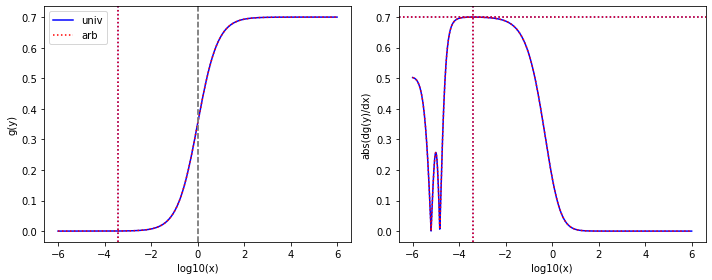

[6.53577e+00 6.53577e+00 4.13592e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.35778e-03 1.00000e-03 2.28623e+01 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.0002077459886134304 0.0002077459886134304
3.4980270113544387 3.4980270113544387
# maximal error is 0.0
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9548124201879377 0.6918151451482412 0.6405473329171656
From arb parameters, position and steepness are: 0.9548124201879377 0.6918151451482412 0.6405473329171656


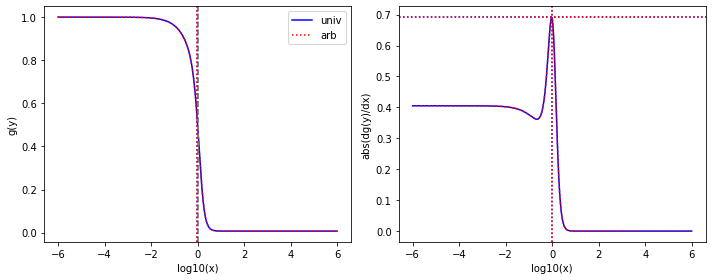

[4.92861e+02 8.06940e-01 1.53604e-01 1.00000e-03 1.00000e+03 1.00000e-03
 1.25839e+00 1.25839e+00 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00031165785079363147 0.00031165785079363147
2.028969628353633 2.028969628353633
0.002553235090623928 0.002553235090623928
2.028969628353633e-06 2.028969628353633e-06
# maximal error is 0.0
min-max are 3.529814346881038e-10 3352631602221464.0
From univ parameters, position and steepness are: 0.007175946662701653 0.700181899612575 553.3482085202304
From arb parameters, position and steepness are: 0.007175946662701652 0.700181899612575 553.3482085202305


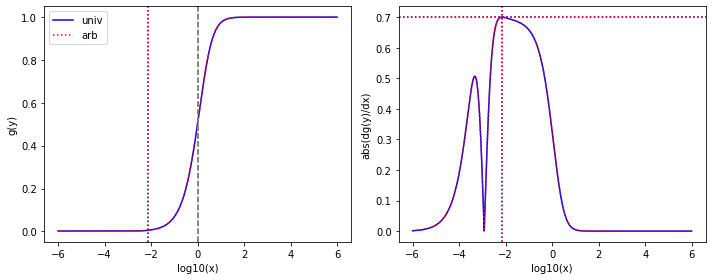

[6.53577e+00 6.53577e+00 4.13592e+00 1.00000e-03 1.37187e-03 1.00000e-03
 1.00000e-03 1.00000e-03 2.65800e+01 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.0002099018172304105 0.0002099018172304105
0.00015300416018311538 0.00015300416018311538
4.066850577667206 4.066850577667207
# maximal error is 8.881784197001252e-16
min-max are 3.529814346881038e-10 346837557871.0788
From univ parameters, position and steepness are: 0.951982561040485 0.7030476104626975 0.6204314365245669
From arb parameters, position and steepness are: 0.951982561040485 0.7030476104626975 0.6204314365245669


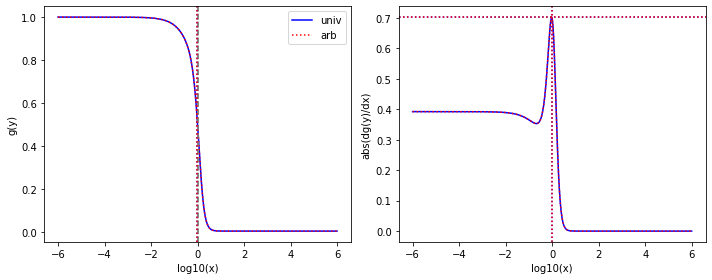

[1.00000e+03 2.45596e-02 9.10477e-03 9.10477e-03 3.23863e+02 7.32272e-03
 6.05466e-01 6.05466e-01 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
9.10477e-06 9.10477e-06
0.323863 0.323863
0.0006054659999999999 0.000605466
1e-06 1e-06
# maximal error is 1.0842021724855044e-19
min-max are 2.498058915578641e-10 2.6303392875243146e+18
From univ parameters, position and steepness are: 0.008855883506496 0.7183884592478403 341.8754555830843
From arb parameters, position and steepness are: 0.008855883506495998 0.7183884592478403 341.8754555830843


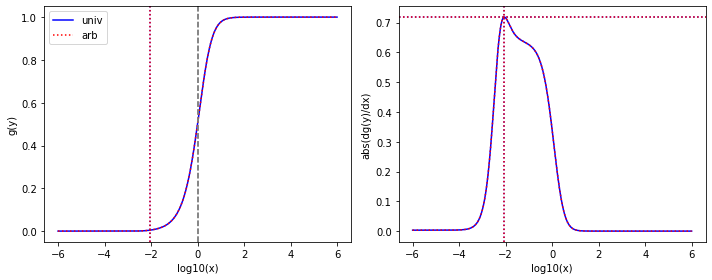

[6.53577e+00 6.53577e+00 4.13592e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 2.93986e+01 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.0001530041601831154
4.4981081035593355 4.4981081035593355
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9501500388727974 0.7103929343571064 0.6072280866919095
From arb parameters, position and steepness are: 0.9501500388727974 0.7103929343571064 0.6072280866919095


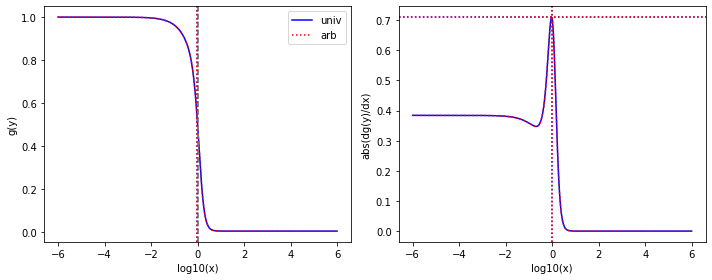

[6.55842e+02 3.50335e-03 1.00000e-03 1.00000e-03 4.19608e+00 3.28727e-03
 4.65198e+02 1.00000e-03 2.73190e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.5247574873216415e-06 1.5247574873216415e-06
0.006398004397400594 0.006398004397400594
0.709314133587053 0.7093141335870529
4.165484979613993e-06 4.165484979613994e-06
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 5.196303242126711e+16
From univ parameters, position and steepness are: 2.8473444291022207e-06 0.7297282577562602 170286.66432335906
From arb parameters, position and steepness are: 2.8473444291022216e-06 0.7297282577562603 170286.66432335903


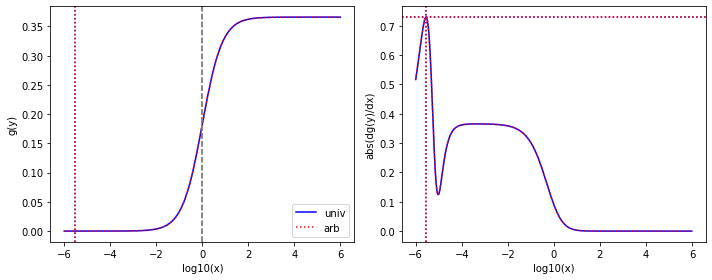

[6.53577e+00 6.53577e+00 2.26152e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.39055e-01]
found K1
found pairwise
found triplewise
0.3460219683373191 0.3460219683373191
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311535
0.7326711313280607 0.7326711313280607
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 252821019687.44757
From univ parameters, position and steepness are: 0.9425132991276605 0.7259339554693969 0.9687622990219228
From arb parameters, position and steepness are: 0.9425132991276605 0.7259339554693969 0.9687622990219228


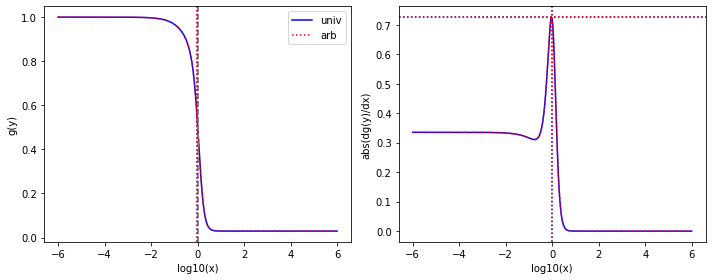

[1.00000e+03 1.75998e-03 1.00000e-03 1.00000e-03 1.33835e-02 1.00000e-03
 2.98461e+02 1.00000e-03 2.08101e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1.33835e-05 1.33835e-05
0.29846100000000003 0.29846100000000003
2.08101e-06 2.08101e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 108654603227934.66
From univ parameters, position and steepness are: 9.570442655634688e-06 0.7384752094529596 143420.27394647957
From arb parameters, position and steepness are: 9.570442655634684e-06 0.7384752094529595 143420.2739464796


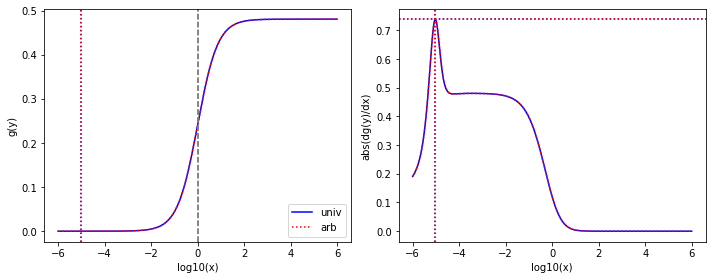

[6.53577e+00 6.53577e+00 2.15229e+00 1.35444e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.69560e-01]
found K1
found pairwise
found triplewise
0.32930932392051737 0.32930932392051737
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311535
0.7326711313280607 0.7326711313280607
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 252821024931.29587
From univ parameters, position and steepness are: 0.9400581340585265 0.7315730509958646 0.973023360265873
From arb parameters, position and steepness are: 0.9400581340585265 0.7315730509958646 0.973023360265873


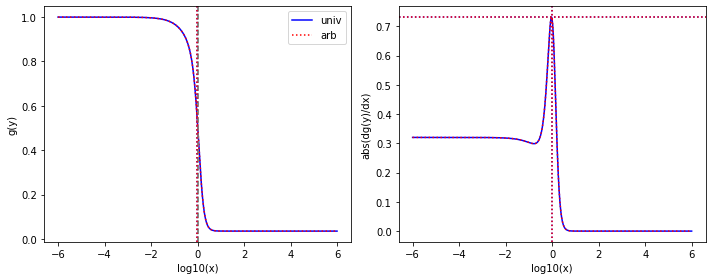

[2.15380e-03 1.00000e-03 1.00000e-03 1.00000e-03 4.59927e-02 4.59927e-02
 1.00000e+03 4.78530e+02 1.00000e+03 1.61676e-02]
found K1
found pairwise
found triplewise
0.46429566347850315 0.46429566347850315
21.35421116166775 21.35421116166775
464295.6634785031 464295.66347850306
464295.6634785031 464295.6634785032
# maximal error is 5.820766091346741e-11
min-max are 3.529814346881038e-10 3.528530056940582e+16
From univ parameters, position and steepness are: 0.006862299554954031 0.7463674611350165 1.0317223483303084
From arb parameters, position and steepness are: 0.006862299554954034 0.7463674611350171 1.0317223483303084


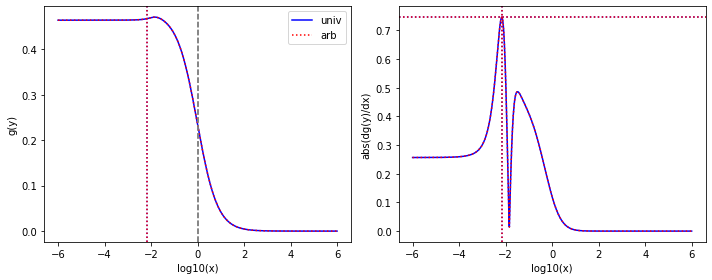

[6.53577e+00 6.53577e+00 4.13592e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.35778e-03 1.00000e-03 5.13777e+01 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.0002077459886134304 0.0002077459886134304
7.861001840640046 7.8610018406400455
# maximal error is 8.881784197001252e-16
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9408076831618863 0.7485989668414349 0.5378081576005864
From arb parameters, position and steepness are: 0.9408076831618863 0.7485989668414349 0.5378081576005864


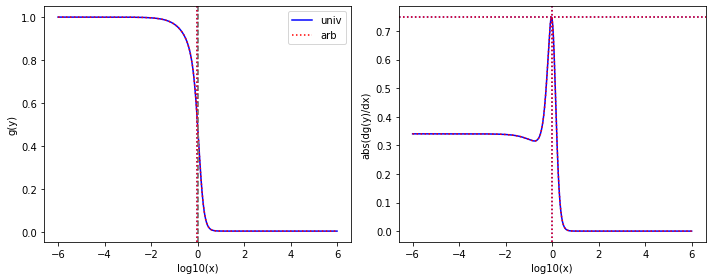

[4.13403e+01 1.50794e+01 1.22475e-03 1.00000e-03 8.99842e+00 1.00000e-03
 1.00000e+03 3.70198e+02 1.85000e+01 6.00185e-01]
found K1
found pairwise
found triplewise
2.9626054963316664e-05 2.9626054963316664e-05
0.21766702225189463 0.21766702225189466
24.189471290726 24.189471290726
0.447505218878431 0.447505218878431
# maximal error is 2.7755575615628914e-17
min-max are 2.498058915578641e-10 1.7678394634408686e+18
From univ parameters, position and steepness are: 0.00275764532682295 0.7560745158917388 55.8118254255923
From arb parameters, position and steepness are: 0.0027576453268229493 0.756074515891739 55.81182542559231


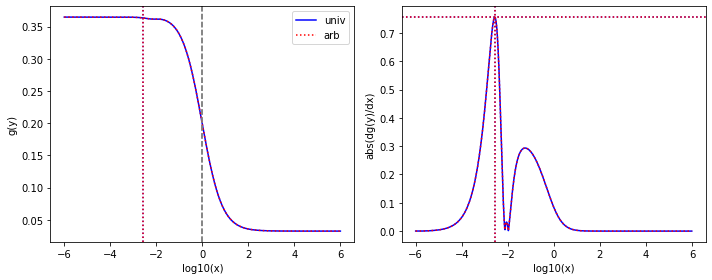

[6.53577e+00 6.53577e+00 4.13592e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 5.31076e+01 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.0001530041601831154
8.125683737340818 8.125683737340818
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9402955192084651 0.7507451926483386 0.5338948119323856
From arb parameters, position and steepness are: 0.9402955192084651 0.7507451926483386 0.5338948119323856


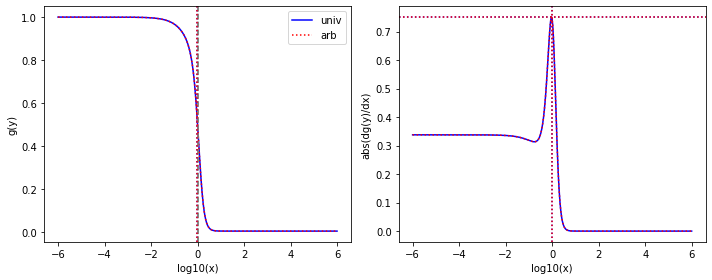

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 2.98461e+02 1.00000e-03 2.15706e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1e-06 1e-06
0.29846100000000003 0.2984610000000001
2.1570600000000002e-06 2.1570600000000002e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 1201139774802516.8
From univ parameters, position and steepness are: 9.72591605737753e-06 0.7692992490509145 138363.31555269152
From arb parameters, position and steepness are: 9.725916057377527e-06 0.7692992490509144 138363.31555269155


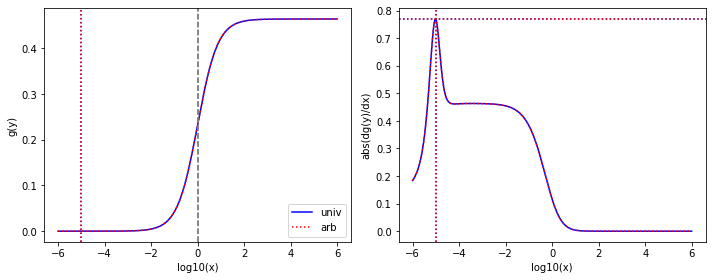

[6.53577e+00 6.53577e+00 1.89516e+00 3.61042e-03 1.00362e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.70974e-01]
found K1
found pairwise
found triplewise
0.2899673642126329 0.2899673642126329
0.00015355803524297825 0.00015355803524297825
0.00015300416018311538 0.0001530041601831154
0.7326711313280607 0.7326711313280606
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 253736250102.42303
From univ parameters, position and steepness are: 0.9327391445386335 0.760381956416589 0.9865924104066071
From arb parameters, position and steepness are: 0.9327391445386335 0.760381956416589 0.9865924104066071


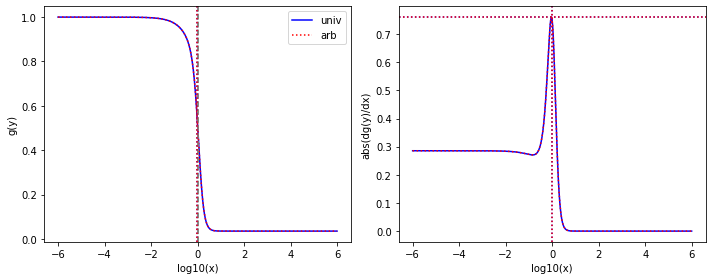

[1.25820e+00 1.00000e-03 2.95224e-03 1.00000e-03 1.28028e+01 1.88871e-02
 1.28002e-01 1.28002e-01 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0023463996185026227 0.0023463996185026227
10.175488793514544 10.175488793514544
0.10173422349388016 0.10173422349388016
0.0007947862025115244 0.0007947862025115245
# maximal error is 1.0842021724855044e-19
min-max are 3.529814346881038e-10 1.6813788053416838e+16
From univ parameters, position and steepness are: 0.006901602112677597 0.7701105685342906 65.92896142589765
From arb parameters, position and steepness are: 0.006901602112677599 0.7701105685342907 65.92896142589765


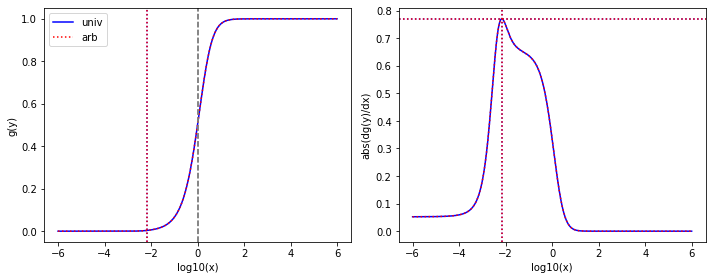

[6.53577e+00 6.53577e+00 4.13592e+00 3.22661e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 7.48589e+01 1.70974e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.0001530041601831154
11.453723126731816 11.453723126731814
# maximal error is 1.7763568394002505e-15
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9351849029241657 0.7723328256671573 0.4947121602826549
From arb parameters, position and steepness are: 0.9351849029241657 0.7723328256671573 0.4947121602826549


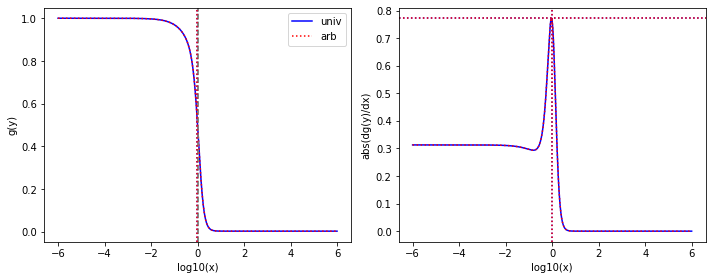

[9.49644e+01 1.00000e-03 1.00000e-03 1.00000e-03 1.52380e+01 3.52195e-03
 2.88184e+02 1.00000e-03 8.33781e-03 3.50320e-03]
found K1
found pairwise
found triplewise
1.0530261866552098e-05 1.0530261866552098e-05
0.16046013032252085 0.16046013032252085
3.03465298575045 3.03465298575045
8.779932269355674e-05 8.779932269355672e-05
# maximal error is 1.3552527156068805e-20
min-max are 2.498058915578641e-10 1.3032192651342277e+18
From univ parameters, position and steepness are: 8.555497014302358e-06 0.7851790144341232 34564.7269255854
From arb parameters, position and steepness are: 8.555497014302356e-06 0.7851790144341233 34564.7269255854


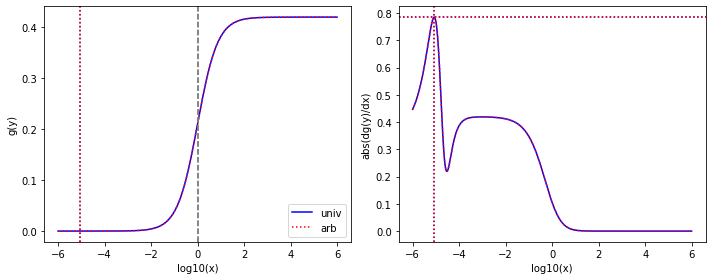

[6.53577e+00 6.53577e+00 4.13592e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.02068e-03 1.00000e-03 9.32987e+01 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.0001561682862157022 0.00015616828621570222
14.275089239676426 14.275089239676426
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9322083478167921 0.7853372104319741 0.47077680134845834
From arb parameters, position and steepness are: 0.9322083478167921 0.7853372104319741 0.4707768013484583


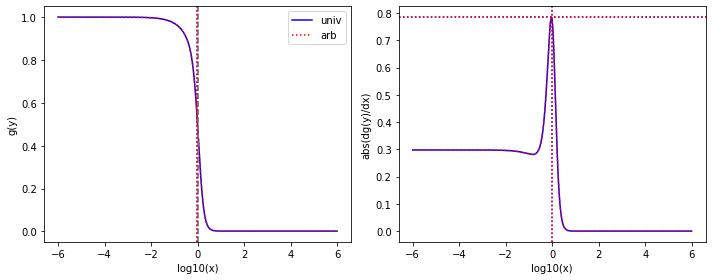

[9.67550e+02 1.00000e-03 2.05520e-03 1.00000e-03 2.28759e+01 2.29877e-02
 4.41163e+02 1.00000e-03 1.36472e-02 1.00000e-03]
found K1
found pairwise
found triplewise
2.1241279520438224e-06 2.1241279520438224e-06
0.023643119218645033 0.023643119218645033
0.4559588651749264 0.4559588651749264
1.4104904139320965e-05 1.4104904139320965e-05
# maximal error is 0.0
min-max are 2.498058915578641e-10 1.9202380328020083e+17
From univ parameters, position and steepness are: 2.159902314993509e-05 0.7971081941828595 32325.227065133506
From arb parameters, position and steepness are: 2.159902314993509e-05 0.7971081941828594 32325.227065133506


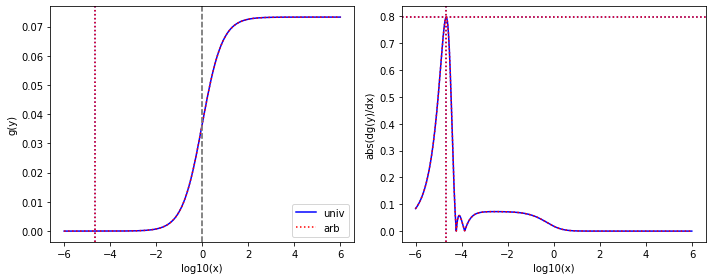

[6.53577e+00 6.53577e+00 4.13592e+00 1.00000e-03 2.12175e-03 1.00000e-03
 1.00000e-03 1.00000e-03 1.02356e+02 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.000324636576868525 0.000324636576868525
0.00015300416018311538 0.00015300416018311538
15.660893819702956 15.660893819702954
# maximal error is 1.7763568394002505e-15
min-max are 3.529814346881038e-10 536423136517.2345
From univ parameters, position and steepness are: 0.9309871071589054 0.7906796735988357 0.4610192379002041
From arb parameters, position and steepness are: 0.9309871071589054 0.7906796735988357 0.4610192379002041


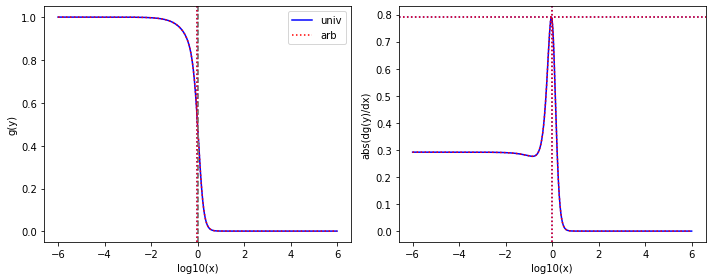

[4.13403e+01 1.48780e+01 4.70378e-02 1.00000e-03 6.94038e-01 7.64179e-02
 1.00000e+03 3.70198e+02 2.19940e+01 4.45717e-01]
found K1
found pairwise
found triplewise
0.0011378195126789112 0.0011378195126789115
0.016788412275672893 0.016788412275672893
24.189471290726 24.189471290726
0.5320232315682276 0.5320232315682276
# maximal error is 2.168404344971009e-19
min-max are 3.529814346881038e-10 27740859482951.45
From univ parameters, position and steepness are: 0.005304083162181861 0.8020691607694382 46.96875252924076
From arb parameters, position and steepness are: 0.00530408316218186 0.8020691607694391 46.96875252924077


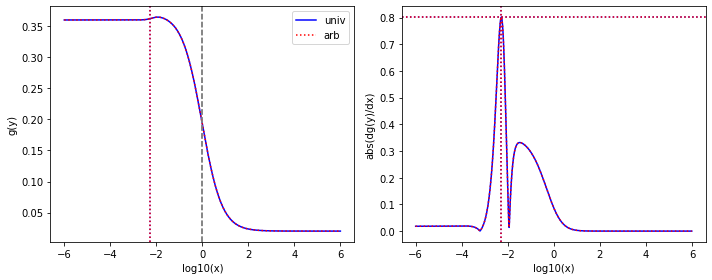

[6.53577e+00 6.53577e+00 1.50269e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.65815e-01]
found K1
found pairwise
found triplewise
0.22991782146556566 0.22991782146556566
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311535
0.7326711313280607 0.7326711313280608
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 252821056116.90286
From univ parameters, position and steepness are: 0.9216810743697754 0.8081745447537596 1.0067193383226247
From arb parameters, position and steepness are: 0.9216810743697754 0.8081745447537596 1.0067193383226247


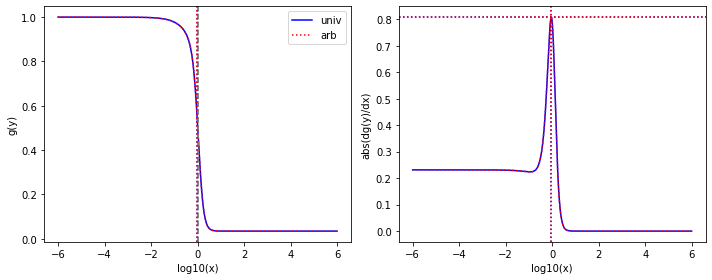

[1.00000e+03 4.69194e-03 2.26435e-03 1.00000e-03 3.46730e-03 1.00000e-03
 4.65198e+02 1.00000e-03 1.22329e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.26435e-06 2.26435e-06
3.4673e-06 3.4673e-06
0.465198 0.465198
1.22329e-06 1.22329e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 538952793415935.8
From univ parameters, position and steepness are: 0.0001876204634795503 0.8170082785534257 380286.68062620284
From arb parameters, position and steepness are: 0.00018762046347955033 0.8170082785534256 380286.6806262028


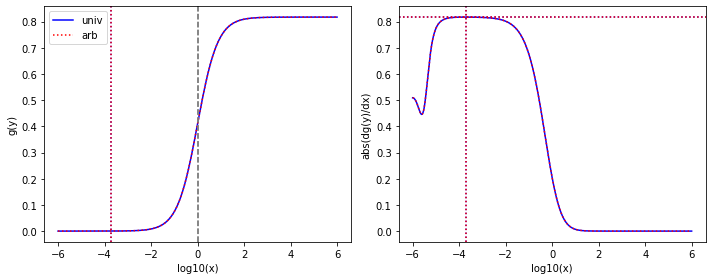

[6.53577e+00 6.53577e+00 4.13592e+00 1.55866e-03 1.04602e-03 1.04602e-03
 1.00000e-03 1.00000e-03 1.68882e+02 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00016004541163474234 0.00016004541163474234
0.00015300416018311538 0.00015300416018311538
25.83964858004489 25.83964858004489
# maximal error is 0.0
min-max are 3.529814346881038e-10 264455762381.33386
From univ parameters, position and steepness are: 0.9248666442272524 0.8181788058766122 0.4112953291618515
From arb parameters, position and steepness are: 0.9248666442272524 0.8181788058766122 0.4112953291618515


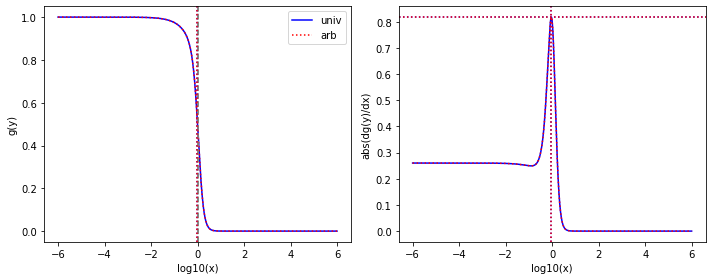

[3.80792e+02 1.00000e-03 1.43915e-03 1.43915e-03 1.63134e-01 1.00000e-03
 3.22455e+02 1.00000e-03 2.28301e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.779359860501271e-06 3.779359860501271e-06
0.0004284071093930545 0.0004284071093930545
0.8468008781697095 0.8468008781697095
5.9954253240614296e-06 5.9954253240614296e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 3479259693839241.0
From univ parameters, position and steepness are: 3.715540472679135e-06 0.8224861719705249 141240.86254910982
From arb parameters, position and steepness are: 3.715540472679134e-06 0.822486171970525 141240.86254910985


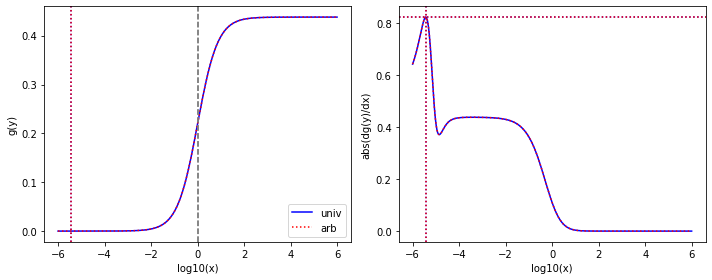

[6.53577e+00 6.53577e+00 4.13592e+00 1.17040e-03 1.22679e-02 1.00000e-03
 1.98539e-03 1.00000e-03 1.84134e+02 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.001877039736710441 0.001877039736710441
0.0003037729295859554 0.0003037729295859554
28.173268031157765 28.173268031157765
# maximal error is 0.0
min-max are 3.529814346881038e-10 3101585187486.315
From univ parameters, position and steepness are: 0.9238903111894242 0.8225247548011729 0.4031594270163861
From arb parameters, position and steepness are: 0.9238903111894242 0.8225247548011729 0.4031594270163861


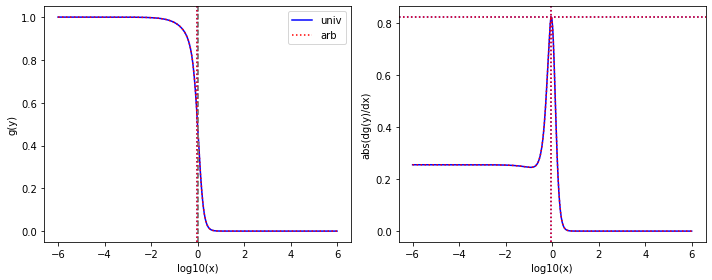

[4.13403e+01 6.70745e+00 7.44017e-03 4.96329e-03 2.68047e-01 1.00000e-03
 1.00000e+03 1.56662e+02 1.80685e+01 3.54419e-01]
found K1
found pairwise
found triplewise
0.00017997377861312086 0.00017997377861312088
0.006483915211065231 0.006483915211065231
24.189471290726 24.189471290726
0.4370674620164827 0.43706746201648267
# maximal error is 5.551115123125783e-17
min-max are 7.027031419536454e-09 10713900566764.373
From univ parameters, position and steepness are: 0.005649599960356051 0.8333562600296587 51.00782031290562
From arb parameters, position and steepness are: 0.005649599960356051 0.83335626002966 51.00782031290561


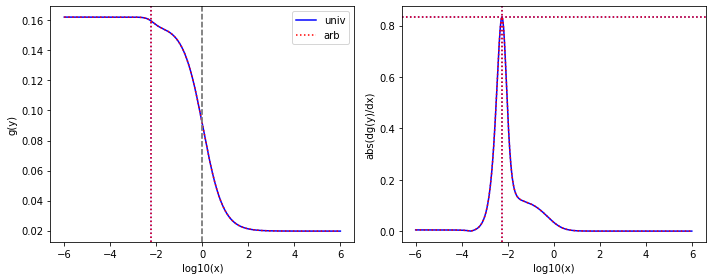

[6.53577e+00 6.53577e+00 4.13592e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 2.13058e+02 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.0001530041601831154
32.59876036029419 32.59876036029419
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9222982055799621 0.8300717541564181 0.3898575449616359
From arb parameters, position and steepness are: 0.9222982055799621 0.8300717541564181 0.3898575449616359


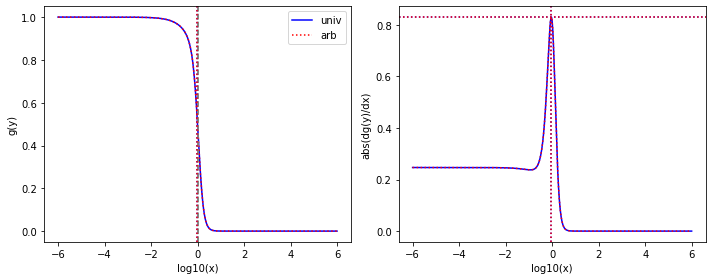

[4.76519e+02 4.76519e+02 2.05656e-03 1.87368e-03 1.00000e-03 1.00000e-03
 1.00000e+03 1.00000e+03 3.58321e-01 1.30587e-01]
found K1
found pairwise
found triplewise
4.315798530593743e-06 4.315798530593743e-06
2.0985522088311273e-06 2.0985522088311273e-06
2.0985522088311273 2.0985522088311273
0.0007519553260205784 0.0007519553260205785
# maximal error is 1.0842021724855044e-19
min-max are 2.498058915578641e-10 4047265004714525.0
From univ parameters, position and steepness are: 0.0003524565638652868 0.8466551228371924 2790.793730706361
From arb parameters, position and steepness are: 0.00035245656386528683 0.8466551228371922 2790.7937307063607


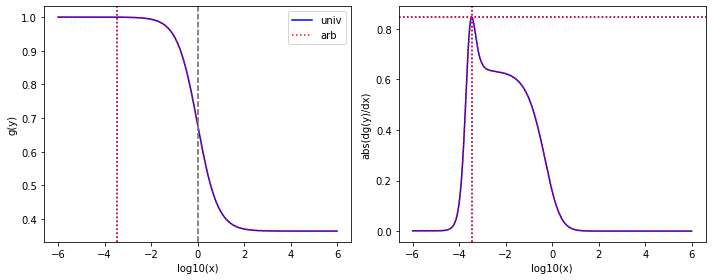

[9.45017e+00 9.45017e+00 7.65055e+00 1.38198e-03 1.82206e-03 1.00000e-03
 5.30451e-03 1.00000e-03 1.00000e+03 1.01534e-02]
found K1
found pairwise
found triplewise
0.8095674469348171 0.8095674469348171
0.0001928071135228255 0.00019280711352282547
0.0005613137118168245 0.0005613137118168246
105.81820221223533 105.81820221223535
# maximal error is 1.4210854715202004e-14
min-max are 3.529814346881038e-10 318590532579.5864
From univ parameters, position and steepness are: 0.9202481262298607 0.8401925029627724 0.2915041702629439
From arb parameters, position and steepness are: 0.9202481262298607 0.8401925029627724 0.2915041702629439


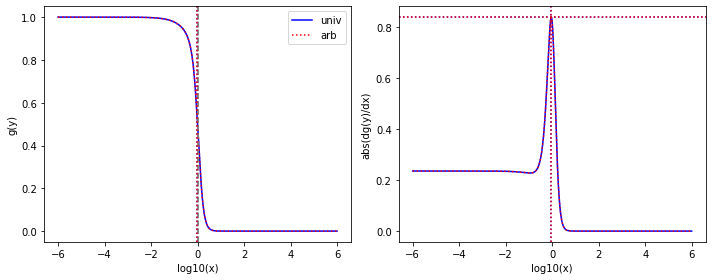

[8.70590e+01 4.74844e-03 4.37328e+00 1.00000e-03 4.00900e-01 4.00900e-01
 4.43150e+02 1.58591e+00 3.23343e+00 2.17430e-01]
found K1
found pairwise
found triplewise
0.05023351979691933 0.05023351979691933
0.004604923098128855 0.004604923098128855
5.090226168460469 5.090226168460469
0.03714067471484855 0.03714067471484853
# maximal error is 1.3877787807814457e-17
min-max are 3.529814346881038e-10 7609089000259.95
From univ parameters, position and steepness are: 0.003461264542519293 0.8524528073549598 122.64652211598586
From arb parameters, position and steepness are: 0.0034612645425192916 0.8524528073549601 122.64652211598589


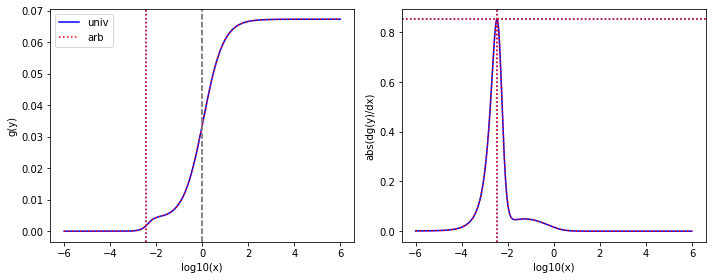

[6.53577e+00 6.53577e+00 1.15561e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.67743e-03 1.00000e-03 4.78857e+00 1.70624e-01]
found K1
found pairwise
found triplewise
0.17681313754920996 0.17681313754920996
0.00015300416018311538 0.00015300416018311538
0.0002566537684159632 0.0002566537684159632
0.7326711313280607 0.7326711313280608
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 252821072779.31122
From univ parameters, position and steepness are: 0.9119542500589634 0.8519076245265277 1.0241539528318986
From arb parameters, position and steepness are: 0.9119542500589634 0.8519076245265277 1.0241539528318986


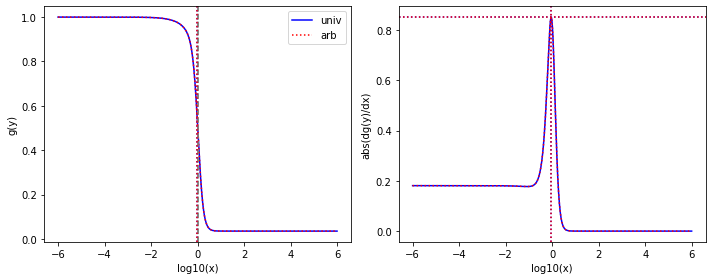

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.67876e+02 1.73120e+00 1.22435e-01 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1e-06 1e-06
0.46787599999999996 0.467876
0.000122435 0.000122435
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 1882941065367562.2
From univ parameters, position and steepness are: 0.0028431984522679084 0.8680398297056575 359.5301278208265
From arb parameters, position and steepness are: 0.0028431984522679127 0.8680398297056563 359.53012782082595


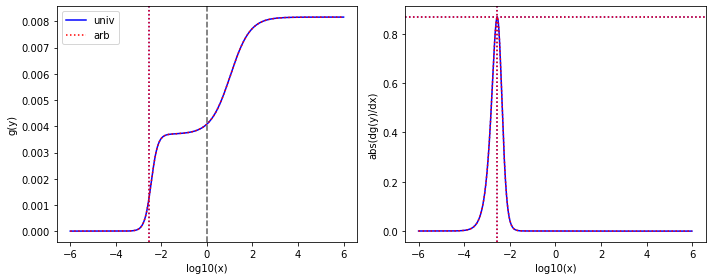

[7.54889e+02 1.00000e-03 9.11807e-02 1.00000e-03 3.07074e-03 1.00000e-03
 7.14180e+01 1.00000e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
0.00012078689714646789 0.00012078689714646789
4.067803345922381e-06 4.067803345922381e-06
0.0946072866341939 0.09460728663419392
0.029528579698472227 0.029528579698472227
# maximal error is 1.3877787807814457e-17
min-max are 7.027031419536454e-09 6721467737.194131
From univ parameters, position and steepness are: 0.4971685529308148 0.8682808482547987 3.8143582547780097
From arb parameters, position and steepness are: 0.49716855293081474 0.8682808482547987 3.8143582547780097


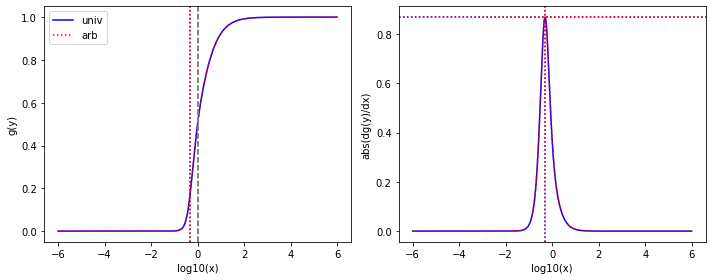

[7.54889e+02 2.22423e-03 1.79445e-02 3.81162e-03 1.27966e-03 1.27966e-03
 6.97695e+01 8.74224e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
2.3771044484685826e-05 2.3771044484685826e-05
1.6951631299436075e-06 1.6951631299436075e-06
0.09242352186877804 0.09242352186877804
0.029528579698472227 0.02952857969847222
# maximal error is 6.938893903907228e-18
min-max are 2.498058915578641e-10 235801843348379.2
From univ parameters, position and steepness are: 0.5048695451195375 0.8669517041234996 3.764179866144262
From arb parameters, position and steepness are: 0.5048695451195375 0.8669517041234996 3.764179866144262


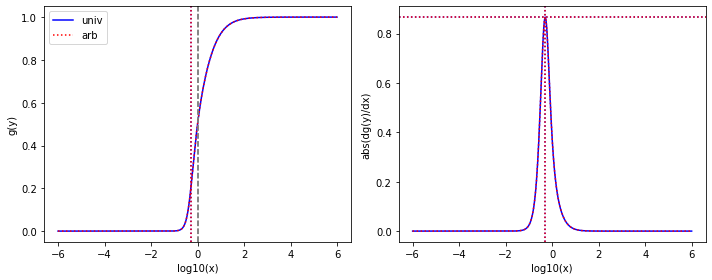

[7.54889e+02 1.00000e-03 1.00000e-03 1.00000e-03 9.13016e-03 1.00000e-03
 6.79956e+01 1.56639e-02 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
1.209470531429124e-05 1.209470531429124e-05
0.09007363996561084 0.09007363996561082
0.029528579698472227 0.02952857969847223
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 98173320716939.47
From univ parameters, position and steepness are: 0.5132493031045968 0.865701991831003 3.7114719263284117
From arb parameters, position and steepness are: 0.5132493031045968 0.865701991831003 3.7114719263284117


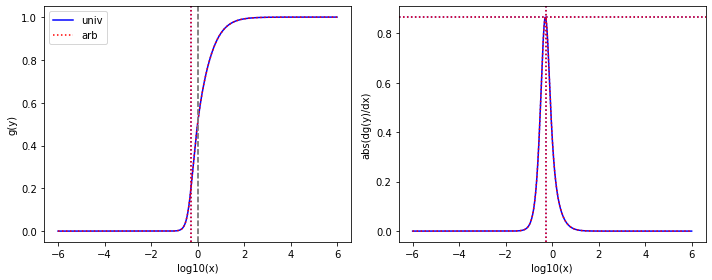

[1.00000e+03 1.60783e-03 1.00000e-03 1.00000e-03 2.26609e-03 1.00000e-03
 7.10259e+01 1.37351e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1e-06 1e-06
2.26609e-06 2.26609e-06
0.07102589999999999 0.07102589999999998
0.0222908 0.0222908
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 125763372816112.78
From univ parameters, position and steepness are: 0.5217177232282785 0.8646770246489354 3.9270023627828907
From arb parameters, position and steepness are: 0.5217177232282785 0.8646770246489354 3.9270023627828907


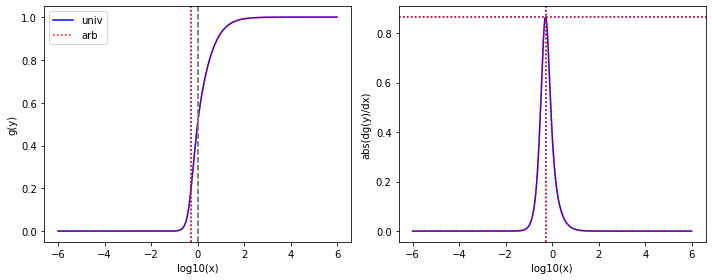

[7.54889e+02 4.78983e-03 1.00000e-03 1.00000e-03 7.41871e-03 1.43044e-03
 6.38965e+01 2.12003e-02 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
9.827550805482661e-06 9.827550805482661e-06
0.08464357011428171 0.08464357011428171
0.029528579698472227 0.029528579698472227
# maximal error is 0.0
min-max are 2.498058915578641e-10 79760021065869.52
From univ parameters, position and steepness are: 0.5329766514134688 0.8635741584158106 3.594112273823607
From arb parameters, position and steepness are: 0.532976651413469 0.8635741584158106 3.5941122738236064


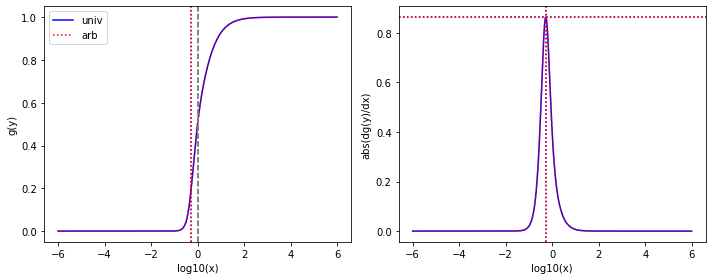

[7.54889e+02 1.90595e-02 4.53785e-02 1.00000e-03 1.00000e-03 1.00000e-03
 6.14081e+01 1.00000e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
6.01128112874873e-05 6.01128112874873e-05
1.3246980681928071e-06 1.3246980681928071e-06
0.08134719144139071 0.08134719144139073
0.029528579698472227 0.029528579698472227
# maximal error is 1.3877787807814457e-17
min-max are 2.439715342954195e-10 67248604591.29796
From univ parameters, position and steepness are: 0.5450787097442025 0.8628682475483628 3.526952070544378
From arb parameters, position and steepness are: 0.5450787097442024 0.8628682475483628 3.526952070544378


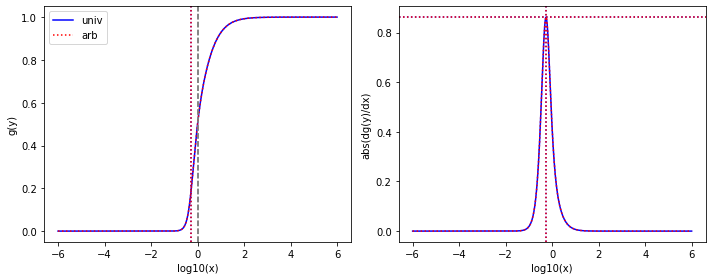

[7.54889e+02 1.00000e-03 1.00000e-03 1.00000e-03 2.35080e-03 2.35080e-03
 5.91668e+01 3.22810e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
3.1141002187076513e-06 3.1141002187076513e-06
0.07837814566115019 0.07837814566115019
0.029528579698472227 0.029528579698472224
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 100981190427752.52
From univ parameters, position and steepness are: 0.5562564927085661 0.862626274882157 3.4667849799892734
From arb parameters, position and steepness are: 0.5562564927085661 0.862626274882157 3.4667849799892734


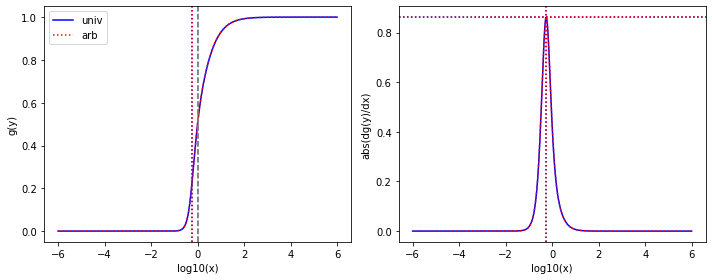

[7.54889e+02 2.15462e-03 1.79111e-01 3.78254e-03 1.27966e-03 1.27966e-03
 5.70839e+01 8.74224e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
0.00023726799569208186 0.00023726799569208186
1.6951631299436075e-06 1.6951631299436073e-06
0.07561893205491138 0.07561893205491138
0.029528579698472227 0.029528579698472234
# maximal error is 6.938893903907228e-18
min-max are 7.027031419536454e-09 2800961223.9321938
From univ parameters, position and steepness are: 0.5667704326556744 0.862673908611209 3.412753144639702
From arb parameters, position and steepness are: 0.5667704326556744 0.862673908611209 3.4127531446397015


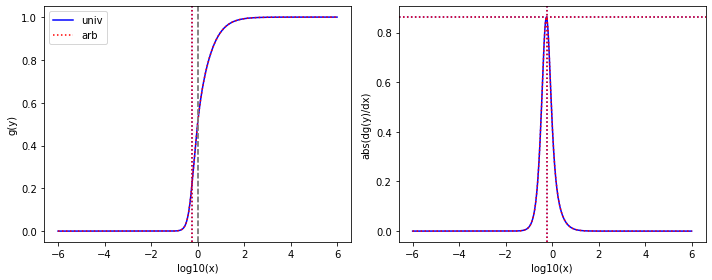

[1.00000e+03 2.35682e-02 2.37835e-03 1.00000e-03 1.00000e-03 1.00000e-03
 3.02229e+01 5.13247e-02 8.81289e+00 8.81289e+00]
found K1
found pairwise
found triplewise
2.37835e-06 2.37835e-06
1e-06 1e-06
0.0302229 0.030222899999999997
0.00881289 0.00881289
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 122531324219226.45
From univ parameters, position and steepness are: 0.5702168237652103 0.8626644216354615 4.590725368649007
From arb parameters, position and steepness are: 0.5702168237652103 0.8626644216354615 4.590725368649006


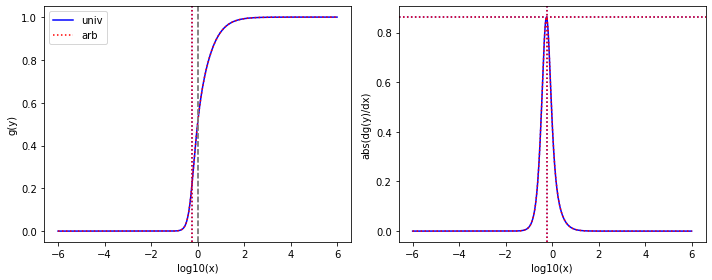

[1.00000e+03 1.00000e+03 1.41307e-02 1.41307e-02 2.48282e-02 2.38061e-03
 1.00000e+03 1.00000e+03 1.00000e+03 1.00000e-03]
found K1
found pairwise
found triplewise
1.41307e-05 1.41307e-05
2.48282e-05 2.48282e-05
1.0 0.9999999999999999
1.0 0.9999999999999998
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 201039914066502.0
From univ parameters, position and steepness are: 0.5836341355621879 0.863632824610368 1.380273670251863
From arb parameters, position and steepness are: 0.5836341355621879 0.863632824610368 1.3802736702518632


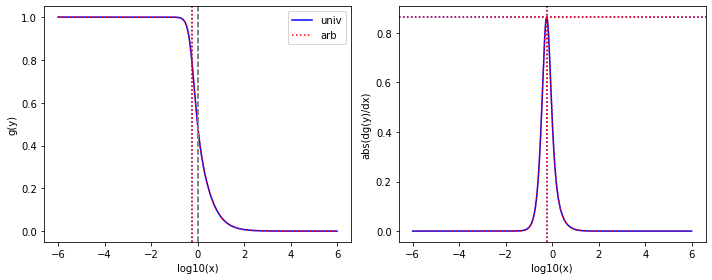

[9.51207e+02 9.51207e+02 1.08588e-02 1.00000e-03 1.00000e-03 1.00000e-03
 3.55358e+01 3.55358e+01 1.24328e+01 2.96575e-03]
found K1
found pairwise
found triplewise
1.1415811700292365e-05 1.1415811700292365e-05
1.0512958798663173e-06 1.0512958798663173e-06
0.03735864012775348 0.03735864012775347
0.013070551415201949 0.013070551415201947
# maximal error is 6.938893903907228e-18
min-max are 2.498058915578641e-10 150950532993084.2
From univ parameters, position and steepness are: 0.5929618194775255 0.8642946984083907 4.028472590211376
From arb parameters, position and steepness are: 0.5929618194775256 0.8642946984083907 4.028472590211376


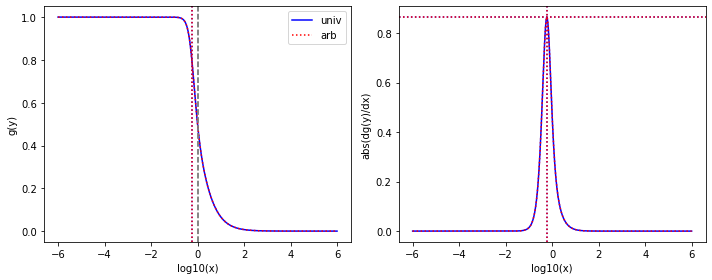

[7.54889e+02 1.00000e-03 1.09370e-02 1.00000e-03 4.79089e-02 1.33097e-03
 5.04614e+01 2.12003e-02 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1.4488222771824732e-05 1.4488222771824732e-05
6.346482727924237e-05 6.346482727924237e-05
0.06684611909830451 0.06684611909830451
0.029528579698472227 0.02952857969847223
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 514822173536628.56
From univ parameters, position and steepness are: 0.6008681278320198 0.8654277504302337 3.2495116375281556
From arb parameters, position and steepness are: 0.6008681278320198 0.8654277504302337 3.249511637528156


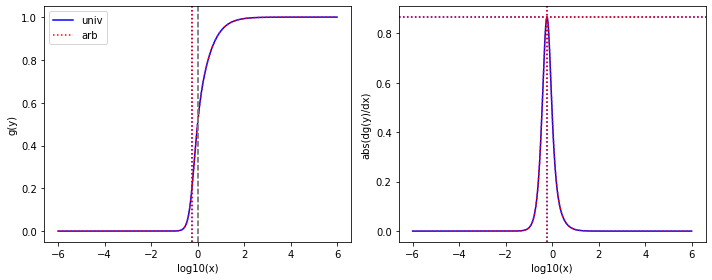

[7.54889e+02 6.48050e-03 1.00000e-03 1.00000e-03 4.79089e-02 4.42266e-03
 4.73103e+01 9.36984e-02 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
6.346482727924237e-05 6.346482727924237e-05
0.06267186301562216 0.06267186301562218
0.029528579698472227 0.029528579698472224
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 515389458910245.2
From univ parameters, position and steepness are: 0.6178292485506739 0.8680560074428225 3.1738451797079033
From arb parameters, position and steepness are: 0.6178292485506738 0.8680560074428225 3.1738451797079037


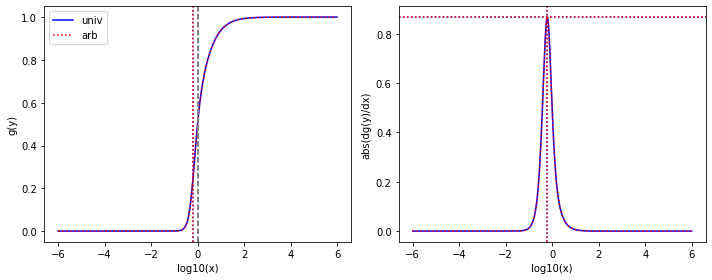

[6.53577e+00 6.53577e+00 4.13592e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.26698e+02 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.0001530041601831154
65.28656914181497 65.28656914181498
# maximal error is 1.4210854715202004e-14
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9154539014843047 0.8627875655329074 0.33167323332792226
From arb parameters, position and steepness are: 0.9154539014843047 0.8627875655329074 0.33167323332792226


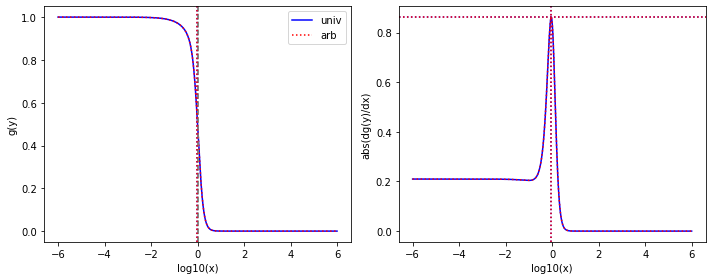

[1.00000e+03 5.44733e+00 1.42062e+00 1.00000e-03 2.48127e+02 1.00000e-03
 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00142062 0.00142062
0.24812700000000001 0.248127
1e-06 9.999999999999997e-07
1e-06 1.0000000000000002e-06
# maximal error is 2.7755575615628914e-17
min-max are 7.027031419536454e-09 410000430647130.75
From univ parameters, position and steepness are: 0.0023118818492972627 0.8734843051139084 497.92691125670194
From arb parameters, position and steepness are: 0.0023118818492972627 0.8734843051139084 497.92691125670194


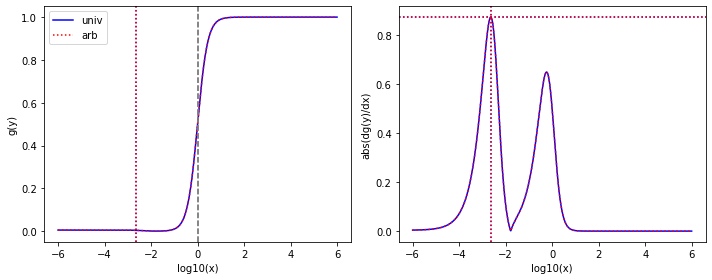

[7.54889e+02 1.74668e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 8.20140e+01 2.74816e+00 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
1.3246980681928071e-06 1.3246980681928071e-06
0.10864378736476488 0.10864378736476489
0.029528579698472227 0.02952857969847223
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 330061162530546.7
From univ parameters, position and steepness are: 0.46356223559571114 0.8736296564910581 3.9727972248917984
From arb parameters, position and steepness are: 0.4635622355957112 0.8736296564910581 3.9727972248917984


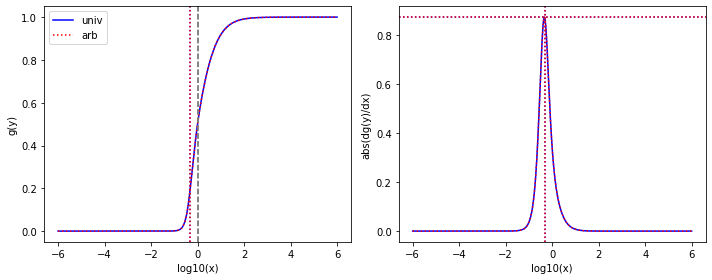

[1.00000e+03 3.88134e-02 1.00000e-03 1.00000e-03 9.36472e-02 2.82879e-03
 8.20140e+01 1.00000e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1e-06 1e-06
9.36472e-05 9.36472e-05
0.08201399999999999 0.08201399999999999
0.0222908 0.022290800000000003
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 760537636987398.8
From univ parameters, position and steepness are: 0.47434478108514344 0.8731809520948364 4.2604872848243485
From arb parameters, position and steepness are: 0.47434478108514344 0.8731809520948364 4.2604872848243485


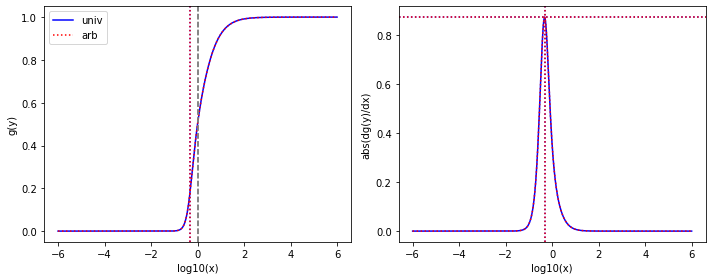

[1.49203e+02 1.00000e-03 1.00000e-03 1.00000e-03 4.69400e-02 3.77850e-03
 1.55784e+01 1.37075e-03 4.78313e+00 4.78313e+00]
found K1
found pairwise
found triplewise
6.702278104327661e-06 6.702278104327661e-06
0.0003146049342171404 0.0003146049342171404
0.10441076922045803 0.10441076922045803
0.03205786746915276 0.03205786746915276
# maximal error is 0.0
min-max are 2.498058915578641e-10 2554859030402107.5
From univ parameters, position and steepness are: 0.4847342883745509 0.8706104688737022 3.8187192572697573
From arb parameters, position and steepness are: 0.4847342883745509 0.8706104688737022 3.818719257269757


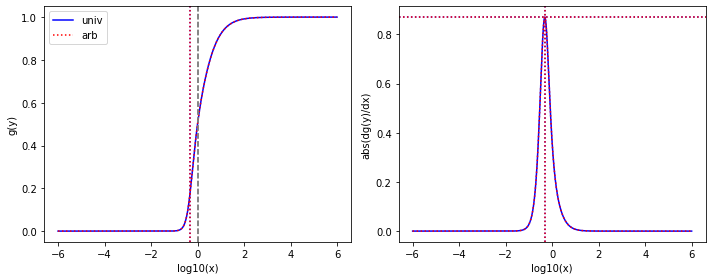

[7.54889e+02 1.00000e-03 2.29218e-02 1.00000e-03 8.66184e-02 1.00000e-03
 6.34083e+01 1.00000e-03 3.51447e+01 3.51447e+01]
found K1
found pairwise
found triplewise
3.0364464179501886e-05 3.0364464179501886e-05
0.00011474322714995184 0.00011474322714995184
0.08399685251738997 0.08399685251738996
0.04655611619721575 0.046556116197215745
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 930609175717921.8
From univ parameters, position and steepness are: 0.629163763824214 0.87064694004616 2.792000969307409
From arb parameters, position and steepness are: 0.629163763824214 0.87064694004616 2.7920009693074084


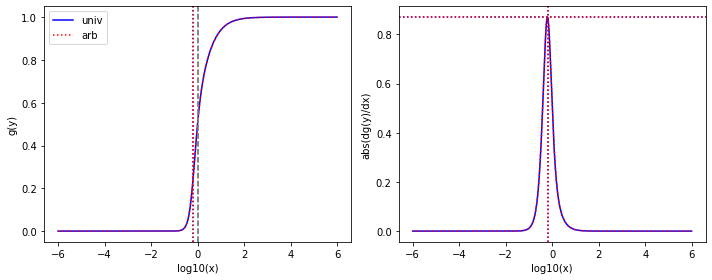

[7.54889e+02 4.62273e-03 1.00000e-03 1.00000e-03 1.78409e-02 3.09136e-03
 4.46838e+01 2.12003e-02 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
2.3633805764821052e-05 2.3633805764821055e-05
0.05919254353951375 0.05919254353951375
0.029528579698472227 0.029528579698472224
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 191891200761674.2
From univ parameters, position and steepness are: 0.6313769683417693 0.8711450286412549 3.118995855321688
From arb parameters, position and steepness are: 0.6313769683417692 0.8711450286412549 3.118995855321688


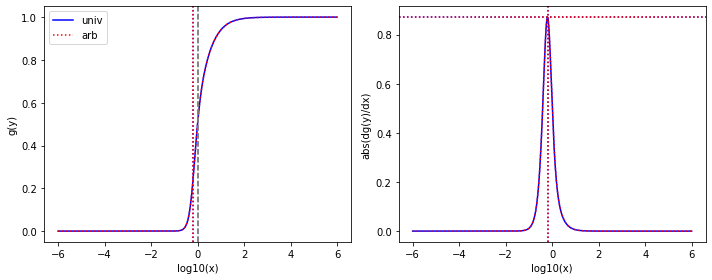

[7.54889e+02 1.00000e-03 6.45667e-03 4.09245e-03 2.99100e-03 2.13422e-03
 4.14933e+01 1.00000e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
8.553138275958452e-06 8.553138275958452e-06
3.962171921964687e-06 3.962171921964687e-06
0.054966094352944604 0.054966094352944604
0.029528579698472227 0.029528579698472227
# maximal error is 0.0
min-max are 2.498058915578641e-10 56177403267632.516
From univ parameters, position and steepness are: 0.6483551848849718 0.8757592768982257 3.052273980924461
From arb parameters, position and steepness are: 0.6483551848849718 0.8757592768982257 3.052273980924461


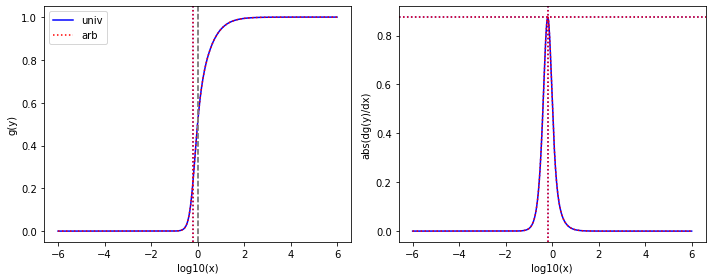

[7.54889e+02 1.00000e-03 4.39798e-03 2.29002e-03 2.71674e-03 2.71674e-03
 4.01799e+01 1.00000e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
5.8259956099506025e-06 5.8259956099506025e-06
3.598860229782127e-06 3.598860229782127e-06
0.05322623591018018 0.05322623591018017
0.029528579698472227 0.029528579698472224
# maximal error is 6.938893903907228e-18
min-max are 2.498058915578641e-10 59717851875569.8
From univ parameters, position and steepness are: 0.6554301528159115 0.8779709485935144 3.0253808810615235
From arb parameters, position and steepness are: 0.6554301528159115 0.8779709485935144 3.0253808810615235


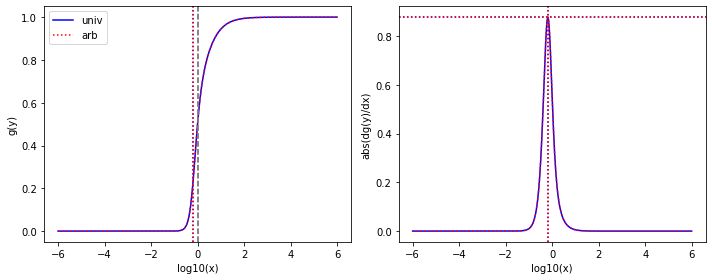

[6.53577e+00 6.53577e+00 1.53109e+00 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 1.37622e+01 1.69560e-01]
found K1
found pairwise
found triplewise
0.23426313961476614 0.23426313961476614
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311538
2.1056738532720702 2.1056738532720702
# maximal error is 0.0
min-max are 3.529814346881038e-10 252821054753.49268
From univ parameters, position and steepness are: 0.9114270603952239 0.8730837838717707 0.7878443345400848
From arb parameters, position and steepness are: 0.9114270603952239 0.8730837838717707 0.7878443345400848


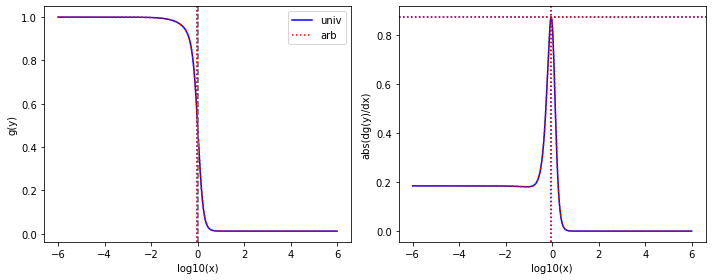

[4.71826e+02 5.44733e+00 1.58880e+00 1.02346e-03 8.19240e+01 1.00000e-03
 2.98374e-03 2.36639e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.003367343045953381 0.003367343045953381
0.1736318049450433 0.1736318049450433
6.3238142874703804e-06 6.32381428747038e-06
2.1194253813905974e-06 2.1194253813905974e-06
# maximal error is 8.470329472543003e-22
min-max are 7.027031419536454e-09 286905958619051.44
From univ parameters, position and steepness are: 0.004757795586190908 0.8831446817799722 285.9087313634888
From arb parameters, position and steepness are: 0.004757795586190909 0.883144681779972 285.9087313634888


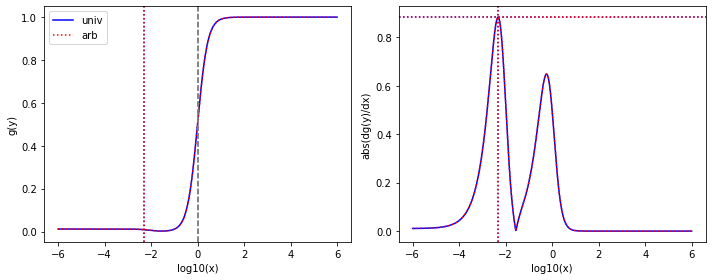

[7.54889e+02 1.00000e-03 1.60866e-03 1.00000e-03 6.11030e-02 9.40742e-03
 8.20140e+01 6.41065e-03 2.20843e+01 2.20843e+01]
found K1
found pairwise
found triplewise
2.130988794379041e-06 2.130988794379041e-06
8.09430260607851e-05 8.09430260607851e-05
0.10864378736476488 0.10864378736476489
0.02925502954739041 0.029255029547390413
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 657308561811521.1
From univ parameters, position and steepness are: 0.44795573792281046 0.880818866940577 4.181191770829255
From arb parameters, position and steepness are: 0.44795573792281046 0.880818866940577 4.181191770829255


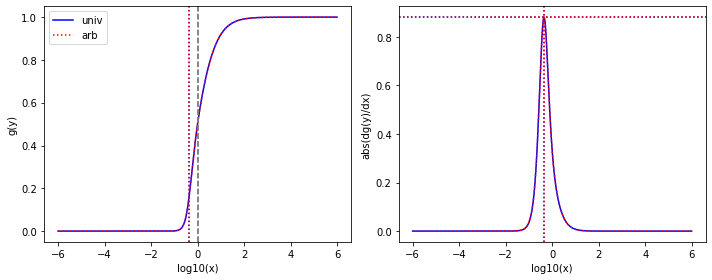

[7.54889e+02 3.88134e-02 1.00000e-03 1.00000e-03 9.36472e-02 7.12816e-03
 8.20140e+01 1.77401e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
0.00012405426493166546 0.00012405426493166546
0.10864378736476488 0.10864378736476488
0.029528579698472227 0.029528579698472224
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 1007482726858788.0
From univ parameters, position and steepness are: 0.45030161442878847 0.8800058400901866 4.1531071016685095
From arb parameters, position and steepness are: 0.45030161442878847 0.8800058400901866 4.1531071016685095


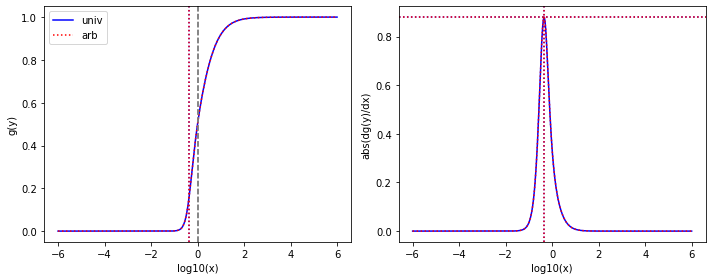

[7.54889e+02 1.00000e-03 1.09370e-02 1.09370e-02 4.79089e-02 1.00000e-03
 8.20140e+01 2.12003e-02 6.27291e+01 6.27291e+01]
found K1
found pairwise
found triplewise
1.4488222771824732e-05 1.4488222771824732e-05
6.346482727924237e-05 6.346482727924237e-05
0.10864378736476488 0.10864378736476489
0.08309711758947343 0.08309711758947343
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 514822173536628.56
From univ parameters, position and steepness are: 0.6686165454377867 0.8825311291957662 2.2983082107957524
From arb parameters, position and steepness are: 0.6686165454377866 0.8825311291957662 2.2983082107957524


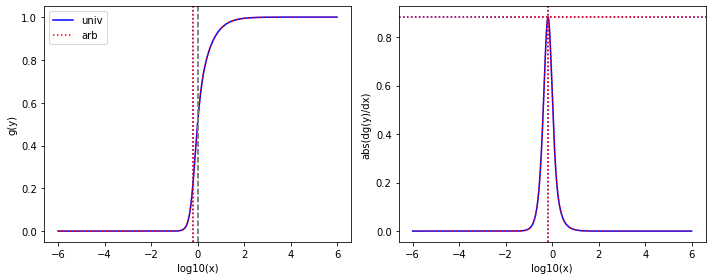

[7.54889e+02 1.00000e-03 4.25376e-02 1.00000e-03 1.19754e-02 1.45429e-03
 3.58174e+01 1.19112e-02 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
5.634947654555836e-05 5.634947654555836e-05
1.5863789245836143e-05 1.5863789245836143e-05
0.04744724058768905 0.047447240587689045
0.029528579698472227 0.02952857969847223
# maximal error is 6.938893903907228e-18
min-max are 2.498058915578641e-10 126413633987938.64
From univ parameters, position and steepness are: 0.6791387391565643 0.886686685583829 2.9394732648253274
From arb parameters, position and steepness are: 0.6791387391565643 0.8866866855838291 2.939473264825327


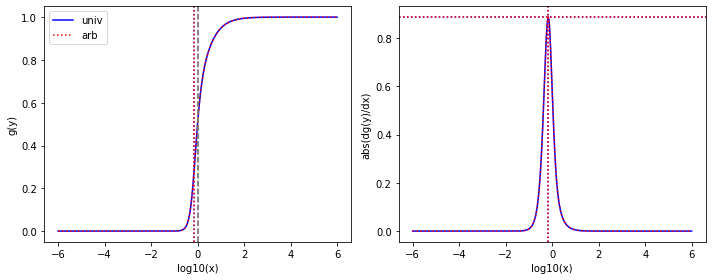

[6.53577e+00 6.53577e+00 4.13592e+00 2.32416e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 6.49027e+02 1.69560e-01]
found K1
found pairwise
found triplewise
0.6328129661845505 0.6328129661845505
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.0001530041601831154
99.30383107116683 99.30383107116683
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 252820929702.37714
From univ parameters, position and steepness are: 0.9118611212047997 0.8806108958434579 0.30052061015368103
From arb parameters, position and steepness are: 0.9118611212047997 0.8806108958434579 0.30052061015368103


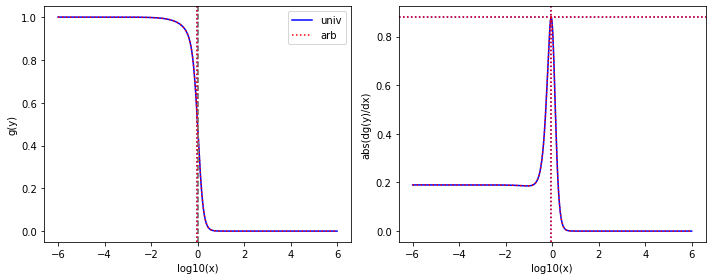

[4.13403e+01 6.70745e+00 1.00000e-03 1.00000e-03 1.32818e+00 1.66189e-03
 1.00000e+03 1.56440e+02 1.86395e+01 1.00000e-03]
found K1
found pairwise
found triplewise
2.4189471290726e-05 2.4189471290726e-05
0.03212797197891645 0.03212797197891645
24.189471290726 24.189471290726
0.4508796501234873 0.45087965012348724
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 2.6093484569035226e+17
From univ parameters, position and steepness are: 0.005671505906908864 0.895971596963163 49.80478074823495
From arb parameters, position and steepness are: 0.005671505906908865 0.8959715969631663 49.80478074823493


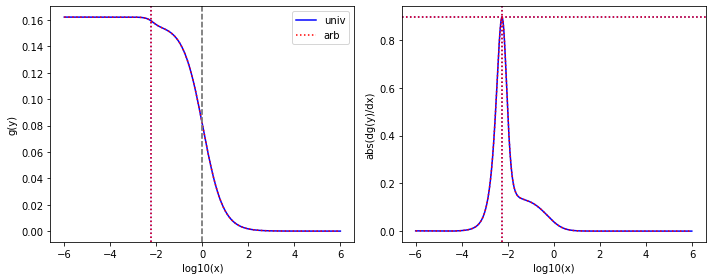

[3.89329e+02 1.07673e+00 1.00000e-03 1.00000e-03 1.52989e-01 1.01526e-03
 2.60239e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.5685217386837355e-06 2.5685217386837355e-06
0.000392955572279486 0.000392955572279486
0.6684295287533165 0.6684295287533166
2.5685217386837355e-06 2.5685217386837355e-06
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 3191382766969658.0
From univ parameters, position and steepness are: 0.43381765146817675 0.891260410905257 2.09237694296048
From arb parameters, position and steepness are: 0.4338176514681768 0.8912604109052569 2.0923769429604797


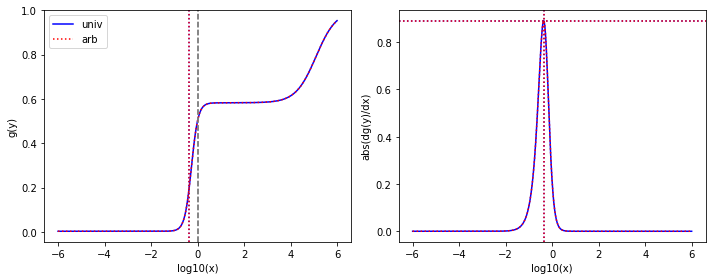

[9.51207e+02 9.51207e+02 3.15662e-02 2.03486e-03 1.00000e-03 1.00000e-03
 3.55358e+01 3.55358e+01 2.17849e+01 1.00000e-03]
found K1
found pairwise
found triplewise
3.3185416003036145e-05 3.3185416003036145e-05
1.0512958798663173e-06 1.0512958798663173e-06
0.03735864012775348 0.03735864012775348
0.022902375613299733 0.022902375613299733
# maximal error is 0.0
min-max are 2.498058915578641e-10 170873308901983.06
From univ parameters, position and steepness are: 0.6883497757093738 0.8905944243244946 3.0986608065701895
From arb parameters, position and steepness are: 0.6883497757093738 0.8905944243244946 3.098660806570189


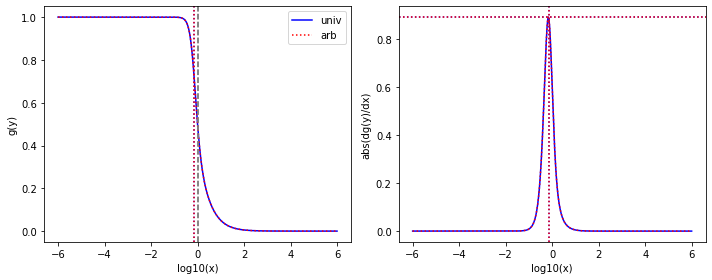

[6.27655e+02 6.27655e+02 1.21696e-02 1.10885e-02 1.00000e-03 1.00000e-03
 5.38605e+02 5.38605e+02 1.00000e+03 2.53456e-01]
found K1
found pairwise
found triplewise
1.93889955469167e-05 1.93889955469167e-05
1.593231950673539e-06 1.593231950673539e-06
0.8581226947925215 0.8581226947925215
1.5932319506735388 1.5932319506735388
# maximal error is 0.0
min-max are 2.498058915578641e-10 2304925046567519.0
From univ parameters, position and steepness are: 0.6970225721425912 0.8945312205774301 1.0622558117417977
From arb parameters, position and steepness are: 0.6970225721425912 0.8945312205774301 1.0622558117417977


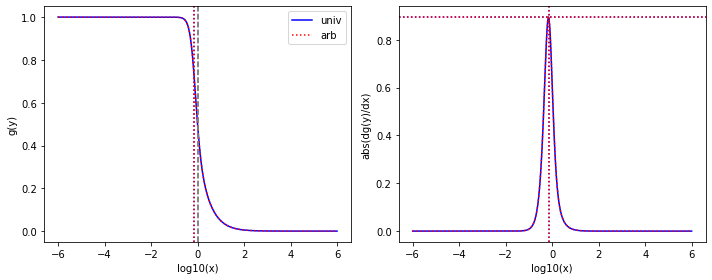

[6.16441e+00 6.16441e+00 4.15509e+00 1.00000e-03 6.75336e-03 1.26152e-03
 1.00000e-03 1.00000e-03 1.00000e+03 6.12330e-02]
found K1
found pairwise
found triplewise
0.6740450424290403 0.6740450424290403
0.001095540368015755 0.001095540368015755
0.0001622215264721198 0.00016222152647211982
162.2215264721198 162.22152647211982
# maximal error is 2.842170943040401e-14
min-max are 3.529814346881038e-10 1810250181623.6719
From univ parameters, position and steepness are: 0.9100026959984994 0.89016041782505 0.2666630623267225
From arb parameters, position and steepness are: 0.9100026959984994 0.89016041782505 0.26666306232672254


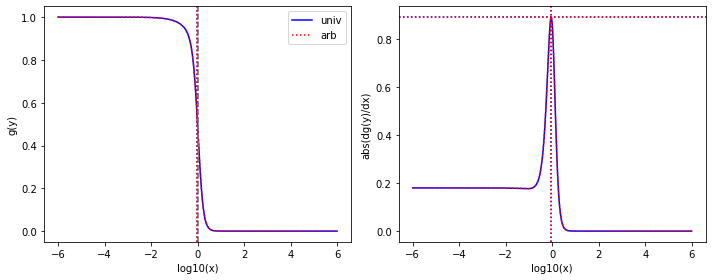

[1.12586e+02 1.12586e+02 6.52920e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e+03 1.00000e+03 6.23625e-01 1.86505e-01]
found K1
found pairwise
found triplewise
5.79930009059741e-05 5.79930009059741e-05
8.882099017639849e-06 8.882099017639849e-06
8.882099017639849 8.882099017639849
0.00553909899987565 0.00553909899987565
# maximal error is 0.0
min-max are 2.439715342954195e-10 891160278159.6663
From univ parameters, position and steepness are: 0.0003791933234579961 0.9078436617169539 1603.5277621123823
From arb parameters, position and steepness are: 0.000379193323457996 0.9078436617169539 1603.5277621123826


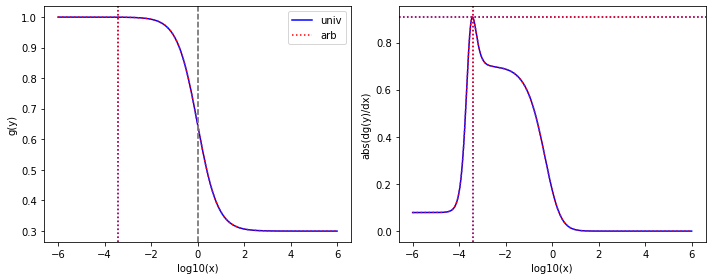

[1.00000e+03 1.00000e-03 5.13148e-03 1.00000e-03 1.00000e-03 1.00000e-03
 3.26334e+01 2.23742e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
5.13148e-06 5.13148e-06
1e-06 9.999999999999997e-07
0.0326334 0.0326334
0.0222908 0.022290800000000003
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 134290958302548.84
From univ parameters, position and steepness are: 0.7086975075194473 0.9006772616981994 3.048022922966092
From arb parameters, position and steepness are: 0.7086975075194473 0.9006772616981994 3.048022922966092


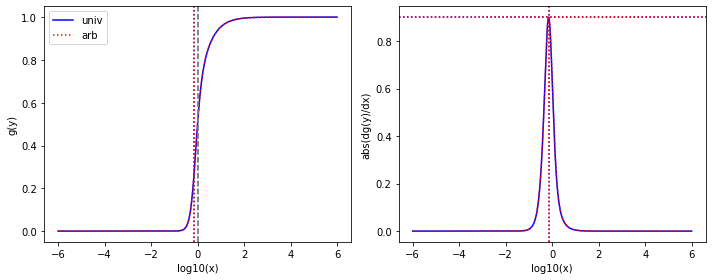

[1.00000e+03 1.74668e-03 1.00000e-03 1.00000e-03 1.21647e-01 1.00000e-03
 3.06233e+01 1.28034e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1e-06 1e-06
0.00012164700000000001 0.00012164700000000001
0.0306233 0.030623300000000003
0.0222908 0.0222908
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 987945476006261.0
From univ parameters, position and steepness are: 0.7188962213141104 0.9062728796520172 3.013987774505634
From arb parameters, position and steepness are: 0.7188962213141102 0.9062728796520172 3.013987774505634


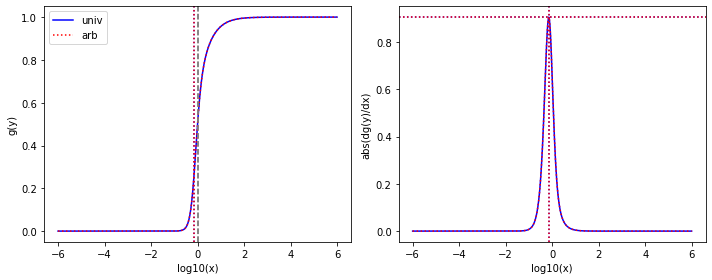

[6.53577e+00 6.53577e+00 7.80851e-01 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.69560e-01]
found K1
found pairwise
found triplewise
0.11947345148314581 0.1194734514831458
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311538
0.7326711313280607 0.7326711313280607
# maximal error is 1.3877787807814457e-17
min-max are 3.529814346881038e-10 252821090770.51642
From univ parameters, position and steepness are: 0.9014573748627329 0.9042668370977135 1.0429585965467503
From arb parameters, position and steepness are: 0.9014573748627329 0.9042668370977136 1.0429585965467503


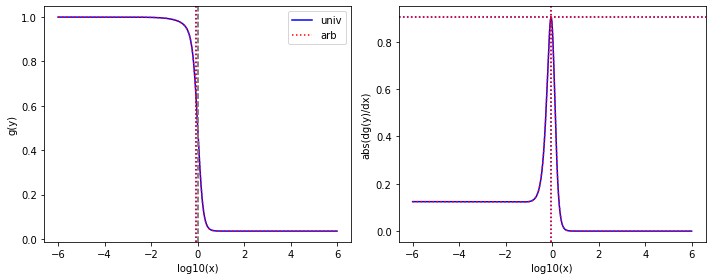

[4.92861e+02 1.00000e-03 1.00000e-03 1.00000e-03 2.63580e+00 1.00000e-03
 3.22455e+02 1.00000e-03 2.01216e-03 1.21109e-03]
found K1
found pairwise
found triplewise
2.028969628353633e-06 2.028969628353633e-06
0.005347958146414507 0.005347958146414507
0.6542514015107708 0.6542514015107709
4.082611527388047e-06 4.082611527388047e-06
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 4.343478017595129e+16
From univ parameters, position and steepness are: 5.6125562676750015e-06 0.9197562196014402 160252.5979735196
From arb parameters, position and steepness are: 5.612556267675002e-06 0.9197562196014399 160252.59797351956


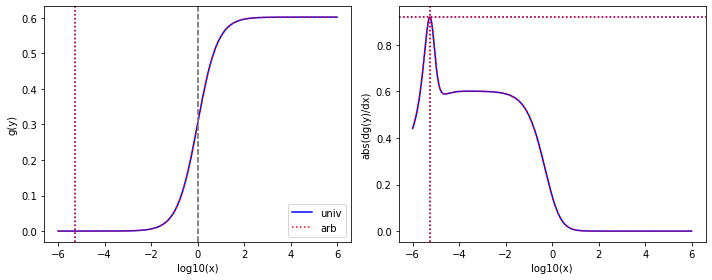

[1.00000e+03 7.51709e-03 1.00000e-03 1.00000e-03 3.79751e-01 1.04969e-01
 2.98461e+02 1.71417e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
0.000379751 0.00037975099999999995
0.29846100000000003 0.29846100000000003
1e-06 1e-06
# maximal error is 5.421010862427522e-20
min-max are 2.498058915578641e-10 3084205909370941.5
From univ parameters, position and steepness are: 0.4201904524113613 0.910773774324906 2.825876560490059
From arb parameters, position and steepness are: 0.4201904524113613 0.910773774324906 2.825876560490059


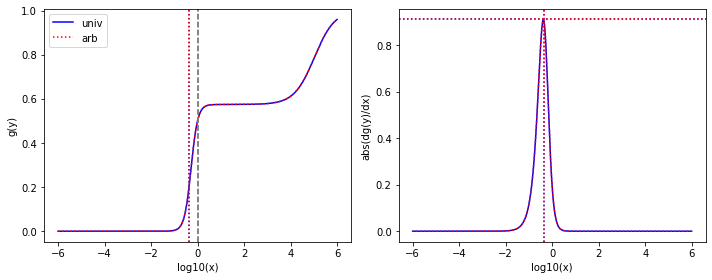

[1.00000e+03 1.19981e-02 5.13148e-03 2.76820e-03 1.00000e-03 1.00000e-03
 2.85746e+01 1.00000e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
5.13148e-06 5.13148e-06
1e-06 9.999999999999997e-07
0.0285746 0.028574600000000002
0.0222908 0.022290800000000003
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 117588434327574.05
From univ parameters, position and steepness are: 0.7296011164285497 0.9127059384089294 2.978907978712232
From arb parameters, position and steepness are: 0.7296011164285497 0.9127059384089294 2.978907978712232


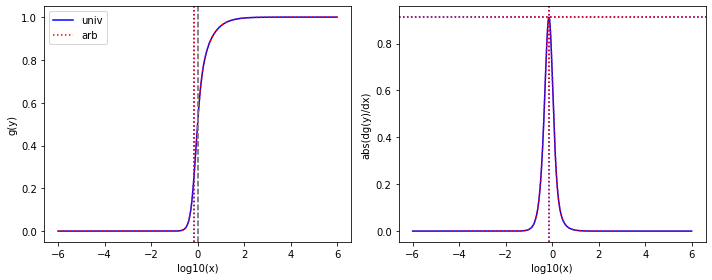

[5.06776e+02 1.54162e-01 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 2.30893e+01 1.00000e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1.9732584021342762e-06 1.9732584021342762e-06
1.9732584021342762e-06 1.9732584021342762e-06
0.04556115522439895 0.04556115522439895
0.04398550839029473 0.04398550839029473
# maximal error is 0.0
min-max are 2.498058915578641e-10 92921812956508.28
From univ parameters, position and steepness are: 0.7358132135501121 0.9164021001012714 2.496859432498007
From arb parameters, position and steepness are: 0.7358132135501122 0.9164021001012714 2.496859432498007


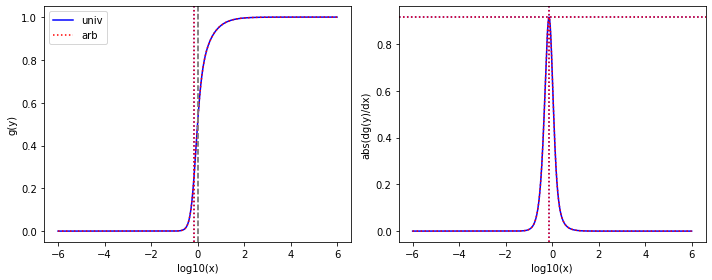

[4.56452e+01 4.56452e+01 4.13592e+00 1.92836e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.00000e-03]
found K1
found pairwise
found triplewise
0.09061018464153951 0.0906101846415395
2.1908108629165827e-05 2.1908108629165827e-05
2.1908108629165827e-05 2.1908108629165827e-05
0.1049085117383646 0.10490851173836462
# maximal error is 1.3877787807814457e-17
min-max are 3.529814346881038e-10 36200427325.52251
From univ parameters, position and steepness are: 0.9051947516479001 0.9147355104352186 1.6858950457885358
From arb parameters, position and steepness are: 0.9051947516479001 0.9147355104352186 1.6858950457885358


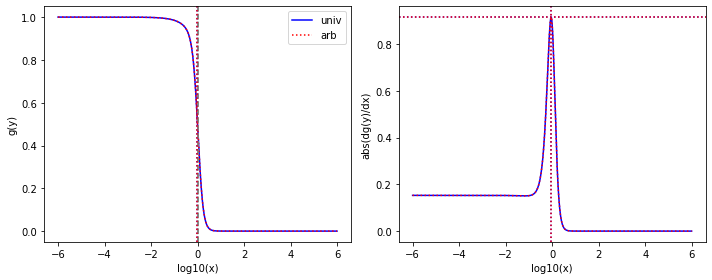

[1.13188e+01 1.13188e+01 4.12951e-02 4.07742e-02 1.02210e-02 1.30133e-03
 5.30438e+02 5.30438e+02 9.31547e+00 2.77070e+00]
found K1
found pairwise
found triplewise
0.0036483637841467297 0.0036483637841467297
0.0009030109198855002 0.0009030109198855002
46.863448422094216 46.86344842209422
0.8230086228222073 0.8230086228222073
# maximal error is 7.105427357601002e-15
min-max are 3.529814346881038e-10 1492118319830.5444
From univ parameters, position and steepness are: 0.0060566927114510186 0.9281606899897811 56.941604359534956
From arb parameters, position and steepness are: 0.0060566927114510186 0.9281606899897811 56.94160435953495


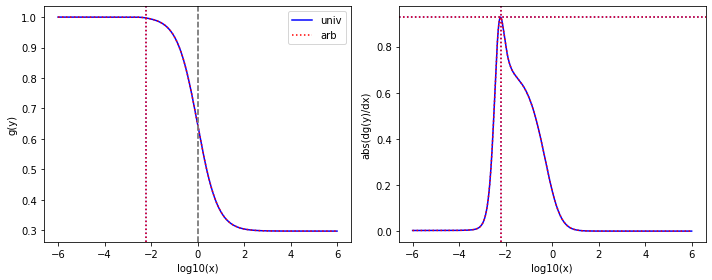

[5.27198e+01 5.27198e+01 1.53540e-03 1.00000e-03 1.00000e-03 1.00000e-03
 3.96609e+02 1.73213e+02 4.46918e+00 1.56377e-03]
found K1
found pairwise
found triplewise
2.9123782715412424e-05 2.9123782715412424e-05
1.896820549395104e-05 1.896820549395104e-05
7.522961012750428 7.522961012750428
0.0847723246294561 0.08477232462945608
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 1600709401831470.0
From univ parameters, position and steepness are: 0.4106026724081004 0.9230299500022016 0.987476887988935
From arb parameters, position and steepness are: 0.4106026724081004 0.9230299500022016 0.9874768879889351


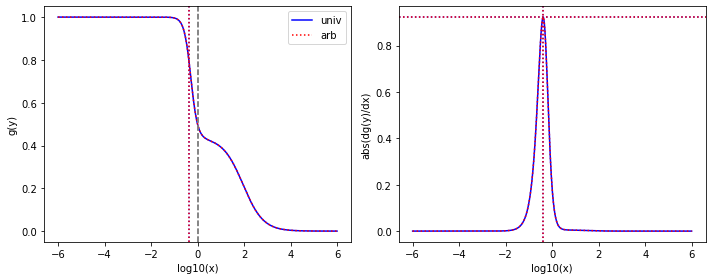

[5.38788e+01 5.38788e+01 1.02206e-03 1.02206e-03 1.36462e-02 1.06312e-03
 2.89643e+01 2.89643e+01 7.18379e+01 4.43718e-02]
found K1
found pairwise
found triplewise
1.896961328017699e-05 1.896961328017699e-05
0.0002532758710290504 0.0002532758710290504
0.5375824999814399 0.5375824999814399
1.3333240532454325 1.3333240532454325
# maximal error is 0.0
min-max are 2.498058915578641e-10 2056230032656346.8
From univ parameters, position and steepness are: 0.7481415633590154 0.9243445274200484 1.0503271658255666
From arb parameters, position and steepness are: 0.7481415633590154 0.9243445274200482 1.0503271658255666


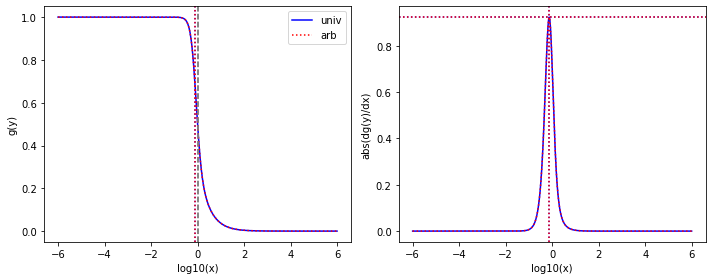

[6.53577e+00 6.53577e+00 1.08252e+00 1.98707e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 1.39208e+01 1.69560e-01]
found K1
found pairwise
found triplewise
0.16563006348142603 0.16563006348142603
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311538
2.1299403130771126 2.1299403130771126
# maximal error is 0.0
min-max are 3.529814346881038e-10 252821076288.1721
From univ parameters, position and steepness are: 0.9020210331224591 0.921516497735927 0.7983337461612693
From arb parameters, position and steepness are: 0.9020210331224591 0.9215164977359271 0.7983337461612693


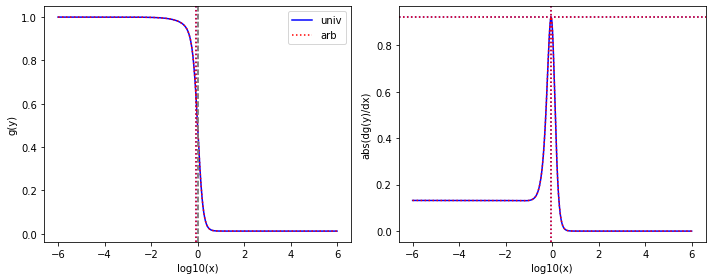

[8.56180e+00 1.82422e-01 1.00000e-03 1.00000e-03 6.44653e+00 1.00000e-03
 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00011679786960685838 0.00011679786960685838
0.7529409703567007 0.7529409703567007
0.00011679786960685838 0.00011679786960685838
0.00011679786960685838 0.00011679786960685838
# maximal error is 0.0
min-max are 3.529814346881038e-10 1244145627627108.0
From univ parameters, position and steepness are: 0.008195193204001227 0.9372146094141406 80.14524945103864
From arb parameters, position and steepness are: 0.008195193204001227 0.9372146094141406 80.14524945103864


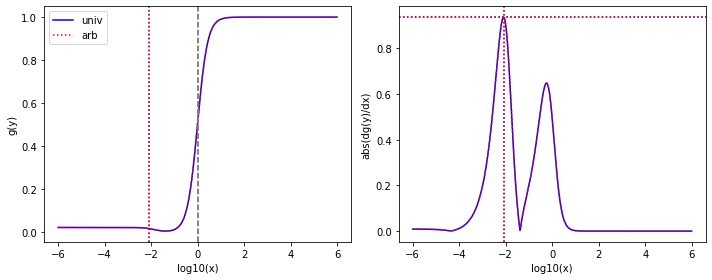

[1.00000e+03 1.53143e-03 6.77384e-01 1.00000e-03 1.00000e-03 1.00000e-03
 2.77368e+02 1.57096e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.000677384 0.000677384
1e-06 1e-06
0.277368 0.277368
1e-06 1e-06
# maximal error is 0.0
min-max are 7.027031419536454e-09 2305765463.40595
From univ parameters, position and steepness are: 0.40469241095599895 0.932643292337745 3.007727157187143
From arb parameters, position and steepness are: 0.4046924109559991 0.9326432923377448 3.007727157187142


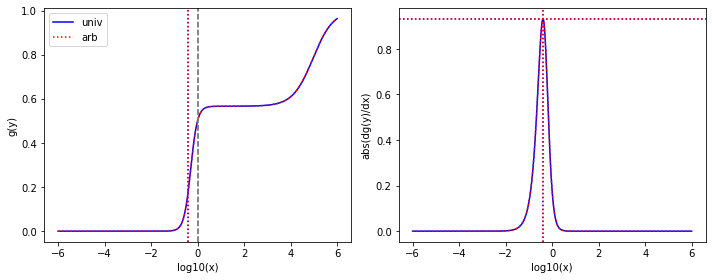

[7.54889e+02 1.10119e-03 5.82624e-03 1.00000e-03 5.39152e-02 3.04343e-03
 8.20140e+01 1.45696e-03 1.29691e+02 1.29691e+02]
found K1
found pairwise
found triplewise
7.71800887282766e-06 7.71800887282766e-06
7.142136128622885e-05 7.142136128622885e-05
0.10864378736476488 0.10864378736476486
0.17180141716199335 0.17180141716199335
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 579735049333742.4
From univ parameters, position and steepness are: 0.7559566114528569 0.9306423234524034 1.7391357428793288
From arb parameters, position and steepness are: 0.7559566114528569 0.9306423234524034 1.739135742879329


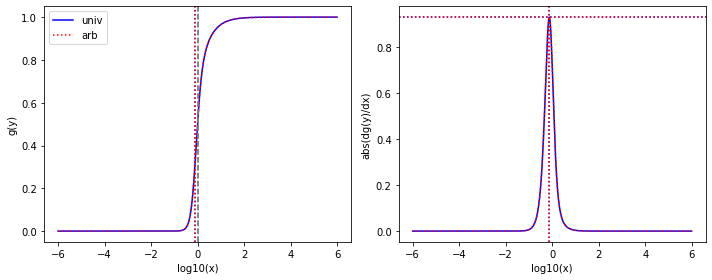

[6.53577e+00 6.53577e+00 3.16936e+00 3.80976e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 1.00000e+03 2.88733e-02]
found K1
found pairwise
found triplewise
0.4849252651179586 0.4849252651179586
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311538
153.00416018311537 153.00416018311537
# maximal error is 0.0
min-max are 3.529814346881038e-10 252820976104.4096
From univ parameters, position and steepness are: 0.9018042030389558 0.933422285382386 0.27438651467671715
From arb parameters, position and steepness are: 0.9018042030389558 0.933422285382386 0.27438651467671715


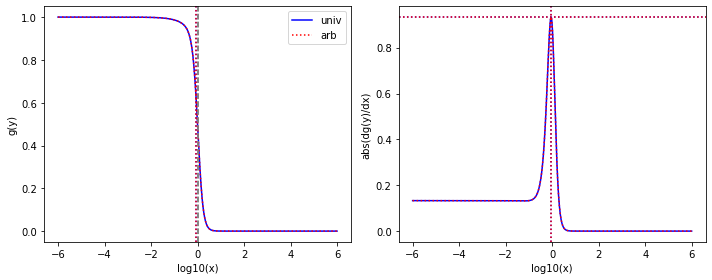

[1.44807e+00 1.44807e+00 3.21638e-02 7.69354e-03 1.00000e-03 1.00000e-03
 1.00000e+03 1.00000e+03 1.99117e+01 1.49402e+00]
found K1
found pairwise
found triplewise
0.022211495300641544 0.02221149530064154
0.0006905743506874668 0.0006905743506874669
690.5743506874668 690.5743506874668
13.750509298583632 13.750509298583633
# maximal error is 1.7763568394002505e-15
min-max are 7.027031419536454e-09 1141092085999.4597
From univ parameters, position and steepness are: 0.002771477357950293 0.9452230357855195 50.22173009426253
From arb parameters, position and steepness are: 0.002771477357950294 0.9452230357855195 50.221730094262526


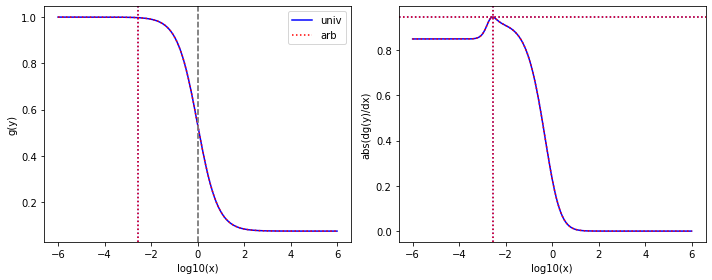

[1.43475e+02 6.42868e-03 2.14085e-03 2.14085e-03 1.66832e-03 1.00000e-03
 1.29332e+01 1.37053e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1.4921414880641228e-05 1.4921414880641228e-05
1.162794912005576e-05 1.1627949120055761e-05
0.09014253354242899 0.09014253354242899
0.15536365220421677 0.15536365220421677
# maximal error is 1.6940658945086007e-21
min-max are 2.498058915578641e-10 93796481976685.1
From univ parameters, position and steepness are: 0.7688810804162527 0.940567395241937 1.7602389519902932
From arb parameters, position and steepness are: 0.7688810804162527 0.940567395241937 1.7602389519902932


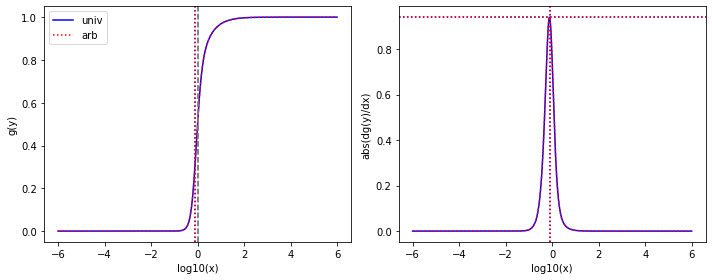

[7.54889e+02 5.61050e-03 1.00000e-03 1.00000e-03 7.41871e-03 1.00000e-03
 1.78559e+01 2.12003e-02 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
9.827550805482661e-06 9.827550805482661e-06
0.023653676235843944 0.023653676235843947
0.029528579698472227 0.029528579698472224
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 79760021065869.52
From univ parameters, position and steepness are: 0.7786927466124224 0.9486989185998201 2.6399290220387517
From arb parameters, position and steepness are: 0.7786927466124224 0.9486989185998201 2.6399290220387517


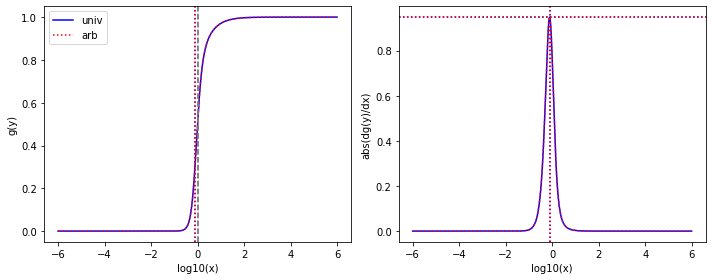

[6.53577e+00 6.53577e+00 2.47987e+00 3.62352e-03 2.35097e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.87444e+02 4.92067e-03]
found K1
found pairwise
found triplewise
0.3794304267133023 0.3794304267133023
0.00035970819046569875 0.00035970819046569875
0.00015300416018311538 0.00015300416018311535
74.58095985629849 74.58095985629848
# maximal error is 1.4210854715202004e-14
min-max are 3.529814346881038e-10 594374896738.5
From univ parameters, position and steepness are: 0.9003983245765034 0.941138656436484 0.32915716054756033
From arb parameters, position and steepness are: 0.9003983245765034 0.941138656436484 0.32915716054756033


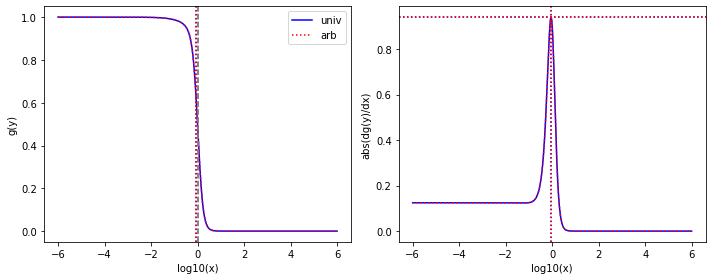

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 1.10727e+00 1.00000e-03
 4.43150e+02 1.00000e-03 2.98728e-03 2.00292e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
0.00110727 0.00110727
0.44315 0.44315
2.98728e-06 2.987280000000001e-06
# maximal error is 8.470329472543003e-22
min-max are 2.498058915578641e-10 8992945387337340.0
From univ parameters, position and steepness are: 9.033270063189417e-06 0.9554477390250804 148345.09868503772
From arb parameters, position and steepness are: 9.033270063189418e-06 0.9554477390250804 148345.09868503772


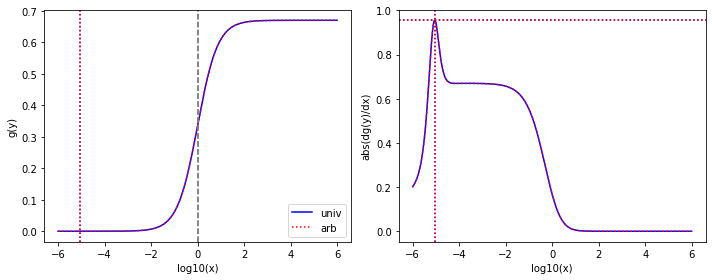

[1.28503e+01 1.22428e-03 2.93752e-02 1.00000e-03 3.25932e-03 1.00000e-03
 2.98461e+02 1.67023e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0022859544135156377 0.0022859544135156377
0.0002536376582647876 0.0002536376582647876
23.225994723858587 23.225994723858587
7.781919488260975e-05 7.781919488260975e-05
# maximal error is 0.0
min-max are 7.027031419536454e-09 419106044379.18677
From univ parameters, position and steepness are: 0.3903833051629679 0.9551664672795706 0.7126473027520656
From arb parameters, position and steepness are: 0.390383305162968 0.9551664672795704 0.7126473027520653


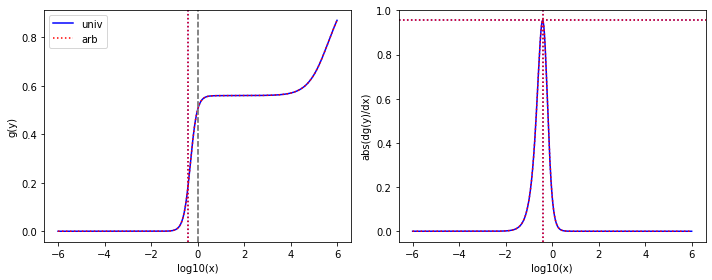

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 7.23162e-03 1.00000e-03
 1.70663e+01 2.60019e-02 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
1e-06 1e-06
7.23162e-06 7.231620000000001e-06
0.0170663 0.017066300000000003
0.0222908 0.0222908
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 58690470030434.76
From univ parameters, position and steepness are: 0.7896624483359564 0.958370355447015 2.802193197438455
From arb parameters, position and steepness are: 0.7896624483359564 0.958370355447015 2.802193197438455


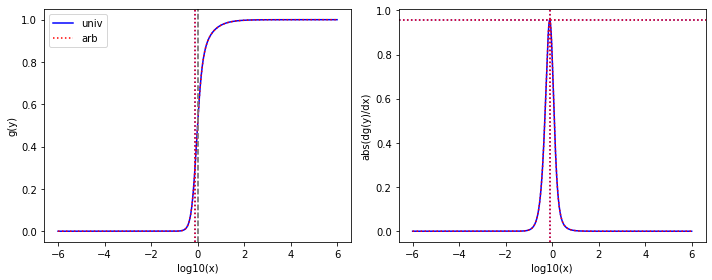

[6.53577e+00 6.53577e+00 4.57077e-01 1.75386e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.69560e-01]
found K1
found pairwise
found triplewise
0.06993468252401783 0.06993468252401781
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311538
0.7326711313280607 0.7326711313280606
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 252821106314.06433
From univ parameters, position and steepness are: 0.8924509326947622 0.9528806128301981 1.0589857672075385
From arb parameters, position and steepness are: 0.8924509326947622 0.9528806128301981 1.0589857672075387


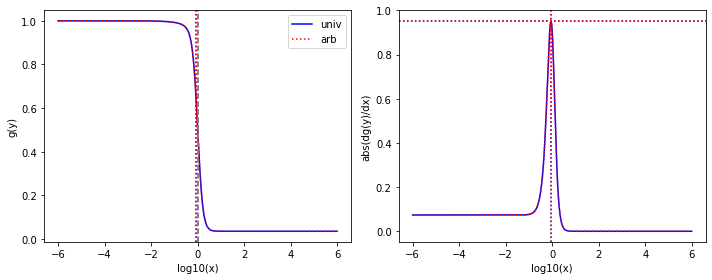

[1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.92396e-01 1.92396e-01
 4.58052e+02 4.58052e+02 3.86502e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.0 1.0
192.39600000000002 192.39600000000002
458052.0 458052.0
3.86502 3.86502
# maximal error is 0.0
min-max are 3.529814346881038e-10 3.179115649364369e+17
From univ parameters, position and steepness are: 1.398999866038345e-07 0.9692967858305629 118512.19440609052
From arb parameters, position and steepness are: 1.398999866038345e-07 0.9692967858305629 118512.19440609051


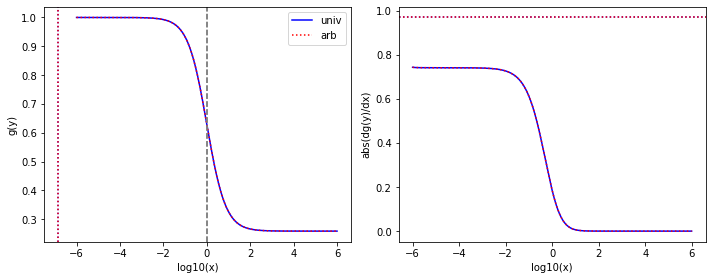

[1.00000e+03 7.84007e-03 5.13148e-03 2.96141e-03 1.00000e-03 1.00000e-03
 1.60139e+01 1.00000e-03 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
5.13148e-06 5.13148e-06
1e-06 9.999999999999997e-07
0.0160139 0.0160139
0.0222908 0.0222908
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 65899414693084.586
From univ parameters, position and steepness are: 0.7950680789775777 0.963433005947776 2.788133804974163
From arb parameters, position and steepness are: 0.7950680789775777 0.9634330059477759 2.788133804974163


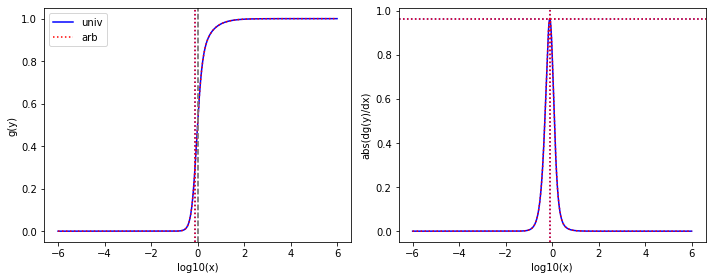

[6.53577e+00 6.53577e+00 3.98060e-01 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.70974e-01]
found K1
found pairwise
found triplewise
0.06090483600249091 0.06090483600249091
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311538
0.7326711313280607 0.7326711313280608
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 252821109147.31705
From univ parameters, position and steepness are: 0.8908607919992821 0.9616922519394652 1.0617875700007453
From arb parameters, position and steepness are: 0.8908607919992821 0.9616922519394652 1.0617875700007453


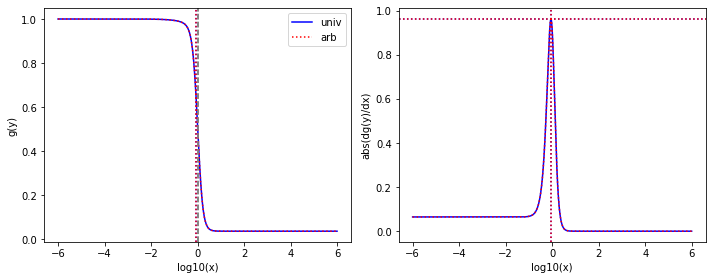

[8.56180e+00 2.47696e+00 1.42309e+00 1.00000e-03 2.73148e-01 6.74133e-03
 2.40627e-03 2.40627e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.16621388025882408 0.16621388025882408
0.03190310448737415 0.03190310448737415
0.00028104720969889506 0.00028104720969889506
0.00011679786960685838 0.00011679786960685838
# maximal error is 0.0
min-max are 3.529814346881038e-10 52716095166622.195
From univ parameters, position and steepness are: 0.004324162360459623 0.9785385297355624 20.381733233932813
From arb parameters, position and steepness are: 0.0043241623604596225 0.9785385297355624 20.38173323393281


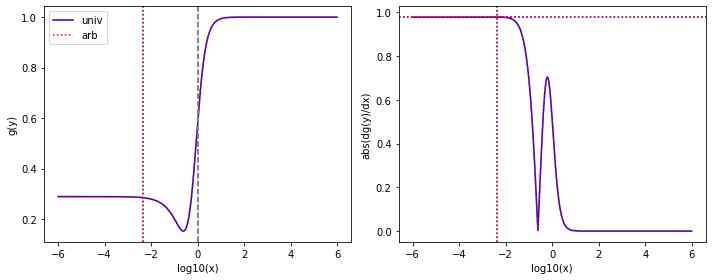

[9.46840e+02 1.75650e-03 1.00000e-03 1.00000e-03 1.52900e+00 1.52900e+00
 4.58052e+02 2.54125e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.0561446495712054e-06 1.0561446495712054e-06
0.0016148451691943727 0.0016148451691943727
0.48376916902538974 0.4837691690253897
1.0561446495712054e-06 1.0561446495712051e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 1.311534999803868e+16
From univ parameters, position and steepness are: 0.3806050896905978 0.9713539237556368 2.6517804909805185
From arb parameters, position and steepness are: 0.3806050896905978 0.9713539237556368 2.651780490980519


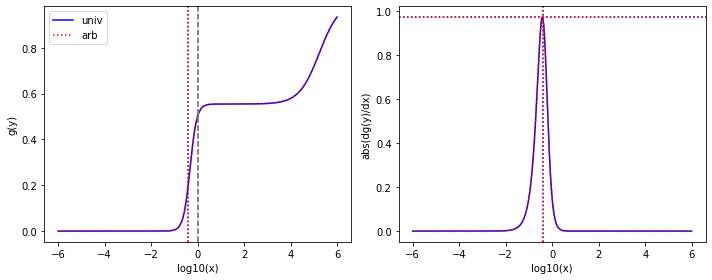

[1.00000e+03 1.00000e-03 3.80137e-03 1.00000e-03 1.00000e-03 1.00000e-03
 8.36771e+00 1.00000e-03 1.20616e+01 1.20616e+01]
found K1
found pairwise
found triplewise
3.80137e-06 3.80137e-06
1e-06 1e-06
0.00836771 0.00836771
0.0120616 0.0120616
# maximal error is 0.0
min-max are 2.498058915578641e-10 34186253931962.965
From univ parameters, position and steepness are: 0.8095485163546705 0.9776269924343267 3.2070548808236423
From arb parameters, position and steepness are: 0.8095485163546705 0.9776269924343267 3.2070548808236423


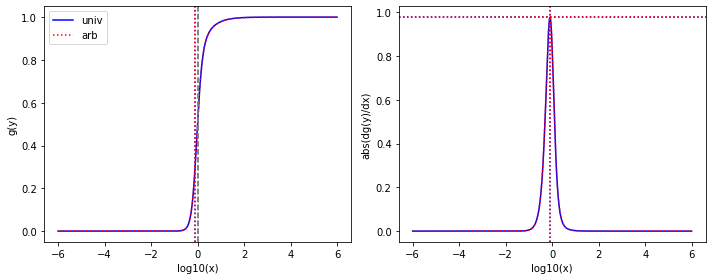

[6.53577e+00 6.53577e+00 3.80821e-01 1.03480e-03 2.12175e-03 1.59118e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.16599e-01]
found K1
found pairwise
found triplewise
0.058267197285094184 0.058267197285094184
0.000324636576868525 0.000324636576868525
0.00015300416018311538 0.00015300416018311535
0.7326711313280607 0.7326711313280606
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 536423316789.774
From univ parameters, position and steepness are: 0.8901858156759976 0.9762724714231386 1.0630506975051492
From arb parameters, position and steepness are: 0.8901858156759976 0.9762724714231386 1.0630506975051492


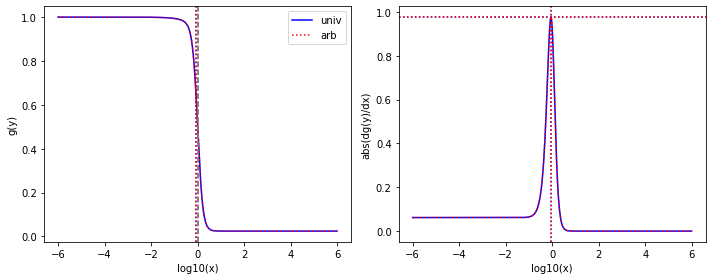

[1.29007e+00 1.00000e-03 2.88960e-01 3.72175e-02 7.45424e+02 3.10761e-02
 2.80343e+01 2.80343e+01 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.22398784562078025 0.22398784562078025
577.8167076205167 577.8167076205167
21.73083631120792 21.73083631120792
0.0007751517359523126 0.0007751517359523126
# maximal error is 0.0
min-max are 3.529814346881038e-10 9.547735595660115e+17
From univ parameters, position and steepness are: 0.00661637362685293 0.987183070041224 26.60385547205738
From arb parameters, position and steepness are: 0.006616373626852929 0.987183070041224 26.60385547205738


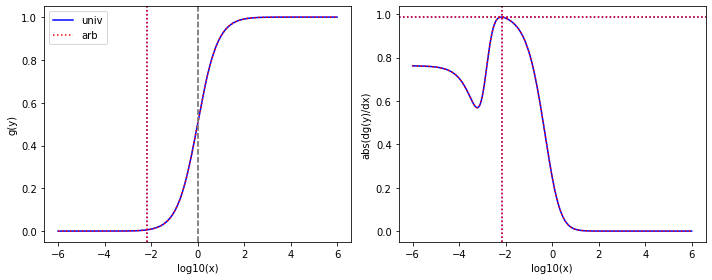

[4.09681e+02 4.09681e+02 1.53540e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.73213e+02 1.73213e+02 1.00000e+03 1.56377e-03]
found K1
found pairwise
found triplewise
3.7477940153436454e-06 3.7477940153436454e-06
2.4409235478335585e-06 2.4409235478335585e-06
0.42279969049089416 0.4227996904908941
2.4409235478335582 2.4409235478335587
# maximal error is 4.440892098500626e-16
min-max are 2.498058915578641e-10 699084583750875.2
From univ parameters, position and steepness are: 0.8136188916879925 0.9818388002145902 0.8471256026366553
From arb parameters, position and steepness are: 0.8136188916879925 0.9818388002145902 0.8471256026366553


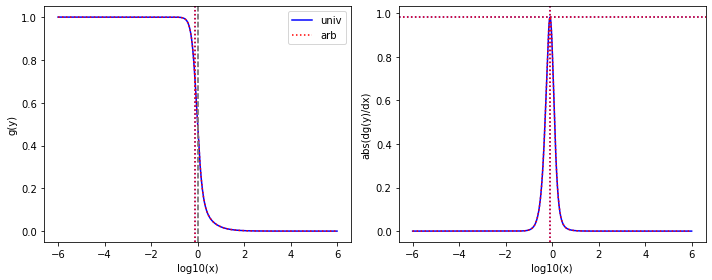

[6.53577e+00 6.53577e+00 1.55438e+00 2.50636e-03 1.12520e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.87444e+02 1.00000e-03]
found K1
found pairwise
found triplewise
0.2378266065054309 0.2378266065054309
0.00017216028103804142 0.00017216028103804142
0.00015300416018311538 0.00015300416018311538
74.58095985629849 74.58095985629849
# maximal error is 0.0
min-max are 3.529814346881038e-10 284474270745.4696
From univ parameters, position and steepness are: 0.8927639173213353 0.9850013287674322 0.3333552826981198
From arb parameters, position and steepness are: 0.8927639173213353 0.9850013287674322 0.3333552826981198


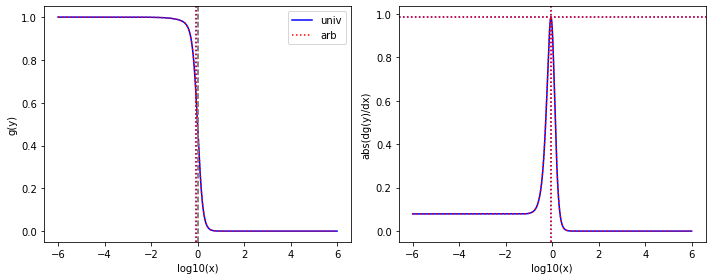

[1.00000e+03 8.02497e-03 1.71988e-03 1.00000e-03 1.00000e-03 1.00000e-03
 3.61068e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.7198800000000001e-06 1.7198800000000001e-06
1e-06 1e-06
0.361068 0.36106800000000006
1e-06 9.999999999999997e-07
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 1458699799820772.2
From univ parameters, position and steepness are: 0.00019254325398459216 0.9994257221489261 361071.79514742235
From arb parameters, position and steepness are: 0.00019254325398459216 0.9994257221489261 361071.7951474224


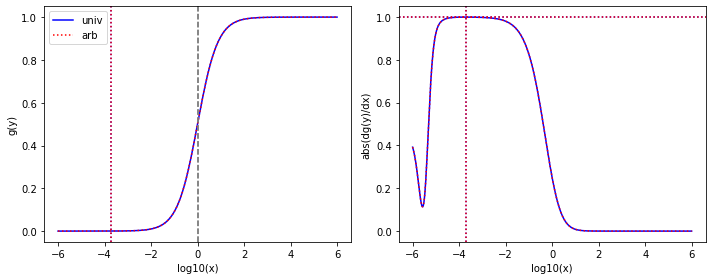

[5.24058e+02 4.30247e-03 1.13755e-03 1.13755e-03 7.39721e-01 3.62192e-02
 4.29264e+02 2.36647e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.1706566830389003e-06 2.1706566830389003e-06
0.00141152506020326 0.0014115250602032598
0.8191154414206061 0.8191154414206061
1.9081857351667183e-06 1.9081857351667183e-06
# maximal error is 2.168404344971009e-19
min-max are 2.498058915578641e-10 1.1463983507920884e+16
From univ parameters, position and steepness are: 0.37062988083282805 0.990476622434613 2.288272345974935
From arb parameters, position and steepness are: 0.37062988083282794 0.9904766224346132 2.288272345974936


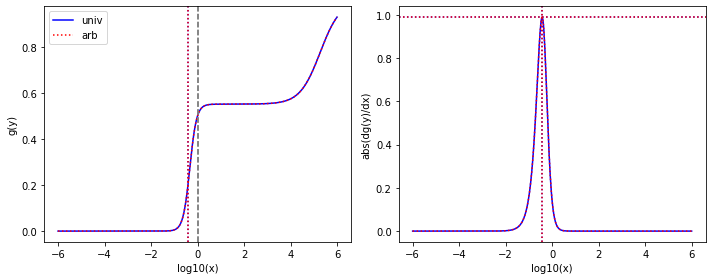

[1.45223e+01 1.00000e-03 4.25376e-02 1.00000e-03 1.00000e-03 1.00000e-03
 3.30283e+00 1.19112e-02 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
0.0029291227973530366 0.0029291227973530366
6.88596159010625e-05 6.88596159010625e-05
0.2274316051865063 0.2274316051865063
1.5349359261274043 1.5349359261274043
# maximal error is 0.0
min-max are 3.529814346881038e-10 113782250471.59602
From univ parameters, position and steepness are: 0.829349371626005 0.9985190789688003 0.9381554849217135
From arb parameters, position and steepness are: 0.829349371626005 0.9985190789688003 0.9381554849217135


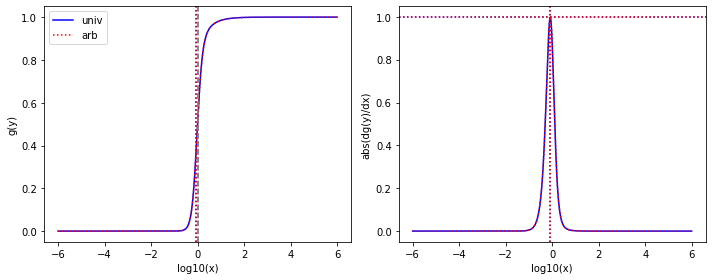

[6.53577e+00 6.53577e+00 1.33068e+00 3.31870e-03 1.13571e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.87444e+02 1.00000e-03]
found K1
found pairwise
found triplewise
0.20359957587246796 0.20359957587246796
0.00017376835476156597 0.000173768354761566
0.00015300416018311538 0.00015300416018311535
74.58095985629849 74.58095985629849
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 287131432537.6549
From univ parameters, position and steepness are: 0.8909152558499821 0.9960631817866065 0.33437192934729487
From arb parameters, position and steepness are: 0.8909152558499821 0.9960631817866065 0.33437192934729487


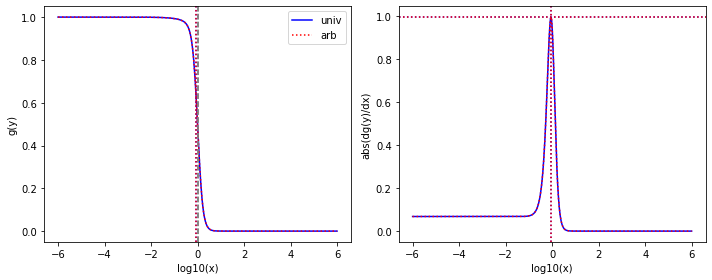

[1.00000e+03 5.62936e-02 1.82201e-02 2.26136e-03 1.33771e-03 1.33771e-03
 5.04012e+02 1.00000e-03 1.09970e-02 1.09970e-02]
found K1
found pairwise
found triplewise
1.82201e-05 1.82201e-05
1.33771e-06 1.33771e-06
0.504012 0.504012
1.0997e-05 1.0997e-05
# maximal error is 0.0
min-max are 2.498058915578641e-10 1625750246419506.5
From univ parameters, position and steepness are: 0.00014163080920078663 1.0015425871700547 45835.71007279551
From arb parameters, position and steepness are: 0.0001416308092007866 1.0015425871700547 45835.710072795504


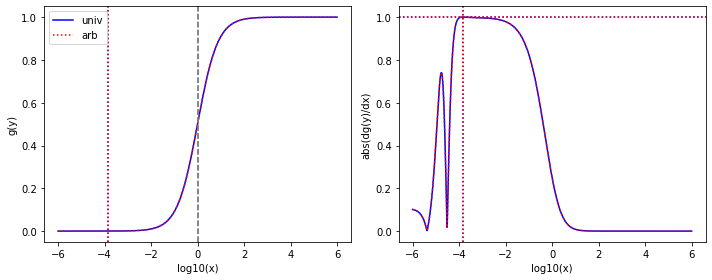

[1.43700e+00 1.43700e+00 4.71440e-01 1.00000e-03 1.00000e-03 1.00000e-03
 1.09568e-02 1.00000e-03 9.76193e+02 6.36580e-03]
found K1
found pairwise
found triplewise
0.3280723729993041 0.3280723729993041
0.0006958942240779402 0.0006958942240779402
0.007624773834377174 0.007624773834377174
679.3270702853166 679.3270702853166
# maximal error is 0.0
min-max are 3.529814346881038e-10 1149882449680.9734
From univ parameters, position and steepness are: 0.8901294125191724 1.0008229254618526 0.1927160682159132
From arb parameters, position and steepness are: 0.8901294125191724 1.0008229254618526 0.1927160682159132


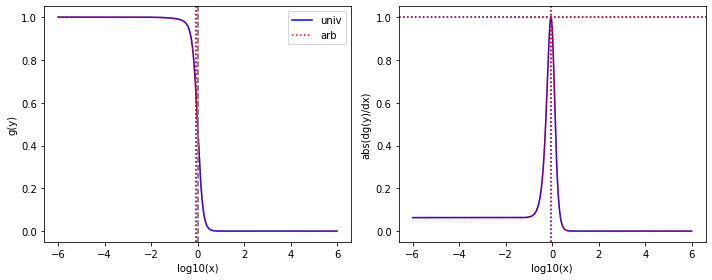

[1.36376e+02 2.55487e-02 4.24470e-01 1.00000e-03 1.00000e-03 1.00000e-03
 1.49770e+01 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0031124978001994485 0.0031124978001994485
7.332668504722238e-06 7.332668504722238e-06
0.10982137619522496 0.10982137619522496
7.332668504722238e-06 7.332668504722239e-06
# maximal error is 8.470329472543003e-22
min-max are 3.529814346881038e-10 12116269143.359821
From univ parameters, position and steepness are: 0.00034398493545972767 1.0110994766254324 14980.612198680812
From arb parameters, position and steepness are: 0.00034398493545972767 1.0110994766254324 14980.61219868081


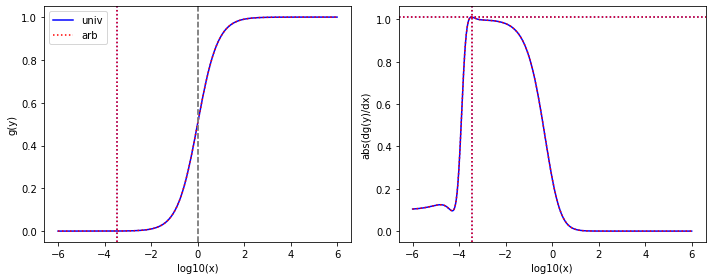

[1.00000e+03 2.71362e-01 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 2.77368e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1e-06 1e-06
0.277368 0.27736800000000006
1e-06 1.0000000000000002e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 1116252163776996.4
From univ parameters, position and steepness are: 0.36045226712743117 1.011102210622519 3.3764177115006717
From arb parameters, position and steepness are: 0.360452267127431 1.0111022106225194 3.3764177115006735


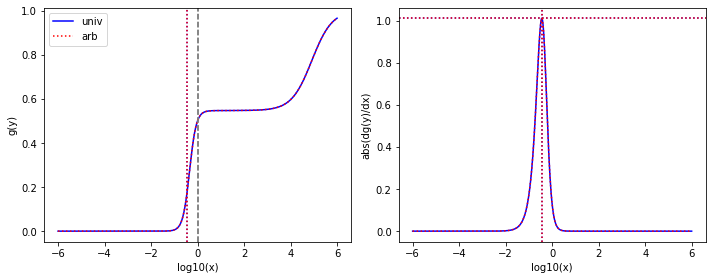

[2.56813e+02 2.56813e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 7.58282e+01 7.58282e+01 7.44194e+02 1.00000e-03]
found K1
found pairwise
found triplewise
3.893883876595033e-06 3.893883876595033e-06
3.893883876595033e-06 3.893883876595033e-06
0.2952662053712234 0.2952662053712234
2.8978050176587633 2.8978050176587637
# maximal error is 4.440892098500626e-16
min-max are 2.498058915578641e-10 305167400024628.25
From univ parameters, position and steepness are: 0.8391419656419674 1.0104249960889475 0.7932502964482755
From arb parameters, position and steepness are: 0.8391419656419675 1.0104249960889475 0.7932502964482755


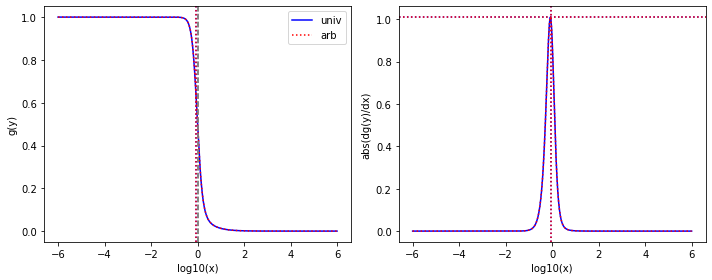

[6.53577e+00 6.53577e+00 1.00000e-03 1.00000e-03 6.21413e+00 2.00357e-01
 1.00000e-03 1.00000e-03 1.00000e+03 2.32167e+00]
found K1
found pairwise
found triplewise
0.00015300416018311538 0.00015300416018311538
0.9507877419187027 0.9507877419187029
0.00015300416018311538 0.00015300416018311535
153.00416018311537 153.00416018311535
# maximal error is 2.842170943040401e-14
min-max are 3.529814346881038e-10 1571063945913228.5
From univ parameters, position and steepness are: 0.8801740686891849 1.0188630790783322 0.27924542792994744
From arb parameters, position and steepness are: 0.8801740686891849 1.0188630790783322 0.27924542792994744


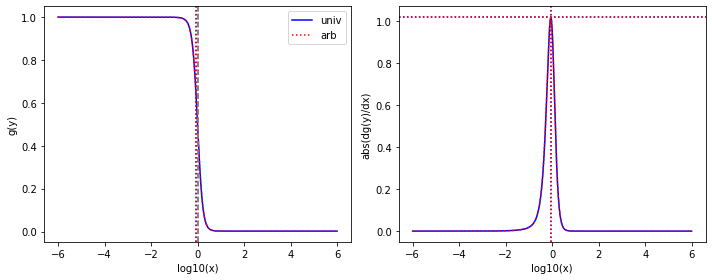

[1.00000e+03 5.89679e-01 5.92687e-01 1.42111e-03 4.64330e-02 1.00000e-03
 4.65198e+02 1.00000e-03 1.77251e-01 1.77251e-01]
found K1
found pairwise
found triplewise
0.0005926869999999999 0.0005926869999999999
4.6433e-05 4.6433e-05
0.465198 0.465198
0.000177251 0.00017725100000000001
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 76724929028.84123
From univ parameters, position and steepness are: 0.001280097678436252 1.0265302501103757 2627.2636955753524
From arb parameters, position and steepness are: 0.001280097678436252 1.0265302501103757 2627.2636955753524


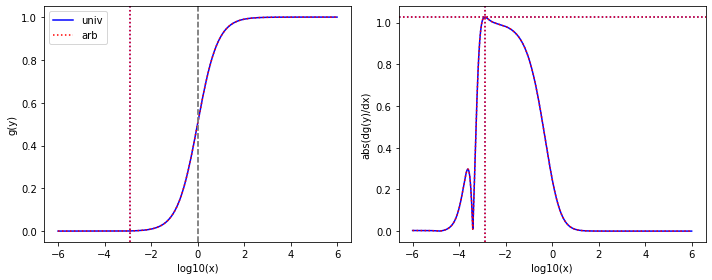

[2.56813e+02 2.56813e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 7.58282e+01 7.58282e+01 1.00000e+03 1.00000e-03]
found K1
found pairwise
found triplewise
3.893883876595033e-06 3.893883876595033e-06
3.893883876595033e-06 3.893883876595033e-06
0.2952662053712234 0.2952662053712234
3.8938838765950323 3.8938838765950328
# maximal error is 4.440892098500626e-16
min-max are 2.498058915578641e-10 305167400024628.25
From univ parameters, position and steepness are: 0.8472476684438557 1.020354349526191 0.7316185498985847
From arb parameters, position and steepness are: 0.8472476684438557 1.020354349526191 0.7316185498985847


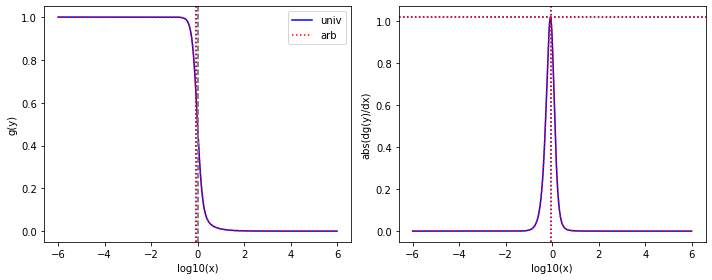

[6.53577e+00 6.53577e+00 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 4.78857e+00 1.70974e-01]
found K1
found pairwise
found triplewise
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311538
0.7326711313280607 0.7326711313280607
# maximal error is 0.0
min-max are 3.529814346881038e-10 252821128209.13525
From univ parameters, position and steepness are: 0.8800057055206628 1.0269942430097123 1.081013383641314
From arb parameters, position and steepness are: 0.8800057055206628 1.0269942430097123 1.081013383641314


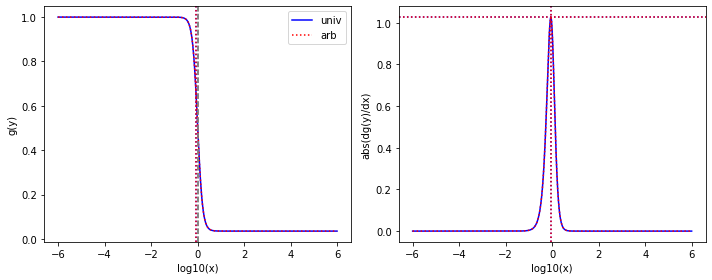

[1.00000e+03 5.76172e-03 1.00000e-03 1.00000e-03 2.25905e-03 1.00000e-03
 2.77368e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
2.25905e-06 2.2590499999999996e-06
0.277368 0.27736800000000006
1e-06 1e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 492661098499845.3
From univ parameters, position and steepness are: 7.5005028459054135e-06 1.036421823563029 277369.19624133233
From arb parameters, position and steepness are: 7.500502845905415e-06 1.036421823563029 277369.19624133233


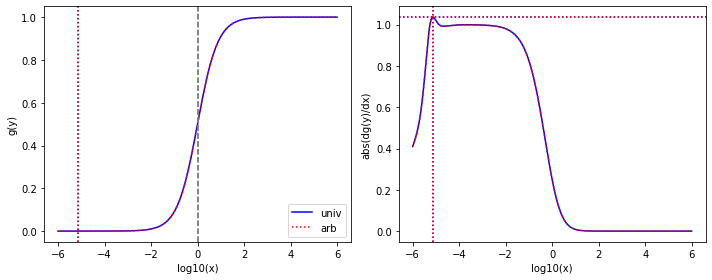

[4.29216e-01 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.43150e+02 2.41111e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0023298292701110866 0.0023298292701110866
0.0023298292701110866 0.0023298292701110866
1032.4638410497278 1032.4638410497278
0.0023298292701110866 0.0023298292701110866
# maximal error is 0.0
min-max are 7.027031419536454e-09 3849766372183.0894
From univ parameters, position and steepness are: 0.35041485563250213 1.0304206630457435 0.22406937616407635
From arb parameters, position and steepness are: 0.3504148556325021 1.0304206630457438 0.2240693761640764


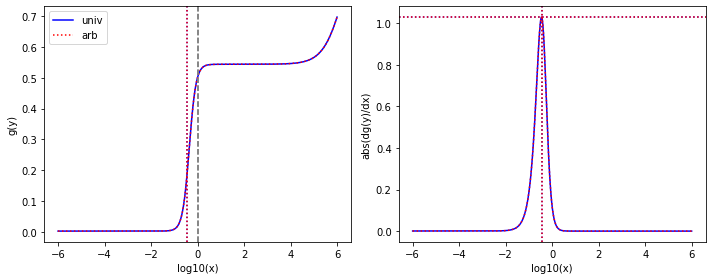

[9.03587e-02 9.03587e-02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 7.65918e+00 7.65918e+00 1.00000e+03 1.00000e-03]
found K1
found pairwise
found triplewise
0.01106700295599649 0.011067002955996491
0.01106700295599649 0.01106700295599649
84.76416770050919 84.76416770050919
11067.00295599649 11067.002955996491
# maximal error is 1.8189894035458565e-12
min-max are 3.529814346881038e-10 18286909343333.297
From univ parameters, position and steepness are: 0.8557452698921013 1.0311347243079205 0.09949946544924788
From arb parameters, position and steepness are: 0.8557452698921013 1.0311347243079205 0.09949946544924788


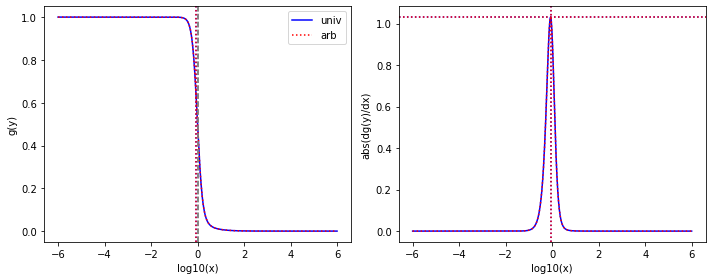

[6.53577e+00 6.53577e+00 1.00000e-03 1.00000e-03 2.13758e-03 1.00000e-03
 1.40009e-03 1.00000e-03 6.84215e+00 1.70974e-01]
found K1
found pairwise
found triplewise
0.00015300416018311538 0.00015300416018311538
0.0003270586327242238 0.0003270586327242238
0.00021421959463077802 0.000214219594630778
1.0468774145969029 1.0468774145969026
# maximal error is 2.220446049250313e-16
min-max are 3.529814346881038e-10 540425494982.8777
From univ parameters, position and steepness are: 0.8800278038875239 1.0383231244826594 0.9886636906056746
From arb parameters, position and steepness are: 0.8800278038875239 1.0383231244826594 0.9886636906056746


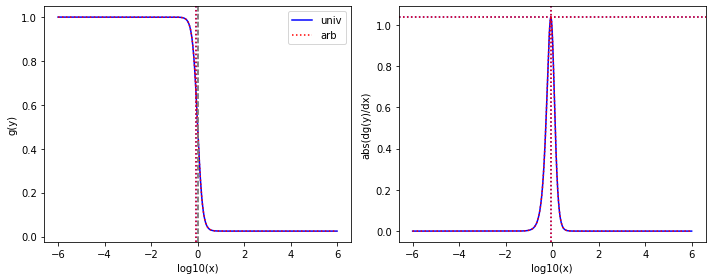

[2.76338e+00 2.76338e+00 9.18024e-02 3.55145e-03 3.92315e-02 3.92315e-02
 9.94922e+02 9.94922e+02 3.87629e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.03322105537421564 0.03322105537421564
0.014196925504273752 0.014196925504273752
360.03806932090407 360.03806932090407
14.027350563440423 14.027350563440423
# maximal error is 0.0
min-max are 3.529814346881038e-10 23458735026385.777
From univ parameters, position and steepness are: 0.006703000228130525 1.046507522902536 25.66690220123907
From arb parameters, position and steepness are: 0.006703000228130524 1.046507522902536 25.66690220123907


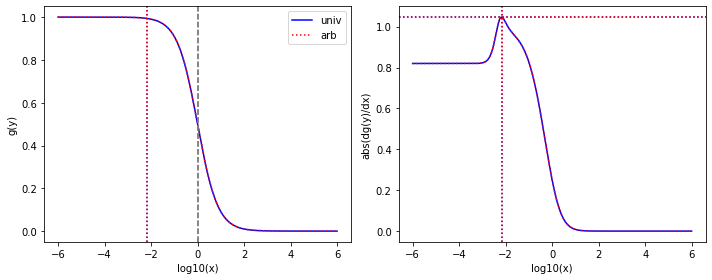

[6.53577e+00 6.53577e+00 1.00000e-03 1.00000e-03 3.55824e-03 1.00000e-03
 1.00000e-03 1.00000e-03 7.55495e+00 1.70974e-01]
found K1
found pairwise
found triplewise
0.00015300416018311538 0.00015300416018311538
0.0005444255229299684 0.0005444255229299684
0.00015300416018311538 0.00015300416018311535
1.1559387799754275 1.1559387799754275
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 899598493541.9106
From univ parameters, position and steepness are: 0.8800371354883824 1.0407403037815455 0.9644313228634241
From arb parameters, position and steepness are: 0.8800371354883824 1.0407403037815455 0.9644313228634241


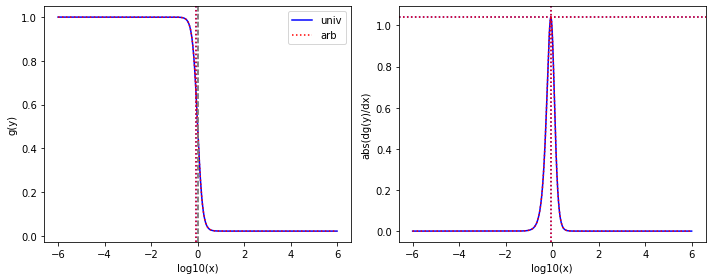

[1.00000e+03 3.22064e-01 4.46996e+01 7.30339e-02 1.00000e-03 1.00000e-03
 4.65198e+02 1.00000e-03 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
0.0446996 0.0446996
1e-06 1e-06
0.465198 0.465198
0.000174587 0.00017458699999999997
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 4178447537.33951
From univ parameters, position and steepness are: 0.0009812511853372367 1.0560316014228885 2666.2681007096166
From arb parameters, position and steepness are: 0.0009812511853372367 1.0560316014228885 2666.268100709617


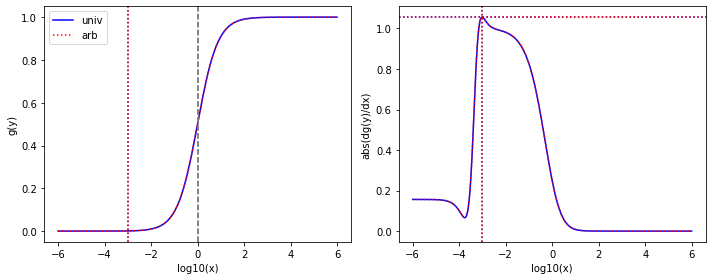

[1.00000e+03 1.35319e-03 2.12596e-03 1.00000e-03 1.00000e-03 1.00000e-03
 2.69319e+02 1.45490e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.1259600000000002e-06 2.1259600000000002e-06
1e-06 1e-06
0.26931900000000003 0.2693190000000001
1e-06 1e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 1090408783138279.5
From univ parameters, position and steepness are: 0.3426232727753605 1.0511388540074276 3.5871563216127607
From arb parameters, position and steepness are: 0.34262327277536037 1.0511388540074278 3.587156321612762


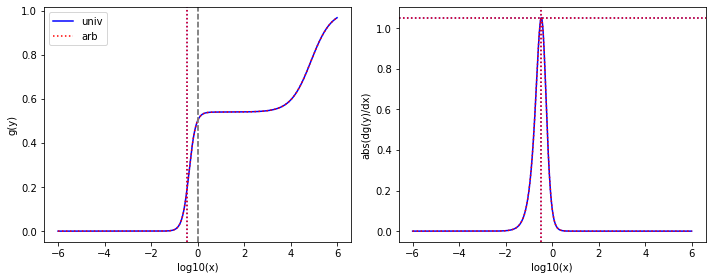

[7.54889e+02 2.94564e-03 3.60004e-02 1.00000e-03 1.18335e-01 1.45429e-03
 1.76469e+00 1.19112e-02 2.22908e+01 2.22908e+01]
found K1
found pairwise
found triplewise
4.768966033416834e-05 4.768966033416834e-05
0.00015675814589959582 0.00015675814589959585
0.002337681433959165 0.0023376814339591645
0.029528579698472227 0.02952857969847223
# maximal error is 3.469446951953614e-18
min-max are 2.498058915578641e-10 1271097903737316.8
From univ parameters, position and steepness are: 0.869840813662297 1.0502249562634776 2.432720487409212
From arb parameters, position and steepness are: 0.869840813662297 1.0502249562634776 2.4327204874092114


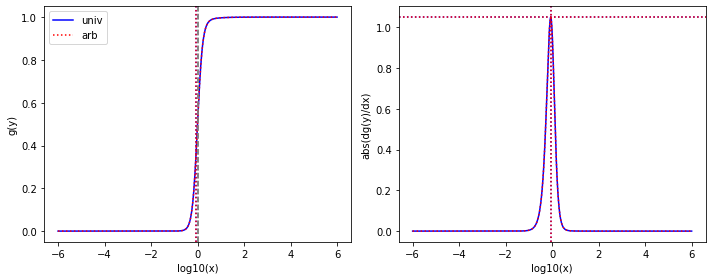

[6.53577e+00 6.53577e+00 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e-03 1.00000e-03 1.42415e+01 1.70974e-01]
found K1
found pairwise
found triplewise
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311538
2.1790087472478374 2.1790087472478374
# maximal error is 0.0
min-max are 3.529814346881038e-10 252821128209.13525
From univ parameters, position and steepness are: 0.8800561927173668 1.0523174717427513 0.823131924152897
From arb parameters, position and steepness are: 0.8800561927173668 1.0523174717427513 0.823131924152897


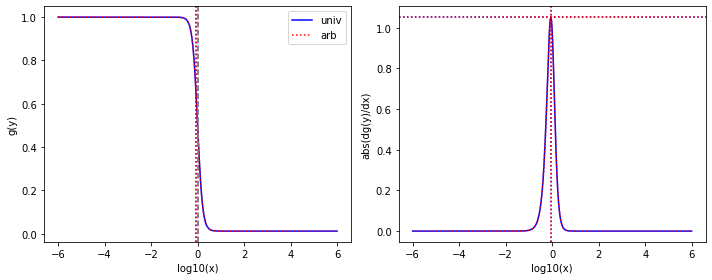

[1.00000e+03 1.24729e-02 1.06635e-03 1.00000e-03 9.01244e-01 4.35702e-03
 4.41163e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.06635e-06 1.06635e-06
0.000901244 0.000901244
0.441163 0.44116299999999997
1e-06 1e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 7319647452942036.0
From univ parameters, position and steepness are: 7.331976259035004e-07 1.0632339087833773 441171.7984595353
From arb parameters, position and steepness are: 7.331976259035004e-07 1.0632339087833775 441171.7984595353


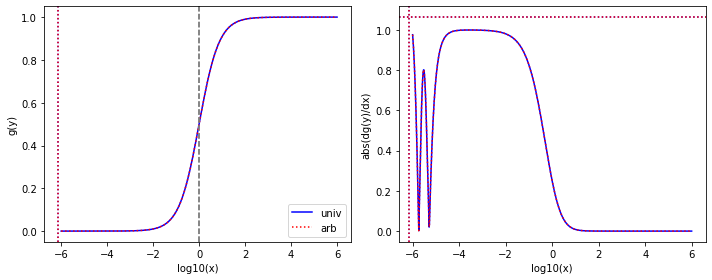

[6.53577e+00 6.53577e+00 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 3.27277e-03 1.00000e-03 4.78857e+00 1.00000e-03]
found K1
found pairwise
found triplewise
0.00015300416018311538 0.00015300416018311538
0.00015300416018311538 0.00015300416018311538
0.0005007474253224945 0.0005007474253224945
0.7326711313280607 0.7326711313280607
# maximal error is 0.0
min-max are 3.529814346881038e-10 252821128209.13525
From univ parameters, position and steepness are: 0.8799925727896192 1.0646811818983424 1.0808946649233298
From arb parameters, position and steepness are: 0.8799925727896192 1.0646811818983424 1.0808946649233298


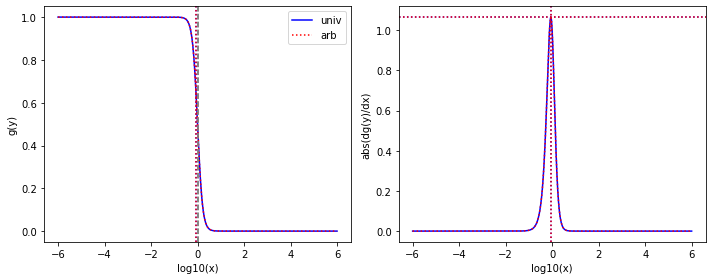

[6.53577e+00 6.53577e+00 3.38669e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.98539e-03 1.00000e-03 4.78857e+00 1.42470e-03]
found K1
found pairwise
found triplewise
0.000518177659250555 0.0005181776592505551
0.00015300416018311538 0.00015300416018311538
0.0003037729295859554 0.0003037729295859554
0.7326711313280607 0.7326711313280607
# maximal error is 1.0842021724855044e-19
min-max are 3.529814346881038e-10 252821128094.5565
From univ parameters, position and steepness are: 0.8800613948863721 1.064239687668895 1.0808551773388446
From arb parameters, position and steepness are: 0.8800613948863721 1.064239687668895 1.0808551773388446


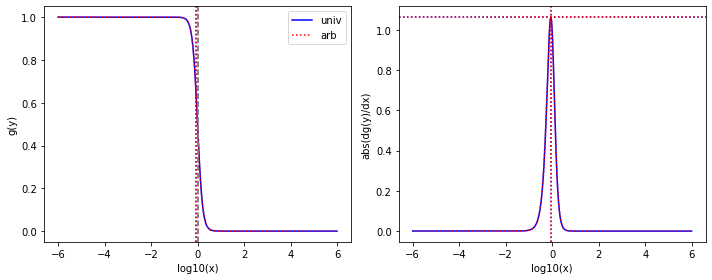

[1.00000e+03 5.76172e-03 7.04504e-03 1.59007e-03 1.36354e-03 1.36354e-03
 2.51098e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
7.04504e-06 7.04504e-06
1.3635400000000002e-06 1.3635400000000002e-06
0.251098 0.251098
1e-06 9.999999999999997e-07
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 757955755560848.0
From univ parameters, position and steepness are: 6.206102993670968e-06 1.0745954323157734 251098.89351245516
From arb parameters, position and steepness are: 6.2061029936709635e-06 1.0745954323157734 251098.89351245525


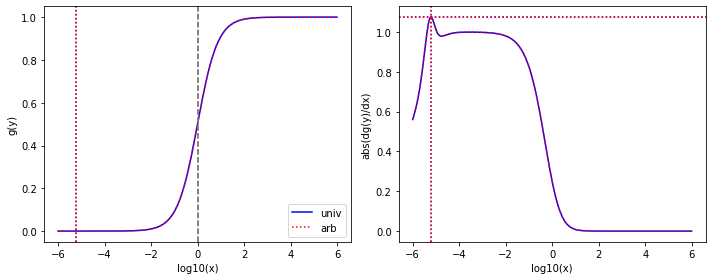

[1.00000e+03 4.33034e-03 2.14615e-03 2.14615e-03 1.00000e-03 1.00000e-03
 4.41163e+02 2.36647e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.1461499999999998e-06 2.1461499999999998e-06
1e-06 1e-06
0.441163 0.441163
1e-06 9.999999999999997e-07
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 1786357957028922.0
From univ parameters, position and steepness are: 0.3314662632839928 1.078868739016761 3.1454538562244094
From arb parameters, position and steepness are: 0.3314662632839928 1.078868739016761 3.145453856224409


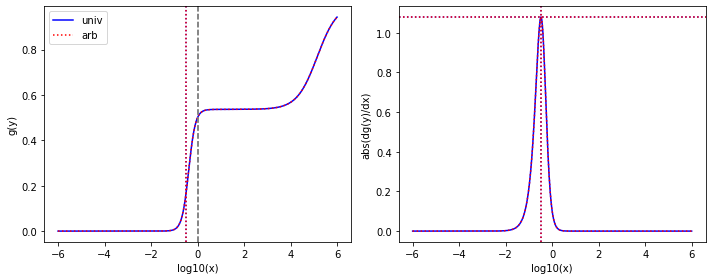

[1.00000e+03 5.52114e-02 3.26908e+00 2.16884e-01 1.00000e-03 1.00000e-03
 4.65198e+02 1.00000e-03 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
0.00326908 0.00326908
1e-06 1e-06
0.465198 0.465198
0.000174587 0.00017458700000000003
# maximal error is 2.710505431213761e-20
min-max are 7.027031419536454e-09 3143127512.887993
From univ parameters, position and steepness are: 0.0006869778095386949 1.0877689693856365 2664.845442492635
From arb parameters, position and steepness are: 0.0006869778095386948 1.0877689693856363 2664.8454424926354


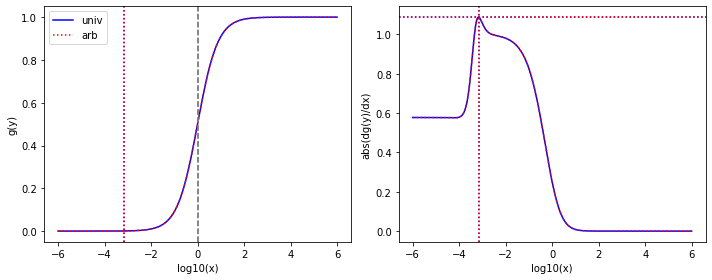

[2.17943e+02 4.33034e-03 2.14615e-03 1.00000e-03 2.97312e-01 1.00000e-03
 4.41163e+02 2.36647e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
9.847299523269845e-06 9.847299523269845e-06
0.001364173201249868 0.001364173201249868
2.024212752875752 2.024212752875752
4.588355670978191e-06 4.588355670978191e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 1.1079071937005986e+16
From univ parameters, position and steepness are: 0.33087179344694645 1.0800960524884902 1.896144313898244
From arb parameters, position and steepness are: 0.3308717934469465 1.0800960524884902 1.896144313898244


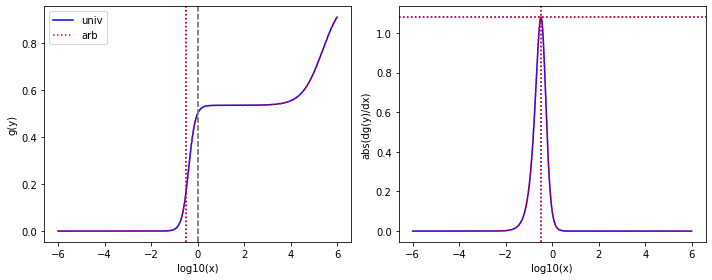

[1.00000e+03 1.00000e-03 3.67202e-03 2.18479e-03 1.67554e-03 1.67554e-03
 2.98461e+02 1.00000e-03 1.65480e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.67202e-06 3.67202e-06
1.6755400000000001e-06 1.6755400000000001e-06
0.29846100000000003 0.29846100000000003
1.6548e-06 1.6548e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 721454263406834.8
From univ parameters, position and steepness are: 6.006860661167297e-06 1.0905546815305323 180359.36557966357
From arb parameters, position and steepness are: 6.006860661167298e-06 1.0905546815305323 180359.36557966354


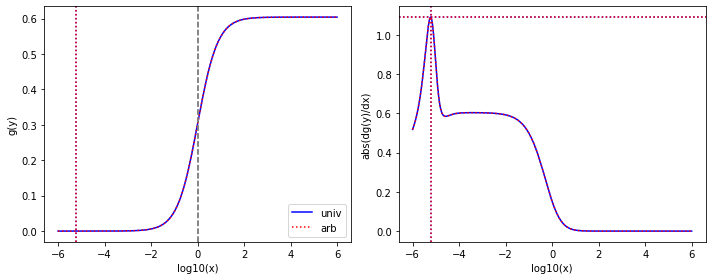

[2.59620e+01 1.00000e-03 1.00000e-03 1.00000e-03 1.45557e+00 1.00000e-03
 4.41163e+02 2.36647e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.8517833757029506e-05 3.8517833757029506e-05
0.05606540328171944 0.05606540328171944
16.99264309375241 16.99264309375241
3.8517833757029506e-05 3.85178337570295e-05
# maximal error is 6.776263578034403e-21
min-max are 2.498058915578641e-10 4.553484570302431e+17
From univ parameters, position and steepness are: 0.32575241409537226 1.0909002112648536 0.9468702755353354
From arb parameters, position and steepness are: 0.3257524140953719 1.0909002112648545 0.9468702755353364


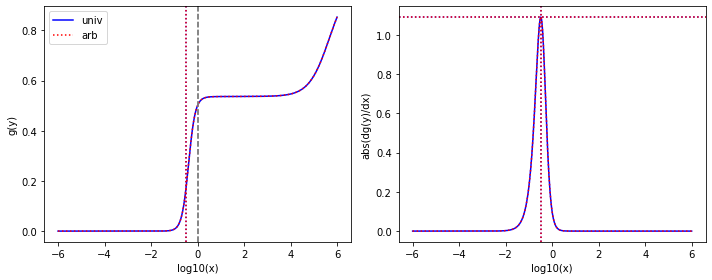

[2.88194e+02 1.13383e+02 5.26857e+02 1.00000e-03 1.00000e+03 1.00000e-03
 7.00059e+02 7.00059e+02 2.18920e+00 1.00000e-03]
found K1
found pairwise
found triplewise
1.828133132542662 1.828133132542662
3.469884869220039 3.4698848692200386
2.429124131661311 2.429124131661311
0.00759627195569651 0.00759627195569651
# maximal error is 4.440892098500626e-16
min-max are 3.529814346881038e-10 5733573092974130.0
From univ parameters, position and steepness are: 0.002724033343858055 1.102707597718196 1.5327289362028889
From arb parameters, position and steepness are: 0.0027240333438580434 1.1027075977181962 1.532728936202889


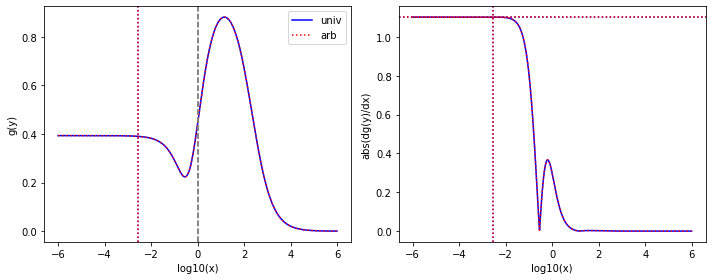

[2.22723e+02 1.00000e-03 7.79226e-01 1.00000e-03 5.71358e-01 8.97194e-02
 4.41163e+02 2.35387e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0034986328309155315 0.0034986328309155315
0.002565330028780144 0.002565330028780144
1.9807698351764298 1.98076983517643
4.489882050798525e-06 4.489882050798525e-06
# maximal error is 2.220446049250313e-16
min-max are 3.529814346881038e-10 4238903436684.103
From univ parameters, position and steepness are: 0.3211147975144113 1.1053399040486176 1.9682085333414037
From arb parameters, position and steepness are: 0.32111479751441147 1.1053399040486172 1.9682085333414023


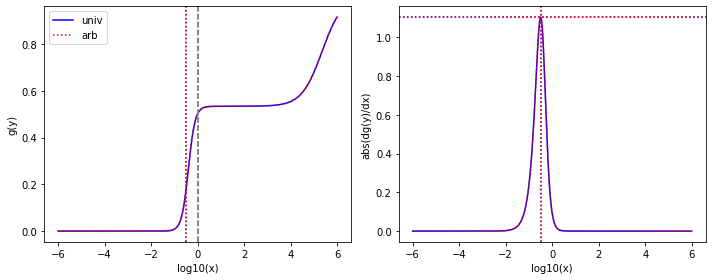

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 1.57912e-03 1.00000e-03
 2.98461e+02 1.00000e-03 1.49089e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1.57912e-06 1.57912e-06
0.29846100000000003 0.29846100000000003
1.49089e-06 1.4908899999999997e-06
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 759154776924981.8
From univ parameters, position and steepness are: 6.722245307083838e-06 1.1130497536611286 200188.4164189949
From arb parameters, position and steepness are: 6.722245307083838e-06 1.1130497536611283 200188.4164189949


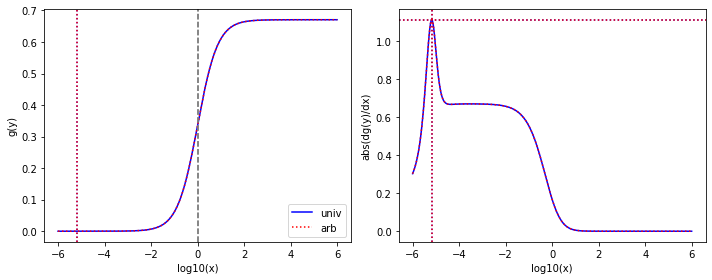

[1.00000e+03 1.00000e-03 2.93821e-02 1.00000e-03 1.30738e+01 3.69166e-03
 4.41163e+02 2.36647e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.93821e-05 2.93821e-05
0.0130738 0.0130738
0.441163 0.44116299999999997
1e-06 9.999999999999997e-07
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 1.0618108531535174e+17
From univ parameters, position and steepness are: 0.316439413013235 1.1116235364249722 3.2870663282084864
From arb parameters, position and steepness are: 0.3164394130132351 1.1116235364249722 3.2870663282084864


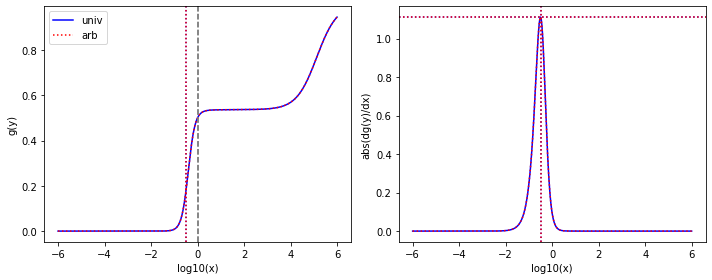

[1.00000e+03 4.43999e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 2.98461e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1e-06 1e-06
0.29846100000000003 0.2984610000000001
1e-06 1e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 1201139774802516.8
From univ parameters, position and steepness are: 5.494518657179979e-06 1.1298922636590467 298461.65032724774
From arb parameters, position and steepness are: 5.494518657179977e-06 1.1298922636590465 298461.65032724786


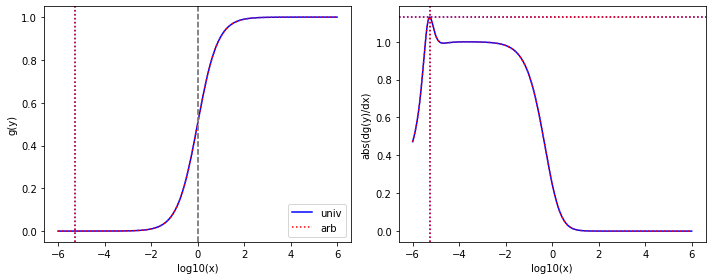

[1.00000e+03 1.00000e-03 7.45444e-01 1.00000e-03 1.83675e+01 1.00000e-03
 4.41163e+02 2.36647e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.000745444 0.000745444
0.0183675 0.0183675
0.441163 0.441163
1e-06 1e-06
# maximal error is 0.0
min-max are 3.529814346881038e-10 30350114611109.406
From univ parameters, position and steepness are: 0.31019001321162776 1.1261246758098271 3.35053243229871
From arb parameters, position and steepness are: 0.3101900132116278 1.1261246758098271 3.3505324322987096


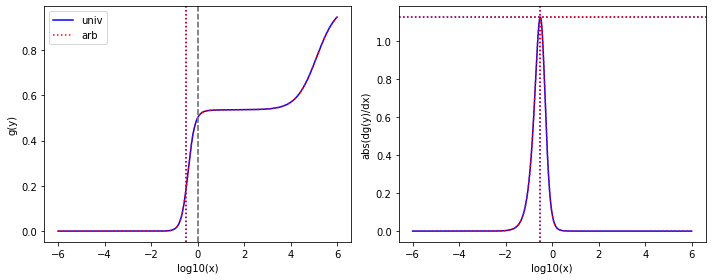

[3.70016e+01 3.70016e+01 2.85851e-02 6.82762e-03 1.58973e-03 1.00000e-03
 8.03722e+02 8.03722e+02 4.15359e-01 1.00000e-03]
found K1
found pairwise
found triplewise
0.0007725368632707773 0.0007725368632707773
4.2963817780852715e-05 4.2963817780852715e-05
21.721276917754906 21.721276917754906
0.011225433494767793 0.011225433494767793
# maximal error is 0.0
min-max are 7.027031419536454e-09 70992516924.65392
From univ parameters, position and steepness are: 2.082308162212694e-05 1.1394219084730486 1935.0056221525135
From arb parameters, position and steepness are: 2.082308162212696e-05 1.1394219084730484 1935.0056221525133


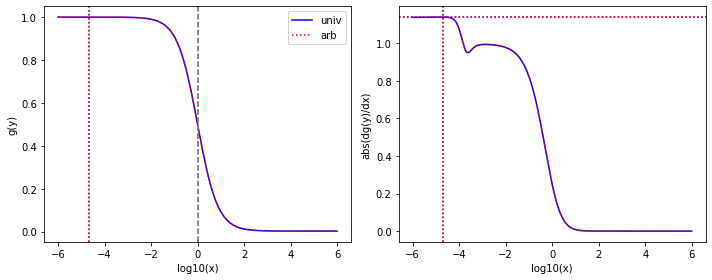

[3.08797e+01 6.65584e-03 1.57641e-03 1.00000e-03 1.32013e-01 3.58482e-03
 4.41163e+02 2.34144e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
5.10500425846106e-05 5.10500425846106e-05
0.004275073915873535 0.004275073915873535
14.286505374080708 14.286505374080708
3.238373429793683e-05 3.238373429793684e-05
# maximal error is 6.776263578034403e-21
min-max are 2.498058915578641e-10 3.471895234604661e+16
From univ parameters, position and steepness are: 0.3124371256061406 1.1314093095312976 1.0468332540598206
From arb parameters, position and steepness are: 0.31243712560614045 1.1314093095312983 1.0468332540598213


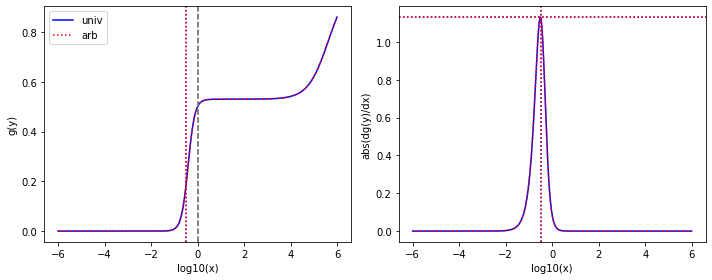

[3.24802e+01 3.24802e+01 3.76387e-01 3.55985e-02 2.05212e-01 1.00000e-03
 8.16945e+02 8.16945e+02 1.58835e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.011588198348532336 0.011588198348532338
0.0063180645439375365 0.0063180645439375365
25.15209265952796 25.152092659527955
0.4890210035652489 0.48902100356524886
# maximal error is 3.552713678800501e-15
min-max are 3.529814346881038e-10 10439852011591.355
From univ parameters, position and steepness are: 0.0075703131469141705 1.1421752039893565 51.433322117627604
From arb parameters, position and steepness are: 0.007570313146914169 1.1421752039893565 51.43332211762762


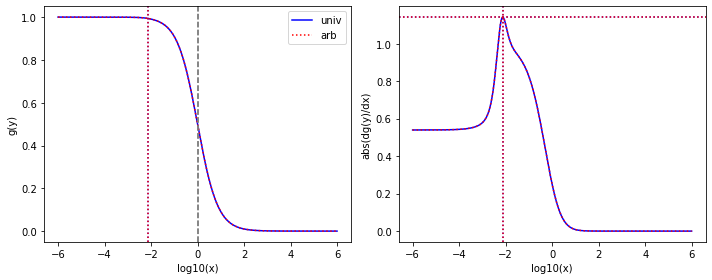

[1.00000e+03 2.50861e-02 2.33337e-01 4.62105e-03 2.58820e+01 1.99788e-01
 4.41163e+02 2.36647e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.000233337 0.000233337
0.025882000000000002 0.025882000000000002
0.441163 0.441163
1e-06 9.999999999999997e-07
# maximal error is 2.117582368135751e-22
min-max are 3.529814346881038e-10 42766934372169.09
From univ parameters, position and steepness are: 0.3021153195166847 1.145939437205001 3.4344325087273297
From arb parameters, position and steepness are: 0.3021153195166847 1.145939437205001 3.4344325087273293


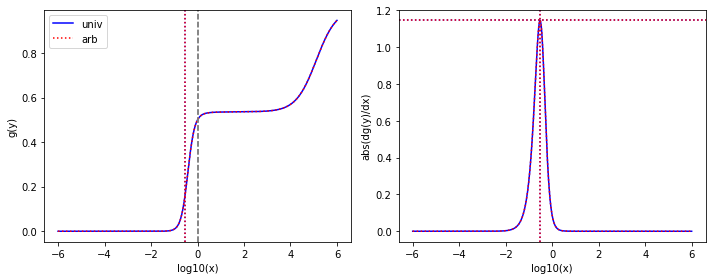

[9.05213e+02 9.05213e+02 5.49574e-02 1.00000e-03 1.96914e-02 4.10961e-03
 1.00000e+03 1.00000e+03 1.07496e+00 1.27020e-01]
found K1
found pairwise
found triplewise
6.071211968895718e-05 6.071211968895718e-05
2.17533331934031e-05 2.17533331934031e-05
1.104712371563378 1.1047123715633782
0.0011875216109357687 0.0011875216109357687
# maximal error is 2.220446049250313e-16
min-max are 2.439715342954195e-10 2154535833036.0496
From univ parameters, position and steepness are: 0.001300037553073027 1.1552611355920948 930.2671580575767
From arb parameters, position and steepness are: 0.001300037553073027 1.1552611355920948 930.2671580575768


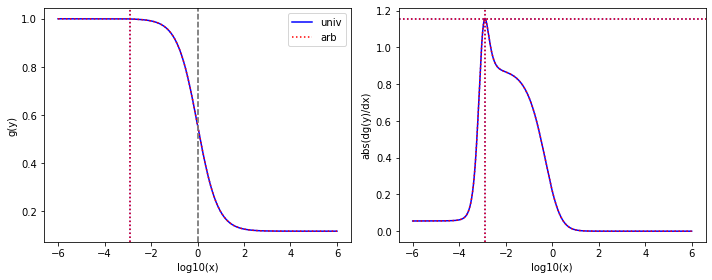

[1.00000e+03 2.80167e-02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 2.87017e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1e-06 1e-06
0.287017 0.287017
1e-06 1e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 1155084030215400.0
From univ parameters, position and steepness are: 0.30565250340263106 1.152805829203551 3.9366388342136918
From arb parameters, position and steepness are: 0.30565250340263067 1.1528058292035523 3.9366388342136966


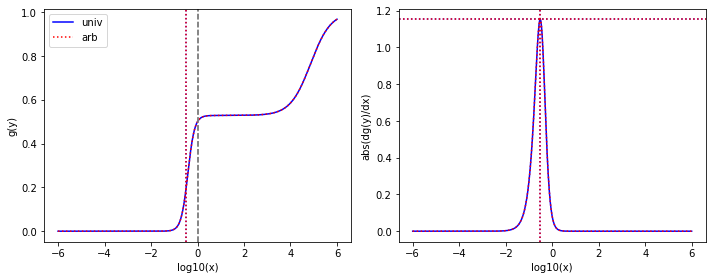

[1.00000e+03 4.19449e-03 3.46671e-02 1.00000e-03 1.97294e-03 1.00000e-03
 2.98461e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.46671e-05 3.46671e-05
1.97294e-06 1.97294e-06
0.29846100000000003 0.29846100000000003
1e-06 1e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 667844840124446.6
From univ parameters, position and steepness are: 5.32149176985291e-06 1.1635245561549648 298461.50378538267
From arb parameters, position and steepness are: 5.3214917698529096e-06 1.1635245561549648 298461.5037853827


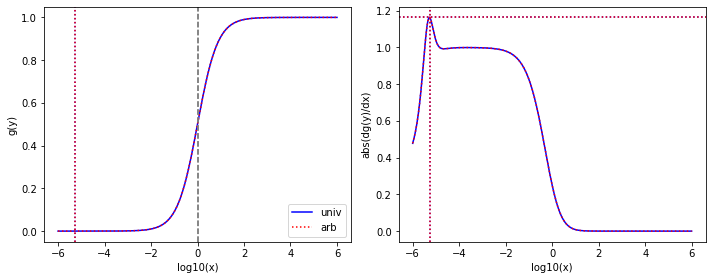

[3.89329e+02 1.63057e-01 1.91908e-03 1.00000e-03 4.00621e-01 1.00000e-03
 2.87339e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
4.929198698273183e-06 4.929198698273183e-06
0.0010290037474732167 0.0010290037474732167
0.7380364678716458 0.7380364678716457
2.5685217386837355e-06 2.568521738683736e-06
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 8357115825853331.0
From univ parameters, position and steepness are: 0.3019364079112577 1.1637417317542949 2.9084183876941445
From arb parameters, position and steepness are: 0.3019364079112579 1.1637417317542942 2.9084183876941427


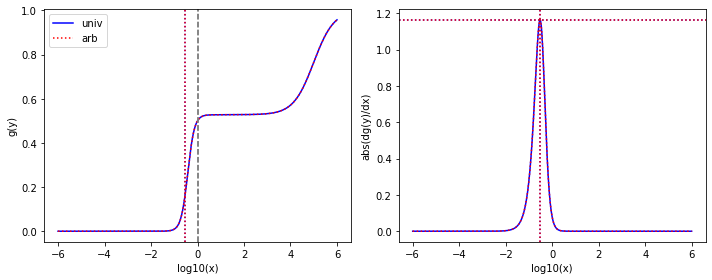

[1.00000e+03 2.58660e-03 3.48190e-03 1.41836e-03 2.39288e-02 1.00000e-03
 5.04012e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.4819e-06 3.4819e-06
2.39288e-05 2.39288e-05
0.504012 0.504012
1e-06 9.999999999999997e-07
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 194194109918903.03
From univ parameters, position and steepness are: 1.5034624151711454e-06 1.1723700145723706 504012.60739995807
From arb parameters, position and steepness are: 1.5034624151711447e-06 1.1723700145723708 504012.6073999581


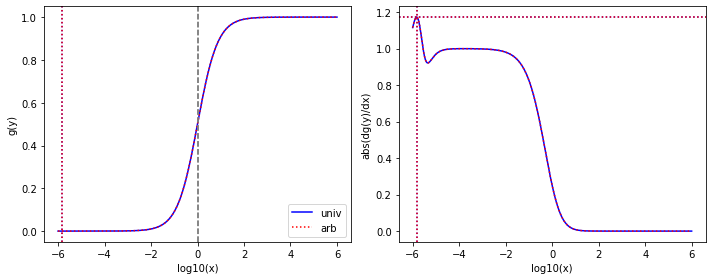

[7.72415e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.51095e-03 1.51095e-03
 2.98461e+02 1.57303e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.2946408342665536e-06 1.2946408342665536e-06
1.9561375685350492e-06 1.9561375685350492e-06
0.38639979803602986 0.38639979803602986
1.2946408342665536e-06 1.2946408342665538e-06
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 793526933769404.8
From univ parameters, position and steepness are: 0.3001967670001564 1.170452005353888 3.6299769722832007
From arb parameters, position and steepness are: 0.3001967670001566 1.1704520053538874 3.6299769722831985


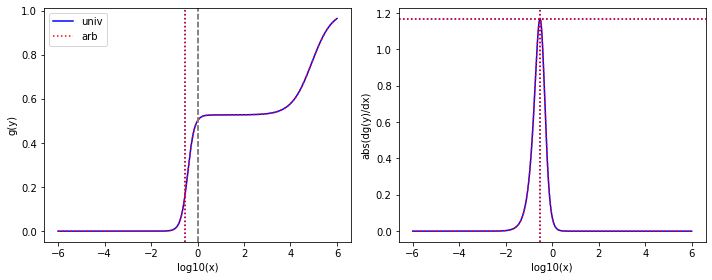

[1.13856e+01 1.13856e+01 8.19060e-02 1.00000e-03 1.00000e-03 1.00000e-03
 2.47959e+02 2.47959e+02 4.46918e+00 1.12140e-02]
found K1
found pairwise
found triplewise
0.007193823777403036 0.007193823777403036
8.783024170882519e-05 8.78302417088252e-05
21.778298903878582 21.778298903878586
0.3925291596402473 0.39252915964024726
# maximal error is 3.552713678800501e-15
min-max are 3.529814346881038e-10 145128957684.47525
From univ parameters, position and steepness are: 0.008019048692601316 1.183306785237268 55.48200309646323
From arb parameters, position and steepness are: 0.008019048692601316 1.183306785237268 55.48200309646323


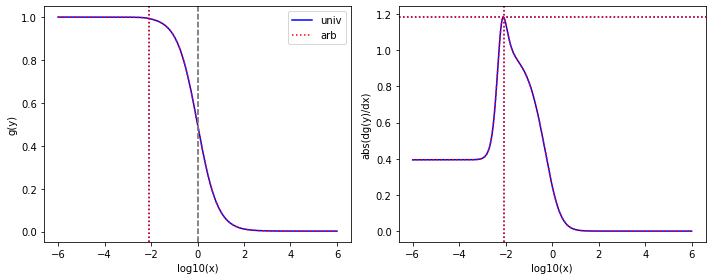

[4.88869e+01 1.00000e-03 8.98462e-02 7.74446e-03 1.67176e-02 3.10553e-03
 2.98461e+02 1.57024e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0018378379484074467 0.001837837948407447
0.00034196482084157515 0.0003419648208415752
6.1051324587977565 6.105132458797756
2.045537761649849e-05 2.0455377616498495e-05
# maximal error is 8.881784197001252e-16
min-max are 3.529814346881038e-10 565056201909.8486
From univ parameters, position and steepness are: 0.296396142153817 1.1826871019406247 1.4652296871093573
From arb parameters, position and steepness are: 0.2963961421538172 1.1826871019406238 1.465229687109356


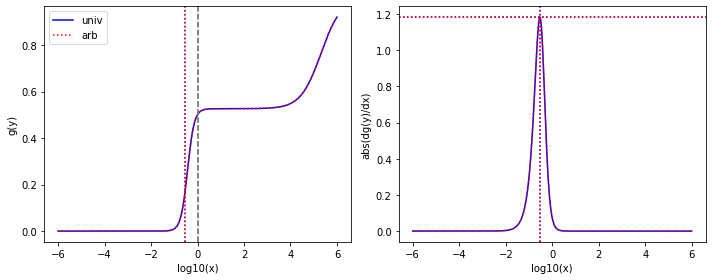

[1.00000e-03 1.00000e-03 4.80339e-02 4.80339e-02 1.15134e-03 1.15134e-03
 1.31088e+02 1.31088e+02 3.32304e+00 1.00000e-03]
found K1
found pairwise
found triplewise
48.033899999999996 48.0339
1.15134 1.15134
131088.0 131088.0
3323.04 3323.0400000000004
# maximal error is 4.547473508864641e-13
min-max are 3.529814346881038e-10 1902452744633476.5
From univ parameters, position and steepness are: 0.0009090495669848169 1.1942866349119672 39.44823416789018
From arb parameters, position and steepness are: 0.0009090495669848169 1.1942866349119672 39.44823416789018


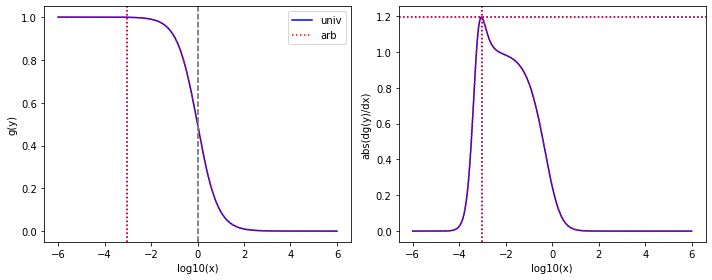

[1.00000e+03 5.76172e-03 7.04504e-03 1.00000e-03 1.36354e-03 1.36354e-03
 2.77368e+02 1.45490e+02 1.36938e-02 1.36891e-02]
found K1
found pairwise
found triplewise
7.04504e-06 7.04504e-06
1.3635400000000002e-06 1.3635400000000002e-06
0.277368 0.277368
1.3693800000000001e-05 1.3693800000000003e-05
# maximal error is 1.6940658945086007e-21
min-max are 2.498058915578641e-10 837253470943013.2
From univ parameters, position and steepness are: 0.29169576197875935 1.1989702294227635 4.172352872331912
From arb parameters, position and steepness are: 0.29169576197875957 1.1989702294227629 4.172352872331909


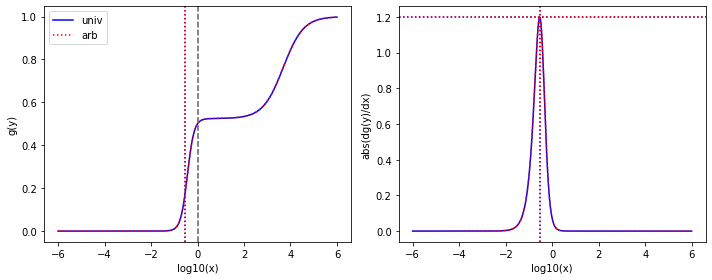

[1.00000e-03 1.00000e-03 1.66868e-02 1.66868e-02 1.00000e-03 1.00000e-03
 6.14000e+01 6.14000e+01 7.07832e-01 2.54810e-02]
found K1
found pairwise
found triplewise
16.6868 16.6868
1.0 1.0
61400.0 61400.0
707.832 707.832
# maximal error is 0.0
min-max are 3.529814346881038e-10 1652381358818772.5
From univ parameters, position and steepness are: 0.0004383077191091052 1.2019044619507573 86.74376652568105
From arb parameters, position and steepness are: 0.00043830771910910503 1.2019044619507573 86.74376652568108


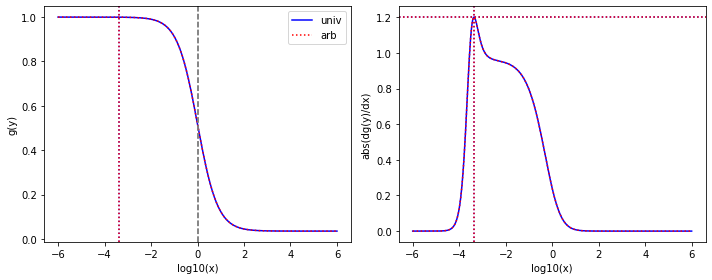

[1.10564e+02 5.13104e-03 2.65056e-03 2.10237e-03 1.00000e-03 1.00000e-03
 2.77368e+02 1.45490e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.3973083462971674e-05 2.3973083462971674e-05
9.04453529177671e-06 9.04453529177671e-06
2.508664664809522 2.5086646648095217
9.04453529177671e-06 9.044535291776711e-06
# maximal error is 4.440892098500626e-16
min-max are 2.498058915578641e-10 1126172313347827.0
From univ parameters, position and steepness are: 0.2905188056003593 1.2035580580681176 2.0106202718044677
From arb parameters, position and steepness are: 0.2905188056003594 1.203558058068117 2.0106202718044672


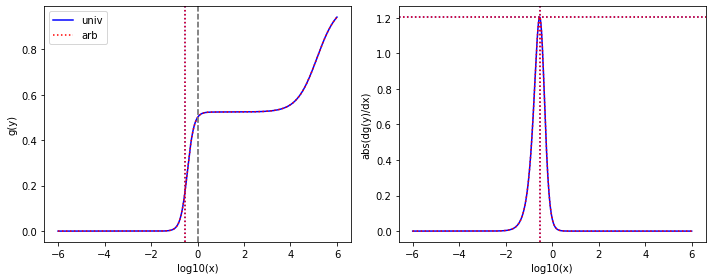

[1.00000e+03 3.46574e-03 1.00000e-03 1.00000e-03 2.26285e-02 1.00000e-03
 3.29832e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
2.26285e-05 2.26285e-05
0.329832 0.32983199999999996
1e-06 1e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 183740334973496.4
From univ parameters, position and steepness are: 4.337645857568058e-06 1.2127827953728756 329832.2862874462
From arb parameters, position and steepness are: 4.337645857568057e-06 1.2127827953728756 329832.2862874462


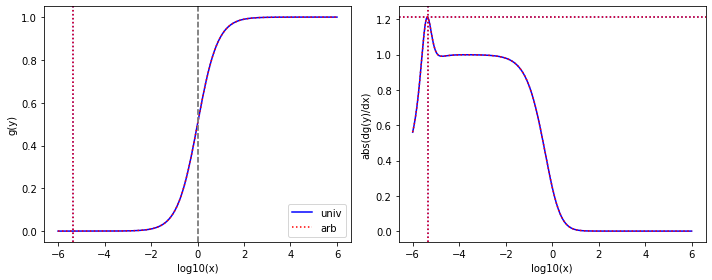

[2.55576e+01 1.00000e-03 1.00000e-03 1.00000e-03 1.32013e-01 1.00000e-03
 4.51715e+02 2.36647e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.9127304598240836e-05 3.9127304598240836e-05
0.005165312861927567 0.005165312861927567
17.674390396594358 17.674390396594358
3.9127304598240836e-05 3.9127304598240836e-05
# maximal error is 0.0
min-max are 2.498058915578641e-10 4.194977905209192e+16
From univ parameters, position and steepness are: 0.28735136930492133 1.2146502176164766 1.0602827929748875
From arb parameters, position and steepness are: 0.287351369304921 1.2146502176164777 1.0602827929748886


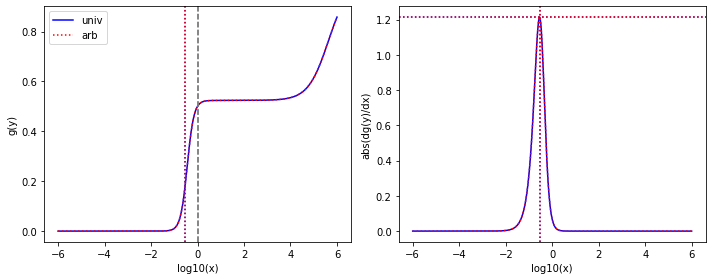

[3.74785e+02 2.83123e-02 1.21230e-03 1.04004e-03 1.68971e-03 1.00000e-03
 4.65198e+02 1.00000e-03 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
3.2346545352668857e-06 3.2346545352668857e-06
4.508478194164654e-06 4.508478194164654e-06
1.2412396440625957 1.2412396440625957
0.000465832410582067 0.000465832410582067
# maximal error is 0.0
min-max are 2.498058915578641e-10 1106315638929598.1
From univ parameters, position and steepness are: 0.0004824842969115866 1.2285527917271872 2664.9538038939913
From arb parameters, position and steepness are: 0.00048248429691158666 1.2285527917271872 2664.953803893991


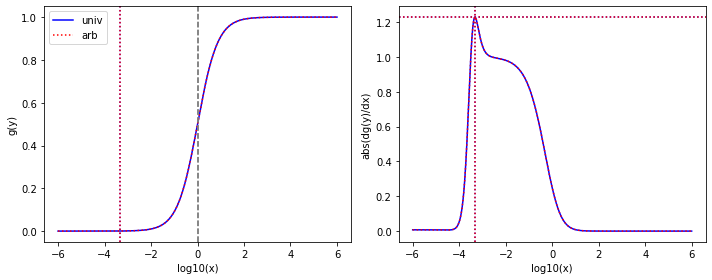

[4.41036e+02 3.77827e-03 2.47001e-02 1.00000e-03 1.89614e-02 1.00000e-03
 3.29832e+02 1.71417e+02 1.00592e-03 1.00000e-03]
found K1
found pairwise
found triplewise
5.6004725237849065e-05 5.6004725237849065e-05
4.299286226067713e-05 4.299286226067713e-05
0.747857317769978 0.7478573177699779
2.2808115437288565e-06 2.2808115437288565e-06
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 346764488848836.6
From univ parameters, position and steepness are: 0.28345779195217985 1.2222205600612814 3.0848115215207104
From arb parameters, position and steepness are: 0.2834577919521796 1.2222205600612823 3.084811521520713


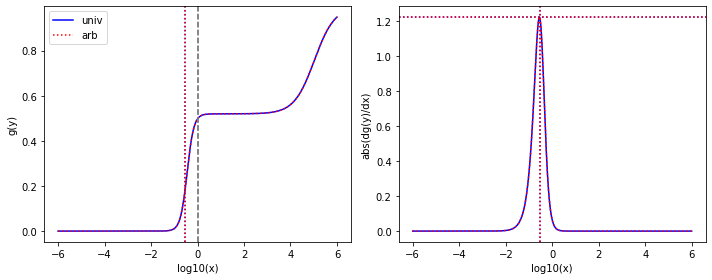

[5.53962e+02 4.38235e-02 1.78687e-03 1.78687e-03 1.00000e-03 1.00000e-03
 4.65198e+02 1.00000e-03 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
3.225618363714479e-06 3.225618363714479e-06
1.8051779724963084e-06 1.8051779724963084e-06
0.8397651824493376 0.8397651824493376
0.000315160606684213 0.00031516060668421305
# maximal error is 5.421010862427522e-20
min-max are 2.498058915578641e-10 1880058868939647.5
From univ parameters, position and steepness are: 0.0005452629016386382 1.2354383016664359 2664.972811364089
From arb parameters, position and steepness are: 0.0005452629016386382 1.2354383016664359 2664.9728113640886


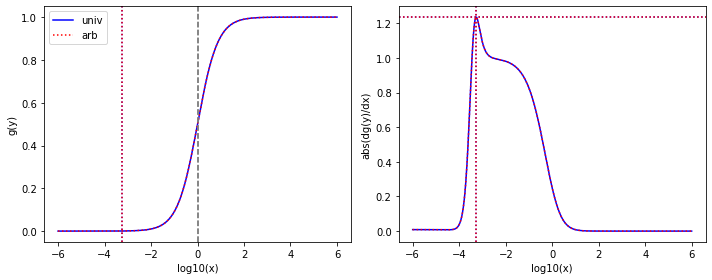

[9.53166e+01 1.29708e-02 2.52163e-02 1.00000e-03 8.49251e-02 6.67182e-02
 3.27988e+02 1.71417e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00026455307889706515 0.00026455307889706515
0.0008909791159147516 0.0008909791159147516
3.4410375527452723 3.441037552745273
1.049135197856407e-05 1.0491351978564069e-05
# maximal error is 4.440892098500626e-16
min-max are 3.529814346881038e-10 1472237192233.9058
From univ parameters, position and steepness are: 0.28266685660643326 1.2320872441242232 1.8594952954744652
From arb parameters, position and steepness are: 0.2826668566064331 1.2320872441242237 1.859495295474466


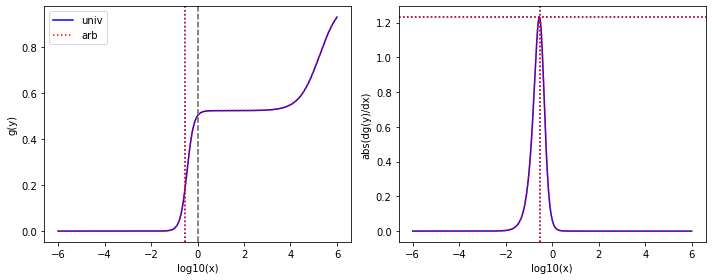

[1.60100e+02 1.00000e-03 9.26544e-03 1.00000e-03 9.36632e-01 2.01661e-03
 4.67876e+02 1.00000e-03 3.46854e-03 1.00000e-03]
found K1
found pairwise
found triplewise
5.7872829481574015e-05 5.7872829481574015e-05
0.005850293566520925 0.005850293566520924
2.9223985009369144 2.922398500936915
2.1664834478450968e-05 2.1664834478450968e-05
# maximal error is 4.440892098500626e-16
min-max are 2.439715342954195e-10 601524062802375.9
From univ parameters, position and steepness are: 1.5460518935989387e-06 1.246689581550132 134895.18441797319
From arb parameters, position and steepness are: 1.5460518935989383e-06 1.2466895815501322 134895.1844179732


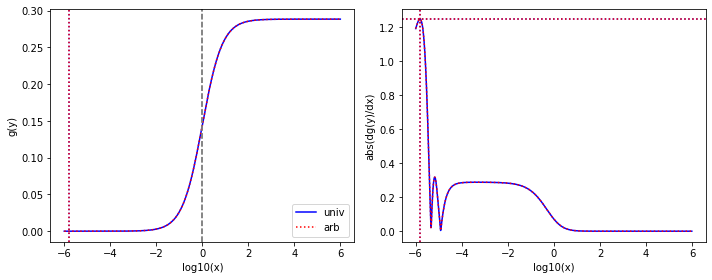

[1.12228e+01 1.00000e-03 1.27259e-02 2.46845e-03 1.10446e-01 1.93922e-03
 4.73440e+02 2.47212e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0011339327084150125 0.0011339327084150127
0.00984121609580497 0.00984121609580497
42.1855508429269 42.1855508429269
8.910432334176855e-05 8.910432334176855e-05
# maximal error is 2.168404344971009e-19
min-max are 3.529814346881038e-10 16261441982250.547
From univ parameters, position and steepness are: 0.2800437610060717 1.2418850802082628 0.8140792822379617
From arb parameters, position and steepness are: 0.2800437610060717 1.2418850802082628 0.8140792822379617


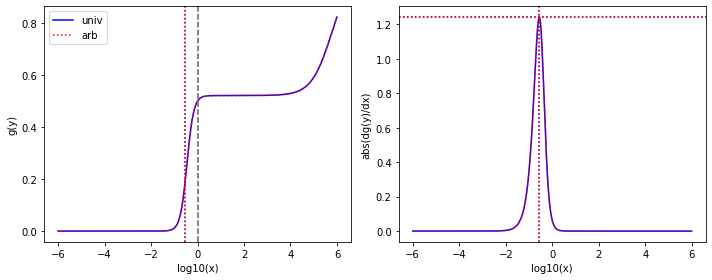

[4.13403e+01 1.47349e+01 2.26615e-03 2.12506e-03 2.20120e-02 1.82765e-03
 1.00000e+03 3.70198e+02 2.17521e+01 4.45717e-01]
found K1
found pairwise
found triplewise
5.481697036547873e-05 5.481697036547873e-05
0.0005324586420514607 0.0005324586420514607
24.189471290726 24.189471290725997
0.526171798463001 0.526171798463001
# maximal error is 3.552713678800501e-15
min-max are 2.498058915578641e-10 4322142472628695.0
From univ parameters, position and steepness are: 0.00530266513030013 1.255705798090568 47.57301798412981
From arb parameters, position and steepness are: 0.005302665130300129 1.2557057980905635 47.5730179841298


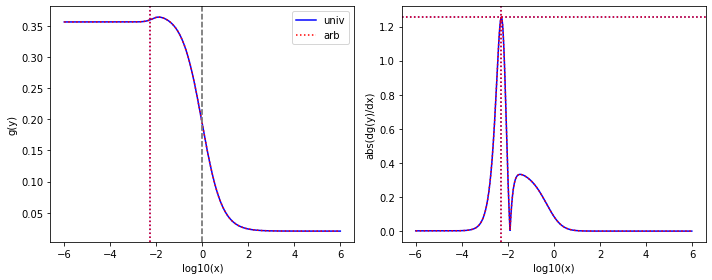

[1.62182e+02 3.37658e-03 1.86910e-02 1.00000e-03 1.89614e-02 1.00000e-03
 3.28843e+02 1.71417e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00011524706810866804 0.00011524706810866804
0.00011691433081353049 0.00011691433081353049
2.0276171215054695 2.0276171215054695
6.165912370053397e-06 6.165912370053397e-06
# maximal error is 0.0
min-max are 7.027031419536454e-09 193186966735.35635
From univ parameters, position and steepness are: 0.27698348602597445 1.254484083474606 2.263985636263738
From arb parameters, position and steepness are: 0.27698348602597406 1.2544840834746076 2.263985636263741


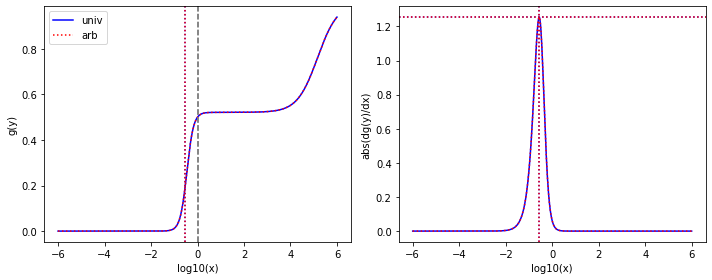

[1.00000e+03 1.00000e-03 1.04340e+01 7.18543e-02 2.40565e-03 1.80442e-03
 4.65198e+02 1.00000e-03 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
0.010433999999999999 0.010434
2.40565e-06 2.40565e-06
0.465198 0.465198
0.000174587 0.00017458699999999997
# maximal error is 1.734723475976807e-18
min-max are 3.529814346881038e-10 3974953288.105132
From univ parameters, position and steepness are: 0.0006115364642273578 1.2666317151139717 2664.556533107305
From arb parameters, position and steepness are: 0.0006115364642273579 1.2666317151139717 2664.556533107305


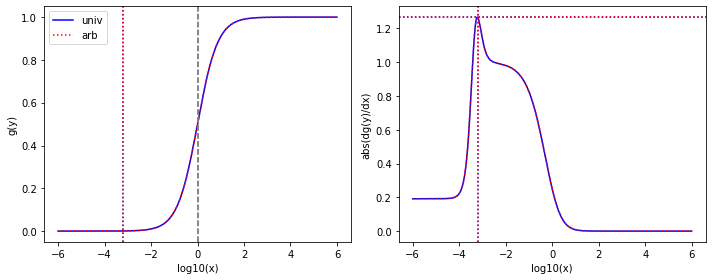

[2.48723e+01 1.00000e-03 9.05311e-03 3.98043e-03 1.09477e+00 1.09477e+00
 3.29832e+02 1.71417e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.000363983628373733 0.000363983628373733
0.044015631847476915 0.044015631847476915
13.26101727624707 13.26101727624707
4.02053690249796e-05 4.0205369024979606e-05
# maximal error is 6.776263578034403e-21
min-max are 3.529814346881038e-10 72730609701241.0
From univ parameters, position and steepness are: 0.27460407145615773 1.2602397660471791 1.2142953298780537
From arb parameters, position and steepness are: 0.27460407145615756 1.2602397660471798 1.2142953298780543


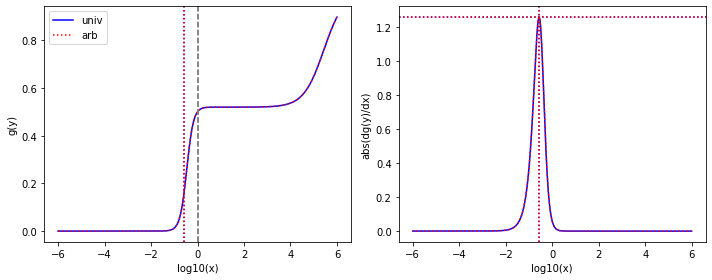

[1.00000e+03 6.53577e+00 5.90764e+00 1.00000e-03 1.00000e-03 1.00000e-03
 2.90658e+00 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00590764 0.00590764
1e-06 1e-06
0.0029065799999999998 0.0029065799999999998
1e-06 9.999999999999997e-07
# maximal error is 2.117582368135751e-22
min-max are 3.529814346881038e-10 1652284843.803652
From univ parameters, position and steepness are: 0.001531741657522154 1.279882991058974 2930.1321706648387
From arb parameters, position and steepness are: 0.001531741657522154 1.2798829910589742 2930.132170664839


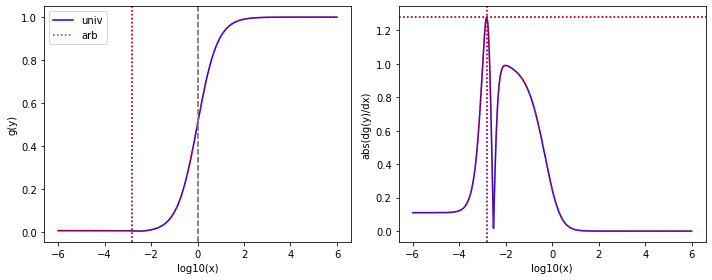

[1.00000e+03 1.00000e-03 4.56482e+00 1.00000e-03 1.46983e-01 1.46983e-01
 4.65198e+02 2.41608e+02 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
0.00456482 0.00456482
0.000146983 0.000146983
0.465198 0.465198
0.000174587 0.000174587
# maximal error is 0.0
min-max are 3.529814346881038e-10 242871873947.72354
From univ parameters, position and steepness are: 0.27061976450493647 1.2775798790797113 3.7878844379615892
From arb parameters, position and steepness are: 0.27061976450493647 1.2775798790797113 3.7878844379615892


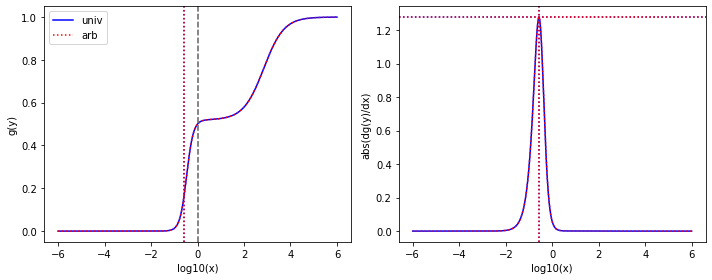

[1.00000e+03 1.00000e-03 2.65138e-01 1.00000e-03 1.00000e-03 1.00000e-03
 2.77368e+02 1.00000e-03 1.29320e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.000265138 0.000265138
1e-06 1e-06
0.277368 0.277368
1.2932e-06 1.2932e-06
# maximal error is 0.0
min-max are 7.027031419536454e-09 2440926994.3755674
From univ parameters, position and steepness are: 6.511773174126446e-06 1.2809281434798658 214480.46007948308
From arb parameters, position and steepness are: 6.5117731741264455e-06 1.2809281434798658 214480.4600794831


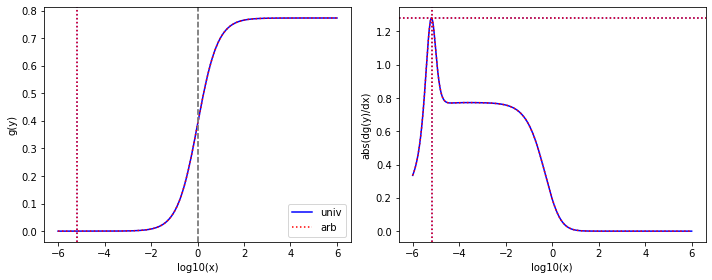

[1.00000e+03 1.53834e-03 1.00000e-03 1.00000e-03 1.25927e-03 1.00000e-03
 3.29832e+02 1.71417e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1.25927e-06 1.25927e-06
0.329832 0.329832
1e-06 9.999999999999997e-07
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 1052939850135478.2
From univ parameters, position and steepness are: 0.2701508287372341 1.282521886462852 4.252250225972894
From arb parameters, position and steepness are: 0.27015082873723395 1.2825218864628527 4.2522502259728965


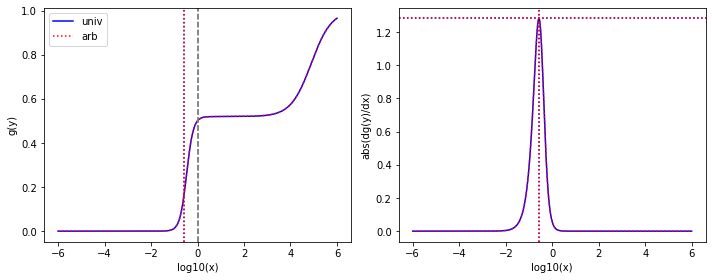

[3.74785e+02 3.46482e-03 1.21230e-03 1.00000e-03 1.00000e-03 1.00000e-03
 1.00000e+03 1.00000e-03 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
3.2346545352668857e-06 3.2346545352668857e-06
2.6681964326213693e-06 2.6681964326213693e-06
2.6681964326213694 2.66819643262137
0.000465832410582067 0.00046583241058206705
# maximal error is 4.440892098500626e-16
min-max are 2.498058915578641e-10 4029018690832391.5
From univ parameters, position and steepness are: 0.00016239423744836325 1.2940128520415772 5727.897779448405
From arb parameters, position and steepness are: 0.00016239423744836328 1.2940128520415772 5727.897779448404


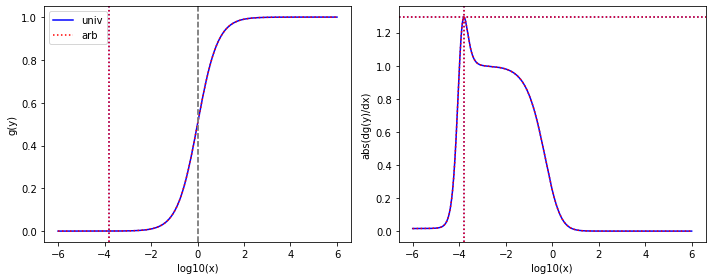

[1.00000e+03 1.00000e-03 3.24246e-02 1.00000e-03 1.00000e-03 1.00000e-03
 3.30267e+02 1.71417e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.24246e-05 3.24246e-05
1e-06 1.0000000000000002e-06
0.330267 0.330267
1e-06 1e-06
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 1596819528282264.2
From univ parameters, position and steepness are: 0.2669790033808564 1.2960279793313674 4.300904990772475
From arb parameters, position and steepness are: 0.26697900338085656 1.2960279793313667 4.300904990772472


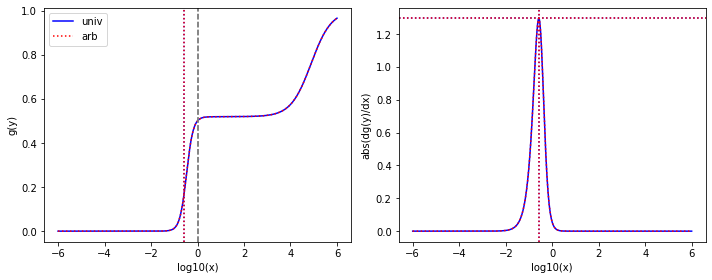

[1.00000e+03 2.97008e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 3.29832e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1e-06 1e-06
0.329832 0.329832
1e-06 1e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 1327390627951978.2
From univ parameters, position and steepness are: 4.173172402835878e-06 1.3000893549101344 329831.95925170026
From arb parameters, position and steepness are: 4.173172402835877e-06 1.3000893549101342 329831.9592517003


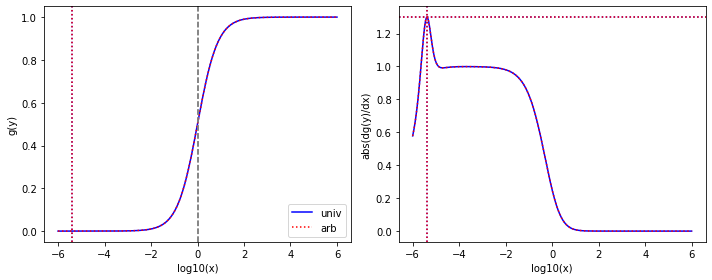

[4.28827e+00 8.15898e-03 9.98743e-02 6.74186e-03 1.00000e-03 1.00000e-03
 3.29832e+02 1.71417e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.02329011466162345 0.023290114661623448
0.00023319427181590712 0.00023319427181590712
76.91493306158428 76.91493306158428
0.00023319427181590712 0.00023319427181590715
# maximal error is 3.469446951953614e-18
min-max are 3.529814346881038e-10 385325767000.57965
From univ parameters, position and steepness are: 0.2647538085291768 1.3006886223246759 0.7052376784308947
From arb parameters, position and steepness are: 0.2647538085291766 1.3006886223246767 0.7052376784308951


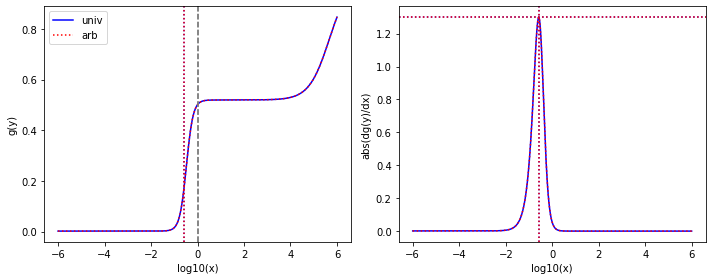

[7.54889e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.62711e+00 2.78998e-03
 8.20140e+01 1.00000e-03 1.47015e-01 1.47015e-01]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
0.0021554294737371983 0.0021554294737371983
0.10864378736476488 0.10864378736476488
0.00019475048649536555 0.00019475048649536558
# maximal error is 2.710505431213761e-20
min-max are 2.498058915578641e-10 1.7505837946215926e+16
From univ parameters, position and steepness are: 0.004703556869715238 1.3197154078104538 557.869117350392
From arb parameters, position and steepness are: 0.004703556869715239 1.3197154078104538 557.869117350392


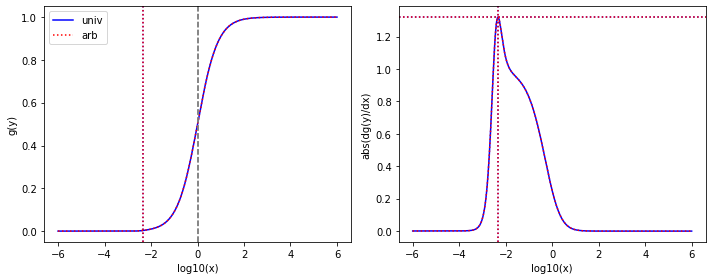

[1.00000e+03 1.28720e-02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 2.92907e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1e-06 1e-06
0.292907 0.292907
1e-06 1e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 1178788009210341.8
From univ parameters, position and steepness are: 0.2617548192566069 1.3191056092591886 4.565813249462999
From arb parameters, position and steepness are: 0.261754819256607 1.3191056092591882 4.565813249462996


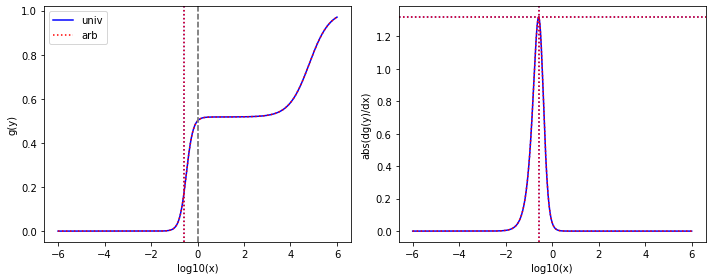

[1.00000e+03 1.00000e-03 4.56482e+00 2.20107e-03 9.08479e-02 1.00000e-03
 4.65198e+02 1.00000e-03 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
0.00456482 0.00456482
9.08479e-05 9.08479e-05
0.465198 0.465198
0.000174587 0.000174587
# maximal error is 0.0
min-max are 3.529814346881038e-10 150115280833.073
From univ parameters, position and steepness are: 0.0006100454233757646 1.3298079508290288 2664.556722061375
From arb parameters, position and steepness are: 0.0006100454233757645 1.3298079508290288 2664.556722061375


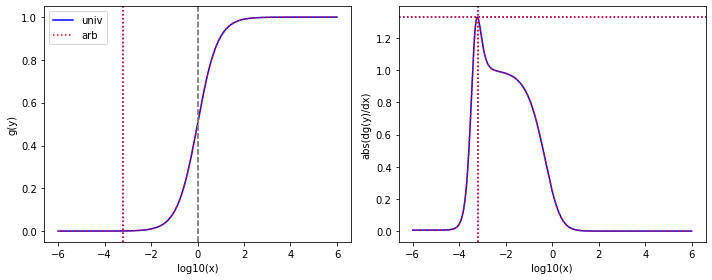

[1.00000e+03 1.30094e-01 3.12417e-03 2.00140e-03 2.35020e-02 2.35020e-02
 2.93067e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.12417e-06 3.12417e-06
2.3502e-05 2.3502e-05
0.293067 0.293067
1e-06 1e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 190743156419179.25
From univ parameters, position and steepness are: 0.2601251559832806 1.3263328172053768 4.59341092112495
From arb parameters, position and steepness are: 0.2601251559832806 1.3263328172053768 4.593410921124951


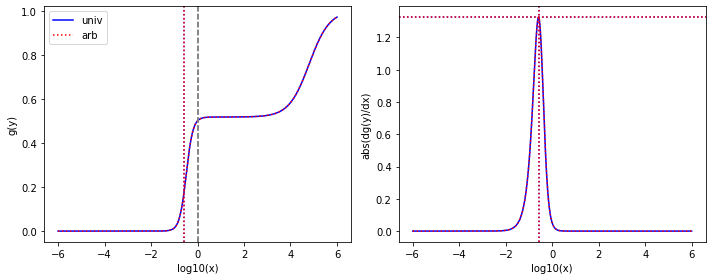

[1.00000e+03 1.00000e-03 4.56482e+00 2.20107e-03 9.08479e-02 2.94505e-02
 1.00000e+03 1.00000e-03 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
0.00456482 0.00456482
9.08479e-05 9.08479e-05
1.0 1.0
0.000174587 0.000174587
# maximal error is 0.0
min-max are 3.529814346881038e-10 150115280833.073
From univ parameters, position and steepness are: 0.00020791948228267613 1.3315096191969522 5727.803362918551
From arb parameters, position and steepness are: 0.00020791948228267613 1.3315096191969522 5727.803362918551


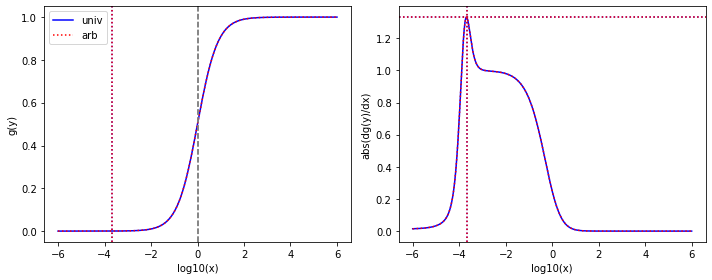

[4.13022e+02 1.00000e-03 4.26311e-01 1.09899e-03 5.71358e-01 8.97194e-02
 4.41163e+02 2.28191e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.001032175041523212 0.001032175041523212
0.0013833597241793417 0.0013833597241793417
1.068134385093288 1.068134385093288
2.4211785328626563e-06 2.4211785328626567e-06
# maximal error is 4.235164736271502e-22
min-max are 3.529814346881038e-10 2285837733157.8984
From univ parameters, position and steepness are: 0.25735023579100275 1.3382622453844881 3.016700187632242
From arb parameters, position and steepness are: 0.25735023579100297 1.338262245384487 3.0167001876322392


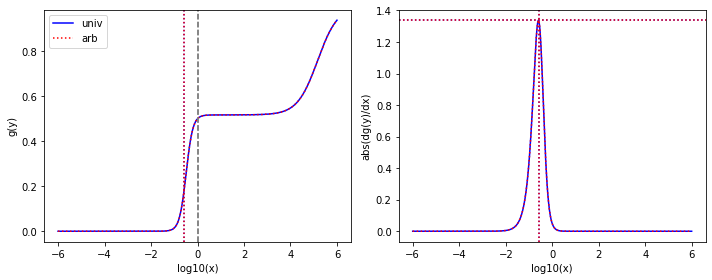

[1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.48769e-03 1.01123e-03
 1.73213e+02 1.73213e+02 4.46918e+00 1.00000e-03]
found K1
found pairwise
found triplewise
1.0 1.0
1.48769 1.4876900000000002
173213.0 173213.0
4469.179999999999 4469.179999999999
# maximal error is 2.220446049250313e-16
min-max are 3.529814346881038e-10 2458231231222659.5
From univ parameters, position and steepness are: 0.0005212626349107768 1.3429424603024045 38.757224921650575
From arb parameters, position and steepness are: 0.0005212626349107767 1.3429424603024045 38.757224921650575


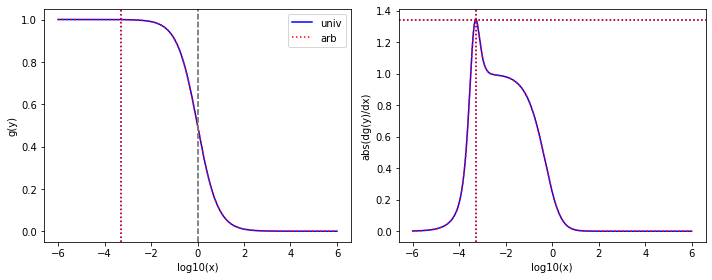

[1.00000e+03 2.34453e-02 4.01950e+00 2.44297e-01 1.00000e-03 1.00000e-03
 4.65198e+02 2.39633e+02 4.30881e-01 4.30881e-01]
found K1
found pairwise
found triplewise
0.0040195 0.0040195
1e-06 1e-06
0.465198 0.46519799999999994
0.00043088100000000004 0.000430881
# maximal error is 5.551115123125783e-17
min-max are 7.027031419536454e-09 2897090396.7980604
From univ parameters, position and steepness are: 0.2559349451973652 1.3416900603973874 4.005274065129361
From arb parameters, position and steepness are: 0.25593494519736487 1.341690060397389 4.005274065129366


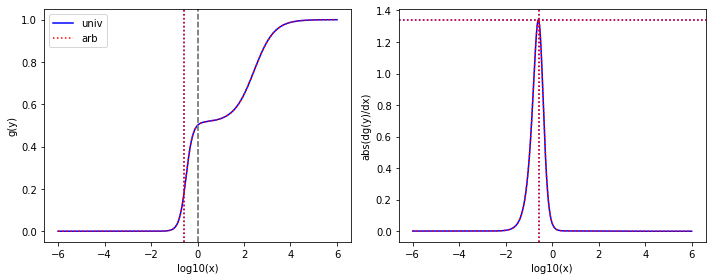

[1.18810e-01 1.18810e-01 1.00000e-03 1.00000e-03 1.65928e-02 1.00000e-03
 1.00000e+03 1.00000e+03 1.80711e+01 6.16013e-03]
found K1
found pairwise
found triplewise
0.0084167999326656 0.008416799932665602
0.13965827792273378 0.13965827792273378
8416.7999326656 8416.7999326656
152.10083326319335 152.10083326319335
# maximal error is 1.734723475976807e-18
min-max are 3.529814346881038e-10 230768735691384.28
From univ parameters, position and steepness are: 0.0009816660736350746 1.3516828049417158 55.33695995968802
From arb parameters, position and steepness are: 0.0009816660736350741 1.3516828049417158 55.336959959688045


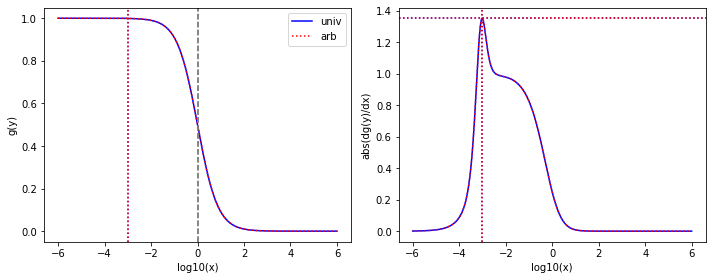

[1.00000e+03 7.04426e-02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 3.29832e+02 1.70274e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1e-06 1e-06
0.329832 0.329832
1e-06 1e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 1327390627951978.2
From univ parameters, position and steepness are: 0.25312230941430625 1.3594941644817775 4.538315877038722
From arb parameters, position and steepness are: 0.2531223094143063 1.359494164481777 4.538315877038721


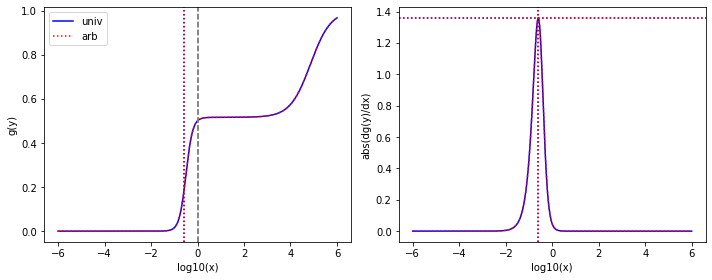

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 2.77368e+02 1.00000e-03 5.29816e-03 5.29816e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1e-06 1e-06
0.277368 0.27736800000000006
5.298159999999999e-06 5.298159999999999e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 1116252163776996.4
From univ parameters, position and steepness are: 3.466496822227406e-05 1.3680895834291738 52351.48706635128
From arb parameters, position and steepness are: 3.4664968222274056e-05 1.3680895834291738 52351.48706635129


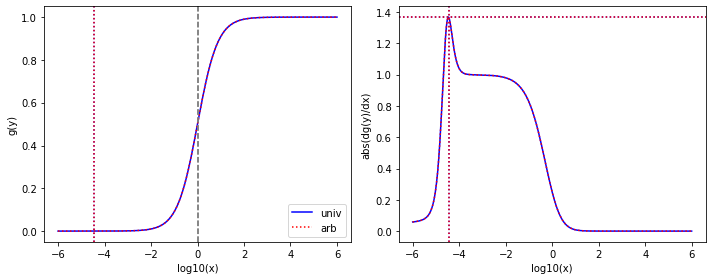

[8.59477e+02 2.83123e-02 1.00000e-03 1.00000e-03 1.68971e-03 1.00000e-03
 4.65198e+02 2.39633e+02 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
1.1634982669693314e-06 1.1634982669693314e-06
1.9659746566807492e-06 1.9659746566807492e-06
0.541257066797599 0.5412570667975989
0.00020313167193537464 0.00020313167193537464
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 1105574354399558.6
From univ parameters, position and steepness are: 0.25112872395639146 1.3685796081333914 3.87858126629038
From arb parameters, position and steepness are: 0.25112872395639113 1.3685796081333932 3.878581266290386


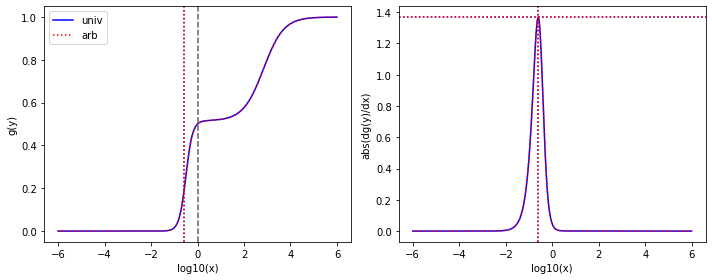

[1.00000e+03 1.00000e-03 1.52097e-03 1.52097e-03 7.42602e+00 2.12237e-03
 1.48057e+01 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.52097e-06 1.52097e-06
0.00742602 0.00742602
0.0148057 0.014805699999999998
1e-06 1e-06
# maximal error is 1.734723475976807e-18
min-max are 2.498058915578641e-10 6.031233531753806e+16
From univ parameters, position and steepness are: 0.0003124452186766935 1.3774503132927063 14804.230938718416
From arb parameters, position and steepness are: 0.00031244521867669346 1.3774503132927063 14804.230938718418


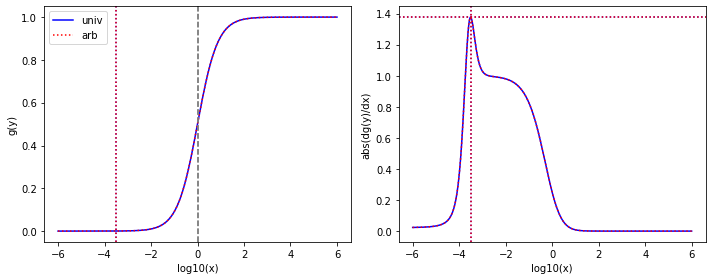

[5.53962e+02 1.00000e-03 2.52067e-01 1.00000e-03 2.48265e-01 3.17953e-03
 4.65198e+02 2.39633e+02 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
0.00045502579599322697 0.00045502579599322697
0.00044816250934179606 0.00044816250934179606
0.8397651824493376 0.8397651824493375
0.000315160606684213 0.000315160606684213
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 740535283737.2117
From univ parameters, position and steepness are: 0.25015664101626706 1.3730547850647083 3.363329425791984
From arb parameters, position and steepness are: 0.2501566410162673 1.3730547850647072 3.363329425791981


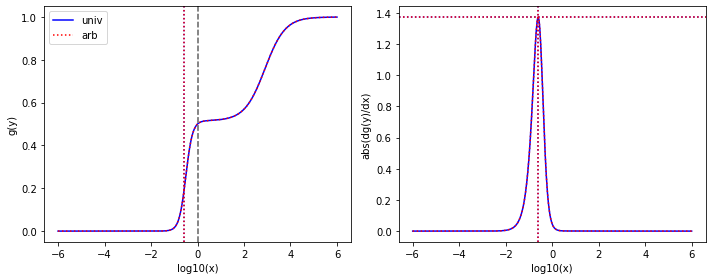

[7.54889e+02 1.00000e-03 1.09370e-02 1.25476e-03 4.79089e-02 1.00000e-03
 8.20140e+01 2.12003e-02 9.92224e-02 9.92224e-02]
found K1
found pairwise
found triplewise
1.4488222771824732e-05 1.4488222771824732e-05
6.346482727924237e-05 6.346482727924237e-05
0.10864378736476488 0.10864378736476489
0.00013143972160145398 0.00013143972160145398
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 514822173536628.56
From univ parameters, position and steepness are: 0.0030633520264790027 1.3822254210113947 826.1428221165019
From arb parameters, position and steepness are: 0.003063352026479002 1.3822254210113947 826.142822116502


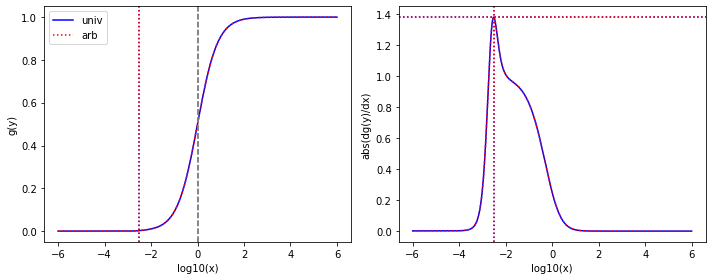

[1.00000e+03 1.41573e-02 3.37632e-03 1.00000e-03 3.46857e-02 1.00000e-03
 4.65198e+02 2.39633e+02 2.90533e-02 2.90533e-02]
found K1
found pairwise
found triplewise
3.37632e-06 3.37632e-06
3.46857e-05 3.46857e-05
0.465198 0.46519800000000006
2.9053300000000002e-05 2.9053300000000002e-05
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 281563690506286.94
From univ parameters, position and steepness are: 0.24790010902680906 1.3854022278556926 4.132116170891928
From arb parameters, position and steepness are: 0.24790010902680867 1.3854022278556943 4.132116170891933


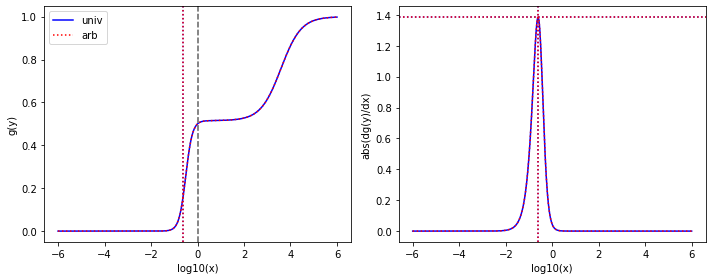

[9.15338e+02 1.00000e-03 3.93062e+00 1.00000e-03 1.00000e-03 1.00000e-03
 4.13313e+02 1.00000e-03 2.49871e-03 2.49871e-03]
found K1
found pairwise
found triplewise
0.004294173299917626 0.004294173299917626
1.0924926092874983e-06 1.0924926092874983e-06
0.45154139782244374 0.45154139782244385
2.7298222077527644e-06 2.729822207752765e-06
# maximal error is 1.1102230246251565e-16
min-max are 7.027031419536454e-09 2340984273.6822634
From univ parameters, position and steepness are: 8.435513692211896e-06 1.3941535828129736 165410.11284850803
From arb parameters, position and steepness are: 8.435513692211897e-06 1.3941535828129736 165410.112848508


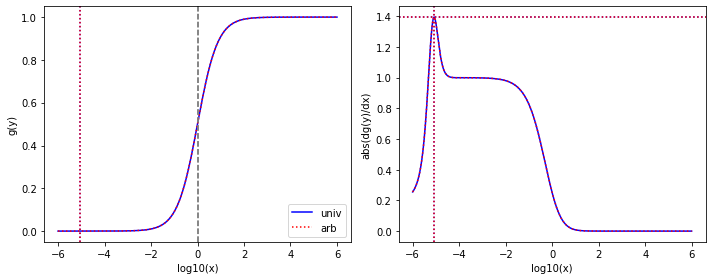

[1.00000e+03 1.00000e-03 3.12511e-01 1.00000e-03 5.17825e+00 3.17953e-03
 4.65198e+02 2.39633e+02 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
0.00031251099999999996 0.00031251099999999996
0.0051782500000000006 0.0051782500000000006
0.465198 0.465198
0.000174587 0.00017458700000000003
# maximal error is 2.710505431213761e-20
min-max are 3.529814346881038e-10 8556443704140.697
From univ parameters, position and steepness are: 0.24402216696173332 1.399495351006793 4.194641816620255
From arb parameters, position and steepness are: 0.24402216696173296 1.399495351006795 4.19464181662026


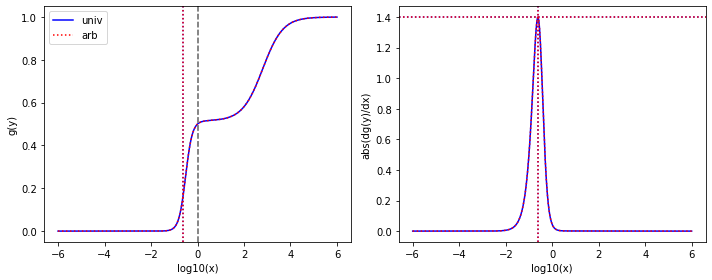

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 1.18902e-02 1.18902e-02
 3.29832e+02 1.00000e-03 1.08905e-02 1.08905e-02]
found K1
found pairwise
found triplewise
1e-06 1e-06
1.18902e-05 1.18902e-05
0.329832 0.329832
1.0890499999999998e-05 1.08905e-05
# maximal error is 1.6940658945086007e-21
min-max are 2.498058915578641e-10 111095032862334.0
From univ parameters, position and steepness are: 4.848312672217562e-05 1.4048189543792962 30286.089644194344
From arb parameters, position and steepness are: 4.848312672217561e-05 1.4048189543792964 30286.08964419435


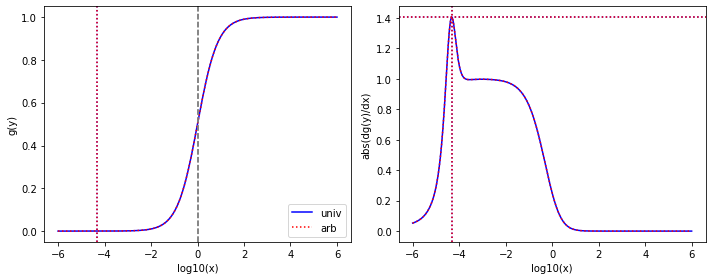

[5.25914e+02 2.78242e-02 2.44768e+01 1.00000e-03 2.56685e-03 2.56685e-03
 4.65198e+02 2.39633e+02 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
0.0465414497427336 0.0465414497427336
4.880740957647068e-06 4.880740957647068e-06
0.8845514665895945 0.8845514665895945
0.00033196872492460746 0.00033196872492460746
# maximal error is 0.0
min-max are 3.529814346881038e-10 8064736131.829612
From univ parameters, position and steepness are: 0.24001389513107843 1.4050501925193877 3.4674916229429535
From arb parameters, position and steepness are: 0.24001389513107807 1.4050501925193897 3.4674916229429584


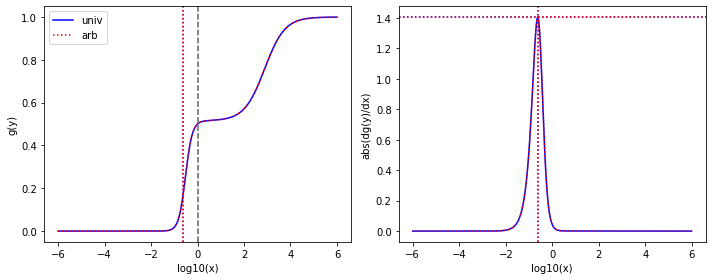

[1.00000e+03 2.93784e-03 1.40868e-02 1.00000e-03 1.24583e-03 1.24583e-03
 2.77368e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.40868e-05 1.40868e-05
1.24583e-06 1.24583e-06
0.277368 0.277368
1e-06 1.0000000000000002e-06
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 948121950327037.0
From univ parameters, position and steepness are: 5.0972101377605245e-06 1.41237585464868 277367.629720031
From arb parameters, position and steepness are: 5.097210137760525e-06 1.41237585464868 277367.629720031


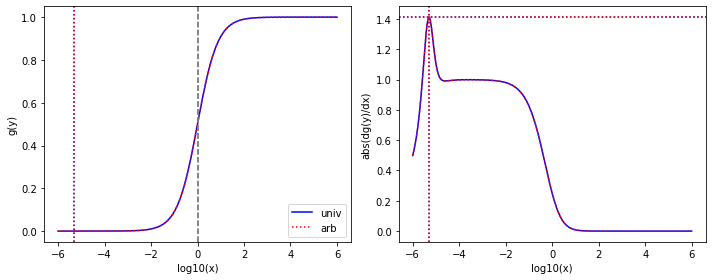

[9.46035e+02 2.22058e+00 1.62408e+00 8.71359e-02 1.14520e-03 1.00000e-03
 4.65198e+02 2.39633e+02 5.50920e-03 5.50920e-03]
found K1
found pairwise
found triplewise
0.001716722954224738 0.0017167229542247382
1.2105260376201727e-06 1.2105260376201727e-06
0.4917344495711047 0.49173444957110457
5.823463191108151e-06 5.823463191108152e-06
# maximal error is 1.1102230246251565e-16
min-max are 7.027031419536454e-09 3122274489.4303393
From univ parameters, position and steepness are: 0.24057455163322017 1.4196606994538177 4.180728425988833
From arb parameters, position and steepness are: 0.24057455163321978 1.4196606994538197 4.180728425988839


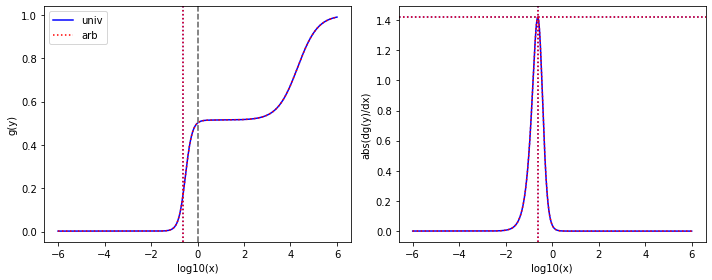

[1.00000e+03 1.23463e-02 1.31133e-03 1.31133e-03 1.23505e+00 1.00000e-03
 4.29264e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.31133e-06 1.31133e-06
0.00123505 0.00123505
0.42926400000000003 0.42926400000000003
1e-06 1e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 1.00307313001255e+16
From univ parameters, position and steepness are: 2.4532685164248213e-06 1.4263376187039836 429270.31295587483
From arb parameters, position and steepness are: 2.453268516424821e-06 1.426337618703984 429270.3129558749


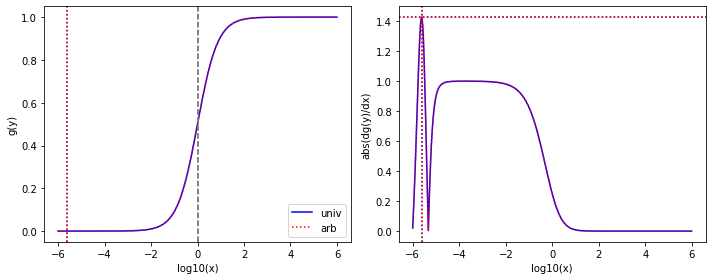

[1.37156e+01 2.59828e-02 7.25529e-03 1.00000e-03 2.82634e-01 1.00000e-03
 4.65198e+02 2.39633e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0005289808685001021 0.0005289808685001022
0.020606754352707864 0.020606754352707864
33.9174370789466 33.9174370789466
7.290967948904896e-05 7.290967948904896e-05
# maximal error is 1.0842021724855044e-19
min-max are 3.529814346881038e-10 34050216773181.734
From univ parameters, position and steepness are: 0.24038362307064387 1.4211861382594593 1.0198170494630328
From arb parameters, position and steepness are: 0.24038362307064412 1.421186138259458 1.0198170494630316


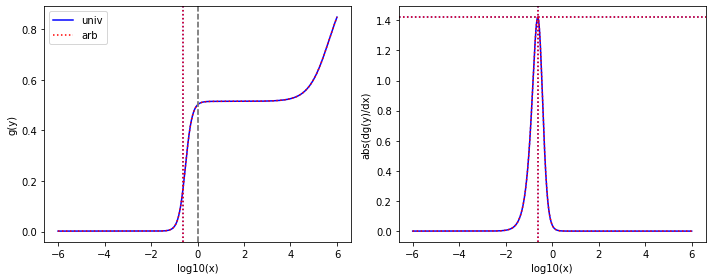

[7.44406e-02 7.44406e-02 1.00000e-03 1.00000e-03 9.30125e-02 1.00000e-03
 5.34720e+02 5.34720e+02 4.60504e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.013433529552421664 0.013433529552421665
1.2494861674946198 1.2494861674946198
7183.176922270912 7183.176922270912
618.6194093008386 618.6194093008385
# maximal error is 1.1368683772161603e-13
min-max are 3.529814346881038e-10 2064627657831407.2
From univ parameters, position and steepness are: 0.004186959388714327 1.4307841276189024 11.611456501110803
From arb parameters, position and steepness are: 0.004186959388714327 1.4307841276189024 11.611456501110803


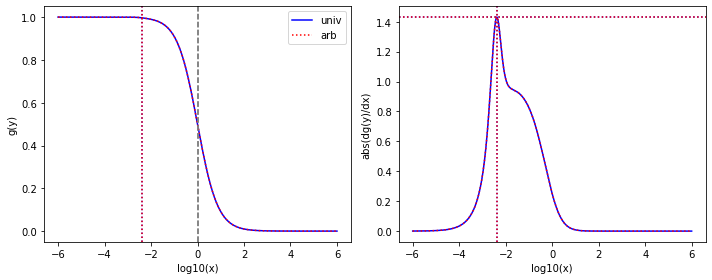

[7.25889e-01 2.64765e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.65198e+02 2.39633e+02 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
0.0013776210963384208 0.001377621096338421
0.0013776210963384208 0.0013776210963384208
640.8665787744407 640.8665787744407
0.2405147343464359 0.24051473434643592
# maximal error is 2.7755575615628914e-17
min-max are 7.027031419536454e-09 2276355331349.384
From univ parameters, position and steepness are: 0.23766117270640308 1.4345873398086824 0.3873143433519384
From arb parameters, position and steepness are: 0.23766117270640333 1.434587339808681 0.38731434335193793


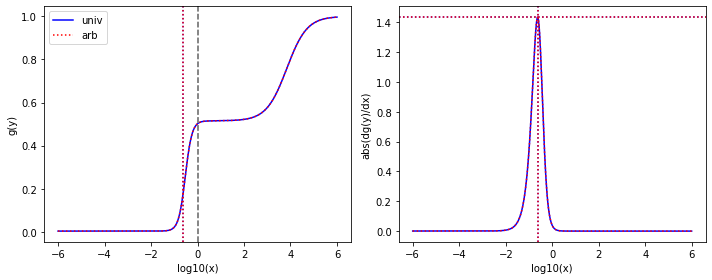

[7.54889e+02 8.87766e-03 2.35301e-03 1.00000e-03 1.75198e-01 2.17273e-02
 8.20140e+01 1.00000e-03 6.45796e-03 6.45796e-03]
found K1
found pairwise
found triplewise
3.1170278014383573e-06 3.1170278014383573e-06
0.00023208445215124342 0.00023208445215124342
0.10864378736476488 0.10864378736476489
8.55484713646642e-06 8.55484713646642e-06
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 1884801446805646.8
From univ parameters, position and steepness are: 0.0001533573638931695 1.4462639849172343 12699.666671642295
From arb parameters, position and steepness are: 0.00015335736389316944 1.4462639849172343 12699.666671642297


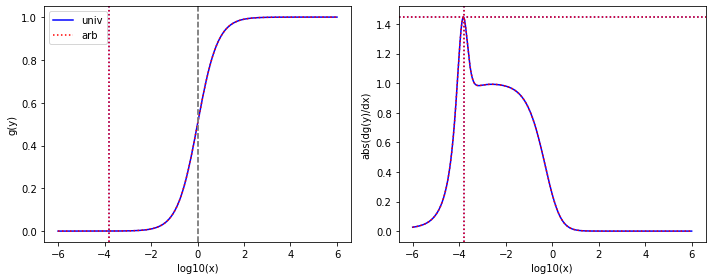

[3.89329e+02 3.21075e-01 1.00000e-03 1.00000e-03 1.78124e-01 1.00000e-03
 2.98461e+02 1.53340e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.5685217386837355e-06 2.5685217386837355e-06
0.00045751536618130167 0.00045751536618130167
0.7666035666492863 0.7666035666492863
2.5685217386837355e-06 2.568521738683735e-06
# maximal error is 4.235164736271502e-22
min-max are 2.498058915578641e-10 3715722341492155.0
From univ parameters, position and steepness are: 0.23687374886801066 1.4430785677739826 3.660919068607456
From arb parameters, position and steepness are: 0.23687374886801107 1.4430785677739801 3.6609190686074498


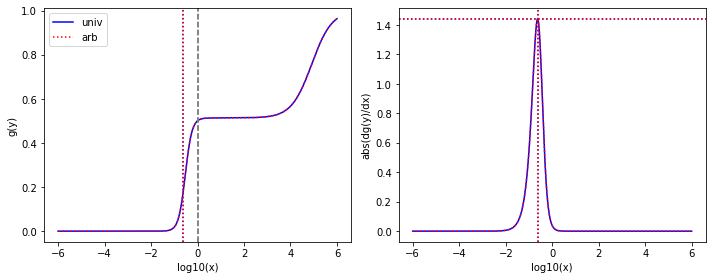

[1.00000e+03 5.96330e-03 1.00000e-03 1.00000e-03 1.03663e-01 1.00000e-03
 8.20140e+01 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
0.000103663 0.000103663
0.08201399999999999 0.08201399999999999
1e-06 9.999999999999997e-07
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 841883626388934.5
From univ parameters, position and steepness are: 3.050213750293624e-05 1.4543076669988206 82012.97938169181
From arb parameters, position and steepness are: 3.0502137502936236e-05 1.4543076669988209 82012.97938169182


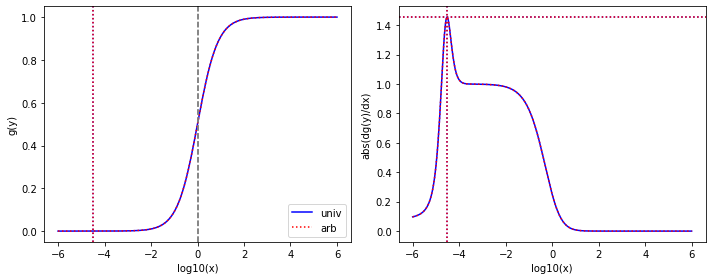

[3.99602e+01 2.09221e-01 1.00000e-03 1.00000e-03 3.02330e-01 1.00000e-03
 4.65198e+02 2.39633e+02 2.14904e-01 2.14904e-01]
found K1
found pairwise
found triplewise
2.50248997752764e-05 2.50248997752764e-05
0.007565777949059314 0.007565777949059314
11.64153332565903 11.64153332565903
0.005377951061306 0.005377951061306
# maximal error is 0.0
min-max are 2.498058915578641e-10 6.144640384546171e+16
From univ parameters, position and steepness are: 0.23327439616737375 1.456150012419225 1.5010844863189299
From arb parameters, position and steepness are: 0.23327439616737403 1.4561500124192235 1.5010844863189283


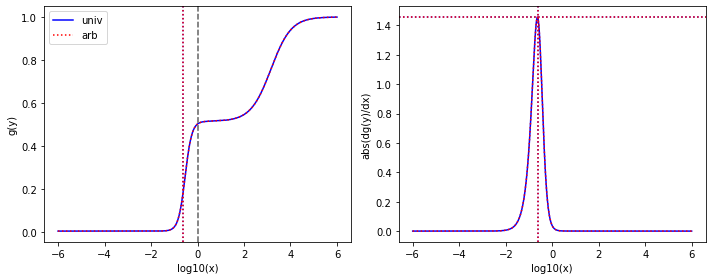

[1.00000e+03 2.55806e-03 1.00000e-03 1.00000e-03 3.79751e-01 1.34267e-03
 2.98461e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
0.000379751 0.00037975099999999995
0.29846100000000003 0.29846100000000003
1e-06 1e-06
# maximal error is 5.421010862427522e-20
min-max are 2.498058915578641e-10 3084205909370941.5
From univ parameters, position and steepness are: 4.421278624014488e-06 1.4649636786746454 298460.52822445636
From arb parameters, position and steepness are: 4.4212786240144875e-06 1.4649636786746454 298460.5282244564


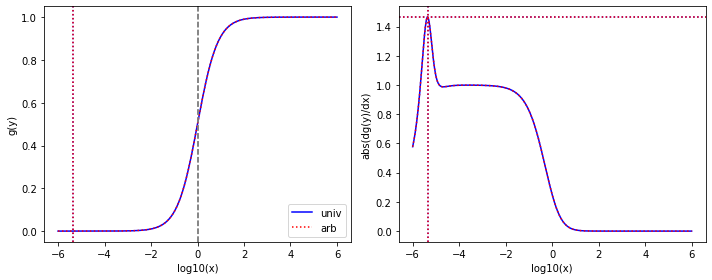

[1.00000e+03 1.53834e-03 1.00000e-03 1.00000e-03 1.25927e-03 1.00000e-03
 3.29832e+02 1.69085e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1.25927e-06 1.25927e-06
0.329832 0.329832
1e-06 9.999999999999997e-07
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 1052939850135478.2
From univ parameters, position and steepness are: 0.232983986410033 1.46688569253596 4.930591821815097
From arb parameters, position and steepness are: 0.23298398641003298 1.4668856925359601 4.930591821815097


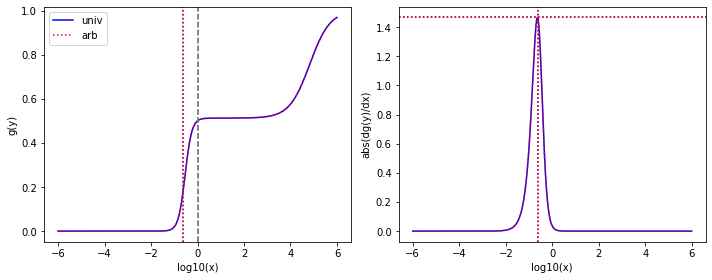

[1.00000e+03 6.01712e-03 7.13795e-01 1.17522e-03 1.38983e-03 1.00000e-03
 4.02990e+01 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0007137949999999999 0.0007137949999999999
1.38983e-06 1.3898299999999998e-06
0.040299 0.040299
1e-06 1e-06
# maximal error is 2.117582368135751e-22
min-max are 7.027031419536454e-09 2296434300.638387
From univ parameters, position and steepness are: 8.016004276787064e-05 1.4798172086248056 40297.48494403345
From arb parameters, position and steepness are: 8.016004276787063e-05 1.4798172086248056 40297.48494403346


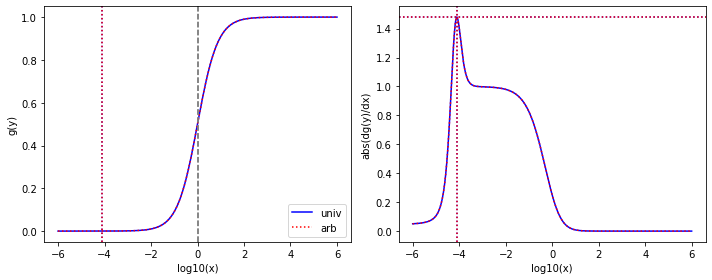

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 2.10402e-02 1.00000e-03
 2.96107e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
2.10402e-05 2.10402e-05
0.296107 0.296107
1e-06 1.0000000000000002e-06
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 170840533163709.94
From univ parameters, position and steepness are: 0.23106551949345766 1.4781406225425946 5.153504519716825
From arb parameters, position and steepness are: 0.23106551949345783 1.4781406225425935 5.1535045197168206


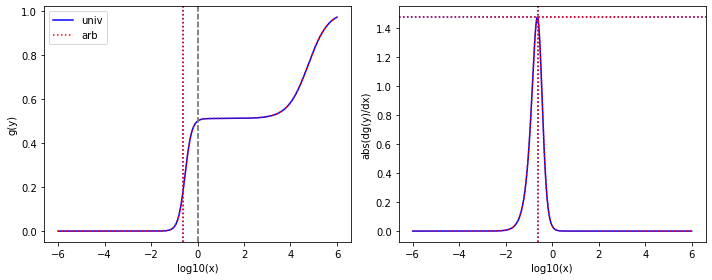

[1.00000e+03 1.87310e-03 2.64185e-02 2.49248e-03 1.00000e-03 1.00000e-03
 2.98461e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.64185e-05 2.64185e-05
1e-06 1e-06
0.29846100000000003 0.29846100000000003
1e-06 9.999999999999997e-07
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 1389553585886485.8
From univ parameters, position and steepness are: 3.7538796848081463e-06 1.4875873236436898 298460.11808959604
From arb parameters, position and steepness are: 3.753879684808144e-06 1.48758732364369 298460.11808959616


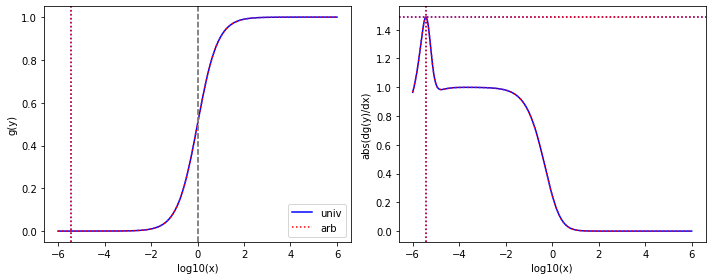

[9.91155e+01 1.00000e-03 1.00000e-03 1.00000e-03 1.77483e-01 1.77483e-01
 4.67876e+02 2.39633e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.0089239321801334e-05 1.0089239321801334e-05
0.001790668462551266 0.001790668462551266
4.72051293692712 4.72051293692712
1.0089239321801334e-05 1.0089239321801334e-05
# maximal error is 0.0
min-max are 2.498058915578641e-10 1.4542956457097476e+16
From univ parameters, position and steepness are: 0.2304905944075055 1.4812479280067263 2.051823142359654
From arb parameters, position and steepness are: 0.23049059440750552 1.4812479280067261 2.0518231423596536


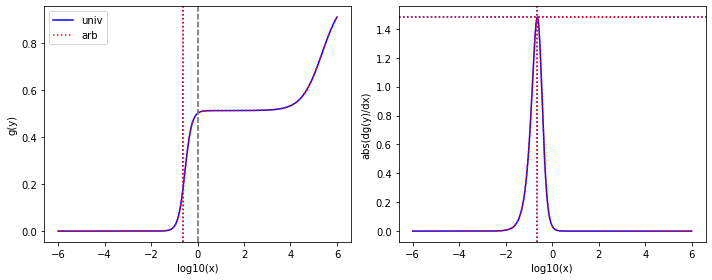

[1.00000e+03 2.14542e-03 2.04619e+00 7.89074e-03 2.38994e-01 1.20590e-03
 4.65198e+02 6.81035e-02 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
0.0020461900000000002 0.0020461900000000002
0.00023899400000000002 0.00023899400000000002
0.465198 0.46519800000000006
0.000174587 0.000174587
# maximal error is 5.551115123125783e-17
min-max are 3.529814346881038e-10 394909136434.7124
From univ parameters, position and steepness are: 0.0005513920024240937 1.4981297735180457 2663.794428884534
From arb parameters, position and steepness are: 0.0005513920024240936 1.4981297735180457 2663.7944288845347


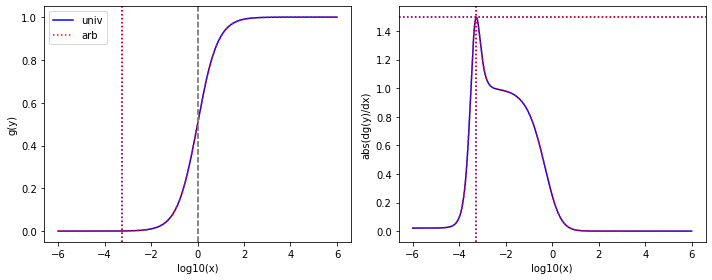

[2.88610e+00 1.00000e-03 1.58602e-02 1.00000e-03 5.65288e-03 3.42499e-03
 4.43150e+02 2.26413e+02 1.37598e+00 1.37598e+00]
found K1
found pairwise
found triplewise
0.005495374380652091 0.005495374380652091
0.0019586570111915736 0.0019586570111915736
153.5463081667302 153.5463081667302
0.47676102699144174 0.4767610269914418
# maximal error is 5.551115123125783e-17
min-max are 3.529814346881038e-10 3236448247662.094
From univ parameters, position and steepness are: 0.22723131301181107 1.4988902137197688 0.6524202285268236
From arb parameters, position and steepness are: 0.2272313130118109 1.4988902137197697 0.6524202285268239


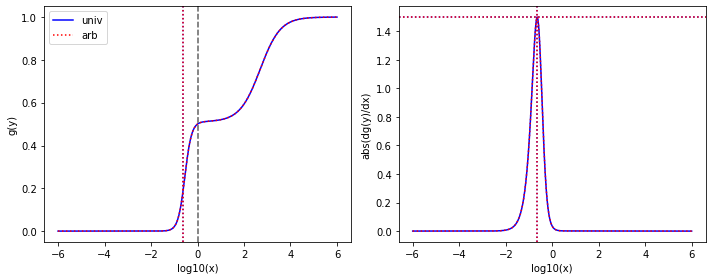

[5.38808e+02 1.53834e-03 1.42145e-03 1.42145e-03 1.25927e-03 1.00000e-03
 3.29832e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.638138260753367e-06 2.638138260753367e-06
2.3371405027393804e-06 2.3371405027393804e-06
0.6121512672417633 0.6121512672417633
1.8559486867307094e-06 1.8559486867307094e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 1054822689001065.6
From univ parameters, position and steepness are: 2.1147426490494424e-06 1.5083083341425234 329831.88339098217
From arb parameters, position and steepness are: 2.114742649049443e-06 1.5083083341425234 329831.88339098217


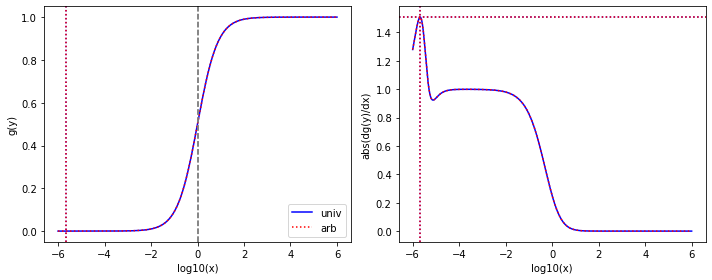

[4.01668e+01 1.00000e-03 1.00000e-03 1.00000e-03 1.02707e+01 1.25927e-03
 3.29832e+02 1.71417e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.4896182917235127e-05 2.4896182917235127e-05
0.25570122588804683 0.25570122588804683
8.211557803957497 8.211557803957499
2.4896182917235127e-05 2.4896182917235127e-05
# maximal error is 1.7763568394002505e-15
min-max are 2.498058915578641e-10 2.07674459008607e+18
From univ parameters, position and steepness are: 0.22042538576178716 1.501949157695397 1.7731473502335044
From arb parameters, position and steepness are: 0.22042538576178697 1.501949157695398 1.773147350233506


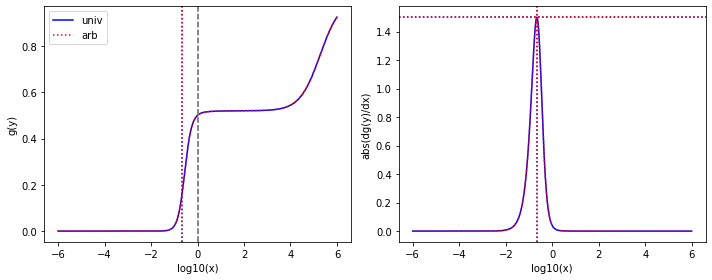

[1.22725e+02 1.74668e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 8.20140e+01 1.28034e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
8.148299042574863e-06 8.148299042574863e-06
8.148299042574863e-06 8.148299042574863e-06
0.6682745976777348 0.6682745976777348
8.148299042574863e-06 8.148299042574863e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 330062087502746.25
From univ parameters, position and steepness are: 9.503479172247185e-06 1.5151530624093432 82013.77382833674
From arb parameters, position and steepness are: 9.503479172247183e-06 1.5151530624093432 82013.77382833674


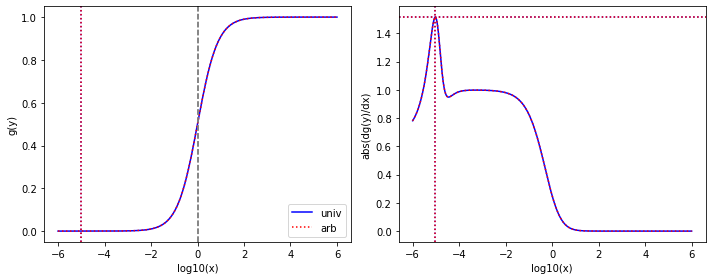

[1.00000e+03 2.85140e-02 1.40764e-01 1.00000e-03 1.01170e-03 1.01170e-03
 5.22308e+02 2.67150e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.000140764 0.000140764
1.0117e-06 1.0117e-06
0.522308 0.522308
1e-06 9.999999999999997e-07
# maximal error is 2.117582368135751e-22
min-max are 7.027031419536454e-09 4627500699.885916
From univ parameters, position and steepness are: 0.22548263614897757 1.512067857693998 4.370965682921789
From arb parameters, position and steepness are: 0.22548263614897762 1.5120678576939977 4.3709656829217876


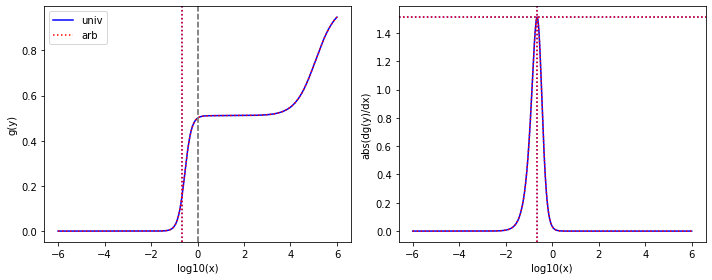

[1.00000e+03 2.62002e-03 3.54659e-03 1.00000e-03 2.47823e-01 1.00000e-03
 1.58191e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.54659e-06 3.54659e-06
0.000247823 0.000247823
0.158191 0.158191
1e-06 1e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 2012607746163741.8
From univ parameters, position and steepness are: 1.1785691462841859e-05 1.5202836544087648 158189.83047808261
From arb parameters, position and steepness are: 1.1785691462841857e-05 1.5202836544087648 158189.83047808261


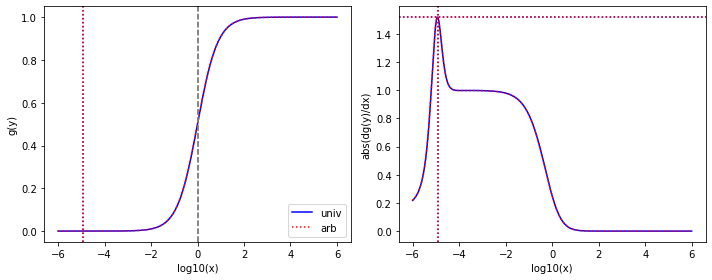

[5.16331e+01 2.80167e-02 1.00000e-03 1.00000e-03 2.17495e-02 1.00000e-03
 2.96666e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.936742128595804e-05 1.936742128595804e-05
0.0004212317292589444 0.0004212317292589444
5.745655403220027 5.745655403220028
1.936742128595804e-05 1.936742128595804e-05
# maximal error is 8.881784197001252e-16
min-max are 2.498058915578641e-10 3420311160102490.5
From univ parameters, position and steepness are: 0.22300703421883275 1.5269324714973211 1.9870761283126028
From arb parameters, position and steepness are: 0.22300703421883267 1.5269324714973218 1.9870761283126035


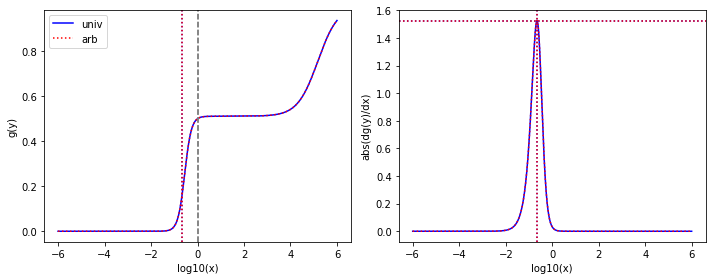

[1.00000e+03 1.53834e-03 7.18782e-03 1.42145e-03 1.25927e-03 1.00000e-03
 1.00000e+03 1.00000e-03 1.17688e-03 1.00000e-03]
found K1
found pairwise
found triplewise
7.18782e-06 7.18782e-06
1.25927e-06 1.25927e-06
1.0 0.9999999999999999
1.17688e-06 1.17688e-06
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 3278186878916917.5
From univ parameters, position and steepness are: 3.8474680298809834e-07 1.5333623136169099 849705.3795834447
From arb parameters, position and steepness are: 3.847468029880983e-07 1.53336231361691 849705.3795834448


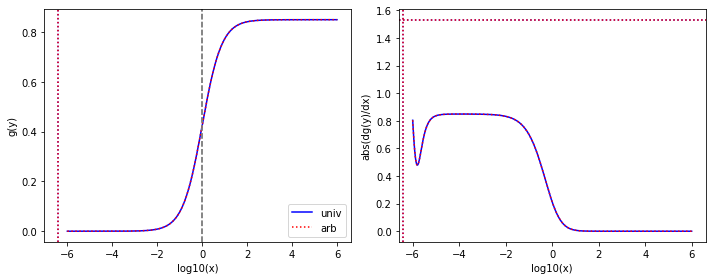

[4.58464e+02 1.00000e-03 2.69717e-02 1.14716e-03 1.00000e-03 1.00000e-03
 4.43150e+02 2.26413e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
5.883057339289454e-05 5.883057339289454e-05
2.1811963425699727e-06 2.1811963425699727e-06
0.9665971592098834 0.9665971592098834
2.1811963425699727e-06 2.1811963425699727e-06
# maximal error is 0.0
min-max are 2.439715342954195e-10 183648033029.5426
From univ parameters, position and steepness are: 0.22184845413611712 1.535294740083388 3.6184329884266404
From arb parameters, position and steepness are: 0.22184845413611695 1.5352947400833892 3.6184329884266426


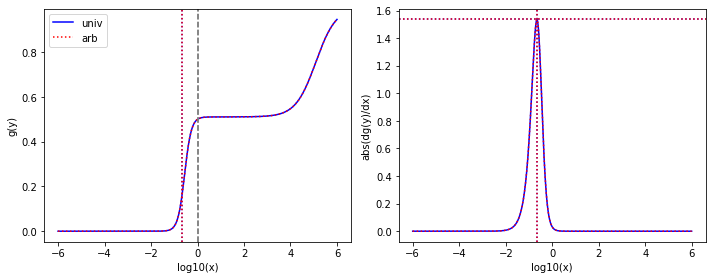

[6.57639e+02 1.90779e-03 9.12093e-02 1.00000e-03 1.00000e-03 1.00000e-03
 8.37244e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00013869204837304355 0.00013869204837304355
1.5205910841662372e-06 1.5205910841662372e-06
1.273105761671677 1.273105761671677
1.5205910841662372e-06 1.5205910841662372e-06
# maximal error is 0.0
min-max are 7.027031419536454e-09 7511047521.331181
From univ parameters, position and steepness are: 2.4387057110853746e-07 1.5444756546866256 837246.8576439779
From arb parameters, position and steepness are: 2.438705711085374e-07 1.5444756546866258 837246.8576439779


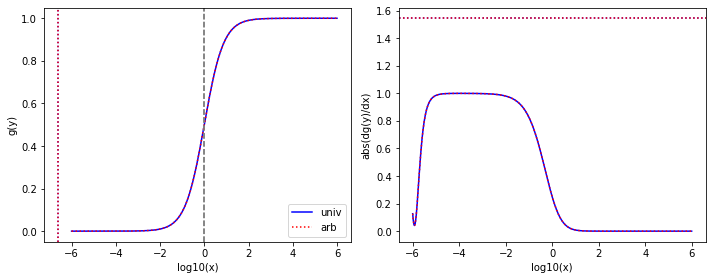

[2.05547e+00 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.43150e+02 2.26413e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0004865067356857555 0.0004865067356857555
0.0004865067356857555 0.0004865067356857555
215.59545991914254 215.59545991914257
0.0004865067356857555 0.0004865067356857555
# maximal error is 2.842170943040401e-14
min-max are 7.027031419536454e-09 803894568760.8107
From univ parameters, position and steepness are: 0.22024031050524295 1.544923744551409 0.6009703730548893
From arb parameters, position and steepness are: 0.22024031050524356 1.544923744551405 0.6009703730548877


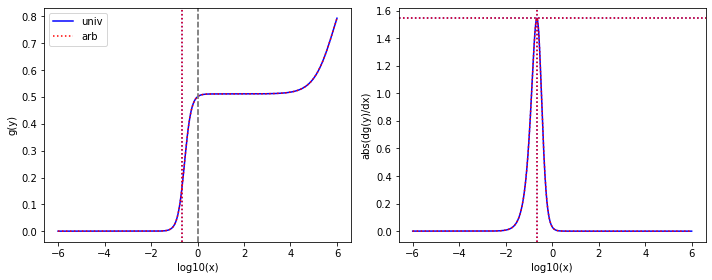

[1.43475e+02 6.42868e-03 2.14085e-03 2.14085e-03 1.00000e-03 1.00000e-03
 6.62545e+00 1.37053e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.4921414880641228e-05 1.4921414880641228e-05
6.9698553755009586e-06 6.9698553755009586e-06
0.046178428297612824 0.046178428297612824
6.9698553755009586e-06 6.969855375500958e-06
# maximal error is 8.470329472543003e-22
min-max are 2.498058915578641e-10 55964532020025.14
From univ parameters, position and steepness are: 0.00044592016095974194 1.5513980421650155 6623.30242592023
From arb parameters, position and steepness are: 0.0004459201609597419 1.5513980421650155 6623.302425920231


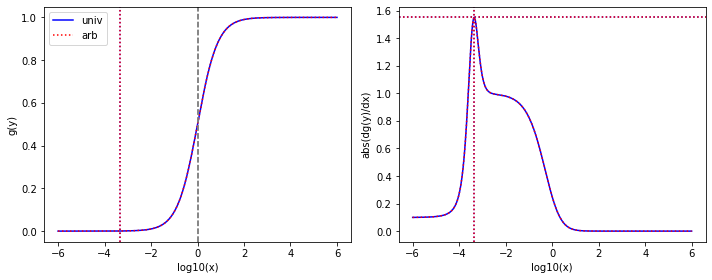

[3.00185e+02 4.30247e-03 1.00000e-03 1.00000e-03 6.25248e-01 3.62192e-02
 4.63456e+02 2.36647e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.3312790445891703e-06 3.3312790445891703e-06
0.0020828755600712894 0.0020828755600712894
1.5439012608891185 1.5439012608891183
3.3312790445891703e-06 3.3312790445891703e-06
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 1.6916485523098036e+16
From univ parameters, position and steepness are: 0.21837385397475625 1.5570952402684846 3.1440319968257295
From arb parameters, position and steepness are: 0.2183738539747561 1.5570952402684854 3.144031996825732


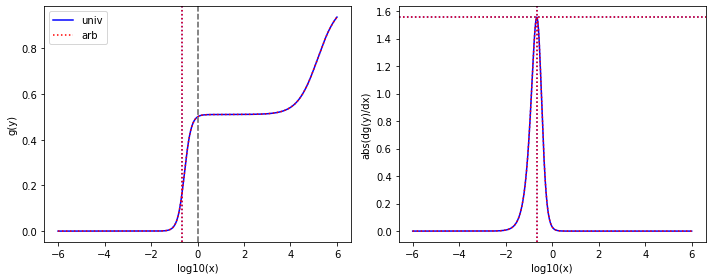

[1.00000e+03 1.02140e-03 2.09983e-03 1.00000e-03 7.42602e+00 1.00000e-03
 1.04908e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.09983e-06 2.09983e-06
0.00742602 0.00742602
0.104908 0.104908
1e-06 1e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 6.031231037142229e+16
From univ parameters, position and steepness are: 2.0692987973266407e-05 1.5625086788819131 104906.2850724985
From arb parameters, position and steepness are: 2.0692987973266404e-05 1.5625086788819131 104906.28507249853


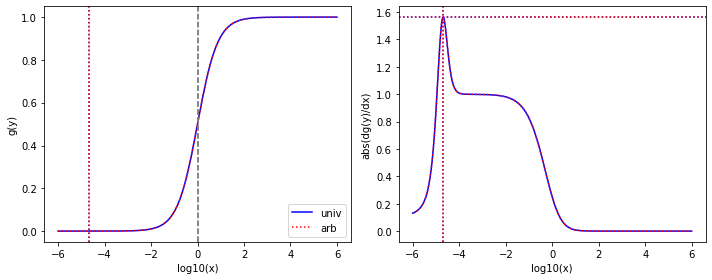

[8.17930e-01 1.00000e-03 1.83422e-03 1.00000e-03 4.83359e-03 1.00000e-03
 4.43150e+02 2.26413e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0022425146406171675 0.0022425146406171675
0.005909539936180357 0.005909539936180357
541.7945300942623 541.7945300942623
0.0012225985108750136 0.0012225985108750138
# maximal error is 2.168404344971009e-19
min-max are 7.027031419536454e-09 9764813565869.39
From univ parameters, position and steepness are: 0.21764537280740903 1.560803293021093 0.4472859828411985
From arb parameters, position and steepness are: 0.21764537280740887 1.5608032930210942 0.44728598284119886


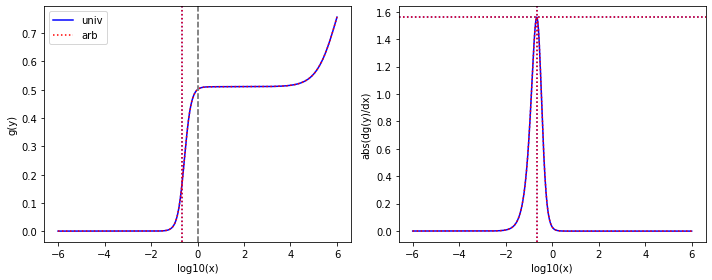

[1.00000e+03 2.38813e-02 7.88049e-03 1.00000e-03 2.25905e-03 2.25905e-03
 2.77368e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
7.880490000000001e-06 7.880490000000001e-06
2.25905e-06 2.25905e-06
0.277368 0.277368
1e-06 9.999999999999997e-07
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 500773209108463.9
From univ parameters, position and steepness are: 4.412698448383897e-06 1.5724751582188625 277375.9008133515
From arb parameters, position and steepness are: 4.412698448383897e-06 1.5724751582188623 277375.90081335144


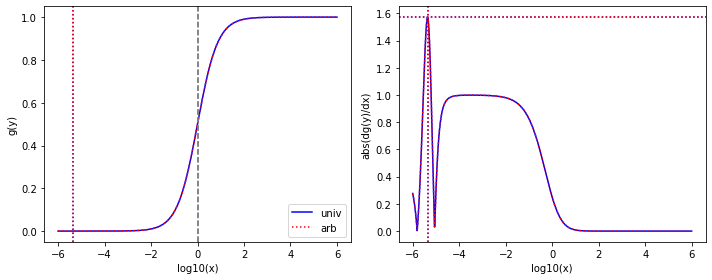

[5.67153e-01 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.43150e+02 2.26413e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0017631926481919342 0.0017631926481919344
0.0017631926481919342 0.0017631926481919342
781.3588220462556 781.3588220462556
0.0017631926481919342 0.0017631926481919344
# maximal error is 2.168404344971009e-19
min-max are 7.027031419536454e-09 2913466578057.229
From univ parameters, position and steepness are: 0.21587065064105487 1.572048204826423 0.3991345874750653
From arb parameters, position and steepness are: 0.2158706506410547 1.5720482048264242 0.3991345874750656


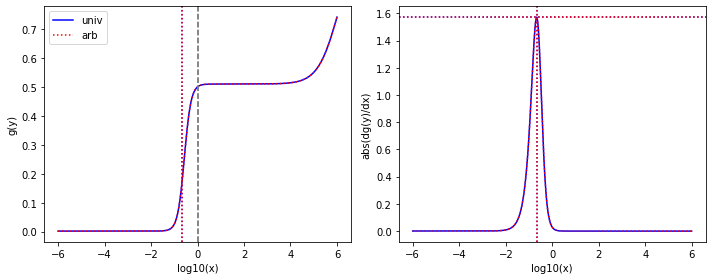

[7.54889e+02 1.50021e-03 1.00000e-03 1.00000e-03 7.61117e-03 1.00000e-03
 8.20140e+01 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
1.0082502195687048e-05 1.0082502195687046e-05
0.10864378736476488 0.10864378736476488
1.3246980681928071e-06 1.324698068192807e-06
# maximal error is 1.6940658945086007e-21
min-max are 2.498058915578641e-10 81830676738454.11
From univ parameters, position and steepness are: 2.611617240844357e-05 1.5800889700222263 82012.3260420858
From arb parameters, position and steepness are: 2.6116172408443566e-05 1.5800889700222263 82012.32604208581


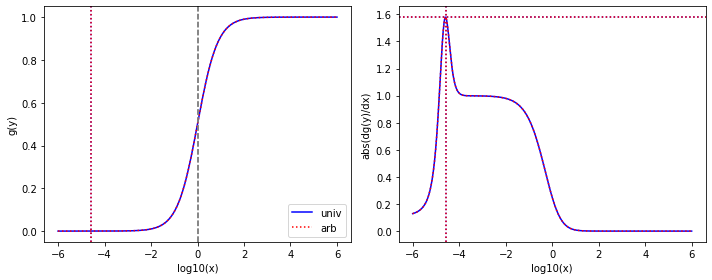

[4.70671e-01 1.00000e-03 1.83422e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.43150e+02 2.26413e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0038970321094777454 0.0038970321094777454
0.002124626331343975 0.002124626331343975
941.5281587350825 941.5281587350825
0.002124626331343975 0.002124626331343975
# maximal error is 0.0
min-max are 7.027031419536454e-09 3510692859803.9355
From univ parameters, position and steepness are: 0.2145547761055413 1.5804064898918395 0.37738399403531003
From arb parameters, position and steepness are: 0.21455477610554113 1.5804064898918408 0.3773839940353103


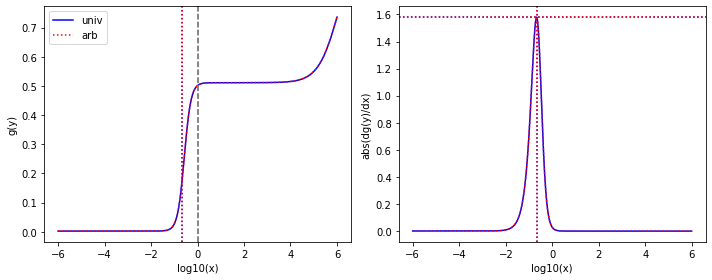

[7.54889e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.89127e-03 1.00000e-03
 8.20140e+01 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.3246980681928071e-06 1.3246980681928071e-06
2.5053617154310105e-06 2.5053617154310105e-06
0.10864378736476488 0.10864378736476486
1.3246980681928071e-06 1.324698068192807e-06
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 174080923906212.06
From univ parameters, position and steepness are: 2.5976584255147426e-05 1.5991857113004415 82012.21728388863
From arb parameters, position and steepness are: 2.5976584255147422e-05 1.5991857113004415 82012.21728388865


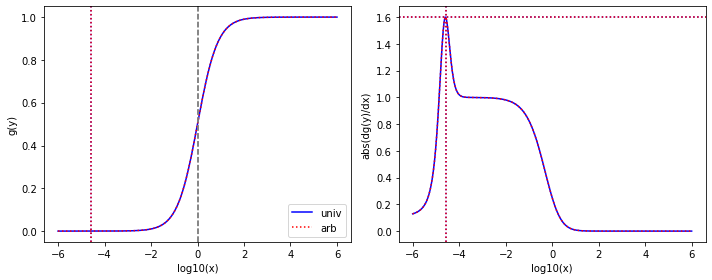

[3.49776e-01 1.00000e-03 1.83422e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.43150e+02 2.26413e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.005243984721650428 0.005243984721650428
0.0028589725996066057 0.0028589725996066057
1266.9537075156672 1266.9537075156672
0.0028589725996066057 0.002858972599606606
# maximal error is 4.336808689942018e-19
min-max are 7.027031419536454e-09 4724112947890.973
From univ parameters, position and steepness are: 0.2119073770767452 1.5977267276568954 0.34608918081866175
From arb parameters, position and steepness are: 0.21190737707674503 1.5977267276568967 0.346089180818662


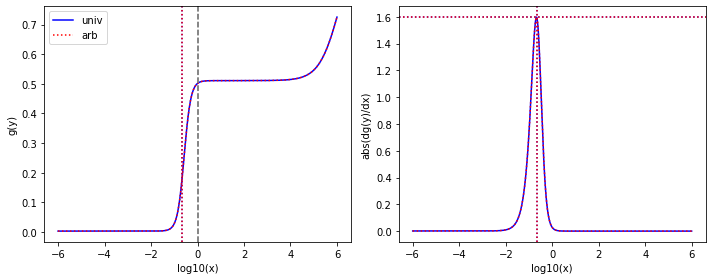

[5.21995e+02 1.00000e-03 7.05591e-03 1.82058e-03 1.00000e-03 1.00000e-03
 1.02798e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.351719844059809e-05 1.351719844059809e-05
1.9157271621375685e-06 1.9157271621375685e-06
0.19693292081341776 0.19693292081341773
1.9157271621375685e-06 1.915727162137569e-06
# maximal error is 2.7755575615628914e-17
min-max are 2.498058915578641e-10 427516600370906.3
From univ parameters, position and steepness are: 1.533888863724408e-05 1.608155271575493 102796.39385303755
From arb parameters, position and steepness are: 1.5338888637244083e-05 1.6081552715754928 102796.39385303752


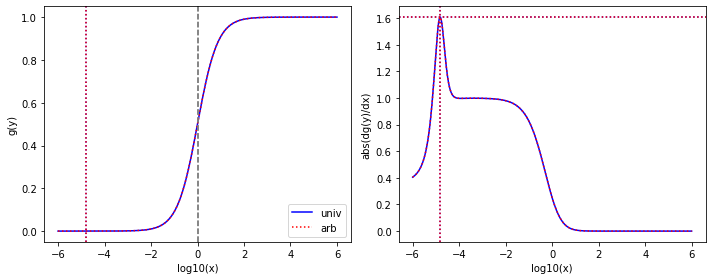

[3.02003e-01 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.43150e+02 2.26413e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0033112253851782926 0.0033112253851782926
0.0033112253851782926 0.003311225385178292
1467.3695294417603 1467.3695294417603
0.0033112253851782926 0.0033112253851782926
# maximal error is 4.336808689942018e-19
min-max are 7.027031419536454e-09 5471407023260.615
From univ parameters, position and steepness are: 0.2102994869357758 1.6085974798598848 0.3320590752887621
From arb parameters, position and steepness are: 0.21029948693577646 1.6085974798598799 0.33205907528876105


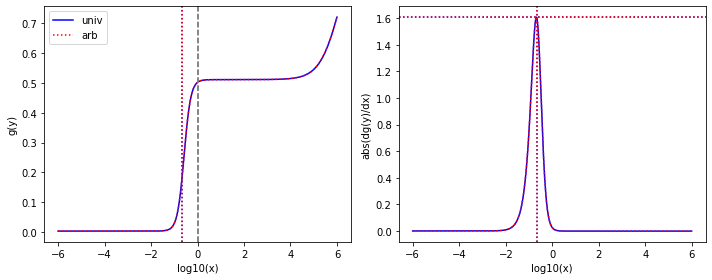

[3.73297e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 6.18703e+02 1.00000e-03 1.38129e-03 1.38129e-03]
found K1
found pairwise
found triplewise
2.6788321363418402e-06 2.6788321363418402e-06
2.6788321363418402e-06 2.6788321363418402e-06
1.6574014792511056 1.6574014792511056
3.7002440416076205e-06 3.700244041607621e-06
# maximal error is 4.235164736271502e-22
min-max are 2.498058915578641e-10 2489942906588512.0
From univ parameters, position and steepness are: 6.715648558246272e-07 1.6164446570309796 447917.75427625485
From arb parameters, position and steepness are: 6.715648558246272e-07 1.6164446570309796 447917.75427625485


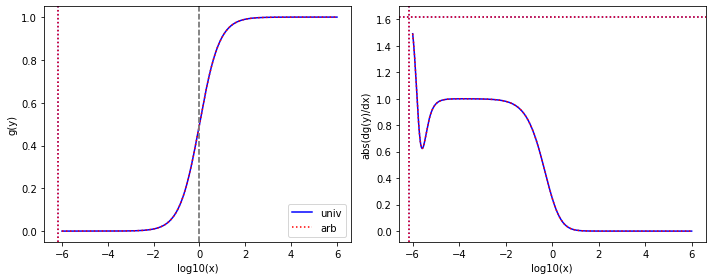

[2.96327e-01 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.43150e+02 2.26413e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.0033746503018624694 0.0033746503018624694
0.0033746503018624694 0.003374650301862469
1495.4762812703532 1495.476281270353
0.0033746503018624694 0.0033746503018624685
# maximal error is 2.2737367544323206e-13
min-max are 7.027031419536454e-09 5576209173592.362
From univ parameters, position and steepness are: 0.21006439422982676 1.6101894387465916 0.33033405072996347
From arb parameters, position and steepness are: 0.2100643942298266 1.610189438746593 0.33033405072996375


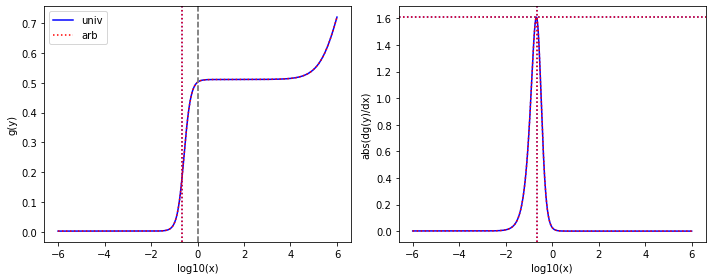

[1.00000e+03 1.00000e-03 4.37360e-02 2.82446e-03 1.00000e-03 1.00000e-03
 2.77368e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
4.3735999999999996e-05 4.3735999999999996e-05
1e-06 1e-06
0.277368 0.277368
1e-06 9.999999999999995e-07
# maximal error is 4.235164736271502e-22
min-max are 2.498058915578641e-10 1445869932535595.8
From univ parameters, position and steepness are: 4.136214606537394e-06 1.6255376520959888 277366.5547309499
From arb parameters, position and steepness are: 4.136214606537392e-06 1.625537652095989 277366.55473095004


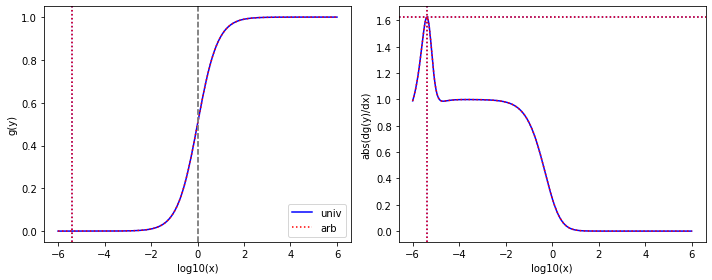

[5.53962e+02 4.52152e-02 3.37632e-03 1.00000e-03 7.97162e-03 1.00000e-03
 4.71289e+02 2.39633e+02 1.74587e-01 1.74587e-01]
found K1
found pairwise
found triplewise
6.094858492098736e-06 6.094858492098736e-06
1.4390192829111022e-05 1.4390192829111022e-05
0.8507605214798127 0.8507605214798127
0.000315160606684213 0.00031516060668421305
# maximal error is 5.421010862427522e-20
min-max are 2.498058915578641e-10 237200185490022.53
From univ parameters, position and steepness are: 0.20927338649761712 1.620711618665056 4.002960243918003
From arb parameters, position and steepness are: 0.2092733864976166 1.6207116186650599 4.002960243918014


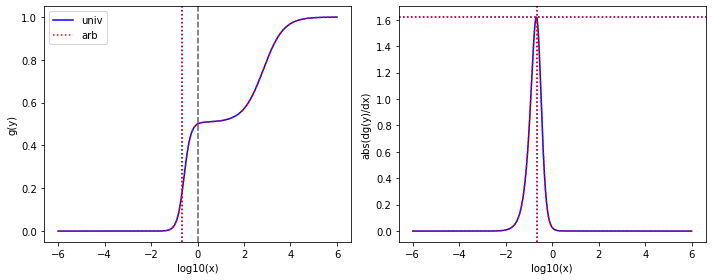

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 7.42602e+00 1.00000e-03
 2.98461e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
0.00742602 0.00742602
0.29846100000000003 0.29846100000000003
1e-06 1e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 6.031235776886989e+16
From univ parameters, position and steepness are: 4.514449412207907e-06 1.639471637462508 298459.6217951003
From arb parameters, position and steepness are: 4.514449412207907e-06 1.639471637462508 298459.6217951003


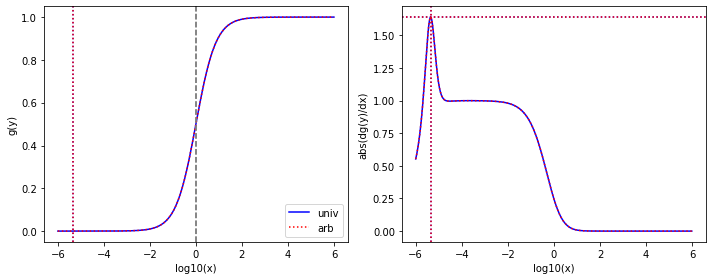

[2.34735e-01 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.43150e+02 2.26413e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.004260123117558097 0.004260123117558097
0.004260123117558097 0.004260123117558097
1887.8735595458709 1887.8735595458709
0.004260123117558097 0.004260123117558097
# maximal error is 0.0
min-max are 7.027031419536454e-09 7039347952430.6875
From univ parameters, position and steepness are: 0.20672199968461882 1.6332732161597658 0.31057983711086123
From arb parameters, position and steepness are: 0.20672199968461866 1.6332732161597672 0.31057983711086146


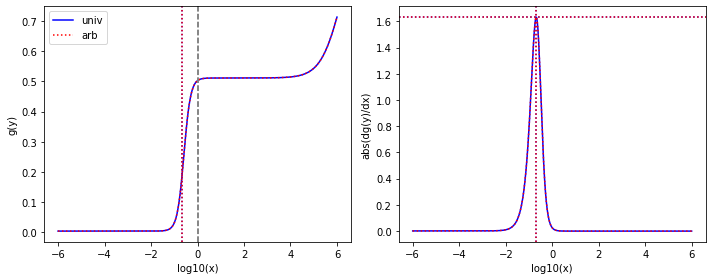

[1.00000e+03 1.04809e-03 1.22631e-03 1.00000e-03 1.00000e-03 1.00000e-03
 2.77368e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.22631e-06 1.22631e-06
1e-06 1e-06
0.277368 0.277368
1e-06 1e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 1117601369522494.6
From univ parameters, position and steepness are: 5.039922051951118e-06 1.6497521877711117 277366.58140816214
From arb parameters, position and steepness are: 5.0399220519511175e-06 1.6497521877711117 277366.58140816214


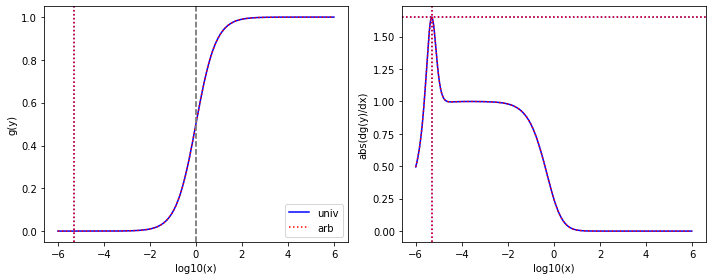

[3.08797e+01 2.78672e-03 1.57641e-03 1.06819e-03 1.32013e-01 3.58482e-03
 4.41163e+02 2.24505e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
5.10500425846106e-05 5.10500425846106e-05
0.004275073915873535 0.004275073915873535
14.286505374080708 14.286505374080708
3.238373429793683e-05 3.238373429793684e-05
# maximal error is 6.776263578034403e-21
min-max are 2.498058915578641e-10 3.471895234604661e+16
From univ parameters, position and steepness are: 0.2061390819920119 1.6446148648045071 1.5866425062977834
From arb parameters, position and steepness are: 0.20613908199201145 1.6446148648045105 1.5866425062977871


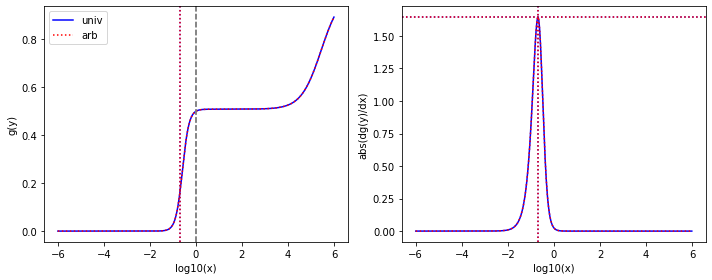

[1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 2.98461e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1e-06 1e-06
1e-06 1e-06
0.29846100000000003 0.2984610000000001
1e-06 1e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 1201139774802516.8
From univ parameters, position and steepness are: 4.508883624263921e-06 1.6594449313106456 298459.5969172464
From arb parameters, position and steepness are: 4.5088836242639186e-06 1.6594449313106459 298459.5969172465


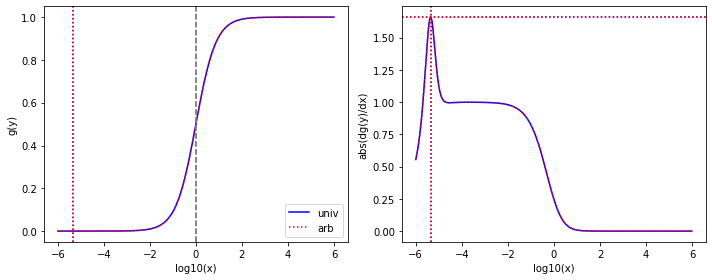

[1.95598e-01 1.00000e-03 1.83422e-03 1.00000e-03 1.00000e-03 1.00000e-03
 4.43150e+02 2.26413e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.009377498747430955 0.009377498747430957
0.005112526712952075 0.005112526712952075
2265.616212844712 2265.616212844712
0.005112526712952075 0.005112526712952076
# maximal error is 1.734723475976807e-18
min-max are 7.027031419536454e-09 8447843766587.799
From univ parameters, position and steepness are: 0.20331433783235725 1.6575547861205888 0.2971621439198213
From arb parameters, position and steepness are: 0.20331433783235706 1.6575547861205902 0.2971621439198216


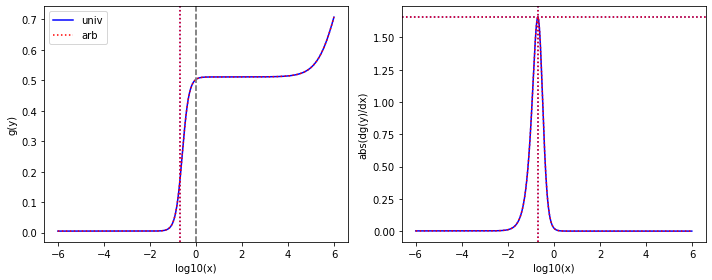

[5.59680e+02 1.00000e-03 1.76448e-03 1.00000e-03 3.93878e-03 1.00000e-03
 3.29832e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.1526586620926244e-06 3.1526586620926244e-06
7.037557175528875e-06 7.037557175528874e-06
0.5893224699828474 0.5893224699828474
1.7867352773013152e-06 1.7867352773013152e-06
# maximal error is 8.470329472543003e-22
min-max are 2.498058915578641e-10 336017326029637.4
From univ parameters, position and steepness are: 2.697107500669005e-06 1.667182108875616 329831.17864935054
From arb parameters, position and steepness are: 2.697107500669005e-06 1.6671821088756158 329831.17864935054


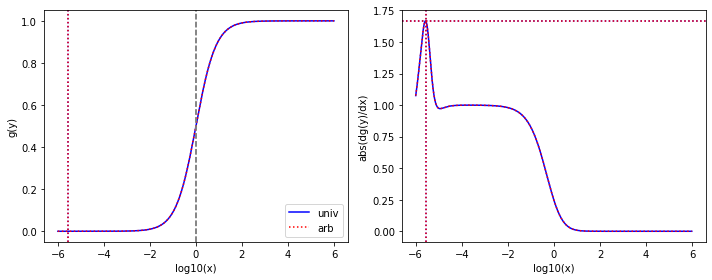

[2.23599e+01 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03 1.00000e-03
 2.77368e+02 1.41015e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
4.472291915437905e-05 4.472291915437905e-05
4.472291915437905e-05 4.472291915437905e-05
12.404706640011806 12.404706640011806
4.472291915437905e-05 4.472291915437905e-05
# maximal error is 0.0
min-max are 2.498058915578641e-10 1116256999886546.2
From univ parameters, position and steepness are: 0.2031686728079593 1.6680680264286722 1.687575437967034
From arb parameters, position and steepness are: 0.20316867280796014 1.6680680264286658 1.6875754379670271


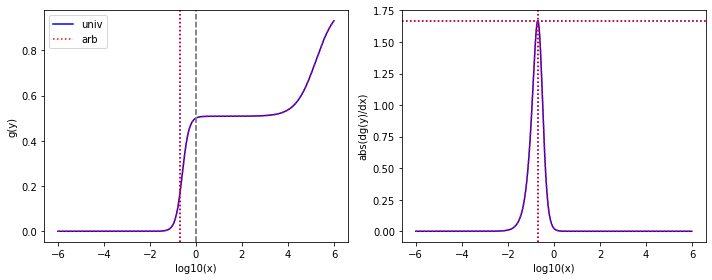

[3.89329e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.68491e-01 1.00000e-03
 2.98461e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.5685217386837355e-06 2.5685217386837355e-06
0.00043277279627256123 0.00043277279627256123
0.7666035666492863 0.7666035666492863
2.5685217386837355e-06 2.568521738683735e-06
# maximal error is 4.235164736271502e-22
min-max are 2.498058915578641e-10 3514768964870901.0
From univ parameters, position and steepness are: 2.3728171797317875e-06 1.6792528766263917 298460.5337637698
From arb parameters, position and steepness are: 2.3728171797317875e-06 1.6792528766263919 298460.5337637698


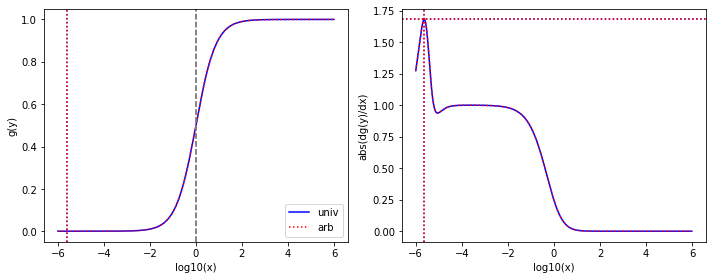

[3.89329e+02 1.00000e-03 1.00000e-03 1.00000e-03 1.68491e-01 3.97684e-03
 2.98461e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.5685217386837355e-06 2.5685217386837355e-06
0.00043277279627256123 0.00043277279627256123
0.7666035666492863 0.7666035666492863
2.5685217386837355e-06 2.568521738683735e-06
# maximal error is 4.235164736271502e-22
min-max are 2.498058915578641e-10 3514768964870901.0
From univ parameters, position and steepness are: 0.2019480999329602 1.6773433431477212 4.2940396980674365
From arb parameters, position and steepness are: 0.20194809993296067 1.6773433431477174 4.294039698067426


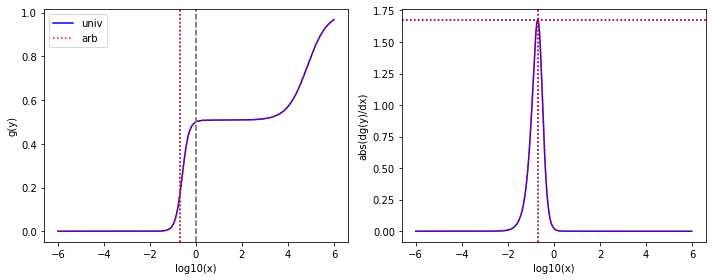

[5.27996e+02 1.00000e-03 1.29060e-03 1.29060e-03 1.02533e-02 1.00000e-03
 2.98461e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.4443366995204512e-06 2.4443366995204512e-06
1.941927590360533e-05 1.941927590360533e-05
0.5652713278130895 0.5652713278130895
1.8939537420738038e-06 1.8939537420738036e-06
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 157613522009560.16
From univ parameters, position and steepness are: 2.8472603426944905e-06 1.685484156638157 298460.13056866196
From arb parameters, position and steepness are: 2.847260342694491e-06 1.685484156638157 298460.13056866196


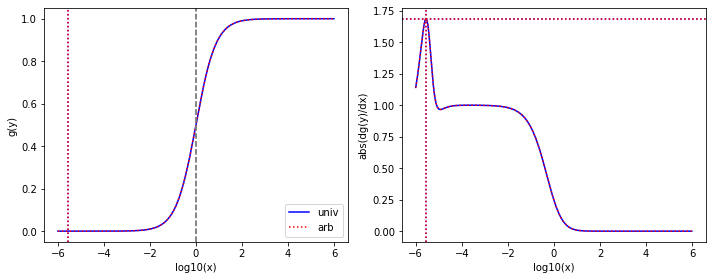

[3.89329e+02 6.66339e-02 7.42719e-03 1.00000e-03 1.78124e-01 1.00000e-03
 2.98461e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.907689897233445e-05 1.907689897233445e-05
0.00045751536618130167 0.00045751536618130167
0.7666035666492863 0.7666035666492863
2.5685217386837355e-06 2.5685217386837355e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 3715010908866195.0
From univ parameters, position and steepness are: 0.20121657634945891 1.6828248231397733 4.30967225450472
From arb parameters, position and steepness are: 0.20121657634945941 1.6828248231397696 4.30967225450471


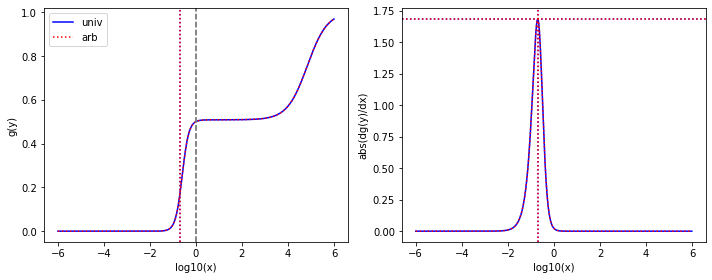

[9.15338e+02 1.00000e-03 3.03176e-01 1.00000e-03 9.89697e-02 1.07577e-03
 4.49770e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00033121753931334656 0.00033121753931334656
0.0001081236657934009 0.00010812366579340089
0.49137040087923806 0.4913704008792381
1.0924926092874983e-06 1.0924926092874983e-06
# maximal error is 5.551115123125783e-17
min-max are 3.529814346881038e-10 178661435609.8521
From univ parameters, position and steepness are: 2.2168470971030205e-06 1.6910776660502171 449768.9829549543
From arb parameters, position and steepness are: 2.2168470971030205e-06 1.6910776660502171 449768.9829549543


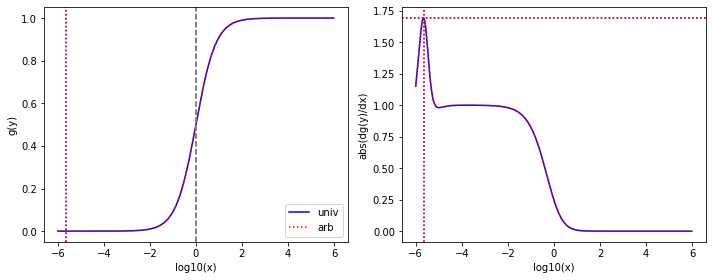

[3.89329e+02 2.29450e-01 1.56527e-02 1.00000e-03 1.09572e-03 1.09572e-03
 2.98461e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
4.02043002190949e-05 4.02043002190949e-05
2.814380639510542e-06 2.814380639510542e-06
0.7666035666492863 0.7666035666492863
2.5685217386837355e-06 2.568521738683736e-06
# maximal error is 4.235164736271502e-22
min-max are 2.498058915578641e-10 1179827641784151.5
From univ parameters, position and steepness are: 0.20008976002139825 1.6915685357813324 4.334201673908075
From arb parameters, position and steepness are: 0.20008976002139872 1.6915685357813284 4.334201673908065


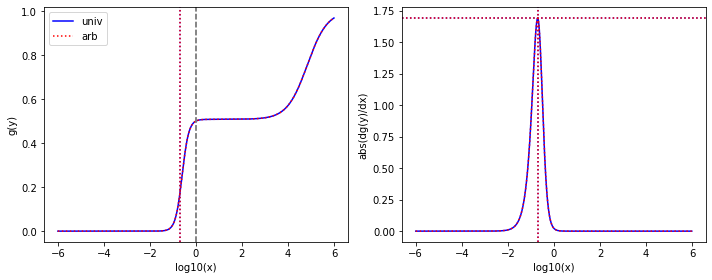

[2.33593e-01 2.33593e-01 1.25856e-03 1.00000e-03 8.73433e-02 1.60708e-03
 1.00000e+03 1.00000e+03 1.70383e+01 1.00000e-03]
found K1
found pairwise
found triplewise
0.005387832683342394 0.005387832683342394
0.37391231757800963 0.37391231757800963
4280.950199706327 4280.950199706327
72.9401137876563 72.94011378765632
# maximal error is 1.4210854715202004e-14
min-max are 3.529814346881038e-10 617845745295375.1
From univ parameters, position and steepness are: 0.0008001509137920853 1.7018367015213602 58.69121730334566
From arb parameters, position and steepness are: 0.0008001509137920852 1.7018367015213602 58.69121730334567


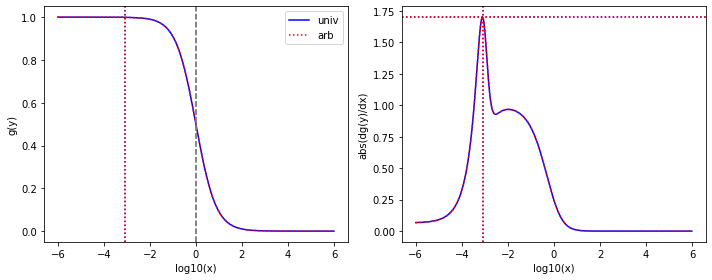

[1.00000e+03 1.06774e+00 1.38361e-03 1.00000e-03 1.68491e-01 1.00000e-03
 2.98461e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.38361e-06 1.38361e-06
0.000168491 0.000168491
0.29846100000000003 0.2984610000000001
1e-06 1e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 1368384976459470.8
From univ parameters, position and steepness are: 0.1977349115557079 1.7096638939860727 6.006109535699248
From arb parameters, position and steepness are: 0.19773491155570747 1.7096638939860762 6.006109535699261


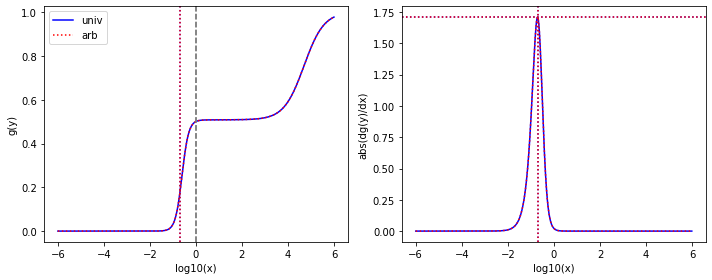

[3.89329e+02 1.00000e-03 1.00000e-03 1.00000e-03 4.06312e-01 1.05751e-03
 2.98461e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.5685217386837355e-06 2.5685217386837355e-06
0.001043621204688066 0.001043621204688066
0.7666035666492863 0.7666035666492864
2.5685217386837355e-06 2.5685217386837355e-06
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 8475937134853588.0
From univ parameters, position and steepness are: 2.350360106788121e-06 1.7114852475532454 298460.5345602141
From arb parameters, position and steepness are: 2.350360106788121e-06 1.7114852475532454 298460.5345602141


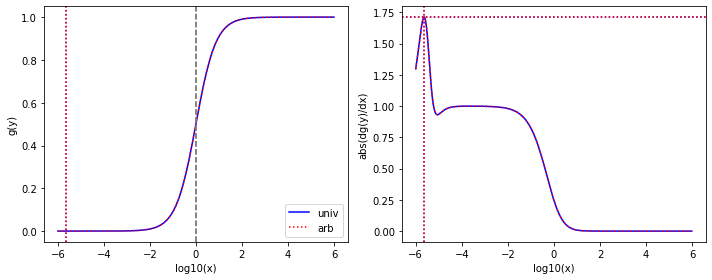

[8.85960e+02 1.06774e+00 4.10041e-02 1.44684e-02 3.05627e-01 3.97684e-03
 2.98461e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
4.628211205923518e-05 4.628211205923518e-05
0.0003449670414014176 0.0003449670414014176
0.3368786401191927 0.3368786401191927
1.1287191295318072e-06 1.128719129531807e-06
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 2799747274092664.5
From univ parameters, position and steepness are: 0.19679679911381162 1.7168583133164568 5.795743031631257
From arb parameters, position and steepness are: 0.19679679911381212 1.7168583133164526 5.795743031631242


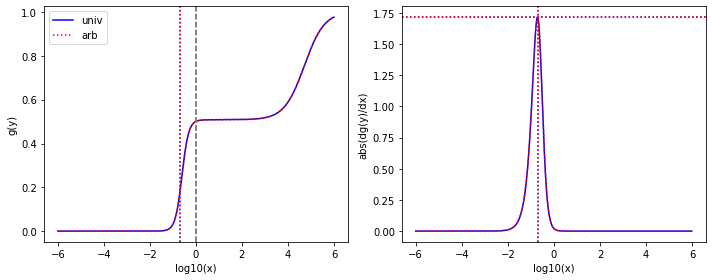

[1.00000e+03 1.00000e-03 1.86994e-03 1.00000e-03 3.79751e-01 1.34267e-03
 2.98461e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.8699400000000001e-06 1.8699400000000001e-06
0.000379751 0.000379751
0.29846100000000003 0.2984610000000001
1e-06 1e-06
# maximal error is 5.551115123125783e-17
min-max are 2.498058915578641e-10 3084168419090106.0
From univ parameters, position and steepness are: 4.297450762167097e-06 1.7216433878341961 298459.59818397206
From arb parameters, position and steepness are: 4.297450762167095e-06 1.7216433878341963 298459.5981839721


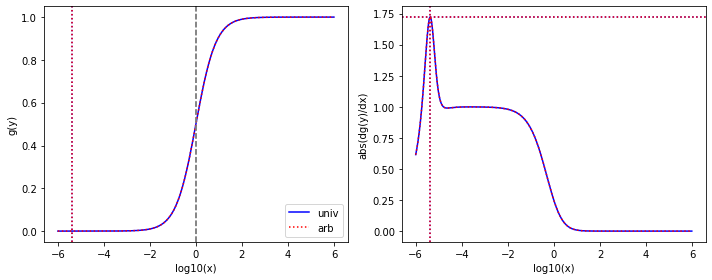

[1.14717e+02 1.58032e-01 9.79109e-03 1.00000e-03 1.35537e-01 1.11251e-02
 2.98461e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
8.534994813323222e-05 8.534994813323223e-05
0.0011814901017286016 0.0011814901017286016
2.601715526033631 2.6017155260336313
8.717103829423713e-06 8.717103829423713e-06
# maximal error is 4.440892098500626e-16
min-max are 2.439715342954195e-10 120857521637384.4
From univ parameters, position and steepness are: 0.19619903603131997 1.7216779582817079 2.941030213112339
From arb parameters, position and steepness are: 0.19619903603131952 1.7216779582817117 2.9410302131123456


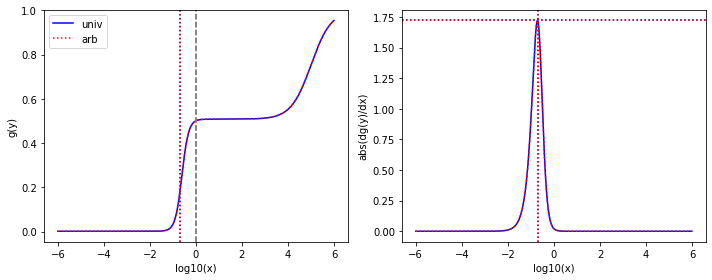

[1.00000e+03 1.00162e-03 3.40140e-03 3.40140e-03 3.21237e-03 1.00000e-03
 3.29832e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.4014e-06 3.4014e-06
3.21237e-06 3.21237e-06
0.329832 0.329832
1e-06 1e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 413343259756381.4
From univ parameters, position and steepness are: 2.6467215415764103e-06 1.7303265283705196 329830.66073499
From arb parameters, position and steepness are: 2.6467215415764094e-06 1.7303265283705196 329830.66073499003


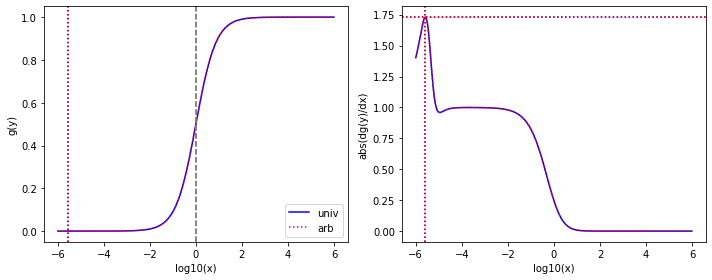

[3.89329e+02 7.23789e-01 1.00000e-03 1.00000e-03 1.52989e-01 4.38288e-03
 2.98461e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.5685217386837355e-06 2.5685217386837355e-06
0.000392955572279486 0.000392955572279486
0.7666035666492863 0.7666035666492863
2.5685217386837355e-06 2.568521738683735e-06
# maximal error is 4.235164736271502e-22
min-max are 2.498058915578641e-10 3191382766969658.0
From univ parameters, position and steepness are: 0.1942562564311289 1.7374522642943717 4.4640892221999735
From arb parameters, position and steepness are: 0.1942562564311294 1.7374522642943673 4.464089222199962


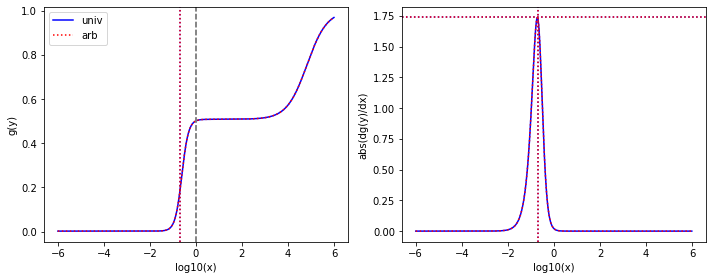

[1.00000e+03 1.00000e-03 1.76448e-03 1.00000e-03 3.93878e-03 1.00000e-03
 1.00000e+03 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.7644799999999999e-06 1.7644799999999999e-06
3.938780000000001e-06 3.938780000000001e-06
1.0 0.9999999999999999
1e-06 1e-06
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 1018752456631486.0
From univ parameters, position and steepness are: 5.264394627564438e-07 1.7433359393671681 1000000.0000019388
From arb parameters, position and steepness are: 5.264394627564439e-07 1.743335939367168 1000000.0000019388


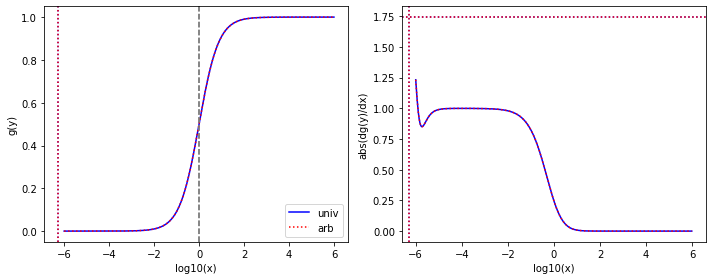

[3.89329e+02 8.29300e-01 1.38361e-03 1.38361e-03 1.68491e-01 1.00000e-03
 2.98461e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.553832362860203e-06 3.553832362860203e-06
0.00043277279627256123 0.00043277279627256123
0.7666035666492863 0.7666035666492863
2.5685217386837355e-06 2.5685217386837355e-06
# maximal error is 0.0
min-max are 2.498058915578641e-10 3514726502664300.0
From univ parameters, position and steepness are: 0.19299662736856435 1.747781466037629 4.493229011470551
From arb parameters, position and steepness are: 0.19299662736856488 1.7477814660376243 4.493229011470539


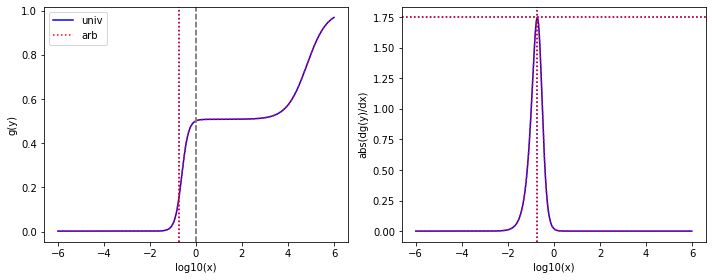

[8.89322e+02 1.00000e-03 3.89927e-03 3.89927e-03 1.00000e-03 1.00000e-03
 2.77368e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
4.384542381724504e-06 4.384542381724504e-06
1.1244521107090571e-06 1.1244521107090571e-06
0.31188703304314974 0.31188703304314974
1.1244521107090571e-06 1.124452110709057e-06
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 1133787809113522.2
From univ parameters, position and steepness are: 3.0298316246102315e-06 1.759339226168752 277366.6237689132
From arb parameters, position and steepness are: 3.029831624610232e-06 1.759339226168752 277366.6237689132


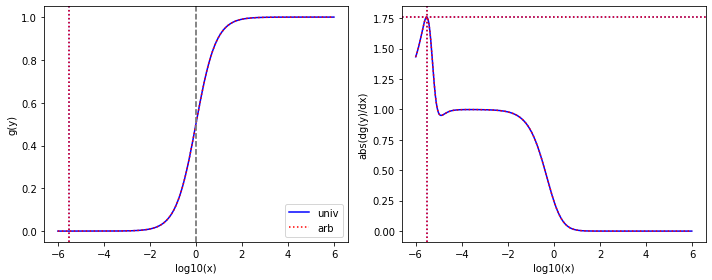

[3.89329e+02 8.05282e-01 1.97470e-03 1.00000e-03 5.24262e-01 2.14758e-03
 2.98461e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
5.072059877378771e-06 5.072059877378771e-06
0.0013465783437658124 0.0013465783437658122
0.7666035666492863 0.7666035666492863
2.5685217386837355e-06 2.568521738683735e-06
# maximal error is 2.168404344971009e-19
min-max are 2.498058915578641e-10 1.093637640219859e+16
From univ parameters, position and steepness are: 0.1920664382803574 1.7550548876775875 4.514474203718254
From arb parameters, position and steepness are: 0.19206643828035794 1.7550548876775829 4.514474203718241


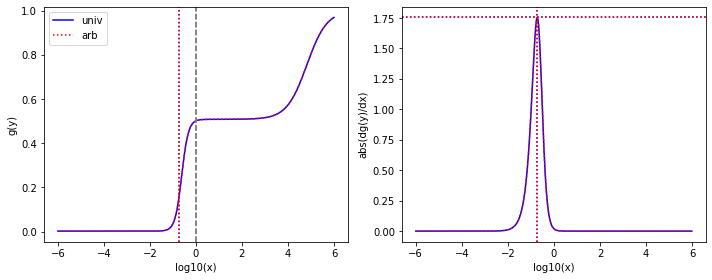

[1.08958e+01 5.44733e+00 1.72146e+00 1.24838e-01 2.71858e-01 1.88557e-02
 7.80426e-03 1.00000e-03 1.17653e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.15799298812386425 0.15799298812386425
0.024950714954386093 0.024950714954386093
0.0007162631472677546 0.0007162631472677547
0.00010798013913618092 0.00010798013913618092
# maximal error is 1.0842021724855044e-19
min-max are 3.529814346881038e-10 41228096268586.34
From univ parameters, position and steepness are: 0.0006625543886569943 1.7663855153027097 26.156247374066933
From arb parameters, position and steepness are: 0.0006625543886569765 1.76638551530271 26.156247374066933


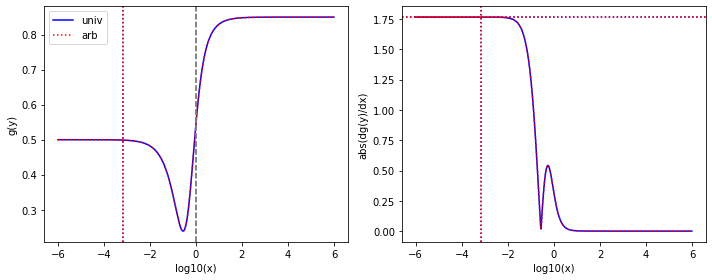

[1.00000e+03 2.63019e+00 1.88028e-02 1.44684e-02 1.68491e-01 7.13938e-03
 2.98461e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.8802800000000002e-05 1.8802800000000002e-05
0.000168491 0.000168491
0.29846100000000003 0.29846100000000003
1e-06 9.999999999999997e-07
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 1367634292130635.8
From univ parameters, position and steepness are: 0.19097682684920755 1.7646793174096003 6.2185197847521465
From arb parameters, position and steepness are: 0.19097682684920708 1.7646793174096045 6.218519784752162


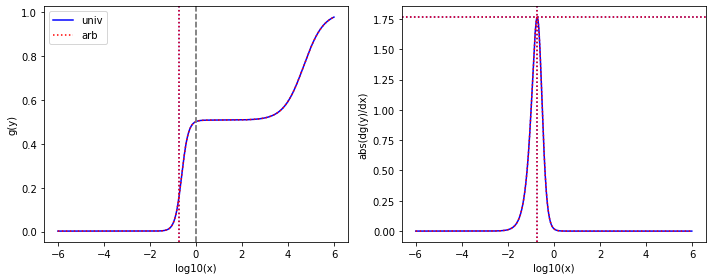

[1.00000e-03 1.00000e-03 1.32859e-03 1.00000e-03 2.60954e-02 1.00000e-03
 5.34720e+02 5.34720e+02 1.63033e+02 4.07149e-03]
found K1
found pairwise
found triplewise
1.32859 1.32859
26.0954 26.0954
534720.0 534720.0
163032.99999999997 163032.99999999994
# maximal error is 2.9103830456733704e-11
min-max are 3.529814346881038e-10 4.311955264950694e+16
From univ parameters, position and steepness are: 0.0018854476743519917 1.771708138008276 3.279782275555292
From arb parameters, position and steepness are: 0.0018854476743519909 1.7717081380082764 3.2797822755552932


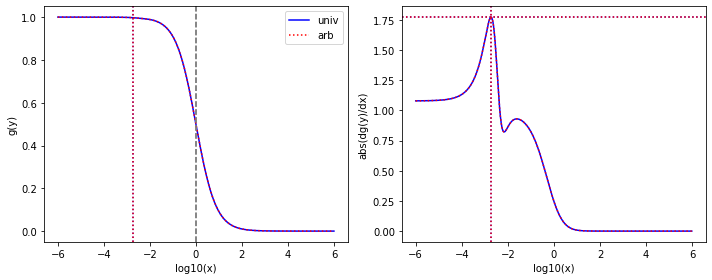

[3.89329e+02 1.06774e+00 3.57951e-02 4.27309e-03 1.68491e-01 1.00000e-03
 2.98461e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
9.194049248835818e-05 9.194049248835818e-05
0.00043277279627256123 0.00043277279627256123
0.7666035666492863 0.7666035666492864
2.5685217386837355e-06 2.5685217386837355e-06
# maximal error is 1.1102230246251565e-16
min-max are 2.439715342954195e-10 43726694090602.58
From univ parameters, position and steepness are: 0.19023847978555936 1.7708969505084597 4.558404559627795
From arb parameters, position and steepness are: 0.19023847978555988 1.7708969505084549 4.558404559627783


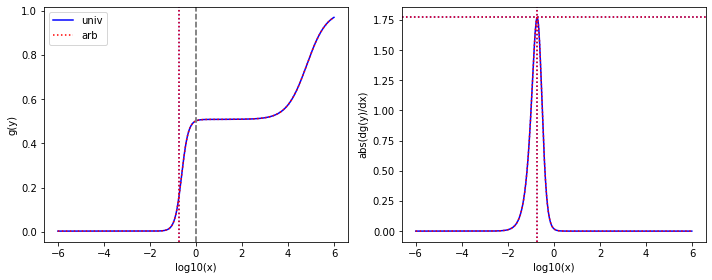

[4.03856e+02 1.00000e-03 1.00000e-03 1.00000e-03 8.74727e-01 1.00000e-03
 4.41163e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.476130105780278e-06 2.476130105780278e-06
0.0021659378590388654 0.0021659378590388654
1.0923769858563448 1.092376985856345
2.476130105780278e-06 2.476130105780278e-06
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 1.7591134977192814e+16
From univ parameters, position and steepness are: 1.0647267325339528e-06 1.7814273362421889 441163.1867326798
From arb parameters, position and steepness are: 1.064726732533953e-06 1.7814273362421884 441163.1867326797


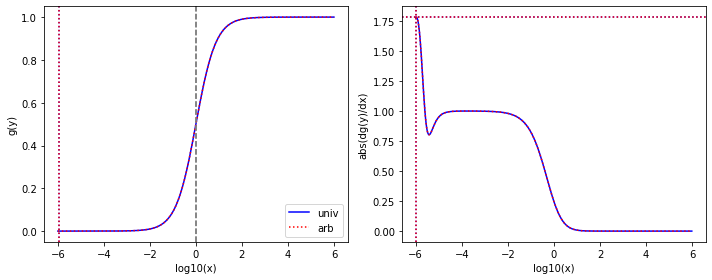

[3.89329e+02 1.06774e+00 1.38361e-03 1.00000e-03 5.12767e-01 1.00000e-03
 2.98461e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
3.553832362860203e-06 3.553832362860203e-06
0.0013170531863796427 0.0013170531863796427
0.7666035666492863 0.7666035666492863
2.5685217386837355e-06 2.568521738683736e-06
# maximal error is 4.235164736271502e-22
min-max are 2.498058915578641e-10 1.0696645394978096e+16
From univ parameters, position and steepness are: 0.18907000641242172 1.780537535983931 4.58604961739729
From arb parameters, position and steepness are: 0.18907000641242228 1.780537535983926 4.5860496173972765


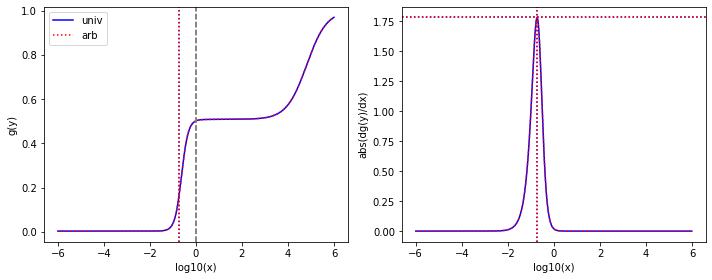

[2.73121e+02 2.19161e-03 6.27180e-02 1.00000e-03 3.57364e-03 1.00000e-03
 4.35616e+02 1.00000e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.00022963448434942755 0.00022963448434942755
1.3084457072140187e-05 1.3084457072140186e-05
1.5949560817366661 1.5949560817366661
3.6613808531749666e-06 3.661380853174967e-06
# maximal error is 1.6940658945086007e-21
min-max are 7.027031419536454e-09 21620418287.230083
From univ parameters, position and steepness are: 2.8491915274267164e-07 1.7969404350014386 435620.99108705943
From arb parameters, position and steepness are: 2.849191527426717e-07 1.7969404350014382 435620.9910870593


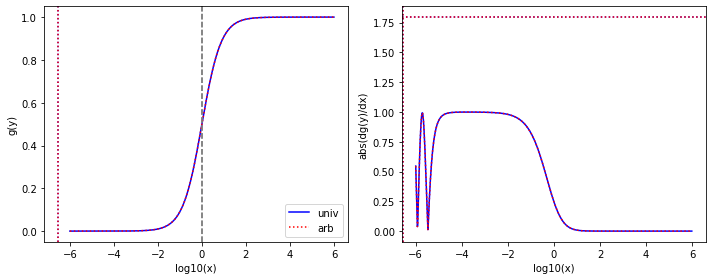

[1.08958e+01 5.44733e+00 1.72146e+00 1.24838e-01 2.71858e-01 1.23757e-03
 7.80426e-03 1.00000e-03 1.17653e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.15799298812386425 0.15799298812386425
0.024950714954386093 0.024950714954386093
0.0007162631472677546 0.0007162631472677547
0.00010798013913618092 0.00010798013913618092
# maximal error is 1.0842021724855044e-19
min-max are 3.529814346881038e-10 41228096268586.34
From univ parameters, position and steepness are: 0.013515762847915747 1.794128903044088 26.33793032506626
From arb parameters, position and steepness are: 0.013515762847915731 1.794128903044088 26.33793032506626


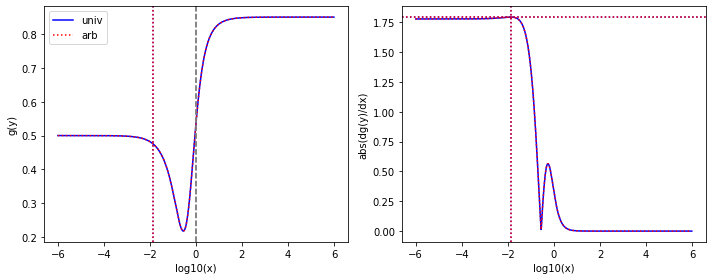

[1.22804e+02 1.05363e+02 1.00000e-03 1.00000e-03 5.67775e-03 1.00000e-03
 1.73213e+02 1.73213e+02 9.97368e+00 3.94334e-03]
found K1
found pairwise
found triplewise
8.143057229406208e-06 8.143057229406208e-06
4.62342431842611e-05 4.62342431842611e-05
1.4104833718771375 1.4104833718771375
0.08121624702778411 0.08121624702778413
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 375152838502588.75
From univ parameters, position and steepness are: 0.029103063590247575 1.799447360214316 20.641254334145646
From arb parameters, position and steepness are: 0.029103063590247582 1.7994473602143155 20.64125433414564


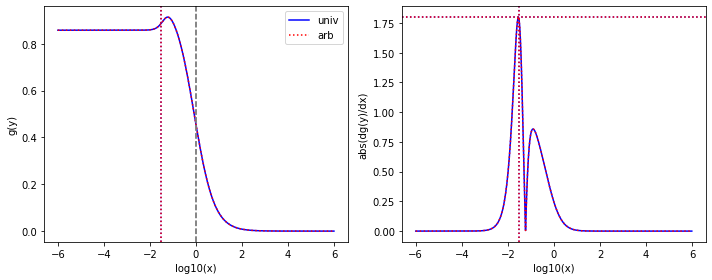

[8.56180e+00 5.44733e+00 1.42309e+00 2.86105e-01 2.73148e-01 7.52302e-03
 2.40627e-03 2.40627e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.16621388025882408 0.16621388025882408
0.03190310448737415 0.03190310448737415
0.00028104720969889506 0.00028104720969889506
0.00011679786960685838 0.00011679786960685838
# maximal error is 0.0
min-max are 3.529814346881038e-10 52716095166622.195
From univ parameters, position and steepness are: 0.03486374929752143 1.7919092589547707 23.00652498644593
From arb parameters, position and steepness are: 0.03486374929752144 1.7919092589547703 23.00652498644593


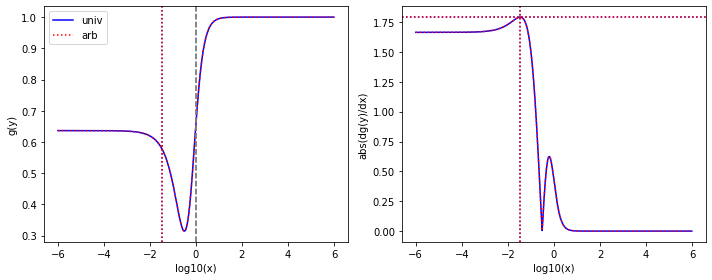

[8.56424e+00 5.46413e+00 1.05367e+00 1.00000e-03 2.71889e-01 5.01840e-03
 1.00000e-03 1.00000e-03 1.29467e-03 1.29467e-03]
found K1
found pairwise
found triplewise
0.12303134895799278 0.12303134895799277
0.03174700849112122 0.03174700849112122
0.000116764593238863 0.000116764593238863
0.00015117161592855875 0.00015117161592855875
# maximal error is 1.3877787807814457e-17
min-max are 3.529814346881038e-10 52458165064944.73
From univ parameters, position and steepness are: 0.04865196917161389 1.7953723561114043 20.436283657259086
From arb parameters, position and steepness are: 0.0486519691716139 1.795372356111404 20.436283657259086


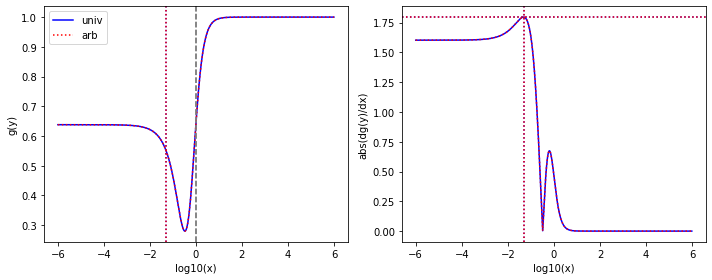

[8.56180e+00 5.44733e+00 1.08102e+00 1.50868e-01 2.71858e-01 1.00000e-03
 3.00223e-03 2.34253e-03 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.12626083300240604 0.12626083300240604
0.0317524352355813 0.0317524352355813
0.0003506540680697984 0.0003506540680697984
0.00011679786960685838 0.00011679786960685836
# maximal error is 1.3552527156068805e-20
min-max are 3.529814346881038e-10 52467132115345.27
From univ parameters, position and steepness are: 0.0552173098209741 1.7969787124762477 23.227685561957486
From arb parameters, position and steepness are: 0.05521730982097411 1.7969787124762475 23.227685561957486


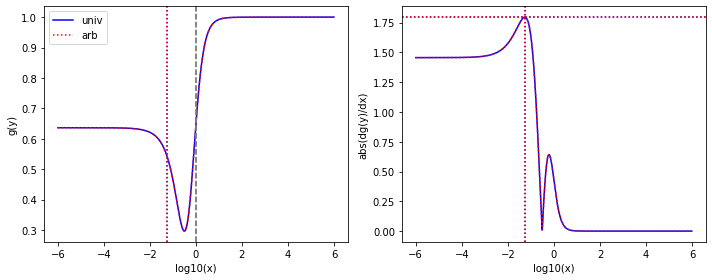

[5.54917e+02 3.64529e+01 1.00000e-03 1.00000e-03 7.79509e+01 9.67193e+00
 1.00000e+03 1.60197e+02 6.85711e+01 6.85711e+01]
found K1
found pairwise
found triplewise
1.8020713007530855e-06 1.8020713007530855e-06
0.1404730797578737 0.1404730797578737
1.8020713007530855 1.8020713007530857
0.1235700113710699 0.12357001137106989
# maximal error is 2.220446049250313e-16
min-max are 2.498058915578641e-10 1.1408894825885274e+18
From univ parameters, position and steepness are: 0.06164059986694916 1.791458865881943 11.723026783273774
From arb parameters, position and steepness are: 0.06164059986694915 1.7914588658819433 11.723026783273776


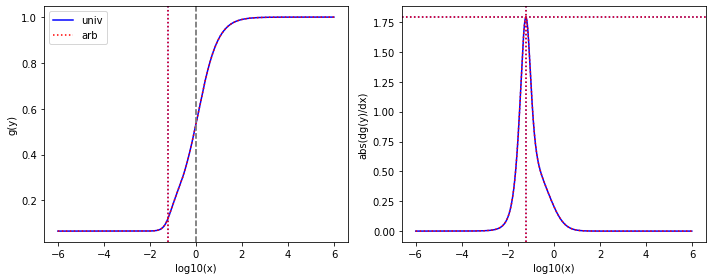

[8.33317e+02 3.64529e+01 1.92692e+00 4.80473e-03 7.79509e+01 9.67193e+00
 1.00000e+03 1.60197e+02 6.85711e+01 6.85711e+01]
found K1
found pairwise
found triplewise
0.002312349322046712 0.002312349322046712
0.09354291344110345 0.09354291344110345
1.200023520461001 1.200023520461001
0.08228693282388334 0.08228693282388334
# maximal error is 0.0
min-max are 3.529814346881038e-10 154568566822906.78
From univ parameters, position and steepness are: 0.07367800045170203 1.7900748043649932 11.125548922003407
From arb parameters, position and steepness are: 0.07367800045170202 1.7900748043649934 11.125548922003409


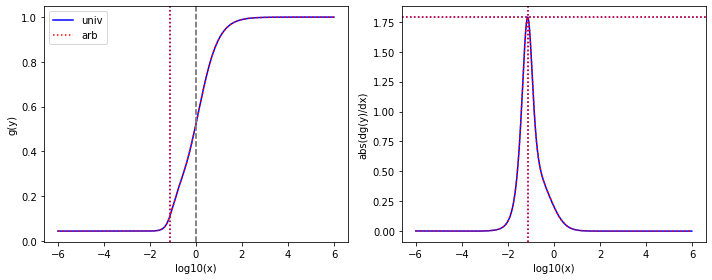

[1.00000e+03 2.08474e+00 2.44827e-01 1.00000e-03 9.87773e-01 1.19335e-01
 9.64423e+02 1.18622e+02 6.82475e+01 6.82475e+01]
found K1
found pairwise
found triplewise
0.000244827 0.000244827
0.000987773 0.000987773
0.964423 0.9644230000000001
0.0682475 0.0682475
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 1632177602466.1753
From univ parameters, position and steepness are: 0.08412965709026815 1.7980005428675552 10.71976336149148
From arb parameters, position and steepness are: 0.08412965709026814 1.7980005428675554 10.719763361491482


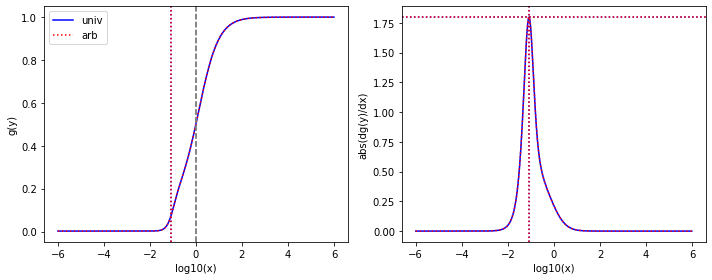

[7.40969e+02 1.55061e+01 1.44169e-03 1.00000e-03 5.00025e+01 9.74581e+00
 8.66907e+02 1.59322e+02 6.85711e+01 6.85711e+01]
found K1
found pairwise
found triplewise
1.945681938110771e-06 1.945681938110771e-06
0.06748258024289815 0.06748258024289815
1.1699639256163212 1.1699639256163212
0.09254246803847394 0.09254246803847392
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 5.480776790436136e+17
From univ parameters, position and steepness are: 0.09474445511121606 1.797689761752989 8.509434020359848
From arb parameters, position and steepness are: 0.09474445511121606 1.797689761752989 8.509434020359848


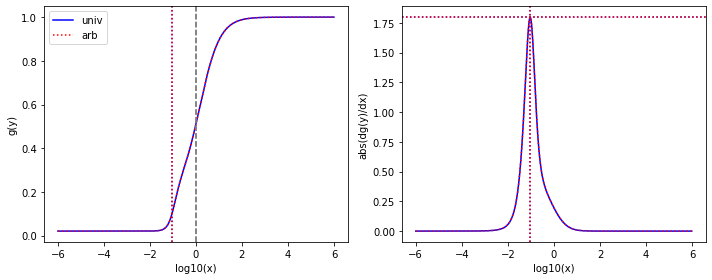

[7.40969e+02 1.63496e+01 1.00000e-03 1.00000e-03 7.56037e+01 8.46446e+00
 8.66907e+02 1.87499e+02 6.85711e+01 6.85711e+01]
found K1
found pairwise
found triplewise
1.3495841256516803e-06 1.3495841256516803e-06
0.10203355336053195 0.10203355336053195
1.1699639256163212 1.1699639256163212
0.09254246803847394 0.09254246803847395
# maximal error is 1.3877787807814457e-17
min-max are 2.498058915578641e-10 8.286926424350058e+17
From univ parameters, position and steepness are: 0.10266386468379186 1.7920617011853694 7.759907783004327
From arb parameters, position and steepness are: 0.10266386468379192 1.792061701185369 7.759907783004325


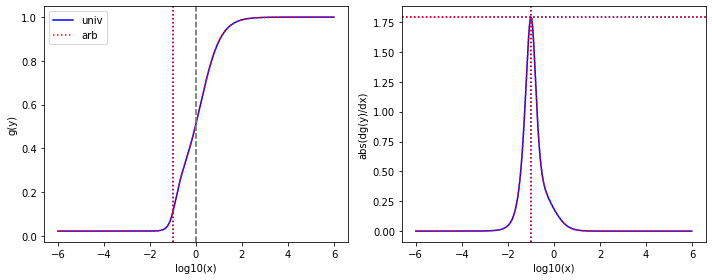

[1.00000e+03 1.67283e+01 1.28185e-01 2.03612e-03 1.79443e+02 4.34669e-03
 1.00000e+03 2.80576e+02 6.82475e+01 6.82475e+01]
found K1
found pairwise
found triplewise
0.000128185 0.00012818500000000003
0.17944300000000002 0.17944300000000002
1.0 0.9999999999999999
0.0682475 0.0682475
# maximal error is 1.1102230246251565e-16
min-max are 3.529814346881038e-10 296508269032314.1
From univ parameters, position and steepness are: 0.11458052091175432 1.7942839924780714 7.205428730501663
From arb parameters, position and steepness are: 0.11458052091175433 1.7942839924780714 7.205428730501662


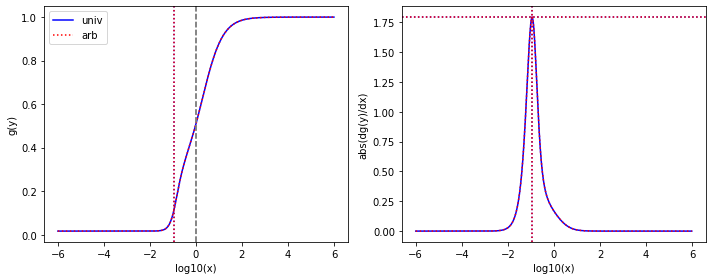

[1.00000e+03 3.13948e+01 8.03358e+00 5.61005e+00 1.00000e-03 1.00000e-03
 9.64423e+02 2.80576e+02 6.82475e+01 6.82475e+01]
found K1
found pairwise
found triplewise
0.00803358 0.008033580000000002
1e-06 1e-06
0.964423 0.964423
0.0682475 0.06824750000000002
# maximal error is 1.3877787807814457e-17
min-max are 7.027031419536454e-09 6065060211.472175
From univ parameters, position and steepness are: 0.1268343033203141 1.791634218666981 6.608256455550482
From arb parameters, position and steepness are: 0.1268343033203141 1.791634218666981 6.608256455550482


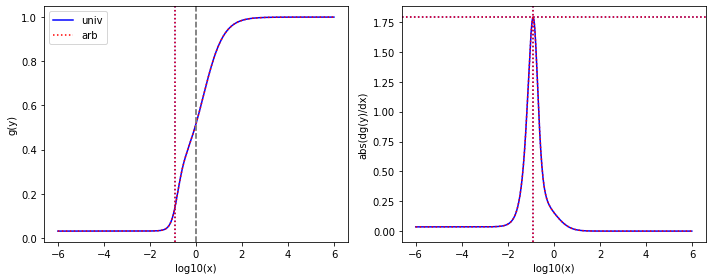

[1.00000e+03 1.71542e+00 1.68116e-03 1.63961e-03 1.00000e-03 1.00000e-03
 9.64423e+02 2.80576e+02 6.82475e+01 6.82475e+01]
found K1
found pairwise
found triplewise
1.6811599999999998e-06 1.6811599999999998e-06
1e-06 1e-06
0.964423 0.9644230000000001
0.0682475 0.0682475
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 3895421371725658.5
From univ parameters, position and steepness are: 0.13940103053571878 1.7915247824666334 6.010851555128449
From arb parameters, position and steepness are: 0.1394010305357188 1.7915247824666334 6.010851555128448


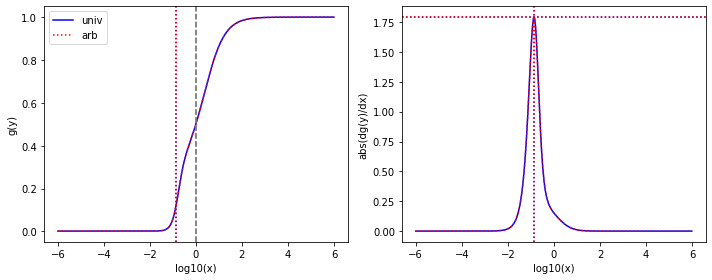

[1.00000e+03 5.14864e-02 1.68116e-03 1.63961e-03 1.00000e-03 1.00000e-03
 9.64423e+02 2.80576e+02 6.82475e+01 6.82475e+01]
found K1
found pairwise
found triplewise
1.6811599999999998e-06 1.6811599999999998e-06
1e-06 1e-06
0.964423 0.9644230000000001
0.0682475 0.0682475
# maximal error is 1.1102230246251565e-16
min-max are 2.498058915578641e-10 3895421371725658.5
From univ parameters, position and steepness are: 0.1401170868898261 1.7904035529178242 5.978546568039068
From arb parameters, position and steepness are: 0.14011708688982613 1.7904035529178242 5.978546568039067


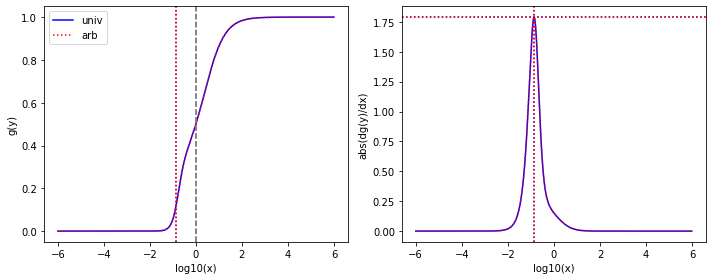

[1.57641e+00 2.24570e-03 2.48534e+00 1.28238e+00 3.94303e+00 6.05717e-03
 4.43150e+02 2.26413e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.5765822343172142 1.5765822343172142
2.501271877240058 2.501271877240058
281.1134159260598 281.1134159260599
0.0006343527381835944 0.0006343527381835944
# maximal error is 5.684341886080802e-14
min-max are 3.529814346881038e-10 4133055036032560.0
From univ parameters, position and steepness are: 0.15003145882201227 1.7954581524940356 0.7409017811193137
From arb parameters, position and steepness are: 0.15003145882201296 1.7954581524940276 0.7409017811193102


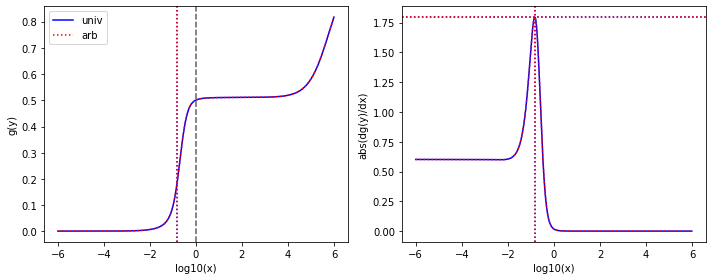

[1.29007e+00 1.00000e-03 2.88960e-01 3.72175e-02 1.29781e+01 3.10761e-02
 2.88184e+02 1.53867e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
0.22398784562078025 0.22398784562078025
10.059996744362708 10.059996744362708
223.3863278736813 223.38632787368127
0.0007751517359523126 0.0007751517359523126
# maximal error is 2.842170943040401e-14
min-max are 3.529814346881038e-10 1.66229511436214e+16
From univ parameters, position and steepness are: 0.161277039139832 1.7979358790066358 0.7897863697384766
From arb parameters, position and steepness are: 0.16127703913983185 1.797935879006637 0.7897863697384773


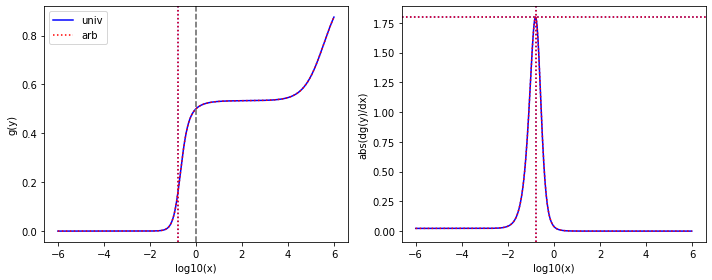

[1.57641e+00 2.24570e-03 2.48534e+00 1.00000e-03 1.00000e-03 1.00000e-03
 4.43150e+02 2.26413e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
1.5765822343172142 1.5765822343172142
0.0006343527381835944 0.0006343527381835944
281.1134159260598 281.1134159260598
0.0006343527381835944 0.0006343527381835942
# maximal error is 1.0842021724855044e-19
min-max are 3.529814346881038e-10 1048192053528.0054
From univ parameters, position and steepness are: 0.17408301128007447 1.7911152002352653 0.718933244200021
From arb parameters, position and steepness are: 0.17408301128007508 1.7911152002352593 0.7189332442000186


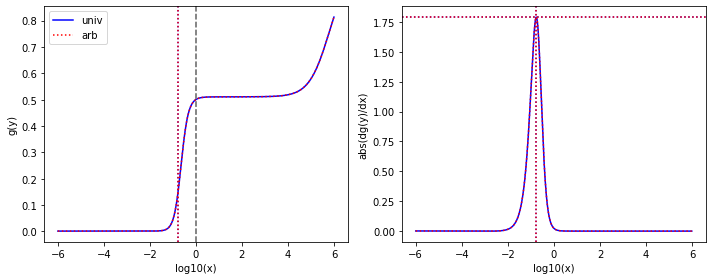

[5.77041e+02 1.90774e+00 1.38361e-03 1.00000e-03 8.63967e-02 1.00000e-03
 2.98461e+02 1.51706e+02 1.00000e-03 1.00000e-03]
found K1
found pairwise
found triplewise
2.39776722971158e-06 2.39776722971158e-06
0.00014972367648052737 0.00014972367648052737
0.5172266788668396 0.5172266788668396
1.732979112402758e-06 1.7329791124027582e-06
# maximal error is 2.117582368135751e-22
min-max are 2.498058915578641e-10 1215917450726395.0
From univ parameters, position and steepness are: 0.18799817035718605 1.7904612631912908 5.2593433356446555
From arb parameters, position and steepness are: 0.18799817035718555 1.7904612631912955 5.259343335644669


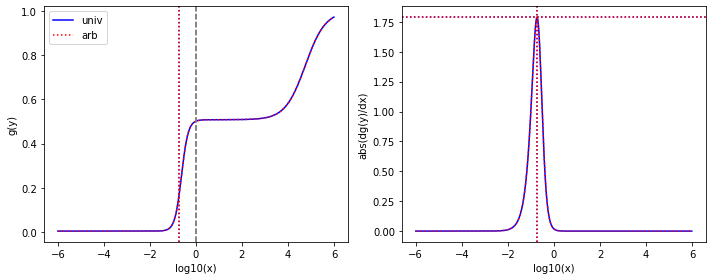

In [20]:
for parameters in parsets:
    print(parameters)
    seed=1
    fiar,parset=find_hypercube_parameters(parameters.copy(),10,10,seed=seed)
    print("min-max are", np.min(parset), np.max(parset))
    if fiar is not None:
        #print("fi",",".join(list(map(str,fiar))))
        #print("parset",",".join(list(map(str,parset))))
        makeplot(parameters,np.concatenate((fiar,parset)),instanceuniv=N4univ.GRFCalculations_100_100_15(),instancearb=N4arbfi.GRFCalculations_100_100_15())